In [1]:
from statsmodels.formula.api import ols
from statsmodels.graphics.api import interaction_plot, abline_plot
from statsmodels.stats.anova import anova_lm

import statsmodels.api as sm

import dataframe_image as dfi

In [2]:
import os

try:
    os.mkdir("../PLOTS/NF_SUB_LOS")
except:
    print("NF_LOS_GENDER dir exists.")

#For testing, leave commented
swivel = 0
#swivel_order = [2, 1, 7, 3, 16, 6, 12, 9, 10, 4, 5, 15, 8, 14, 20, 0, 22, 13, 19, 11, 18, 21, 17]

desired_file_prefix = "NF_LOS" 

normalize_data=True

by_year = 1
lnconvert=False
 

# FUNCTIONS

In [3]:
def color_corr_green(val):
  color = 'green' if val > 0.8 else 'black'
  return 'color: %s' % color


In [4]:
def gen_boxplot():

 case_list = []

 # Create list of data cases
 #
 for index in range(0,len(global_y_soc1)):
    name = global_y_soc1[index][0]
    if (name[5:] not in case_list):
        case_list.append(name[5:])

 print(case_list)

 # Handle one case at a time
 #
 for case in case_list:
        
    #print("case = ",case)
    
    pd_df = pd.DataFrame()
    sel_y = []
    
    for index in range(0,len(global_y_soc1)):
        
        name  = global_y_soc1[index][0]
        sel_y = global_y_soc1[index][1]
        
        # Cycle through years
        #
        if (case in name):    
            #print(case,name)
            name = name[0:5] + name[8:]
            #print("8 ",name)
            
            df = pd.DataFrame()
            df[name] = sel_y
            
            #Q1 = df[name].quantile(0.25)
            #Q3 = df[name].quantile(0.75)
            #IQR = Q3 - Q1    #IQR is interquartile range. 

            #filter = (df[name] >= Q1 - 1.5 * IQR) & (df[name] <= Q3 + 1.5 *IQR)
            #print(filter)
            #df = df.loc[filter]
            
            q = df[name].quantile(0.80)
            df = df[df[name] < q]
            
            pd_df = pd.concat([pd_df,df],axis=1)
        
            #print(pd_df)

    # Get occupation
    for code in soc_new_code:
        #print(code[0][0:2])
        if (code[0][0:2].find(case[0:2]) >= 0):
            #print(code[0],code[1])
            ocup = str(code[0]) + " " + str(code[1])
            
    #print(ocup)

    title = desired_file_prefix + " " + ocup + " boxplot " + str(case[3:])
    plt.figure(title,figsize=(10, 10))
    plt.title(title)

    #plt.ylim(0.0, 3e-6)

    pd_df.boxplot()
    plt.xticks(rotation = 90)
    plt.tight_layout()  

    save_title = "../PLOTS/" + desired_file_output + title + ".png"
    save_title = save_title.replace(",","")
    save_title = save_title.replace(" ","_")
    plt.savefig(save_title, dpi=100, bbox_inches='tight')
    
    plt.show()
    
    #print("HERE")
    #print(df[df['YEAR'].str.contains(name)])
    
    ## ########################## correlations ######################
    
    title = title + "_pearson_corr"

    df_corr = pd_df.corr(method='pearson').style.applymap(color_corr_green)

    df = pd_df.corr(method='pearson')
 
    df_styled = df.style.background_gradient(axis=None, vmin=0.45, vmax=1.0)
  
    save_file = "../PLOTS/" + desired_file_output + title + ".png"
    dfi.export(df_styled, save_file, max_cols=-1, max_rows=-1)

    save_file = "../PLOTS/" + desired_file_output + title + ".xlsx"
    df_corr.to_excel(save_file)

    display(df_styled)        

# ALL CORRELATIONS

In [5]:
# Generate all correlations
#
def gen_corr():

  pd_df = pd.DataFrame()
  sel_y = []
    
  case_list = []

  # Create list of data cases
  #
  for index in range(0,len(global_y_soc1)):
    name = global_y_soc1[index][0]
    if (name[5:] not in case_list):
        case_list.append(name[5:])

  print(case_list)

  # Handle one case at a time
  #
  for case in case_list:
    
    for index in range(0,len(global_y_soc1)):
        
        name  = global_y_soc1[index][0]
        sel_y = global_y_soc1[index][1]
        
        # Cycle through years
        #
        if (case in name):    
            #print(case,name)
            
            temp_pd_df = pd.DataFrame()
            temp_pd_df[name] = sel_y
            pd_df = pd.concat([pd_df,temp_pd_df],axis=1)
        
            #print(pd_df)

            # Get occupation
            for code in soc_new_code:
                #print(code[0][0:2])
                if (code[0][0:2].find(case[0:2]) >= 0):
                    #print(code[0],code[1])
                    ocup = str(code[0]) + " " + str(code[1])
            
  #print(ocup)

  title = desired_file_prefix + ocup +" ALL boxplot " + str(case[3:])
  plt.figure(title,figsize=(10, 10))
  plt.title(title)

  #plt.ylim(0.0, 3e-6)

  pd_df.boxplot()
  plt.xticks(rotation = 90)
  plt.tight_layout()  

  save_title = "../PLOTS/" + desired_file_output + title + ".png"
  save_title = save_title.replace(",","")
  save_title = save_title.replace(" ","_")
  plt.savefig(save_title, dpi=100, bbox_inches='tight')
    
  plt.show()
    
  #print("HERE")
  #print(df[df['YEAR'].str.contains(name)])
    
  ## ########################## correlations ######################
    
  title = title + "_pearson_corr"

  df_corr = pd_df.corr(method='pearson').style.applymap(color_corr_green)

  df = pd_df.corr(method='pearson')
 
  df_styled = df.style.background_gradient(axis=None, vmin=0.45, vmax=1.0)
  
  save_file = "../PLOTS/" + desired_file_output + title + ".png"
  dfi.export(df_styled, save_file, max_cols=-1, max_rows=-1)

  save_file = "../PLOTS/" + desired_file_output + title + ".xlsx"
  df_corr.to_excel(save_file)

  display(df_styled)        



########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty not found....defining
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
11-0000 Management Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
11-0000 Management Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
11-0000 Management Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
11-0000 Mana

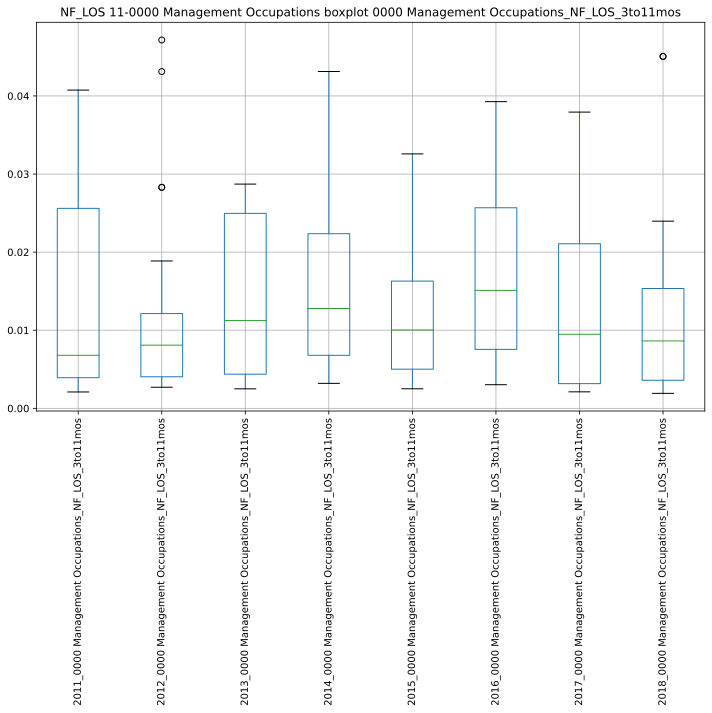

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/232821.423465:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232821.465217:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232821.706004:INFO:headless_shell.cc(660)] Written to file /tmp/tmpwvwvmsju/temp.png.
[1013/232821.927301:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232821.965265:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232822.238136:INFO:headless_shell.cc(660)] Written to file /tmp/tmpajnq9m5_/temp.png.
[1013/232822.508073:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232822.547290:WARNI

,2011_0000 Management Occupations_NF_LOS_3to11mos,2012_0000 Management Occupations_NF_LOS_3to11mos,2013_0000 Management Occupations_NF_LOS_3to11mos,2014_0000 Management Occupations_NF_LOS_3to11mos,2015_0000 Management Occupations_NF_LOS_3to11mos,2016_0000 Management Occupations_NF_LOS_3to11mos,2017_0000 Management Occupations_NF_LOS_3to11mos,2018_0000 Management Occupations_NF_LOS_3to11mos
2011_0000 Management Occupations_NF_LOS_3to11mos,1.000000,0.105846,0.100779,0.776007,0.365151,-0.091122,0.369552,0.127458
2012_0000 Management Occupations_NF_LOS_3to11mos,0.105846,1.000000,0.322679,0.072533,0.501774,0.396468,0.149716,0.535888
2013_0000 Management Occupations_NF_LOS_3to11mos,0.100779,0.322679,1.000000,0.306425,0.683782,0.211876,0.444813,0.475988
2014_0000 Management Occupations_NF_LOS_3to11mos,0.776007,0.072533,0.306425,1.000000,0.529392,-0.379242,0.466869,0.257782
2015_0000 Management Occupations_NF_LOS_3to11mos,0.365151,0.501774,0.683782,0.529392,1.000000,0.104058,0.954574,0.236001
2016_0000 Management Occupations_NF_LOS_3to11mos,-0.091122,0.396468,0.211876,-0.379242,0.104058,1.000000,-0.135248,0.391678
2017_0000 Management Occupations_NF_LOS_3to11mos,0.369552,0.149716,0.444813,0.466869,0.954574,-0.135248,1.000000,0.233301
2018_0000 Management Occupations_NF_LOS_3to11mos,0.127458,0.535888,0.475988,0.257782,0.236001,0.391678,0.233301,1.000000


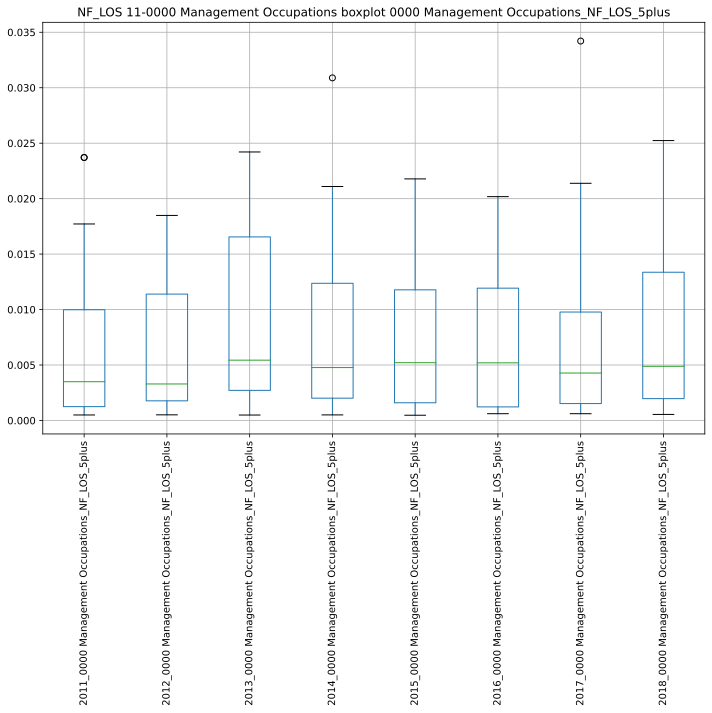

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/232825.494256:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232825.523023:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232825.743578:INFO:headless_shell.cc(660)] Written to file /tmp/tmp50g7jdp8/temp.png.
[1013/232825.966802:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232826.007242:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232826.299822:INFO:headless_shell.cc(660)] Written to file /tmp/tmpet1hd3gb/temp.png.
[1013/232826.561228:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232826.600945:WARNI

,2011_0000 Management Occupations_NF_LOS_5plus,2012_0000 Management Occupations_NF_LOS_5plus,2013_0000 Management Occupations_NF_LOS_5plus,2014_0000 Management Occupations_NF_LOS_5plus,2015_0000 Management Occupations_NF_LOS_5plus,2016_0000 Management Occupations_NF_LOS_5plus,2017_0000 Management Occupations_NF_LOS_5plus,2018_0000 Management Occupations_NF_LOS_5plus
2011_0000 Management Occupations_NF_LOS_5plus,1.000000,0.314225,0.170828,0.139752,0.518889,0.123023,0.199482,0.631561
2012_0000 Management Occupations_NF_LOS_5plus,0.314225,1.000000,0.541829,0.522825,-0.016756,0.791698,0.673621,0.315334
2013_0000 Management Occupations_NF_LOS_5plus,0.170828,0.541829,1.000000,0.241911,0.052382,0.214530,0.518363,0.051225
2014_0000 Management Occupations_NF_LOS_5plus,0.139752,0.522825,0.241911,1.000000,0.027174,0.488519,0.880186,0.191918
2015_0000 Management Occupations_NF_LOS_5plus,0.518889,-0.016756,0.052382,0.027174,1.000000,-0.155468,0.155865,0.717808
2016_0000 Management Occupations_NF_LOS_5plus,0.123023,0.791698,0.214530,0.488519,-0.155468,1.000000,0.639192,0.124218
2017_0000 Management Occupations_NF_LOS_5plus,0.199482,0.673621,0.518363,0.880186,0.155865,0.639192,1.000000,0.177124
2018_0000 Management Occupations_NF_LOS_5plus,0.631561,0.315334,0.051225,0.191918,0.717808,0.124218,0.177124,1.000000


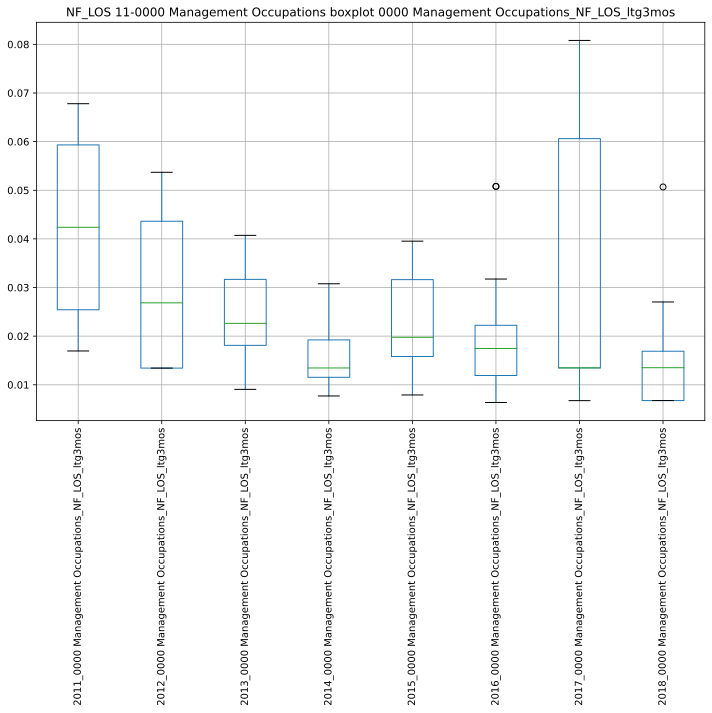

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/232829.246780:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232829.284071:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232829.549697:INFO:headless_shell.cc(660)] Written to file /tmp/tmp9yon2t3o/temp.png.
[1013/232829.766167:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232829.806272:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232830.128700:INFO:headless_shell.cc(660)] Written to file /tmp/tmpg4n78svt/temp.png.
[1013/232830.399009:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232830.437687:WARNI

,2011_0000 Management Occupations_NF_LOS_ltg3mos,2012_0000 Management Occupations_NF_LOS_ltg3mos,2013_0000 Management Occupations_NF_LOS_ltg3mos,2014_0000 Management Occupations_NF_LOS_ltg3mos,2015_0000 Management Occupations_NF_LOS_ltg3mos,2016_0000 Management Occupations_NF_LOS_ltg3mos,2017_0000 Management Occupations_NF_LOS_ltg3mos,2018_0000 Management Occupations_NF_LOS_ltg3mos
2011_0000 Management Occupations_NF_LOS_ltg3mos,1.000000,0.606339,-0.154533,0.043550,0.494627,-0.693334,0.557855,-0.316478
2012_0000 Management Occupations_NF_LOS_ltg3mos,0.606339,1.000000,0.471934,0.408521,0.324019,-0.300829,0.780028,-0.117722
2013_0000 Management Occupations_NF_LOS_ltg3mos,-0.154533,0.471934,1.000000,-0.033982,-0.291635,0.060278,0.765287,-0.383580
2014_0000 Management Occupations_NF_LOS_ltg3mos,0.043550,0.408521,-0.033982,1.000000,0.107367,0.089960,0.400507,0.099283
2015_0000 Management Occupations_NF_LOS_ltg3mos,0.494627,0.324019,-0.291635,0.107367,1.000000,-0.491336,0.497416,0.564235
2016_0000 Management Occupations_NF_LOS_ltg3mos,-0.693334,-0.300829,0.060278,0.089960,-0.491336,1.000000,-0.418627,-0.095640
2017_0000 Management Occupations_NF_LOS_ltg3mos,0.557855,0.780028,0.765287,0.400507,0.497416,-0.418627,1.000000,0.013206
2018_0000 Management Occupations_NF_LOS_ltg3mos,-0.316478,-0.117722,-0.383580,0.099283,0.564235,-0.095640,0.013206,1.000000


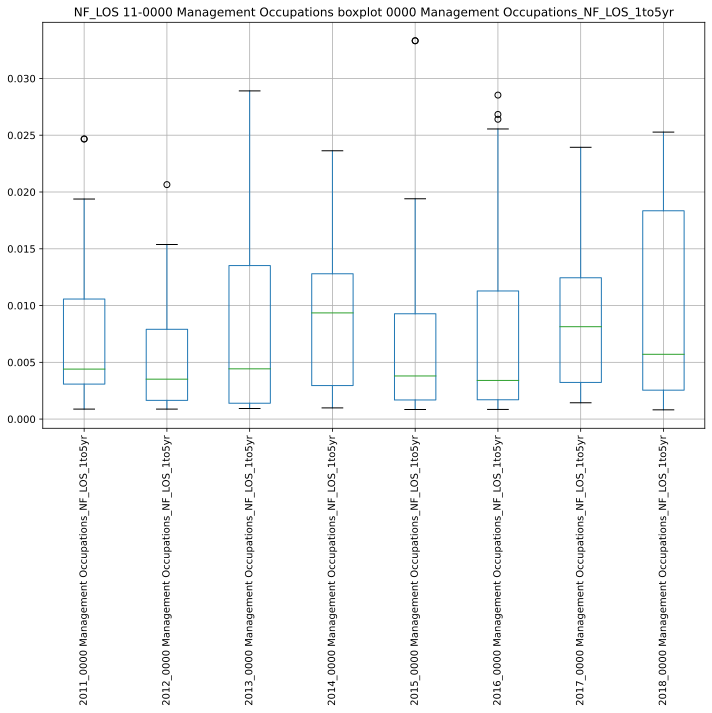

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/232833.244924:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232833.284342:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232833.499653:INFO:headless_shell.cc(660)] Written to file /tmp/tmpcp6ceg0n/temp.png.
[1013/232833.729082:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232833.767694:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232834.050505:INFO:headless_shell.cc(660)] Written to file /tmp/tmp94a1tsv7/temp.png.
[1013/232834.318901:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232834.359386:WARNI

,2011_0000 Management Occupations_NF_LOS_1to5yr,2012_0000 Management Occupations_NF_LOS_1to5yr,2013_0000 Management Occupations_NF_LOS_1to5yr,2014_0000 Management Occupations_NF_LOS_1to5yr,2015_0000 Management Occupations_NF_LOS_1to5yr,2016_0000 Management Occupations_NF_LOS_1to5yr,2017_0000 Management Occupations_NF_LOS_1to5yr,2018_0000 Management Occupations_NF_LOS_1to5yr
2011_0000 Management Occupations_NF_LOS_1to5yr,1.000000,0.492808,-0.280175,-0.161731,-0.204069,0.311384,0.135179,0.615265
2012_0000 Management Occupations_NF_LOS_1to5yr,0.492808,1.000000,0.401187,0.275165,0.345741,0.392607,0.152206,0.761393
2013_0000 Management Occupations_NF_LOS_1to5yr,-0.280175,0.401187,1.000000,0.229529,0.602181,0.171242,-0.352139,0.222531
2014_0000 Management Occupations_NF_LOS_1to5yr,-0.161731,0.275165,0.229529,1.000000,0.386685,0.001923,-0.205817,0.285262
2015_0000 Management Occupations_NF_LOS_1to5yr,-0.204069,0.345741,0.602181,0.386685,1.000000,0.132224,-0.284273,-0.070378
2016_0000 Management Occupations_NF_LOS_1to5yr,0.311384,0.392607,0.171242,0.001923,0.132224,1.000000,-0.145523,0.256694
2017_0000 Management Occupations_NF_LOS_1to5yr,0.135179,0.152206,-0.352139,-0.205817,-0.284273,-0.145523,1.000000,0.186787
2018_0000 Management Occupations_NF_LOS_1to5yr,0.615265,0.761393,0.222531,0.285262,-0.070378,0.256694,0.186787,1.000000


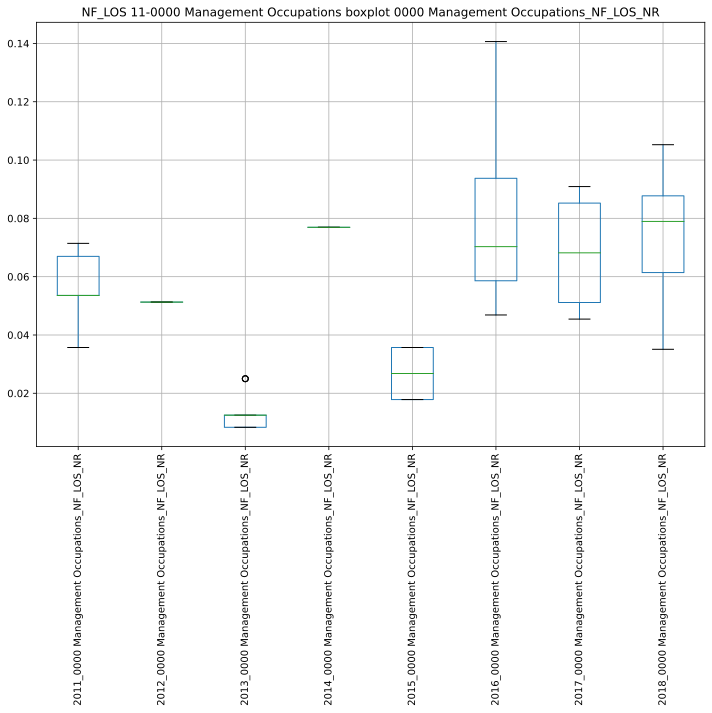

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/232837.012041:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232837.055462:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232837.262552:INFO:headless_shell.cc(660)] Written to file /tmp/tmpyo97dxa5/temp.png.
[1013/232837.477609:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232837.516931:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232837.794227:INFO:headless_shell.cc(660)] Written to file /tmp/tmpw6knmd88/temp.png.
[1013/232838.069418:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232838.108435:WARNI

,2011_0000 Management Occupations_NF_LOS_NR,2012_0000 Management Occupations_NF_LOS_NR,2013_0000 Management Occupations_NF_LOS_NR,2014_0000 Management Occupations_NF_LOS_NR,2015_0000 Management Occupations_NF_LOS_NR,2016_0000 Management Occupations_NF_LOS_NR,2017_0000 Management Occupations_NF_LOS_NR,2018_0000 Management Occupations_NF_LOS_NR
2011_0000 Management Occupations_NF_LOS_NR,1.000000,nan,-0.241523,nan,nan,0.188982,-0.547723,-0.599625
2012_0000 Management Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2013_0000 Management Occupations_NF_LOS_NR,-0.241523,nan,1.000000,nan,0.333333,0.628619,0.581914,0.944911
2014_0000 Management Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2015_0000 Management Occupations_NF_LOS_NR,nan,nan,0.333333,nan,1.000000,-1.000000,0.904534,-1.000000
2016_0000 Management Occupations_NF_LOS_NR,0.188982,nan,0.628619,nan,-1.000000,1.000000,-0.709299,0.633911
2017_0000 Management Occupations_NF_LOS_NR,-0.547723,nan,0.581914,nan,0.904534,-0.709299,1.000000,-0.218218
2018_0000 Management Occupations_NF_LOS_NR,-0.599625,nan,0.944911,nan,-1.000000,0.633911,-0.218218,1.000000


########################################## CORRELATIONS ###############################################
['11-0000 Management Occupations_NF_LOS_3to11mos', '11-0000 Management Occupations_NF_LOS_5plus', '11-0000 Management Occupations_NF_LOS_ltg3mos', '11-0000 Management Occupations_NF_LOS_1to5yr', '11-0000 Management Occupations_NF_LOS_NR']


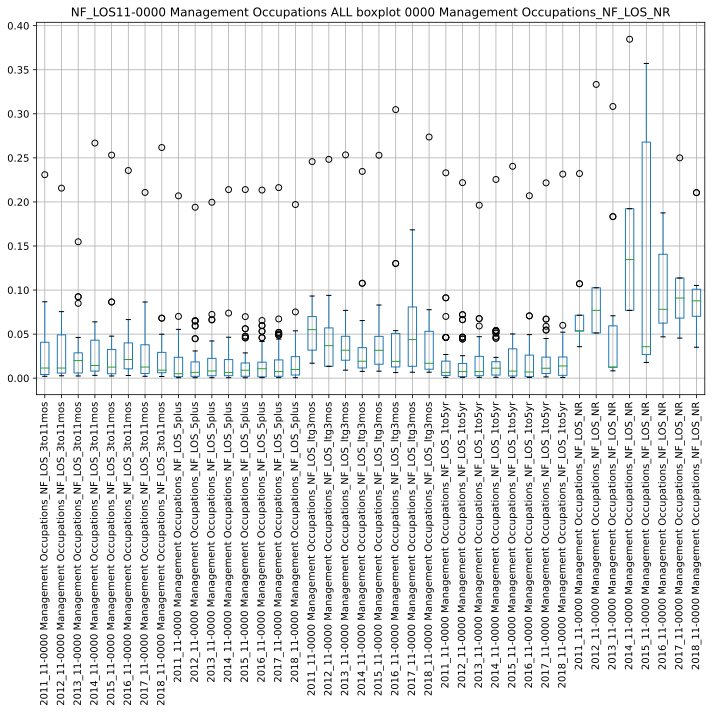

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/232842.860637:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232842.898825:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232843.243430:INFO:headless_shell.cc(660)] Written to file /tmp/tmpxnf_gz8o/temp.png.
[1013/232843.469249:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232843.510203:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232844.015228:INFO:headless_shell.cc(660)] Written to file /tmp/tmp68icvw86/temp.png.
[1013/232844.345107:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232844.382838:WARNI

,2011_11-0000 Management Occupations_NF_LOS_3to11mos,2012_11-0000 Management Occupations_NF_LOS_3to11mos,2013_11-0000 Management Occupations_NF_LOS_3to11mos,2014_11-0000 Management Occupations_NF_LOS_3to11mos,2015_11-0000 Management Occupations_NF_LOS_3to11mos,2016_11-0000 Management Occupations_NF_LOS_3to11mos,2017_11-0000 Management Occupations_NF_LOS_3to11mos,2018_11-0000 Management Occupations_NF_LOS_3to11mos,2011_11-0000 Management Occupations_NF_LOS_5plus,2012_11-0000 Management Occupations_NF_LOS_5plus,2013_11-0000 Management Occupations_NF_LOS_5plus,2014_11-0000 Management Occupations_NF_LOS_5plus,2015_11-0000 Management Occupations_NF_LOS_5plus,2016_11-0000 Management Occupations_NF_LOS_5plus,2017_11-0000 Management Occupations_NF_LOS_5plus,2018_11-0000 Management Occupations_NF_LOS_5plus,2011_11-0000 Management Occupations_NF_LOS_ltg3mos,2012_11-0000 Management Occupations_NF_LOS_ltg3mos,2013_11-0000 Management Occupations_NF_LOS_ltg3mos,2014_11-0000 Management Occupations_NF_LOS_ltg3mos,2015_11-0000 Management Occupations_NF_LOS_ltg3mos,2016_11-0000 Management Occupations_NF_LOS_ltg3mos,2017_11-0000 Management Occupations_NF_LOS_ltg3mos,2018_11-0000 Management Occupations_NF_LOS_ltg3mos,2011_11-0000 Management Occupations_NF_LOS_1to5yr,2012_11-0000 Management Occupations_NF_LOS_1to5yr,2013_11-0000 Management Occupations_NF_LOS_1to5yr,2014_11-0000 Management Occupations_NF_LOS_1to5yr,2015_11-0000 Management Occupations_NF_LOS_1to5yr,2016_11-0000 Management Occupations_NF_LOS_1to5yr,2017_11-0000 Management Occupations_NF_LOS_1to5yr,2018_11-0000 Management Occupations_NF_LOS_1to5yr,2011_11-0000 Management Occupations_NF_LOS_NR,2012_11-0000 Management Occupations_NF_LOS_NR,2013_11-0000 Management Occupations_NF_LOS_NR,2014_11-0000 Management Occupations_NF_LOS_NR,2015_11-0000 Management Occupations_NF_LOS_NR,2016_11-0000 Management Occupations_NF_LOS_NR,2017_11-0000 Management Occupations_NF_LOS_NR,2018_11-0000 Management Occupations_NF_LOS_NR
2011_11-0000 Management Occupations_NF_LOS_3to11mos,1.000000,-0.113178,0.017106,-0.095987,0.201535,-0.070146,0.310730,0.035158,-0.049342,0.032563,0.027324,0.024663,-0.015195,0.050120,0.031836,0.003641,-0.124379,-0.204226,-0.211334,-0.189240,0.040176,-0.093059,-0.171653,0.800594,-0.159439,-0.183898,0.009629,-0.147030,0.024734,0.001678,-0.036800,-0.190717,-0.278963,-0.212081,-0.133671,0.473890,0.289032,-0.379592,-0.195097,-0.344311
2012_11-0000 Management Occupations_NF_LOS_3to11mos,-0.113178,1.000000,-0.011026,0.863730,-0.152023,-0.027431,-0.128931,-0.030333,-0.090898,-0.008393,-0.087810,-0.064973,-0.037777,-0.054697,-0.037223,-0.080640,0.389269,-0.012063,-0.060298,-0.158705,-0.014505,0.003583,-0.076066,-0.178280,0.085629,0.135156,-0.045757,0.147457,-0.016351,-0.048907,-0.021635,0.105614,0.376569,0.346637,-0.095822,0.183100,-0.200534,0.351309,0.211264,0.400990
2013_11-0000 Management Occupations_NF_LOS_3to11mos,0.017106,-0.011026,1.000000,-0.077006,-0.086664,-0.280799,0.054151,-0.069530,0.091353,0.165011,0.051778,0.076027,0.057972,0.086795,0.105526,0.048486,-0.017542,-0.034221,-0.077772,0.388150,-0.157541,0.136545,-0.124394,-0.052442,0.016628,0.160252,0.171922,0.124100,0.086623,0.151751,0.016392,0.023004,0.379248,0.518103,-0.255463,0.216261,-0.568462,0.248215,-0.248786,0.198576
2014_11-0000 Management Occupations_NF_LOS_3to11mos,-0.095987,0.863730,-0.077006,1.000000,-0.068736,0.014453,-0.073851,0.194208,-0.027587,0.064819,0.057196,0.074077,0.020378,0.053670,0.095336,-0.034405,0.291659,-0.022287,-0.127327,-0.097178,-0.004620,-0.064495,-0.076896,-0.102427,-0.117049,-0.091508,0.037152,-0.052955,0.065478,-0.004078,0.079379,-0.097049,0.326554,0.524560,-0.082375,-0.210617,-0.534587,0.627404,0.033845,0.514732
2015_11-0000 Management Occupations_NF_LOS_3to11mos,0.201535,-0.152023,-0.086664,-0.068736,1.000000,0.054472,0.827191,0.169933,0.016602,-0.006381,-0.126381,0.025089,0.085859,-0.000399,0.021768,0.075265,0.168487,-0.108396,-0.164014,-0.069689,-0.162355,0.351998,0.135105,0.120316,0.0619

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
13-0000 Business and Financial Operations Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
13-0000 Business and Financial Operations Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
13-0000 Business and Financial Operations Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##############

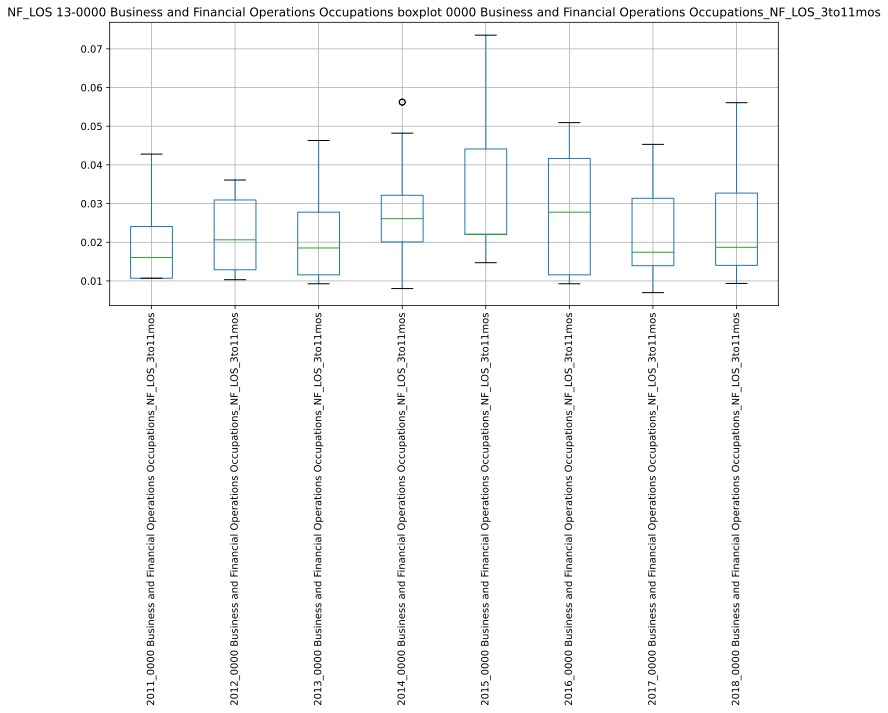

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/232913.289407:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232913.327501:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232913.562165:INFO:headless_shell.cc(660)] Written to file /tmp/tmphe_p_v9k/temp.png.
[1013/232913.791417:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232913.829054:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232914.128897:INFO:headless_shell.cc(660)] Written to file /tmp/tmpkut45e4t/temp.png.
[1013/232914.406735:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232914.448561:WARNI

,2011_0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,2012_0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,2013_0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,2014_0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,2015_0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,2016_0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,2017_0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,2018_0000 Business and Financial Operations Occupations_NF_LOS_3to11mos
2011_0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,1.000000,0.179226,-0.283958,-0.112104,0.876669,0.269632,-0.095564,-0.044573
2012_0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,0.179226,1.000000,0.565398,0.245733,0.066717,0.180588,-0.007799,0.023729
2013_0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,-0.283958,0.565398,1.000000,0.084934,-0.389535,0.121446,0.064631,0.276201
2014_0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,-0.112104,0.245733,0.084934,1.000000,0.204377,0.010674,0.206046,-0.357690
2015_0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,0.876669,0.066717,-0.389535,0.204377,1.000000,0.448994,0.125077,-0.083624
2016_0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,0.269632,0.180588,0.121446,0.010674,0.448994,1.000000,-0.037571,0.437671
2017_0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,-0.095564,-0.007799,0.064631,0.206046,0.125077,-0.037571,1.000000,0.382499
2018_0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,-0.044573,0.023729,0.276201,-0.357690,-0.083624,0.437671,0.382499,1.000000


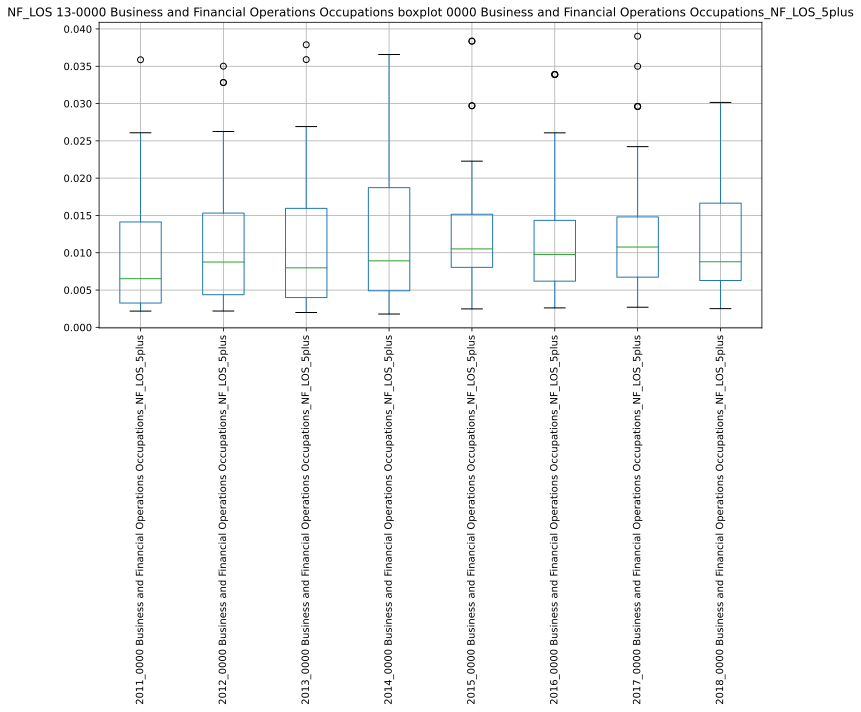

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/232918.588197:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232918.625396:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232918.868856:INFO:headless_shell.cc(660)] Written to file /tmp/tmpy9ug7ax5/temp.png.
[1013/232919.098415:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232919.139892:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232919.431042:INFO:headless_shell.cc(660)] Written to file /tmp/tmpmcf0uqo8/temp.png.
[1013/232919.699629:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232919.736795:WARNI

,2011_0000 Business and Financial Operations Occupations_NF_LOS_5plus,2012_0000 Business and Financial Operations Occupations_NF_LOS_5plus,2013_0000 Business and Financial Operations Occupations_NF_LOS_5plus,2014_0000 Business and Financial Operations Occupations_NF_LOS_5plus,2015_0000 Business and Financial Operations Occupations_NF_LOS_5plus,2016_0000 Business and Financial Operations Occupations_NF_LOS_5plus,2017_0000 Business and Financial Operations Occupations_NF_LOS_5plus,2018_0000 Business and Financial Operations Occupations_NF_LOS_5plus
2011_0000 Business and Financial Operations Occupations_NF_LOS_5plus,1.000000,0.433928,0.461519,0.370172,0.273585,0.493140,0.322106,0.270827
2012_0000 Business and Financial Operations Occupations_NF_LOS_5plus,0.433928,1.000000,-0.003058,0.630560,0.085163,0.168948,0.362971,0.128524
2013_0000 Business and Financial Operations Occupations_NF_LOS_5plus,0.461519,-0.003058,1.000000,0.222654,0.194575,0.761702,0.458216,0.627150
2014_0000 Business and Financial Operations Occupations_NF_LOS_5plus,0.370172,0.630560,0.222654,1.000000,0.458844,0.281011,0.197671,-0.031146
2015_0000 Business and Financial Operations Occupations_NF_LOS_5plus,0.273585,0.085163,0.194575,0.458844,1.000000,0.781921,0.619130,0.505638
2016_0000 Business and Financial Operations Occupations_NF_LOS_5plus,0.493140,0.168948,0.761702,0.281011,0.781921,1.000000,0.717864,0.691583
2017_0000 Business and Financial Operations Occupations_NF_LOS_5plus,0.322106,0.362971,0.458216,0.197671,0.619130,0.717864,1.000000,0.494294
2018_0000 Business and Financial Operations Occupations_NF_LOS_5plus,0.270827,0.128524,0.627150,-0.031146,0.505638,0.691583,0.494294,1.000000


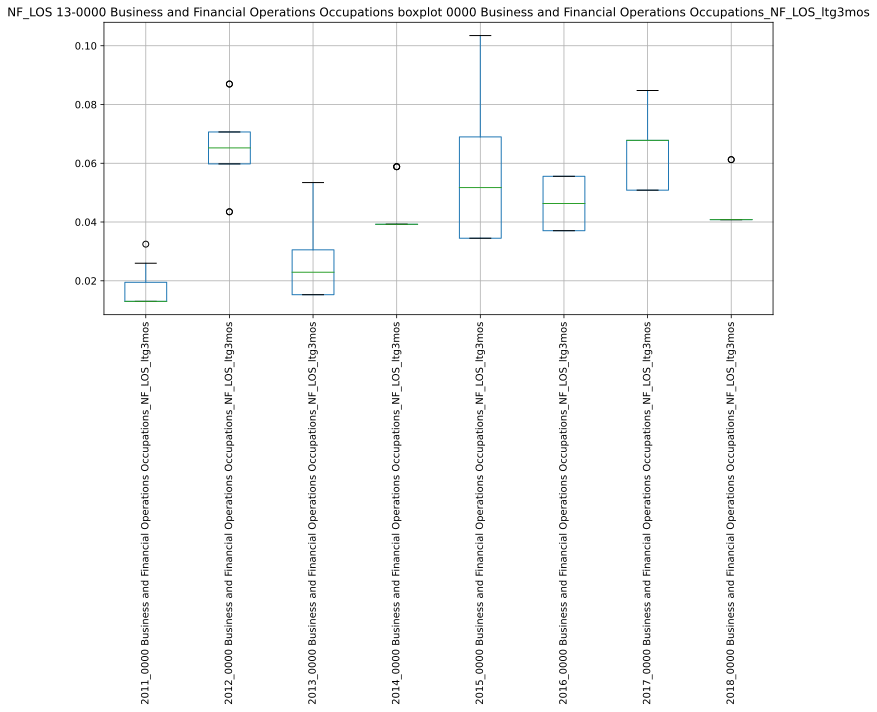

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/232922.465404:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232922.505280:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232922.713389:INFO:headless_shell.cc(660)] Written to file /tmp/tmpuvn0op_0/temp.png.
[1013/232922.929349:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232922.966363:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232923.265147:INFO:headless_shell.cc(660)] Written to file /tmp/tmpghyjiqe3/temp.png.
[1013/232923.540567:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232923.583003:WARNI

,2011_0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,2012_0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,2013_0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,2014_0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,2015_0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,2016_0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,2017_0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,2018_0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos
2011_0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,1.000000,-0.748331,0.360797,0.083333,-0.450650,0.021926,-0.295656,-0.433289
2012_0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,-0.748331,1.000000,-0.916579,nan,0.500000,0.500000,0.000000,0.141421
2013_0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,0.360797,-0.916579,1.000000,nan,-0.208791,-0.667424,-0.793725,0.026919
2014_0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,0.083333,nan,nan,1.000000,nan,nan,nan,nan
2015_0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,-0.450650,0.500000,-0.208791,nan,1.000000,-0.077267,0.190347,0.400000
2016_0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,0.021926,0.500000,-0.667424,nan,-0.077267,1.000000,0.763763,-0.447214
2017_0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,-0.295656,0.000000,-0.793725,nan,0.190347,0.763763,1.000000,0.166667
2018_0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,-0.433289,0.141421,0.026919,nan,0.400000,-0.447214,0.166667,1.000000


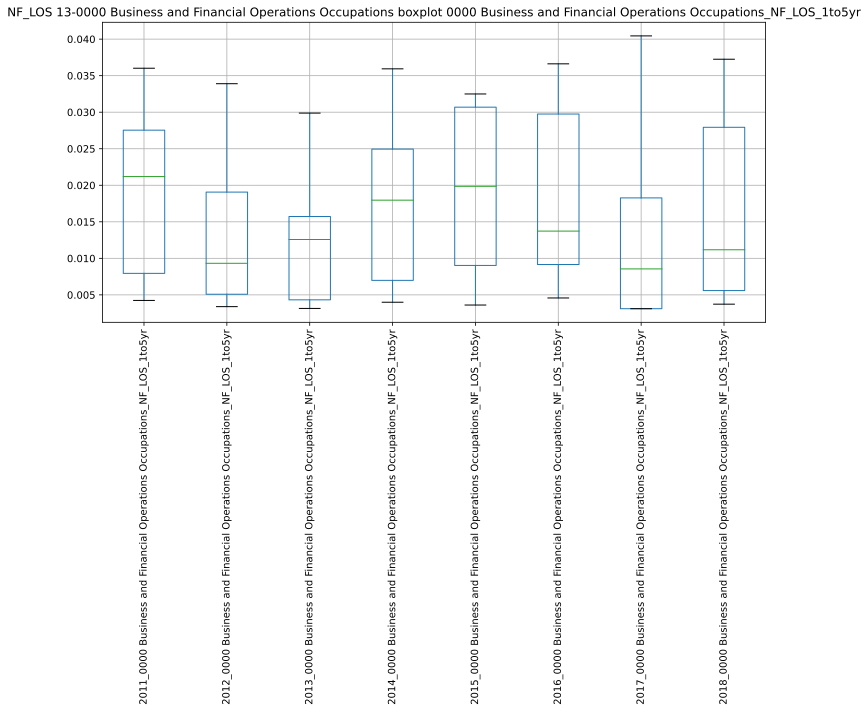

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/232927.809998:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232927.850736:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232928.063917:INFO:headless_shell.cc(660)] Written to file /tmp/tmpggqchqs4/temp.png.
[1013/232928.282329:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232928.320655:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232928.608423:INFO:headless_shell.cc(660)] Written to file /tmp/tmphjowi5jf/temp.png.
[1013/232928.870882:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232928.911680:WARNI

,2011_0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,2012_0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,2013_0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,2014_0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,2015_0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,2016_0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,2017_0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,2018_0000 Business and Financial Operations Occupations_NF_LOS_1to5yr
2011_0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,1.000000,-0.141977,0.296929,0.433049,0.492059,0.012046,0.390856,-0.177334
2012_0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,-0.141977,1.000000,0.074298,0.025035,0.217075,-0.178156,0.163696,0.742732
2013_0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,0.296929,0.074298,1.000000,0.318648,0.335286,-0.146554,-0.120441,-0.076601
2014_0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,0.433049,0.025035,0.318648,1.000000,0.414303,-0.133261,-0.027290,-0.073922
2015_0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,0.492059,0.217075,0.335286,0.414303,1.000000,0.083299,0.435422,0.185355
2016_0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,0.012046,-0.178156,-0.146554,-0.133261,0.083299,1.000000,0.560801,-0.039038
2017_0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,0.390856,0.163696,-0.120441,-0.027290,0.435422,0.560801,1.000000,0.031765
2018_0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,-0.177334,0.742732,-0.076601,-0.073922,0.185355,-0.039038,0.031765,1.000000


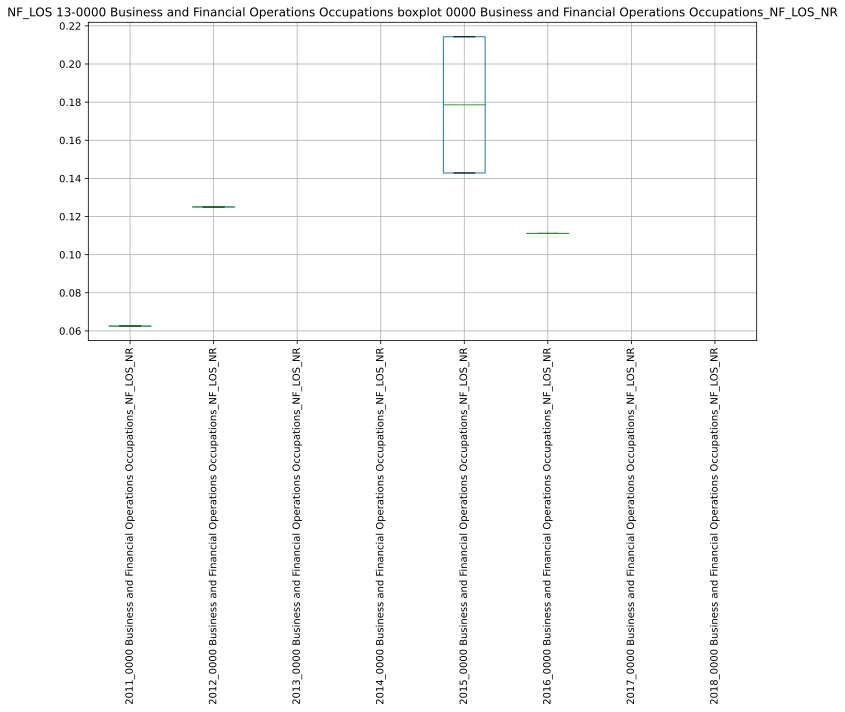

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/232932.974676:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232933.012511:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232933.244245:INFO:headless_shell.cc(660)] Written to file /tmp/tmpk4yieoaw/temp.png.
[1013/232933.471865:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232933.509315:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232933.785815:INFO:headless_shell.cc(660)] Written to file /tmp/tmpgtycko_h/temp.png.
[1013/232934.051909:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232934.091154:WARNI

,2011_0000 Business and Financial Operations Occupations_NF_LOS_NR,2012_0000 Business and Financial Operations Occupations_NF_LOS_NR,2013_0000 Business and Financial Operations Occupations_NF_LOS_NR,2014_0000 Business and Financial Operations Occupations_NF_LOS_NR,2015_0000 Business and Financial Operations Occupations_NF_LOS_NR,2016_0000 Business and Financial Operations Occupations_NF_LOS_NR,2017_0000 Business and Financial Operations Occupations_NF_LOS_NR,2018_0000 Business and Financial Operations Occupations_NF_LOS_NR
2011_0000 Business and Financial Operations Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2012_0000 Business and Financial Operations Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2013_0000 Business and Financial Operations Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2014_0000 Business and Financial Operations Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2015_0000 Business and Financial Operations Occupations_NF_LOS_NR,nan,nan,nan,nan,1.000000,nan,nan,nan
2016_0000 Business and Financial Operations Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2017_0000 Business and Financial Operations Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2018_0000 Business and Financial Operations Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan


########################################## CORRELATIONS ###############################################
['13-0000 Business and Financial Operations Occupations_NF_LOS_3to11mos', '13-0000 Business and Financial Operations Occupations_NF_LOS_5plus', '13-0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos', '13-0000 Business and Financial Operations Occupations_NF_LOS_1to5yr', '13-0000 Business and Financial Operations Occupations_NF_LOS_NR']


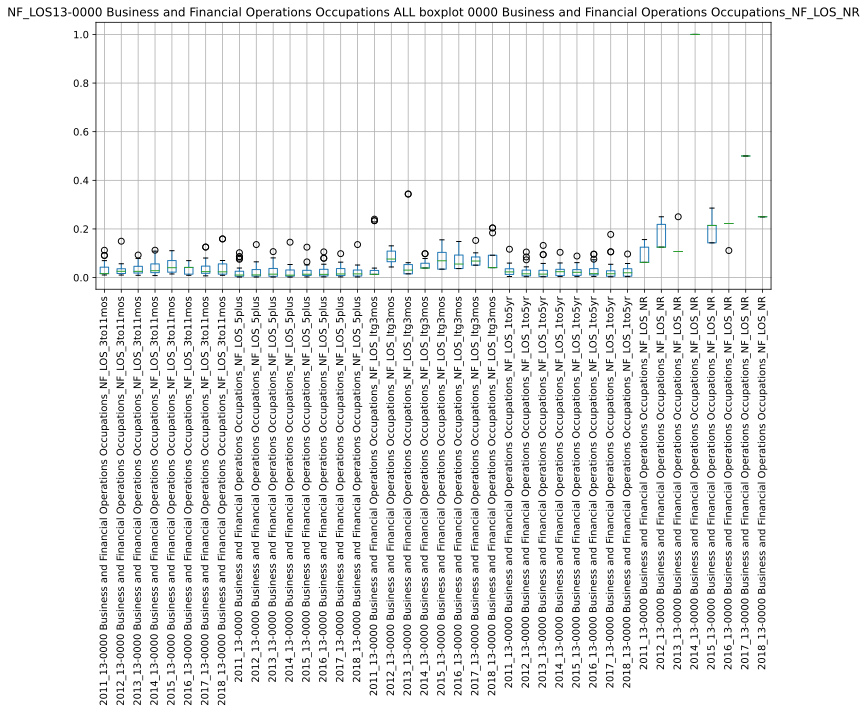

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/232938.777302:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232938.815803:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232939.141951:INFO:headless_shell.cc(660)] Written to file /tmp/tmp90j_28nv/temp.png.
[1013/232939.364265:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232939.401217:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/232939.893455:INFO:headless_shell.cc(660)] Written to file /tmp/tmp4hsh_yd3/temp.png.
[1013/232940.221356:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/232940.262701:WARNI

,2011_13-0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,2012_13-0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,2013_13-0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,2014_13-0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,2015_13-0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,2016_13-0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,2017_13-0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,2018_13-0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,2011_13-0000 Business and Financial Operations Occupations_NF_LOS_5plus,2012_13-0000 Business and Financial Operations Occupations_NF_LOS_5plus,2013_13-0000 Business and Financial Operations Occupations_NF_LOS_5plus,2014_13-0000 Business and Financial Operations Occupations_NF_LOS_5plus,2015_13-0000 Business and Financial Operations Occupations_NF_LOS_5plus,2016_13-0000 Business and Financial Operations Occupations_NF_LOS_5plus,2017_13-0000 Business and Financial Operations Occupations_NF_LOS_5plus,2018_13-0000 Business and Financial Operations Occupations_NF_LOS_5plus,2011_13-0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,2012_13-0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,2013_13-0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,2014_13-0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,2015_13-0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,2016_13-0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,2017_13-0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,2018_13-0000 Business and Financial Operations Occupations_NF_LOS_ltg3mos,2011_13-0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,2012_13-0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,2013_13-0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,2014_13-0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,2015_13-0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,2016_13-0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,2017_13-0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,2018_13-0000 Business and Financial Operations Occupations_NF_LOS_1to5yr,2011_13-0000 Business and Financial Operations Occupations_NF_LOS_NR,2012_13-0000 Business and Financial Operations Occupations_NF_LOS_NR,2013_13-0000 Business and Financial Operations Occupations_NF_LOS_NR,2014_13-0000 Business and Financial Operations Occupations_NF_LOS_NR,2015_13-0000 Business and Financial Operations Occupations_NF_LOS_NR,2016_13-0000 Business and Financial Operations Occupations_NF_LOS_NR,2017_13-0000 Business and Financial Operations Occupations_NF_LOS_NR,2018_13-0000 Business and Financial Operations Occupations_NF_LOS_NR
2011_13-0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,1.000000,-0.103259,0.105754,-0.105338,-0.015595,-0.031434,0.012475,0.159299,0.208205,-0.183881,0.191005,-0.120041,0.216376,0.294924,0.046856,0.011689,0.188547,-0.505151,0.449885,-0.495704,-0.038683,-0.122161,-0.625046,-0.133147,-0.108949,-0.029715,-0.167113,0.006165,-0.133139,0.279956,-0.075804,-0.335603,-0.297710,0.188177,0.512829,nan,0.088596,-0.662994,nan,nan
2012_13-0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,-0.103259,1.000000,0.516717,0.285662,0.419591,0.199545,0.069082,0.161773,-0.095623,-0.211909,0.011776,-0.202984,0.096042,0.040822,-0.045231,0.062417,0.133798,-0.224592,0.194634,-0.532805,0.500007,0.342216,-0.197475,-0.190232,-0.116573,-0.095974,0.294020,0.074312,0.038557,0.251620,-0.140873,-0.130303,-0.352647,0.875000,-0.024049,nan,-0.830679,0.388514,nan,nan
2013_13-0000 Business and Financial Operations Occupations_NF_LOS_3to11mos,0.105754,0.516717,1.000000,-0.070847,0.237876,-0.040187,0.080989,-0.069597,0.117816,-0.166002,0.180896,-0.154691,-0.060568,0.027387,-0.014928,-0

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
15-0000 Computer and Mathematical Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
15-0000 Computer and Mathematical Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
15-0000 Computer and Mathematical Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPA

/home/ediaz/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/ediaz/.local/lib/python3.8/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


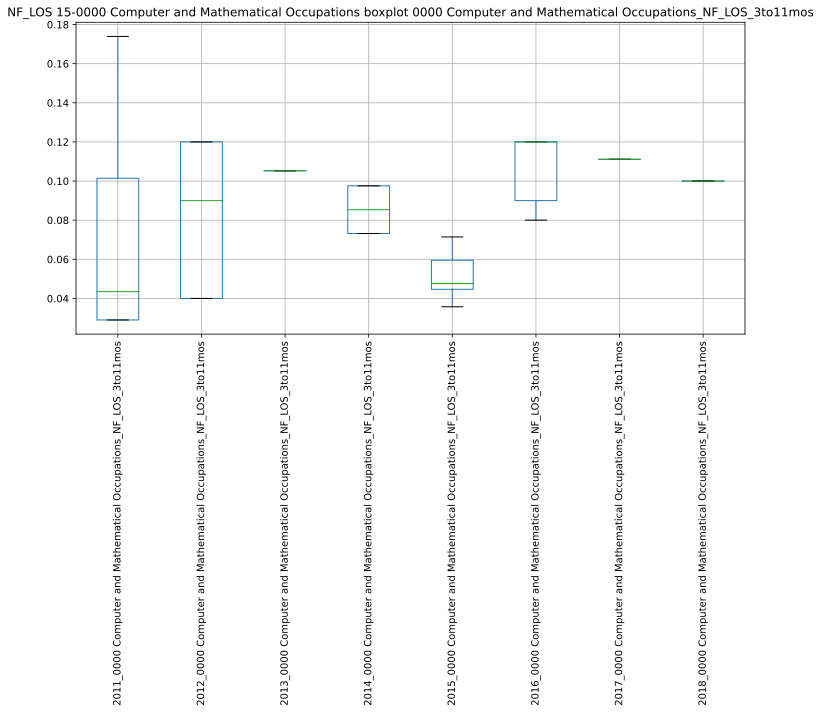

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233019.629037:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233019.666375:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233019.916739:INFO:headless_shell.cc(660)] Written to file /tmp/tmp4rtxczec/temp.png.
[1013/233020.149405:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233020.190903:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233020.505544:INFO:headless_shell.cc(660)] Written to file /tmp/tmpoij3qnmt/temp.png.
[1013/233020.765055:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233020.805643:WARNI

,2011_0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,2012_0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,2013_0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,2014_0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,2015_0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,2016_0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,2017_0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,2018_0000 Computer and Mathematical Occupations_NF_LOS_3to11mos
2011_0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,1.000000,-0.581815,nan,0.140971,0.122058,0.333333,nan,nan
2012_0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,-0.581815,1.000000,nan,-0.737210,-0.365600,-0.301511,nan,nan
2013_0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan
2014_0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,0.140971,-0.737210,nan,1.000000,0.816497,-0.166667,nan,nan
2015_0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,0.122058,-0.365600,nan,0.816497,1.000000,-0.258199,nan,nan
2016_0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,0.333333,-0.301511,nan,-0.166667,-0.258199,1.000000,nan,nan
2017_0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan
2018_0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan


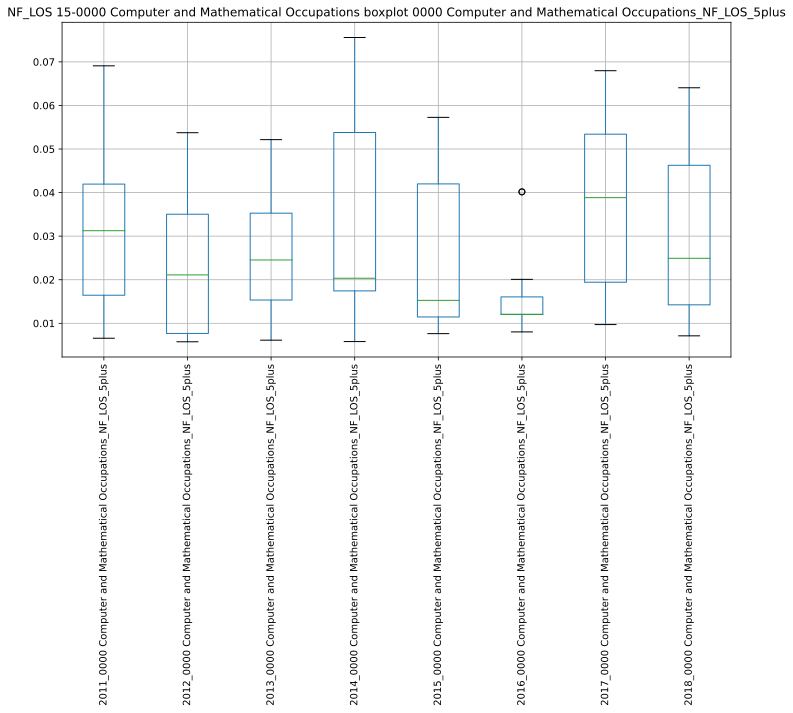

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233023.458614:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233023.496779:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233023.709018:INFO:headless_shell.cc(660)] Written to file /tmp/tmprv2l6j2m/temp.png.
[1013/233023.923533:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233023.966230:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233024.232004:INFO:headless_shell.cc(660)] Written to file /tmp/tmpkwlwkvrv/temp.png.
[1013/233024.505237:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233024.545870:WARNI

,2011_0000 Computer and Mathematical Occupations_NF_LOS_5plus,2012_0000 Computer and Mathematical Occupations_NF_LOS_5plus,2013_0000 Computer and Mathematical Occupations_NF_LOS_5plus,2014_0000 Computer and Mathematical Occupations_NF_LOS_5plus,2015_0000 Computer and Mathematical Occupations_NF_LOS_5plus,2016_0000 Computer and Mathematical Occupations_NF_LOS_5plus,2017_0000 Computer and Mathematical Occupations_NF_LOS_5plus,2018_0000 Computer and Mathematical Occupations_NF_LOS_5plus
2011_0000 Computer and Mathematical Occupations_NF_LOS_5plus,1.000000,0.953826,0.618948,0.198738,0.866919,0.777707,0.654012,0.834784
2012_0000 Computer and Mathematical Occupations_NF_LOS_5plus,0.953826,1.000000,0.752763,-0.005576,0.955952,0.932361,0.535481,0.823213
2013_0000 Computer and Mathematical Occupations_NF_LOS_5plus,0.618948,0.752763,1.000000,0.205661,0.605047,0.317332,0.237299,0.453088
2014_0000 Computer and Mathematical Occupations_NF_LOS_5plus,0.198738,-0.005576,0.205661,1.000000,0.689555,0.476959,0.510911,0.017487
2015_0000 Computer and Mathematical Occupations_NF_LOS_5plus,0.866919,0.955952,0.605047,0.689555,1.000000,0.940271,0.338494,0.402165
2016_0000 Computer and Mathematical Occupations_NF_LOS_5plus,0.777707,0.932361,0.317332,0.476959,0.940271,1.000000,0.299791,0.357674
2017_0000 Computer and Mathematical Occupations_NF_LOS_5plus,0.654012,0.535481,0.237299,0.510911,0.338494,0.299791,1.000000,0.109665
2018_0000 Computer and Mathematical Occupations_NF_LOS_5plus,0.834784,0.823213,0.453088,0.017487,0.402165,0.357674,0.109665,1.000000


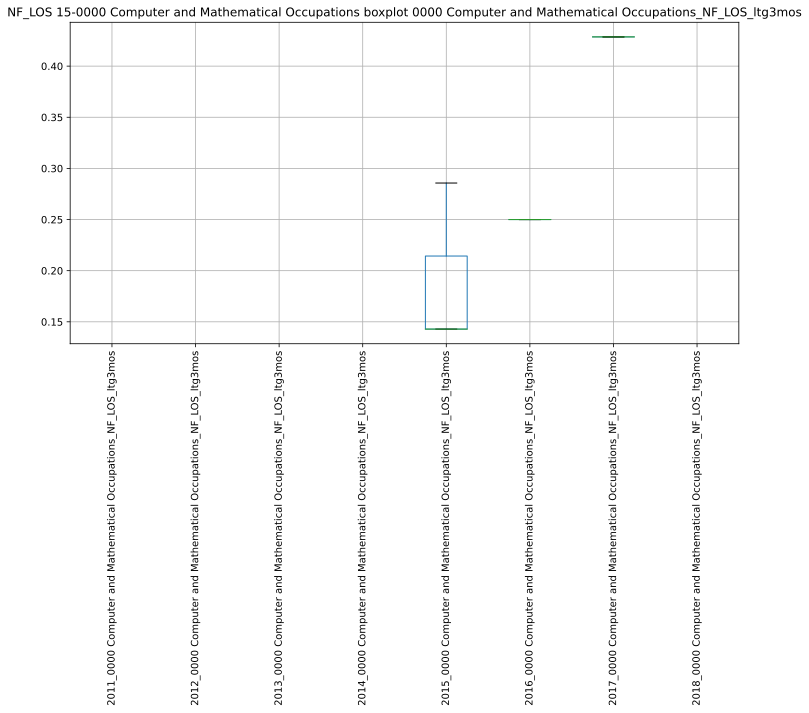

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233027.277039:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233027.319133:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233027.528743:INFO:headless_shell.cc(660)] Written to file /tmp/tmp46jx8fk4/temp.png.
[1013/233027.750866:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233027.791487:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233028.079731:INFO:headless_shell.cc(660)] Written to file /tmp/tmp7b5zznyj/temp.png.
[1013/233028.349742:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233028.378230:WARNI

,2011_0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,2012_0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,2013_0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,2014_0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,2015_0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,2016_0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,2017_0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,2018_0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos
2011_0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2012_0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2013_0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2014_0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2015_0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,1.000000,nan,nan,nan
2016_0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2017_0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2018_0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan


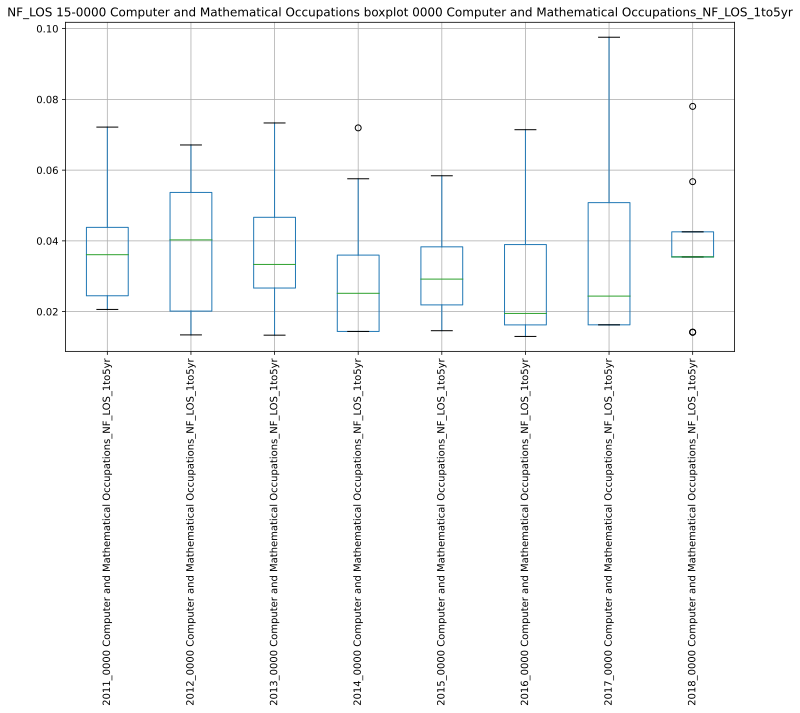

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233031.172935:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233031.216113:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233031.436976:INFO:headless_shell.cc(660)] Written to file /tmp/tmpc88tjem8/temp.png.
[1013/233031.676692:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233031.705244:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233031.993966:INFO:headless_shell.cc(660)] Written to file /tmp/tmp1wpbzyet/temp.png.
[1013/233032.265658:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233032.302288:WARNI

,2011_0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,2012_0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,2013_0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,2014_0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,2015_0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,2016_0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,2017_0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,2018_0000 Computer and Mathematical Occupations_NF_LOS_1to5yr
2011_0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,1.000000,-0.335197,-0.384683,0.113472,-0.439698,0.830474,0.189087,0.522852
2012_0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,-0.335197,1.000000,0.273466,0.009196,0.219347,0.161561,-0.469268,-0.209336
2013_0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,-0.384683,0.273466,1.000000,0.562357,0.034680,0.580163,-0.039665,-0.047990
2014_0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,0.113472,0.009196,0.562357,1.000000,-0.332468,-0.120481,0.386896,-0.588195
2015_0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,-0.439698,0.219347,0.034680,-0.332468,1.000000,-0.071502,-0.072977,-0.135665
2016_0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,0.830474,0.161561,0.580163,-0.120481,-0.071502,1.000000,0.436809,0.542115
2017_0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,0.189087,-0.469268,-0.039665,0.386896,-0.072977,0.436809,1.000000,-0.561386
2018_0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,0.522852,-0.209336,-0.047990,-0.588195,-0.135665,0.542115,-0.561386,1.000000


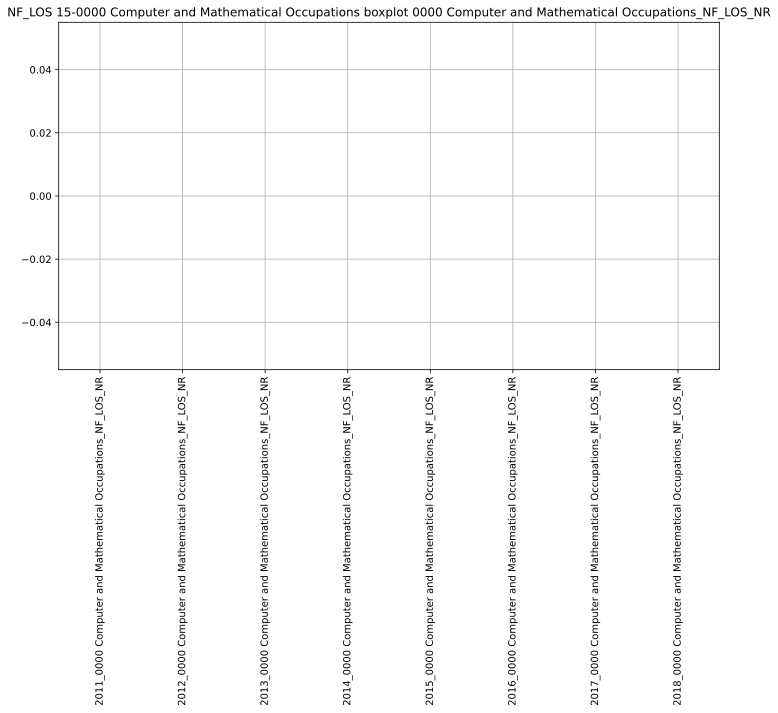

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233034.915687:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233034.953669:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233035.190955:INFO:headless_shell.cc(660)] Written to file /tmp/tmpqy97toj5/temp.png.
[1013/233035.415746:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233035.453072:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233035.752750:INFO:headless_shell.cc(660)] Written to file /tmp/tmpn7p2qnkd/temp.png.
[1013/233035.998449:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233036.035268:WARNI

,2011_0000 Computer and Mathematical Occupations_NF_LOS_NR,2012_0000 Computer and Mathematical Occupations_NF_LOS_NR,2013_0000 Computer and Mathematical Occupations_NF_LOS_NR,2014_0000 Computer and Mathematical Occupations_NF_LOS_NR,2015_0000 Computer and Mathematical Occupations_NF_LOS_NR,2016_0000 Computer and Mathematical Occupations_NF_LOS_NR,2017_0000 Computer and Mathematical Occupations_NF_LOS_NR,2018_0000 Computer and Mathematical Occupations_NF_LOS_NR
2011_0000 Computer and Mathematical Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2012_0000 Computer and Mathematical Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2013_0000 Computer and Mathematical Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2014_0000 Computer and Mathematical Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2015_0000 Computer and Mathematical Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2016_0000 Computer and Mathematical Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2017_0000 Computer and Mathematical Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2018_0000 Computer and Mathematical Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan


########################################## CORRELATIONS ###############################################
['15-0000 Computer and Mathematical Occupations_NF_LOS_3to11mos', '15-0000 Computer and Mathematical Occupations_NF_LOS_5plus', '15-0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos', '15-0000 Computer and Mathematical Occupations_NF_LOS_1to5yr', '15-0000 Computer and Mathematical Occupations_NF_LOS_NR']


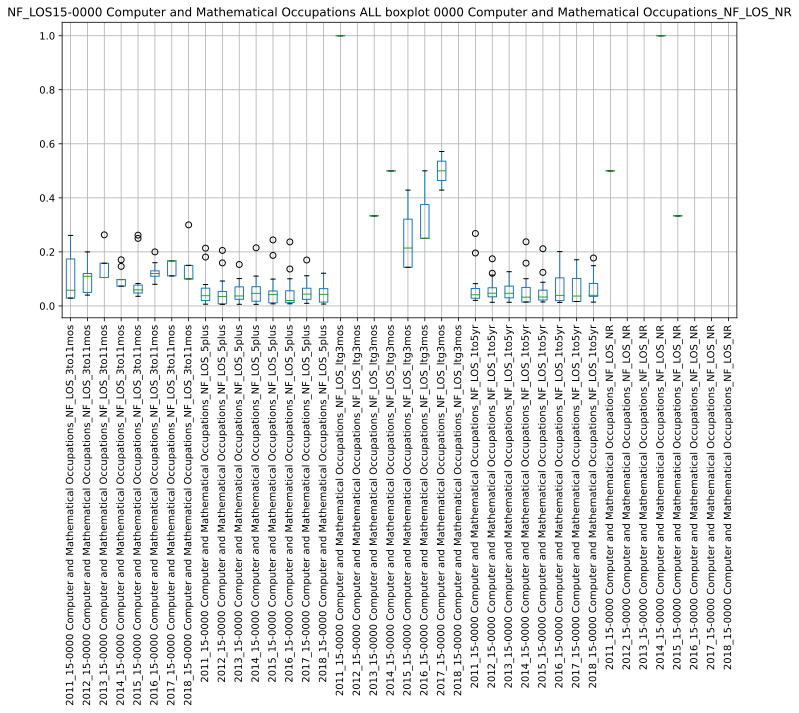

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233040.655528:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233040.692982:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233041.019442:INFO:headless_shell.cc(660)] Written to file /tmp/tmprdk2uuo6/temp.png.
[1013/233041.245998:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233041.283247:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233041.794948:INFO:headless_shell.cc(660)] Written to file /tmp/tmpojs7331z/temp.png.
[1013/233042.115936:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233042.153612:WARNI

,2011_15-0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,2012_15-0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,2013_15-0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,2014_15-0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,2015_15-0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,2016_15-0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,2017_15-0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,2018_15-0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,2011_15-0000 Computer and Mathematical Occupations_NF_LOS_5plus,2012_15-0000 Computer and Mathematical Occupations_NF_LOS_5plus,2013_15-0000 Computer and Mathematical Occupations_NF_LOS_5plus,2014_15-0000 Computer and Mathematical Occupations_NF_LOS_5plus,2015_15-0000 Computer and Mathematical Occupations_NF_LOS_5plus,2016_15-0000 Computer and Mathematical Occupations_NF_LOS_5plus,2017_15-0000 Computer and Mathematical Occupations_NF_LOS_5plus,2018_15-0000 Computer and Mathematical Occupations_NF_LOS_5plus,2011_15-0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,2012_15-0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,2013_15-0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,2014_15-0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,2015_15-0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,2016_15-0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,2017_15-0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,2018_15-0000 Computer and Mathematical Occupations_NF_LOS_ltg3mos,2011_15-0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,2012_15-0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,2013_15-0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,2014_15-0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,2015_15-0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,2016_15-0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,2017_15-0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,2018_15-0000 Computer and Mathematical Occupations_NF_LOS_1to5yr,2011_15-0000 Computer and Mathematical Occupations_NF_LOS_NR,2012_15-0000 Computer and Mathematical Occupations_NF_LOS_NR,2013_15-0000 Computer and Mathematical Occupations_NF_LOS_NR,2014_15-0000 Computer and Mathematical Occupations_NF_LOS_NR,2015_15-0000 Computer and Mathematical Occupations_NF_LOS_NR,2016_15-0000 Computer and Mathematical Occupations_NF_LOS_NR,2017_15-0000 Computer and Mathematical Occupations_NF_LOS_NR,2018_15-0000 Computer and Mathematical Occupations_NF_LOS_NR
2011_15-0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,1.000000,0.108661,-0.315470,0.391735,-0.391422,-0.345955,0.376170,-0.372496,-0.676344,-0.675533,-0.406810,-0.315157,-0.695661,-0.714542,-0.467325,-0.732169,nan,nan,nan,nan,-0.090909,0.000000,1.000000,nan,-0.164941,-0.522232,0.035849,0.134560,-0.754321,0.319978,0.174876,-0.257511,nan,nan,nan,nan,nan,nan,nan,nan
2012_15-0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,0.108661,1.000000,0.085674,0.219826,-0.119098,-0.420389,0.017834,0.442830,0.112050,0.088976,0.228553,-0.156453,-0.020430,0.049709,-0.376390,0.073315,nan,nan,nan,nan,-0.274774,0.500000,nan,nan,-0.227590,-0.213594,-0.641646,-0.425310,0.191273,-0.181104,-0.295716,-0.192831,nan,nan,nan,nan,nan,nan,nan,nan
2013_15-0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,-0.315470,0.085674,1.000000,-0.413664,0.545047,-0.660529,-0.520416,0.277735,0.432771,0.314089,0.209506,0.292329,0.317975,0.326923,0.367002,0.329752,nan,nan,nan,nan,0.738549,-0.500000,-1.000000,nan,-0.613254,0.344752,-0.472546,0.122948,-0.283311,-0.461308,-0.044819,0.250739,nan,nan,nan,nan,nan,nan,nan,nan
2014_15-0000 Computer and Mathematical Occupations_NF_LOS_3to11mos,0.391735,0.219826,-0.413664,1.000000,0.224408,0.359760,0.555556,0.020286,-0.606405,-0.580257,-0.462226,-0.339432,-0.509092,-0.568669,-0.244922,-0.558326,nan,nan,nan,nan,-0.000000,-0.500000,nan,nan,-0.114355,-0.438778,0.017911,

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
17-0000 Architecture and Engineering Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
17-0000 Architecture and Engineering Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
17-0000 Architecture and Engineering Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
##########

/home/ediaz/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/ediaz/.local/lib/python3.8/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
17-0000 Architecture and Engineering Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
17-0000 Architecture and Engineering Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
17-0000 Architecture and Engineering Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
17-0000 Architecture and Engineering Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
17-000

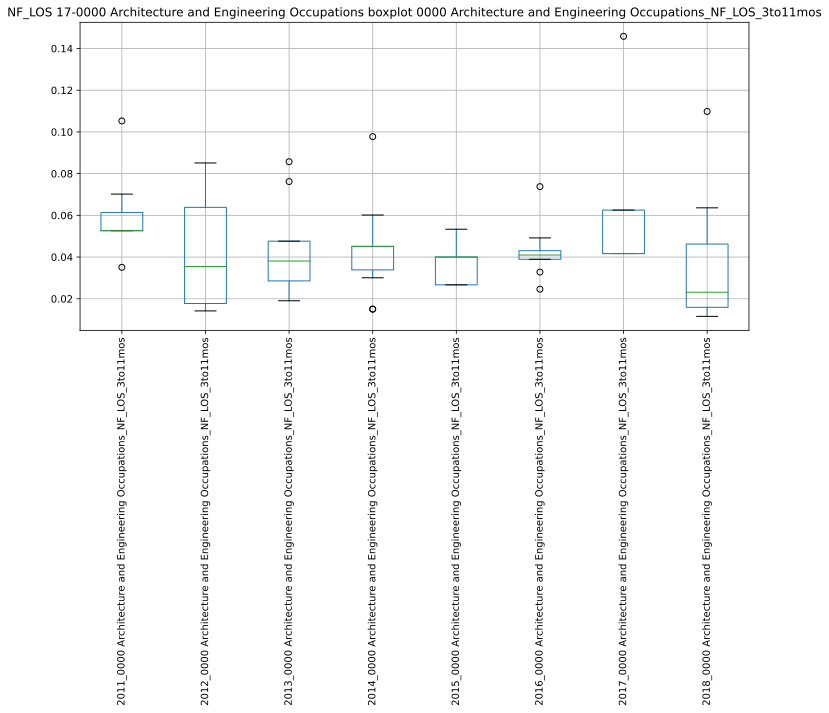

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233121.158329:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233121.197026:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233121.425232:INFO:headless_shell.cc(660)] Written to file /tmp/tmpxj62ry28/temp.png.
[1013/233121.645056:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233121.684215:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233121.943311:INFO:headless_shell.cc(660)] Written to file /tmp/tmpw0ohtyoc/temp.png.
[1013/233122.186322:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233122.224372:WARNI

,2011_0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,2012_0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,2013_0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,2014_0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,2015_0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,2016_0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,2017_0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,2018_0000 Architecture and Engineering Occupations_NF_LOS_3to11mos
2011_0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,1.000000,-0.612372,0.707107,nan,0.289122,-0.405906,-0.055480,1.000000
2012_0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,-0.612372,1.000000,-0.135187,0.453914,0.095238,0.352916,-0.531553,0.248509
2013_0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,0.707107,-0.135187,1.000000,-0.067221,-0.599479,-0.525226,0.700140,-0.483454
2014_0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,nan,0.453914,-0.067221,1.000000,0.007859,0.613696,-0.266039,0.820144
2015_0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,0.289122,0.095238,-0.599479,0.007859,1.000000,0.132453,0.570396,0.371724
2016_0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,-0.405906,0.352916,-0.525226,0.613696,0.132453,1.000000,-0.232495,0.806419
2017_0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,-0.055480,-0.531553,0.700140,-0.266039,0.570396,-0.232495,1.000000,-0.222046
2018_0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,1.000000,0.248509,-0.483454,0.820144,0.371724,0.806419,-0.222046,1.000000


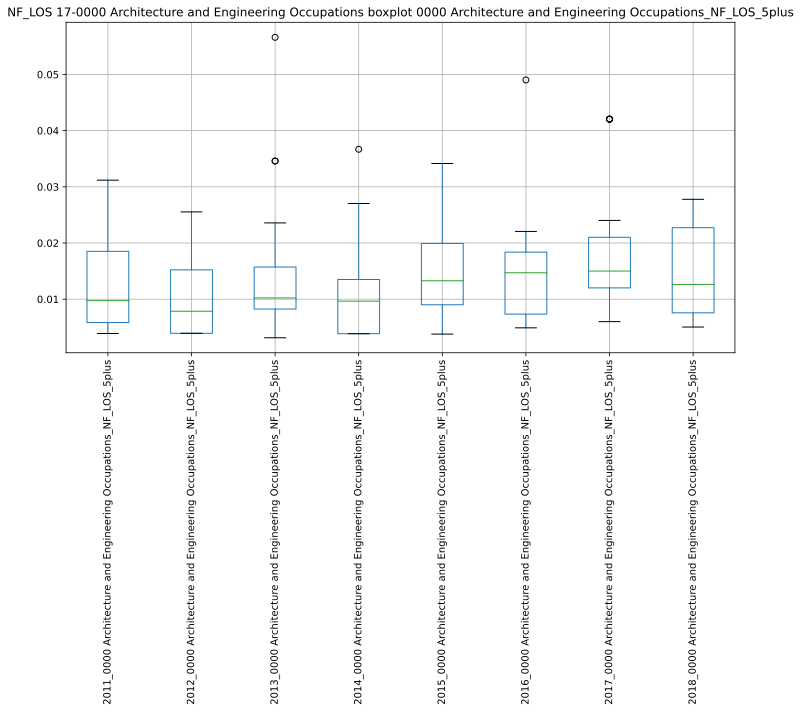

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233124.940464:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233124.978999:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233125.193986:INFO:headless_shell.cc(660)] Written to file /tmp/tmpt6yu8q85/temp.png.
[1013/233125.418922:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233125.458488:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233125.744458:INFO:headless_shell.cc(660)] Written to file /tmp/tmps9gdool4/temp.png.
[1013/233126.020978:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233126.059151:WARNI

,2011_0000 Architecture and Engineering Occupations_NF_LOS_5plus,2012_0000 Architecture and Engineering Occupations_NF_LOS_5plus,2013_0000 Architecture and Engineering Occupations_NF_LOS_5plus,2014_0000 Architecture and Engineering Occupations_NF_LOS_5plus,2015_0000 Architecture and Engineering Occupations_NF_LOS_5plus,2016_0000 Architecture and Engineering Occupations_NF_LOS_5plus,2017_0000 Architecture and Engineering Occupations_NF_LOS_5plus,2018_0000 Architecture and Engineering Occupations_NF_LOS_5plus
2011_0000 Architecture and Engineering Occupations_NF_LOS_5plus,1.000000,0.210056,0.015265,-0.089782,0.257585,0.005978,-0.309265,-0.114556
2012_0000 Architecture and Engineering Occupations_NF_LOS_5plus,0.210056,1.000000,0.108161,0.097533,0.399755,0.433549,0.195710,0.284556
2013_0000 Architecture and Engineering Occupations_NF_LOS_5plus,0.015265,0.108161,1.000000,-0.004719,0.459237,0.161684,0.055222,0.139931
2014_0000 Architecture and Engineering Occupations_NF_LOS_5plus,-0.089782,0.097533,-0.004719,1.000000,-0.246189,0.365477,0.285454,0.330958
2015_0000 Architecture and Engineering Occupations_NF_LOS_5plus,0.257585,0.399755,0.459237,-0.246189,1.000000,0.427749,-0.200646,-0.345869
2016_0000 Architecture and Engineering Occupations_NF_LOS_5plus,0.005978,0.433549,0.161684,0.365477,0.427749,1.000000,0.106832,-0.117960
2017_0000 Architecture and Engineering Occupations_NF_LOS_5plus,-0.309265,0.195710,0.055222,0.285454,-0.200646,0.106832,1.000000,0.454898
2018_0000 Architecture and Engineering Occupations_NF_LOS_5plus,-0.114556,0.284556,0.139931,0.330958,-0.345869,-0.117960,0.454898,1.000000


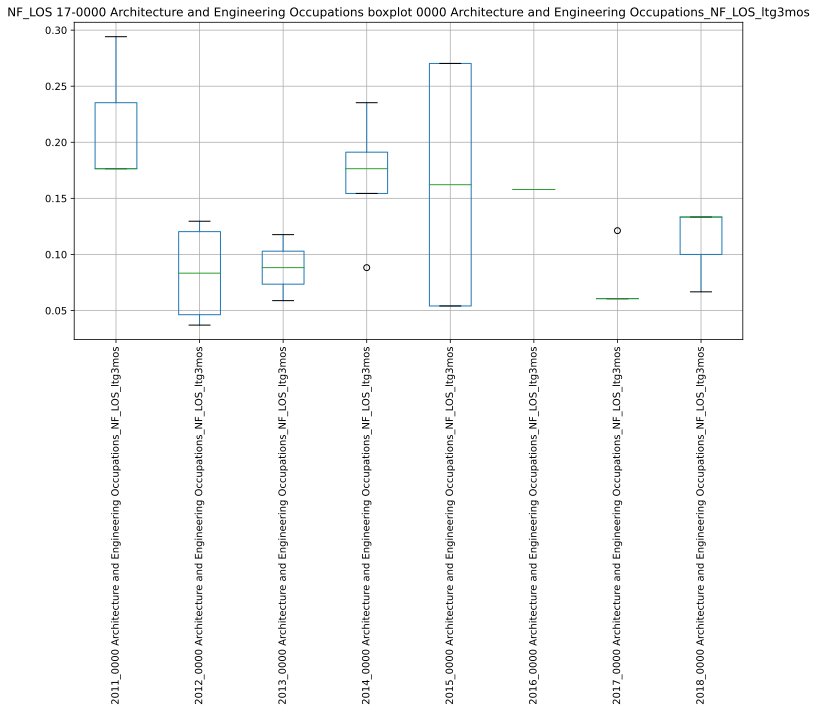

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233128.785281:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233128.823222:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233129.051098:INFO:headless_shell.cc(660)] Written to file /tmp/tmpy9cx4zd6/temp.png.
[1013/233129.273133:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233129.312057:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233129.605945:INFO:headless_shell.cc(660)] Written to file /tmp/tmpe6bkxk05/temp.png.
[1013/233129.877553:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233129.915405:WARNI

,2011_0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,2012_0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,2013_0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,2014_0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,2015_0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,2016_0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,2017_0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,2018_0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos
2011_0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,1.000000,nan,nan,1.000000,1.000000,nan,nan,-1.000000
2012_0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,nan,1.000000,nan,-1.000000,1.000000,nan,-0.755929,nan
2013_0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,nan,nan,1.000000,nan,nan,nan,nan,nan
2014_0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,1.000000,-1.000000,nan,1.000000,-0.140028,nan,-1.000000,-1.000000
2015_0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,1.000000,1.000000,nan,-0.140028,1.000000,nan,nan,-1.000000
2016_0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2017_0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,nan,-0.755929,nan,-1.000000,nan,nan,1.000000,nan
2018_0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,-1.000000,nan,nan,-1.000000,-1.000000,nan,nan,1.000000


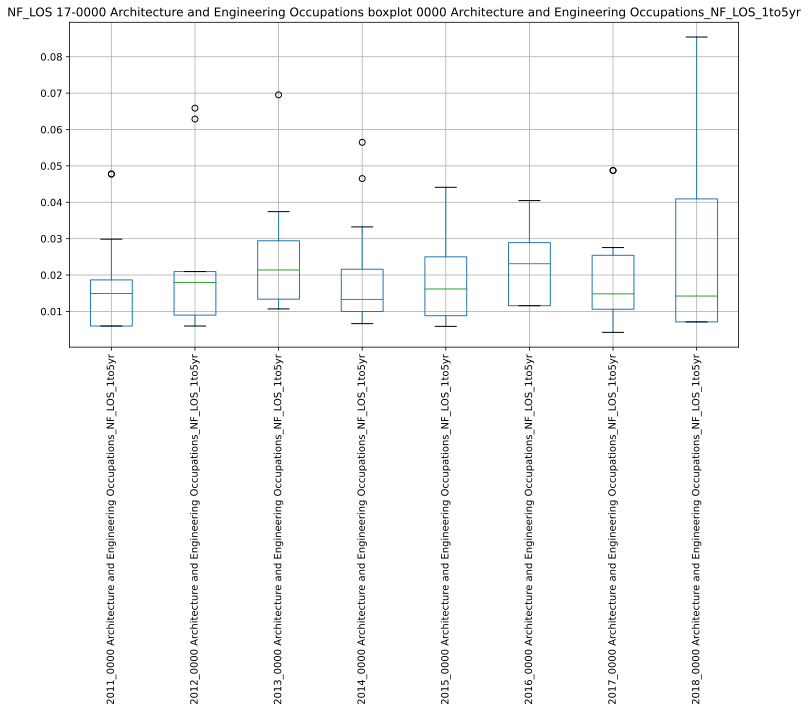

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233132.752513:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233132.792776:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233133.015975:INFO:headless_shell.cc(660)] Written to file /tmp/tmpnt4f5n_9/temp.png.
[1013/233133.251109:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233133.288708:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233133.573189:INFO:headless_shell.cc(660)] Written to file /tmp/tmpag7uk7wr/temp.png.
[1013/233133.851342:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233133.888468:WARNI

,2011_0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,2012_0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,2013_0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,2014_0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,2015_0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,2016_0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,2017_0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,2018_0000 Architecture and Engineering Occupations_NF_LOS_1to5yr
2011_0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,1.000000,-0.053762,0.091351,-0.411211,-0.013603,-0.282311,0.256635,-0.768799
2012_0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,-0.053762,1.000000,-0.144164,0.767277,0.107207,0.547799,0.026885,-0.105978
2013_0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,0.091351,-0.144164,1.000000,-0.539906,-0.225600,0.208010,-0.082629,-0.162165
2014_0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,-0.411211,0.767277,-0.539906,1.000000,-0.256915,0.005474,0.223792,0.451448
2015_0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,-0.013603,0.107207,-0.225600,-0.256915,1.000000,-0.052285,0.112800,-0.128892
2016_0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,-0.282311,0.547799,0.208010,0.005474,-0.052285,1.000000,0.153348,0.065551
2017_0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,0.256635,0.026885,-0.082629,0.223792,0.112800,0.153348,1.000000,-0.341972
2018_0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,-0.768799,-0.105978,-0.162165,0.451448,-0.128892,0.065551,-0.341972,1.000000


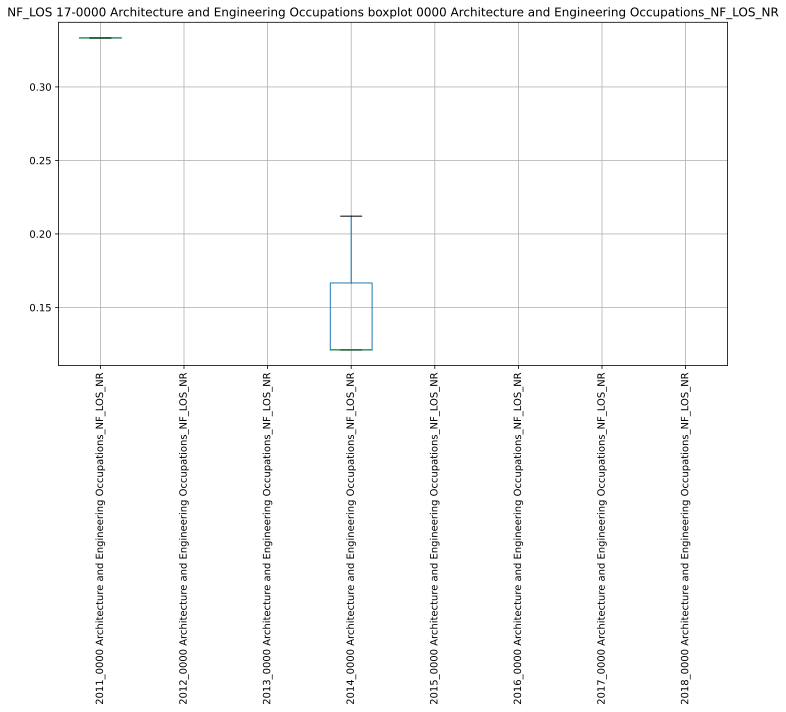

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233136.637043:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233136.674216:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233136.893942:INFO:headless_shell.cc(660)] Written to file /tmp/tmpp37vc2cr/temp.png.
[1013/233137.104344:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233137.141003:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233137.413492:INFO:headless_shell.cc(660)] Written to file /tmp/tmpjcpuhhdg/temp.png.
[1013/233137.674595:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233137.712479:WARNI

,2011_0000 Architecture and Engineering Occupations_NF_LOS_NR,2012_0000 Architecture and Engineering Occupations_NF_LOS_NR,2013_0000 Architecture and Engineering Occupations_NF_LOS_NR,2014_0000 Architecture and Engineering Occupations_NF_LOS_NR,2015_0000 Architecture and Engineering Occupations_NF_LOS_NR,2016_0000 Architecture and Engineering Occupations_NF_LOS_NR,2017_0000 Architecture and Engineering Occupations_NF_LOS_NR,2018_0000 Architecture and Engineering Occupations_NF_LOS_NR
2011_0000 Architecture and Engineering Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2012_0000 Architecture and Engineering Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2013_0000 Architecture and Engineering Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2014_0000 Architecture and Engineering Occupations_NF_LOS_NR,nan,nan,nan,1.000000,nan,nan,nan,nan
2015_0000 Architecture and Engineering Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2016_0000 Architecture and Engineering Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2017_0000 Architecture and Engineering Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2018_0000 Architecture and Engineering Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan


########################################## CORRELATIONS ###############################################
['17-0000 Architecture and Engineering Occupations_NF_LOS_3to11mos', '17-0000 Architecture and Engineering Occupations_NF_LOS_5plus', '17-0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos', '17-0000 Architecture and Engineering Occupations_NF_LOS_1to5yr', '17-0000 Architecture and Engineering Occupations_NF_LOS_NR']


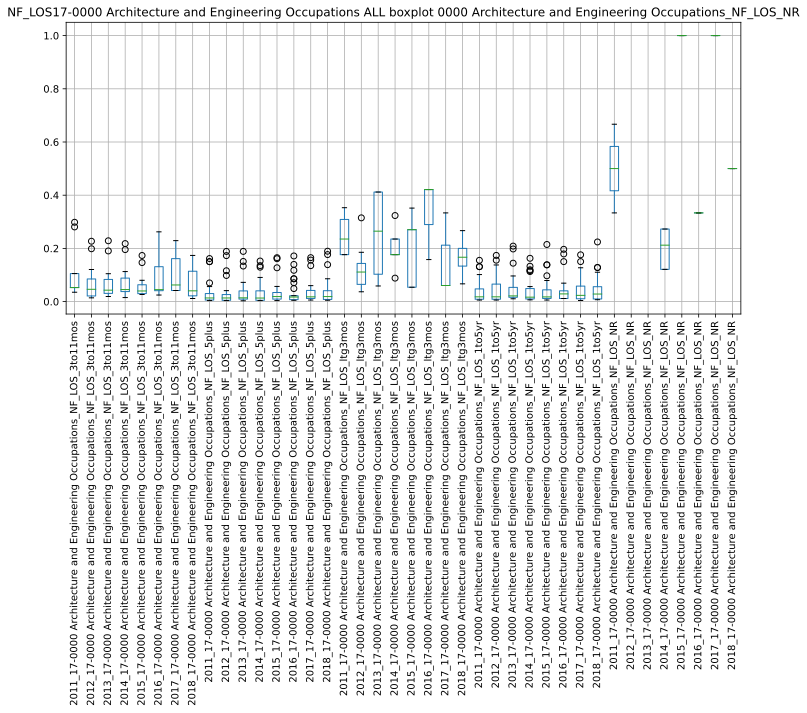

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233142.326438:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233142.364322:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233142.700059:INFO:headless_shell.cc(660)] Written to file /tmp/tmp6sdli8g_/temp.png.
[1013/233142.936572:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233142.974409:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233143.492109:INFO:headless_shell.cc(660)] Written to file /tmp/tmp7zgarjfo/temp.png.
[1013/233143.820240:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233143.858762:WARNI

,2011_17-0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,2012_17-0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,2013_17-0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,2014_17-0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,2015_17-0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,2016_17-0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,2017_17-0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,2018_17-0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,2011_17-0000 Architecture and Engineering Occupations_NF_LOS_5plus,2012_17-0000 Architecture and Engineering Occupations_NF_LOS_5plus,2013_17-0000 Architecture and Engineering Occupations_NF_LOS_5plus,2014_17-0000 Architecture and Engineering Occupations_NF_LOS_5plus,2015_17-0000 Architecture and Engineering Occupations_NF_LOS_5plus,2016_17-0000 Architecture and Engineering Occupations_NF_LOS_5plus,2017_17-0000 Architecture and Engineering Occupations_NF_LOS_5plus,2018_17-0000 Architecture and Engineering Occupations_NF_LOS_5plus,2011_17-0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,2012_17-0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,2013_17-0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,2014_17-0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,2015_17-0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,2016_17-0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,2017_17-0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,2018_17-0000 Architecture and Engineering Occupations_NF_LOS_ltg3mos,2011_17-0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,2012_17-0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,2013_17-0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,2014_17-0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,2015_17-0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,2016_17-0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,2017_17-0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,2018_17-0000 Architecture and Engineering Occupations_NF_LOS_1to5yr,2011_17-0000 Architecture and Engineering Occupations_NF_LOS_NR,2012_17-0000 Architecture and Engineering Occupations_NF_LOS_NR,2013_17-0000 Architecture and Engineering Occupations_NF_LOS_NR,2014_17-0000 Architecture and Engineering Occupations_NF_LOS_NR,2015_17-0000 Architecture and Engineering Occupations_NF_LOS_NR,2016_17-0000 Architecture and Engineering Occupations_NF_LOS_NR,2017_17-0000 Architecture and Engineering Occupations_NF_LOS_NR,2018_17-0000 Architecture and Engineering Occupations_NF_LOS_NR
2011_17-0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,1.000000,-0.116840,-0.273465,-0.315411,-0.180044,-0.365766,0.197773,-0.341910,-0.130179,0.642426,-0.184974,-0.386364,0.614076,-0.413869,-0.239852,-0.323397,0.363555,0.058617,-0.699454,-0.354829,0.489851,-0.500000,-0.351718,-0.367389,-0.407113,-0.430112,-0.190821,-0.569427,0.466537,-0.336590,0.267993,-0.381931,-1.000000,nan,nan,0.542853,nan,nan,nan,nan
2012_17-0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,-0.116840,1.000000,0.185144,0.413661,-0.173999,-0.344229,-0.321782,0.735865,-0.047658,-0.261112,-0.134292,0.034627,-0.285931,-0.028584,-0.015524,0.074317,-0.588505,-0.074888,0.858694,0.233080,-0.657408,1.000000,0.784565,-0.045114,0.101658,-0.252042,-0.071247,0.041178,-0.111993,-0.022890,-0.106881,-0.112185,nan,nan,nan,-0.681958,nan,nan,nan,nan
2013_17-0000 Architecture and Engineering Occupations_NF_LOS_3to11mos,-0.273465,0.185144,1.000000,0.903656,-0.073187,0.154953,-0.413071,0.124752,-0.141944,-0.366420,0.120627,-0.122964,-0.254982,-0.128472,0.010146,0.061475,0.848679,0.347591,-0.572849,0.844461,0.667926,-1.000000,-0.511436,0.701711,-0.189437,0.011939,0.271433,-0.218827,-0.109818,0.194860,0.045512,-0.003744,nan,nan,nan,0.615947,nan,nan,nan,nan
2014_17-0000 Architecture and Engineering Occ

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
19-0000 Life, Physical, and Social Science Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
19-0000 Life, Physical, and Social Science Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
19-0000 Life, Physical, and Social Science Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ###########

/home/ediaz/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/ediaz/.local/lib/python3.8/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
19-0000 Life, Physical, and Social Science Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
19-0000 Life, Physical, and Social Science Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
19-0000 Life, Physical, and Social Science Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
19-0000 Life, Physical, and Social Science Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPA

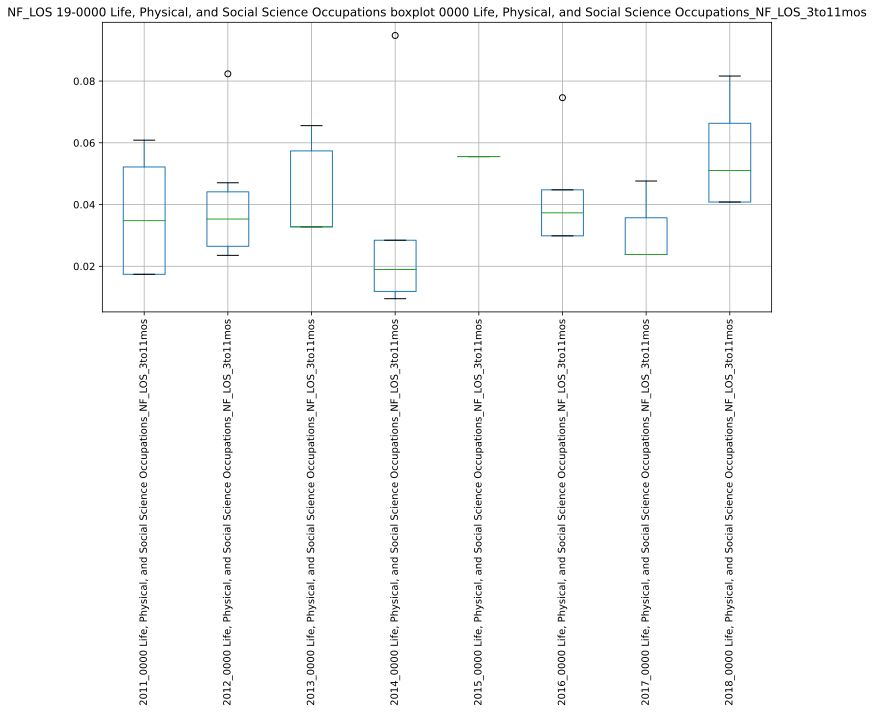

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233223.289338:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233223.326672:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233223.545080:INFO:headless_shell.cc(660)] Written to file /tmp/tmpe0ensn06/temp.png.
[1013/233223.779957:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233223.821761:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233224.141913:INFO:headless_shell.cc(660)] Written to file /tmp/tmp40x5wke6/temp.png.
[1013/233224.404876:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233224.442550:WARNI

,"2011_0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos","2012_0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos","2013_0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos","2014_0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos","2015_0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos","2016_0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos","2017_0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos","2018_0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos"
"2011_0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos",1.000000,-0.755929,0.187317,-0.853057,nan,0.393788,0.492659,0.714590
"2012_0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos",-0.755929,1.000000,-0.632456,-0.106012,nan,-0.220863,-0.534522,-0.577350
"2013_0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos",0.187317,-0.632456,1.000000,-0.059761,nan,-0.349215,0.592157,-0.872872
"2014_0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos",-0.853057,-0.106012,-0.059761,1.000000,nan,0.360032,-0.255686,-0.515270
"2015_0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos",nan,nan,nan,nan,nan,nan,nan,nan
"2016_0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos",0.393788,-0.220863,-0.349215,0.360032,nan,1.000000,0.044901,0.415227
"2017_0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos",0.492659,-0.534522,0.592157,-0.255686,nan,0.044901,1.000000,0.174078
"2018_0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos",0.714590,-0.577350,-0.872872,-0.515270,nan,0.415227,0.174078,1.000000


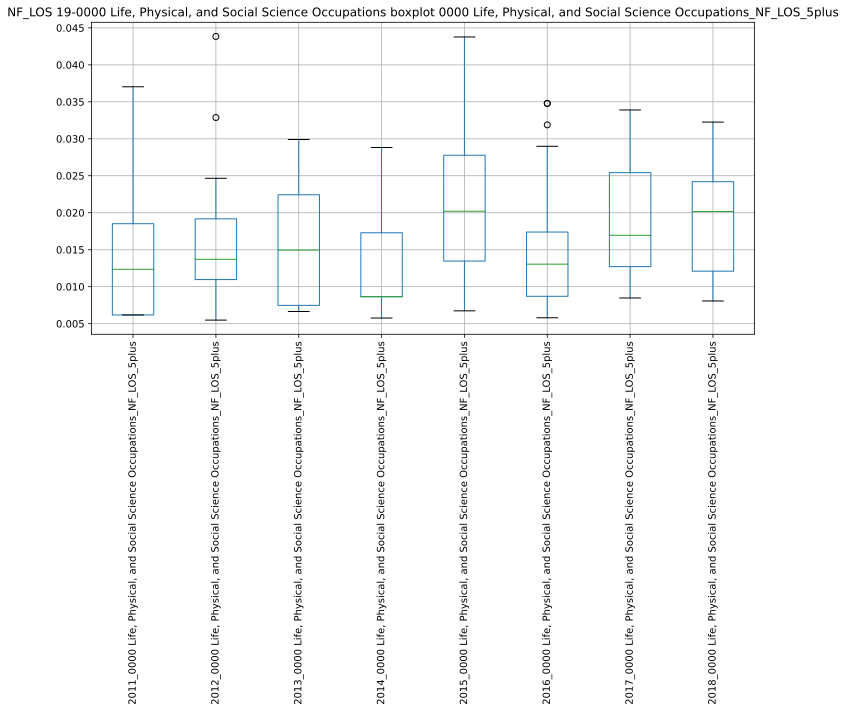

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233228.537784:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233228.580050:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233228.792524:INFO:headless_shell.cc(660)] Written to file /tmp/tmpefkpsdz1/temp.png.
[1013/233229.008850:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233229.048249:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233229.343446:INFO:headless_shell.cc(660)] Written to file /tmp/tmpbx5z78yw/temp.png.
[1013/233229.611170:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233229.656582:WARNI

,"2011_0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus","2012_0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus","2013_0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus","2014_0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus","2015_0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus","2016_0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus","2017_0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus","2018_0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus"
"2011_0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus",1.000000,0.068634,-0.085209,-0.035098,0.295254,0.128726,0.083766,0.420299
"2012_0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus",0.068634,1.000000,0.083801,-0.286230,0.311056,-0.053225,0.388302,0.345499
"2013_0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus",-0.085209,0.083801,1.000000,0.188565,-0.096001,0.049415,0.189134,0.297602
"2014_0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus",-0.035098,-0.286230,0.188565,1.000000,-0.668695,-0.162877,-0.057241,0.338962
"2015_0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus",0.295254,0.311056,-0.096001,-0.668695,1.000000,0.150477,0.505715,-0.205048
"2016_0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus",0.128726,-0.053225,0.049415,-0.162877,0.150477,1.000000,-0.329278,-0.578990
"2017_0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus",0.083766,0.388302,0.189134,-0.057241,0.505715,-0.329278,1.000000,0.372761
"2018_0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus",0.420299,0.345499,0.297602,0.338962,-0.205048,-0.578990,0.372761,1.000000


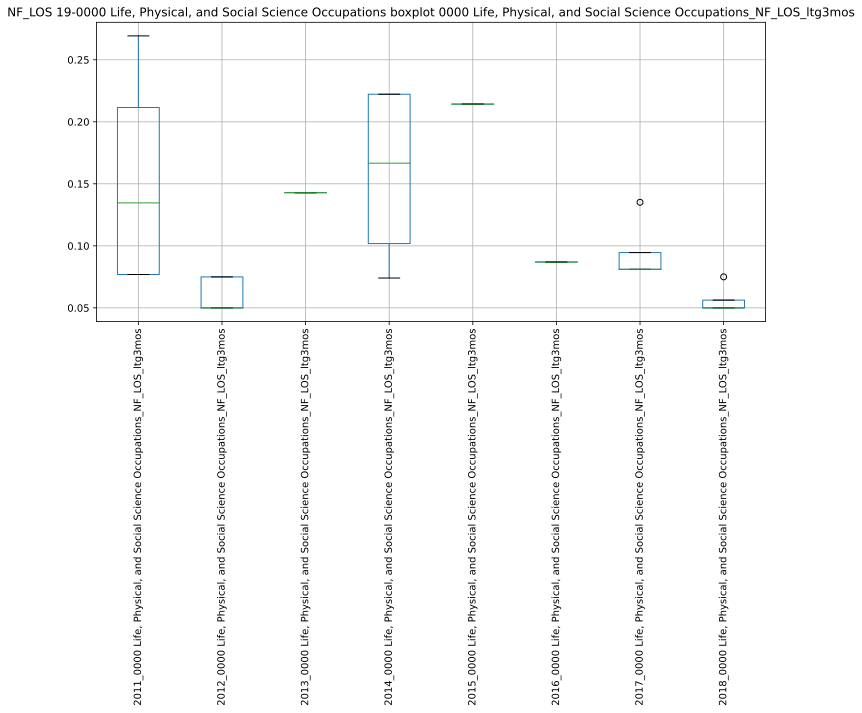

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233232.342011:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233232.379820:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233232.590667:INFO:headless_shell.cc(660)] Written to file /tmp/tmpz5dyzaf2/temp.png.
[1013/233232.807634:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233232.849050:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233233.138803:INFO:headless_shell.cc(660)] Written to file /tmp/tmpggcrmdyw/temp.png.
[1013/233233.402345:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233233.439882:WARNI

,"2011_0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos","2012_0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos","2013_0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos","2014_0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos","2015_0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos","2016_0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos","2017_0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos","2018_0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos"
"2011_0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos",1.000000,nan,nan,0.924138,nan,nan,1.000000,nan
"2012_0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos",nan,1.000000,nan,nan,nan,nan,nan,nan
"2013_0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos",nan,nan,nan,nan,nan,nan,nan,nan
"2014_0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos",0.924138,nan,nan,1.000000,nan,nan,0.970725,nan
"2015_0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos",nan,nan,nan,nan,nan,nan,nan,nan
"2016_0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos",nan,nan,nan,nan,nan,nan,nan,nan
"2017_0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos",1.000000,nan,nan,0.970725,nan,nan,1.000000,-1.000000
"2018_0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos",nan,nan,nan,nan,nan,nan,-1.000000,1.000000


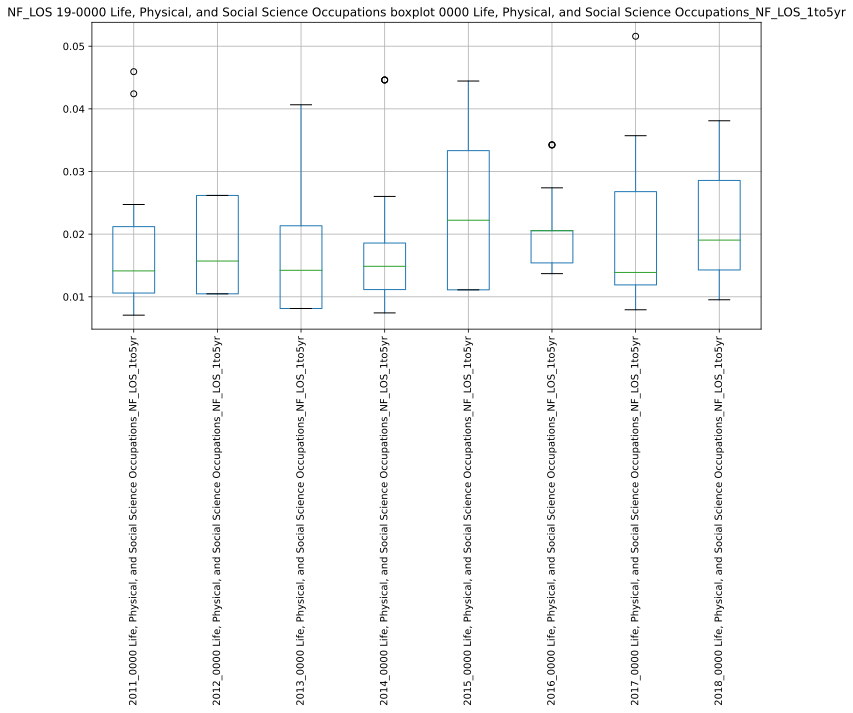

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233237.568637:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233237.607032:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233237.823875:INFO:headless_shell.cc(660)] Written to file /tmp/tmpqg5ll3mu/temp.png.
[1013/233238.045845:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233238.083258:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233238.389603:INFO:headless_shell.cc(660)] Written to file /tmp/tmpuuboi9lt/temp.png.
[1013/233238.657612:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233238.694226:WARNI

,"2011_0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr","2012_0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr","2013_0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr","2014_0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr","2015_0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr","2016_0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr","2017_0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr","2018_0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr"
"2011_0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr",1.000000,0.167293,0.084262,-0.248554,-0.081482,-0.285321,0.282671,-0.152483
"2012_0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr",0.167293,1.000000,-0.045584,0.430801,0.237356,-0.088432,0.070063,-0.016817
"2013_0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr",0.084262,-0.045584,1.000000,-0.189451,-0.059621,0.059791,-0.383290,-0.360342
"2014_0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr",-0.248554,0.430801,-0.189451,1.000000,-0.199983,-0.088658,0.180121,0.292032
"2015_0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr",-0.081482,0.237356,-0.059621,-0.199983,1.000000,-0.207224,-0.087676,-0.032216
"2016_0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr",-0.285321,-0.088432,0.059791,-0.088658,-0.207224,1.000000,0.076702,-0.023076
"2017_0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr",0.282671,0.070063,-0.383290,0.180121,-0.087676,0.076702,1.000000,0.266626
"2018_0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr",-0.152483,-0.016817,-0.360342,0.292032,-0.032216,-0.023076,0.266626,1.000000


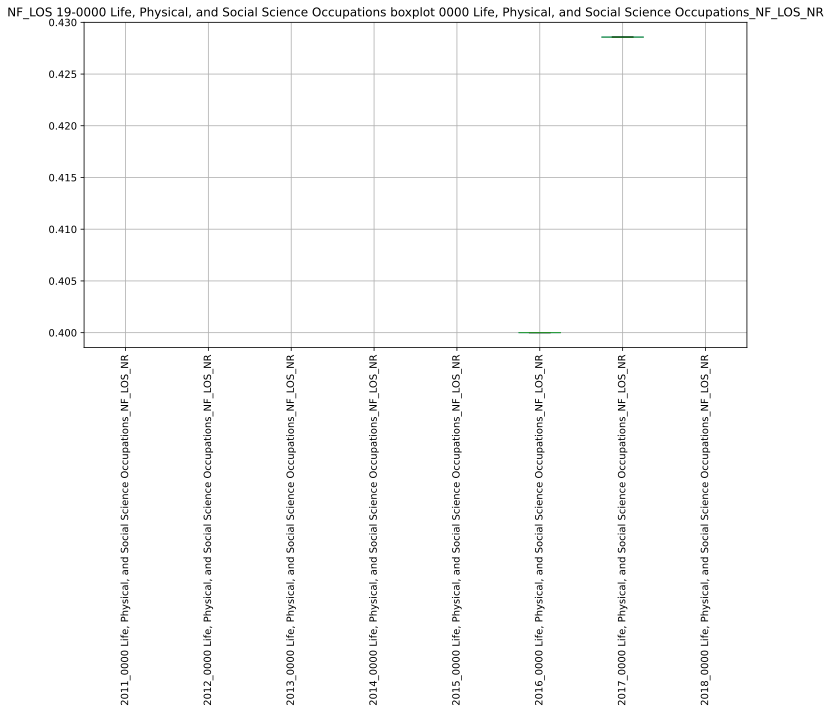

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233241.430793:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233241.471304:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233241.677098:INFO:headless_shell.cc(660)] Written to file /tmp/tmpd2gau0ow/temp.png.
[1013/233241.896819:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233241.935301:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233242.231620:INFO:headless_shell.cc(660)] Written to file /tmp/tmpqezftsqy/temp.png.
[1013/233242.503506:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233242.540808:WARNI

,"2011_0000 Life, Physical, and Social Science Occupations_NF_LOS_NR","2012_0000 Life, Physical, and Social Science Occupations_NF_LOS_NR","2013_0000 Life, Physical, and Social Science Occupations_NF_LOS_NR","2014_0000 Life, Physical, and Social Science Occupations_NF_LOS_NR","2015_0000 Life, Physical, and Social Science Occupations_NF_LOS_NR","2016_0000 Life, Physical, and Social Science Occupations_NF_LOS_NR","2017_0000 Life, Physical, and Social Science Occupations_NF_LOS_NR","2018_0000 Life, Physical, and Social Science Occupations_NF_LOS_NR"
"2011_0000 Life, Physical, and Social Science Occupations_NF_LOS_NR",nan,nan,nan,nan,nan,nan,nan,nan
"2012_0000 Life, Physical, and Social Science Occupations_NF_LOS_NR",nan,nan,nan,nan,nan,nan,nan,nan
"2013_0000 Life, Physical, and Social Science Occupations_NF_LOS_NR",nan,nan,nan,nan,nan,nan,nan,nan
"2014_0000 Life, Physical, and Social Science Occupations_NF_LOS_NR",nan,nan,nan,nan,nan,nan,nan,nan
"2015_0000 Life, Physical, and Social Science Occupations_NF_LOS_NR",nan,nan,nan,nan,nan,nan,nan,nan
"2016_0000 Life, Physical, and Social Science Occupations_NF_LOS_NR",nan,nan,nan,nan,nan,nan,nan,nan
"2017_0000 Life, Physical, and Social Science Occupations_NF_LOS_NR",nan,nan,nan,nan,nan,nan,nan,nan
"2018_0000 Life, Physical, and Social Science Occupations_NF_LOS_NR",nan,nan,nan,nan,nan,nan,nan,nan


########################################## CORRELATIONS ###############################################
['19-0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos', '19-0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus', '19-0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos', '19-0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr', '19-0000 Life, Physical, and Social Science Occupations_NF_LOS_NR']


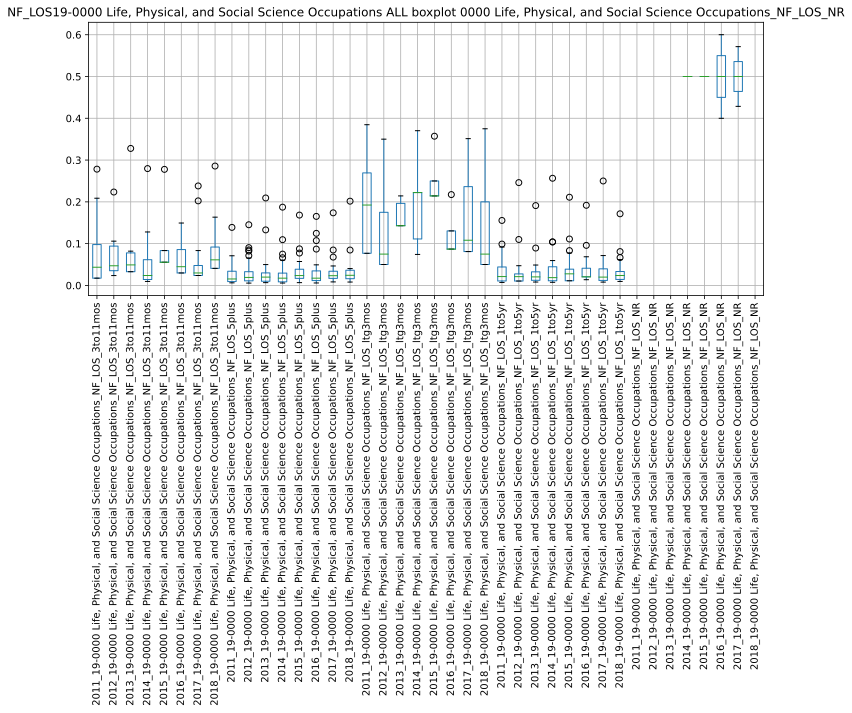

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233247.244572:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233247.284253:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233247.641256:INFO:headless_shell.cc(660)] Written to file /tmp/tmpojrkun5l/temp.png.
[1013/233247.865539:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233247.905584:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233248.412111:INFO:headless_shell.cc(660)] Written to file /tmp/tmp0f1k2frv/temp.png.
[1013/233248.732649:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233248.769802:WARNI

,"2011_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos","2012_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos","2013_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos","2014_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos","2015_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos","2016_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos","2017_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos","2018_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos","2011_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus","2012_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus","2013_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus","2014_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus","2015_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus","2016_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus","2017_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus","2018_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_5plus","2011_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos","2012_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos","2013_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos","2014_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos","2015_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos","2016_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos","2017_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos","2018_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_ltg3mos","2011_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr","2012_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr","2013_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr","2014_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr","2015_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr","2016_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr","2017_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr","2018_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_1to5yr","2011_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_NR","2012_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_NR","2013_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_NR","2014_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_NR","2015_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_NR","2016_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_NR","2017_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_NR","2018_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_NR"
"2011_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos",1.000000,0.216241,-0.182652,-0.262746,0.420734,0.400167,-0.174852,0.532205,-0.078462,0.155244,-0.761126,-0.529572,0.235564,0.066835,-0.130576,-0.306067,-0.012399,0.184640,-0.503040,0.115151,0.132453,0.178273,-0.330921,-0.671199,0.271309,0.163584,-0.390237,0.531726,-0.131639,-0.473125,0.100194,0.415438,nan,nan,nan,nan,nan,-1.000000,-1.000000,nan
"2012_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos",0.216241,1.000000,0.057182,-0.198090,-0.186702,-0.458667,-0.059319,-0.255208,-0.188289,0.492956,-0.317161,-0.283506,0.411081,-0.335107,0.083954,-0.124200,-0.267841,-0.539237,0.740233,-0.219492,0.260290,0.701177,-0.002218,0.161949,-0.144009,0.346359,0.138979,0.441349,0.116253,-0.158817,-0.386532,0.529091,nan,nan,nan,nan,nan,1.000000,1.000000,nan
"2013_19-0000 Life, Physical, and Social Science Occupations_NF_LOS_3to11mos",-0.182652,0.057182,1.000000,-0.171964,-0.226767

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
21-0000 Community and Social Service Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
21-0000 Community and Social Service Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
21-0000 Community and Social Service Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
##########

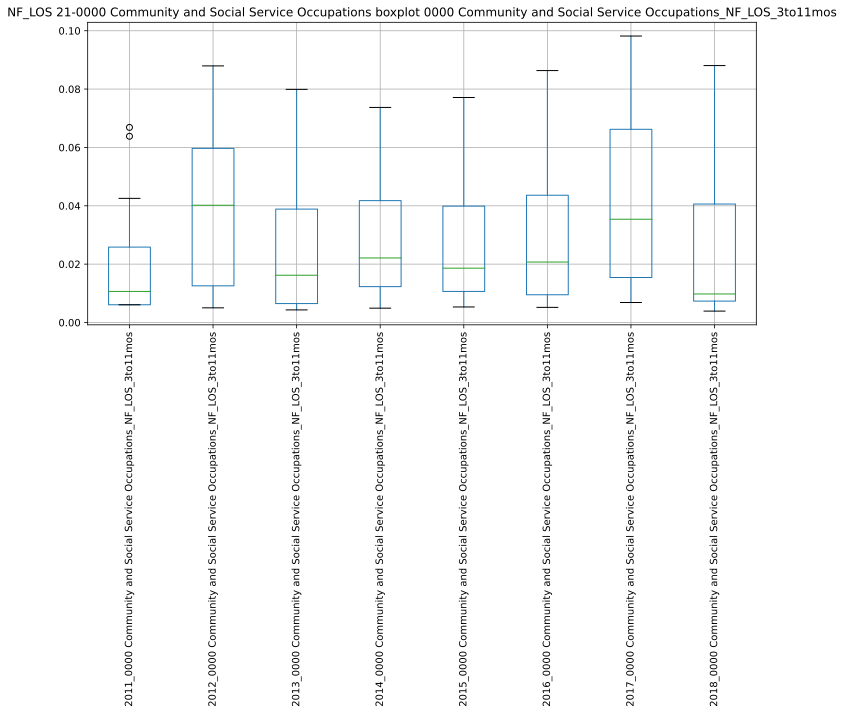

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233328.407263:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233328.447877:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233328.692166:INFO:headless_shell.cc(660)] Written to file /tmp/tmpu26v0bn1/temp.png.
[1013/233328.921666:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233328.962158:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233329.256905:INFO:headless_shell.cc(660)] Written to file /tmp/tmpvm6p_ka1/temp.png.
[1013/233329.529090:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233329.568274:WARNI

,2011_0000 Community and Social Service Occupations_NF_LOS_3to11mos,2012_0000 Community and Social Service Occupations_NF_LOS_3to11mos,2013_0000 Community and Social Service Occupations_NF_LOS_3to11mos,2014_0000 Community and Social Service Occupations_NF_LOS_3to11mos,2015_0000 Community and Social Service Occupations_NF_LOS_3to11mos,2016_0000 Community and Social Service Occupations_NF_LOS_3to11mos,2017_0000 Community and Social Service Occupations_NF_LOS_3to11mos,2018_0000 Community and Social Service Occupations_NF_LOS_3to11mos
2011_0000 Community and Social Service Occupations_NF_LOS_3to11mos,1.000000,-0.107904,0.747747,0.614591,0.817558,-0.260084,-0.156726,0.663476
2012_0000 Community and Social Service Occupations_NF_LOS_3to11mos,-0.107904,1.000000,-0.526563,-0.403745,-0.297616,-0.378769,0.036158,-0.125355
2013_0000 Community and Social Service Occupations_NF_LOS_3to11mos,0.747747,-0.526563,1.000000,0.376402,0.775043,-0.498219,-0.414304,0.789947
2014_0000 Community and Social Service Occupations_NF_LOS_3to11mos,0.614591,-0.403745,0.376402,1.000000,0.356053,-0.243916,-0.049792,0.332176
2015_0000 Community and Social Service Occupations_NF_LOS_3to11mos,0.817558,-0.297616,0.775043,0.356053,1.000000,-0.384909,-0.323361,0.718536
2016_0000 Community and Social Service Occupations_NF_LOS_3to11mos,-0.260084,-0.378769,-0.498219,-0.243916,-0.384909,1.000000,0.650027,-0.619258
2017_0000 Community and Social Service Occupations_NF_LOS_3to11mos,-0.156726,0.036158,-0.414304,-0.049792,-0.323361,0.650027,1.000000,-0.479101
2018_0000 Community and Social Service Occupations_NF_LOS_3to11mos,0.663476,-0.125355,0.789947,0.332176,0.718536,-0.619258,-0.479101,1.000000


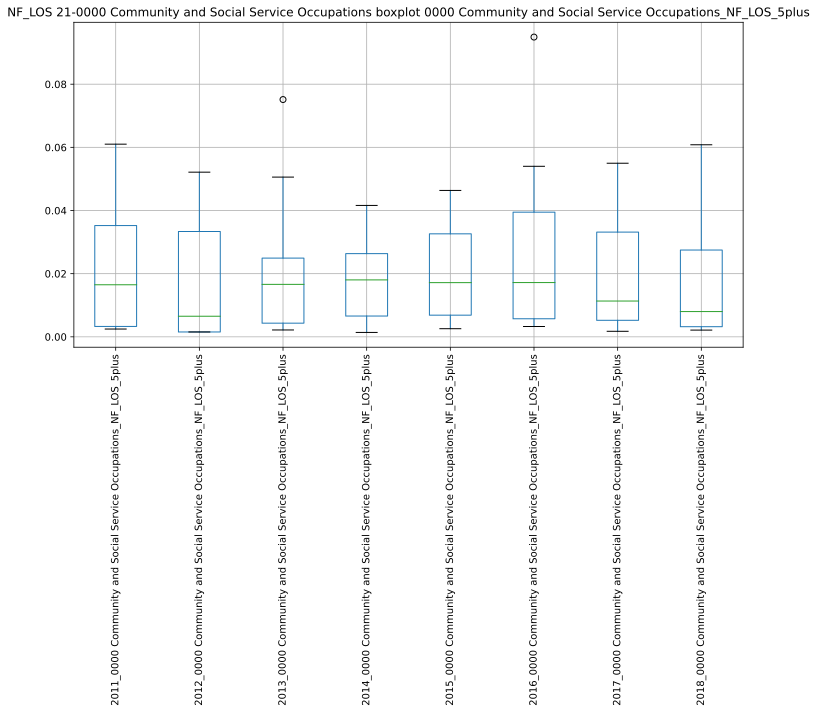

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233332.269396:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233332.314995:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233332.526506:INFO:headless_shell.cc(660)] Written to file /tmp/tmpi8liqvnt/temp.png.
[1013/233332.740639:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233332.778721:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233333.088627:INFO:headless_shell.cc(660)] Written to file /tmp/tmp5b4bt7zr/temp.png.
[1013/233333.357606:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233333.401989:WARNI

,2011_0000 Community and Social Service Occupations_NF_LOS_5plus,2012_0000 Community and Social Service Occupations_NF_LOS_5plus,2013_0000 Community and Social Service Occupations_NF_LOS_5plus,2014_0000 Community and Social Service Occupations_NF_LOS_5plus,2015_0000 Community and Social Service Occupations_NF_LOS_5plus,2016_0000 Community and Social Service Occupations_NF_LOS_5plus,2017_0000 Community and Social Service Occupations_NF_LOS_5plus,2018_0000 Community and Social Service Occupations_NF_LOS_5plus
2011_0000 Community and Social Service Occupations_NF_LOS_5plus,1.000000,0.853187,0.457893,0.666534,0.017646,-0.129233,0.245372,0.692859
2012_0000 Community and Social Service Occupations_NF_LOS_5plus,0.853187,1.000000,0.744240,0.803095,-0.031684,-0.289195,0.299819,0.859778
2013_0000 Community and Social Service Occupations_NF_LOS_5plus,0.457893,0.744240,1.000000,0.628412,0.055286,0.063573,0.341752,0.893897
2014_0000 Community and Social Service Occupations_NF_LOS_5plus,0.666534,0.803095,0.628412,1.000000,0.182436,-0.026297,0.508003,0.690377
2015_0000 Community and Social Service Occupations_NF_LOS_5plus,0.017646,-0.031684,0.055286,0.182436,1.000000,0.882531,0.861150,0.118033
2016_0000 Community and Social Service Occupations_NF_LOS_5plus,-0.129233,-0.289195,0.063573,-0.026297,0.882531,1.000000,0.737012,-0.230928
2017_0000 Community and Social Service Occupations_NF_LOS_5plus,0.245372,0.299819,0.341752,0.508003,0.861150,0.737012,1.000000,0.398755
2018_0000 Community and Social Service Occupations_NF_LOS_5plus,0.692859,0.859778,0.893897,0.690377,0.118033,-0.230928,0.398755,1.000000


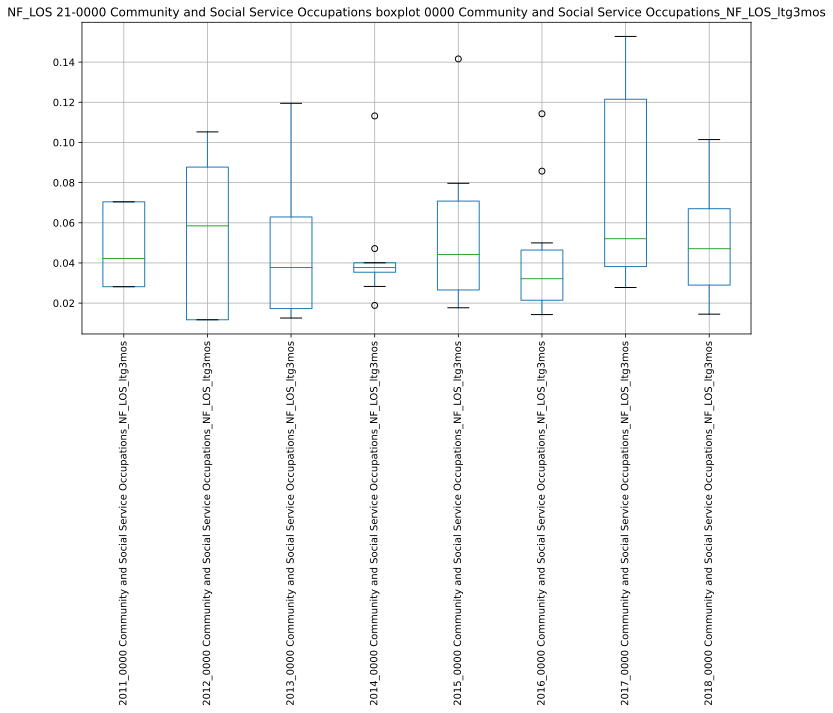

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233336.111648:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233336.150834:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233336.389113:INFO:headless_shell.cc(660)] Written to file /tmp/tmp93rzfchw/temp.png.
[1013/233336.607409:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233336.645260:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233336.951596:INFO:headless_shell.cc(660)] Written to file /tmp/tmpuoyn324x/temp.png.
[1013/233337.216876:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233337.255597:WARNI

,2011_0000 Community and Social Service Occupations_NF_LOS_ltg3mos,2012_0000 Community and Social Service Occupations_NF_LOS_ltg3mos,2013_0000 Community and Social Service Occupations_NF_LOS_ltg3mos,2014_0000 Community and Social Service Occupations_NF_LOS_ltg3mos,2015_0000 Community and Social Service Occupations_NF_LOS_ltg3mos,2016_0000 Community and Social Service Occupations_NF_LOS_ltg3mos,2017_0000 Community and Social Service Occupations_NF_LOS_ltg3mos,2018_0000 Community and Social Service Occupations_NF_LOS_ltg3mos
2011_0000 Community and Social Service Occupations_NF_LOS_ltg3mos,1.000000,0.831760,0.210235,-0.012297,0.071619,0.683818,-0.344843,0.036369
2012_0000 Community and Social Service Occupations_NF_LOS_ltg3mos,0.831760,1.000000,0.060621,-0.162535,0.484872,0.618137,0.189217,0.636808
2013_0000 Community and Social Service Occupations_NF_LOS_ltg3mos,0.210235,0.060621,1.000000,0.111754,0.239833,-0.472985,-0.724483,0.426066
2014_0000 Community and Social Service Occupations_NF_LOS_ltg3mos,-0.012297,-0.162535,0.111754,1.000000,0.151911,-0.218564,-0.313902,-0.186724
2015_0000 Community and Social Service Occupations_NF_LOS_ltg3mos,0.071619,0.484872,0.239833,0.151911,1.000000,0.070271,0.144384,0.259635
2016_0000 Community and Social Service Occupations_NF_LOS_ltg3mos,0.683818,0.618137,-0.472985,-0.218564,0.070271,1.000000,0.572846,0.150415
2017_0000 Community and Social Service Occupations_NF_LOS_ltg3mos,-0.344843,0.189217,-0.724483,-0.313902,0.144384,0.572846,1.000000,0.213139
2018_0000 Community and Social Service Occupations_NF_LOS_ltg3mos,0.036369,0.636808,0.426066,-0.186724,0.259635,0.150415,0.213139,1.000000


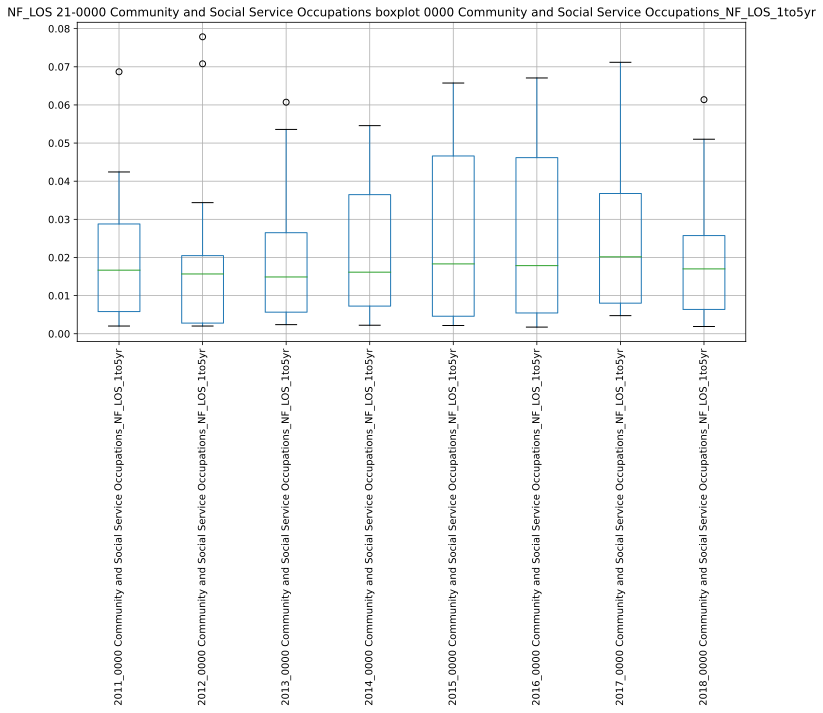

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233340.134125:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233340.172421:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233340.386616:INFO:headless_shell.cc(660)] Written to file /tmp/tmp68x288s_/temp.png.
[1013/233340.601749:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233340.639919:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233340.942245:INFO:headless_shell.cc(660)] Written to file /tmp/tmpcdkpolhm/temp.png.
[1013/233341.215223:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233341.254375:WARNI

,2011_0000 Community and Social Service Occupations_NF_LOS_1to5yr,2012_0000 Community and Social Service Occupations_NF_LOS_1to5yr,2013_0000 Community and Social Service Occupations_NF_LOS_1to5yr,2014_0000 Community and Social Service Occupations_NF_LOS_1to5yr,2015_0000 Community and Social Service Occupations_NF_LOS_1to5yr,2016_0000 Community and Social Service Occupations_NF_LOS_1to5yr,2017_0000 Community and Social Service Occupations_NF_LOS_1to5yr,2018_0000 Community and Social Service Occupations_NF_LOS_1to5yr
2011_0000 Community and Social Service Occupations_NF_LOS_1to5yr,1.000000,0.824008,0.859322,0.676326,0.275032,0.448441,0.372843,0.808912
2012_0000 Community and Social Service Occupations_NF_LOS_1to5yr,0.824008,1.000000,0.882058,0.809606,0.127303,0.464249,0.028859,0.772777
2013_0000 Community and Social Service Occupations_NF_LOS_1to5yr,0.859322,0.882058,1.000000,0.925162,0.020902,0.517098,-0.008559,0.890391
2014_0000 Community and Social Service Occupations_NF_LOS_1to5yr,0.676326,0.809606,0.925162,1.000000,-0.092294,0.473746,-0.126964,0.777143
2015_0000 Community and Social Service Occupations_NF_LOS_1to5yr,0.275032,0.127303,0.020902,-0.092294,1.000000,0.363031,0.914454,0.028538
2016_0000 Community and Social Service Occupations_NF_LOS_1to5yr,0.448441,0.464249,0.517098,0.473746,0.363031,1.000000,0.378089,0.463917
2017_0000 Community and Social Service Occupations_NF_LOS_1to5yr,0.372843,0.028859,-0.008559,-0.126964,0.914454,0.378089,1.000000,0.007225
2018_0000 Community and Social Service Occupations_NF_LOS_1to5yr,0.808912,0.772777,0.890391,0.777143,0.028538,0.463917,0.007225,1.000000


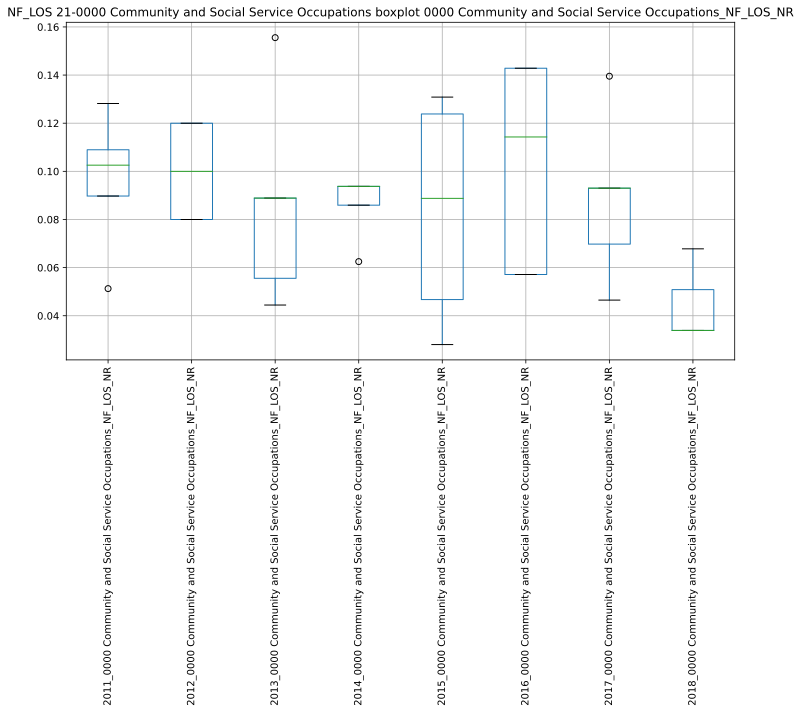

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233343.949060:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233343.989727:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233344.224452:INFO:headless_shell.cc(660)] Written to file /tmp/tmpybumqt4f/temp.png.
[1013/233344.444522:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233344.481654:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233344.772369:INFO:headless_shell.cc(660)] Written to file /tmp/tmp88xfzf52/temp.png.
[1013/233345.032494:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233345.069256:WARNI

,2011_0000 Community and Social Service Occupations_NF_LOS_NR,2012_0000 Community and Social Service Occupations_NF_LOS_NR,2013_0000 Community and Social Service Occupations_NF_LOS_NR,2014_0000 Community and Social Service Occupations_NF_LOS_NR,2015_0000 Community and Social Service Occupations_NF_LOS_NR,2016_0000 Community and Social Service Occupations_NF_LOS_NR,2017_0000 Community and Social Service Occupations_NF_LOS_NR,2018_0000 Community and Social Service Occupations_NF_LOS_NR
2011_0000 Community and Social Service Occupations_NF_LOS_NR,1.000000,-0.944911,-0.917663,-0.755929,-1.000000,-0.188982,0.981981,0.327327
2012_0000 Community and Social Service Occupations_NF_LOS_NR,-0.944911,1.000000,0.500000,1.000000,-0.052414,-0.500000,-0.866025,-1.000000
2013_0000 Community and Social Service Occupations_NF_LOS_NR,-0.917663,0.500000,1.000000,nan,-0.234404,0.720082,-0.966988,0.140028
2014_0000 Community and Social Service Occupations_NF_LOS_NR,-0.755929,1.000000,nan,1.000000,0.964579,-0.471405,-0.866025,-0.866025
2015_0000 Community and Social Service Occupations_NF_LOS_NR,-1.000000,-0.052414,-0.234404,0.964579,1.000000,-0.663291,-0.296862,-0.998625
2016_0000 Community and Social Service Occupations_NF_LOS_NR,-0.188982,-0.500000,0.720082,-0.471405,-0.663291,1.000000,0.000000,0.707107
2017_0000 Community and Social Service Occupations_NF_LOS_NR,0.981981,-0.866025,-0.966988,-0.866025,-0.296862,0.000000,1.000000,1.000000
2018_0000 Community and Social Service Occupations_NF_LOS_NR,0.327327,-1.000000,0.140028,-0.866025,-0.998625,0.707107,1.000000,1.000000


########################################## CORRELATIONS ###############################################
['21-0000 Community and Social Service Occupations_NF_LOS_3to11mos', '21-0000 Community and Social Service Occupations_NF_LOS_5plus', '21-0000 Community and Social Service Occupations_NF_LOS_ltg3mos', '21-0000 Community and Social Service Occupations_NF_LOS_1to5yr', '21-0000 Community and Social Service Occupations_NF_LOS_NR']


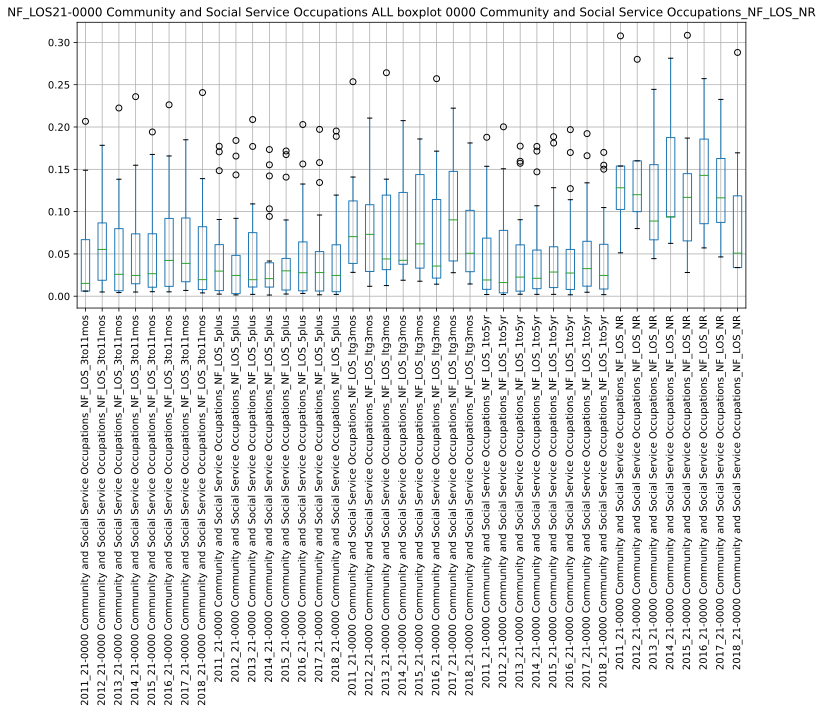

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233349.717976:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233349.760170:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233350.097202:INFO:headless_shell.cc(660)] Written to file /tmp/tmp325p64x_/temp.png.
[1013/233350.321077:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233350.360586:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233350.893905:INFO:headless_shell.cc(660)] Written to file /tmp/tmpu9tmanqk/temp.png.
[1013/233351.211632:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233351.250370:WARNI

,2011_21-0000 Community and Social Service Occupations_NF_LOS_3to11mos,2012_21-0000 Community and Social Service Occupations_NF_LOS_3to11mos,2013_21-0000 Community and Social Service Occupations_NF_LOS_3to11mos,2014_21-0000 Community and Social Service Occupations_NF_LOS_3to11mos,2015_21-0000 Community and Social Service Occupations_NF_LOS_3to11mos,2016_21-0000 Community and Social Service Occupations_NF_LOS_3to11mos,2017_21-0000 Community and Social Service Occupations_NF_LOS_3to11mos,2018_21-0000 Community and Social Service Occupations_NF_LOS_3to11mos,2011_21-0000 Community and Social Service Occupations_NF_LOS_5plus,2012_21-0000 Community and Social Service Occupations_NF_LOS_5plus,2013_21-0000 Community and Social Service Occupations_NF_LOS_5plus,2014_21-0000 Community and Social Service Occupations_NF_LOS_5plus,2015_21-0000 Community and Social Service Occupations_NF_LOS_5plus,2016_21-0000 Community and Social Service Occupations_NF_LOS_5plus,2017_21-0000 Community and Social Service Occupations_NF_LOS_5plus,2018_21-0000 Community and Social Service Occupations_NF_LOS_5plus,2011_21-0000 Community and Social Service Occupations_NF_LOS_ltg3mos,2012_21-0000 Community and Social Service Occupations_NF_LOS_ltg3mos,2013_21-0000 Community and Social Service Occupations_NF_LOS_ltg3mos,2014_21-0000 Community and Social Service Occupations_NF_LOS_ltg3mos,2015_21-0000 Community and Social Service Occupations_NF_LOS_ltg3mos,2016_21-0000 Community and Social Service Occupations_NF_LOS_ltg3mos,2017_21-0000 Community and Social Service Occupations_NF_LOS_ltg3mos,2018_21-0000 Community and Social Service Occupations_NF_LOS_ltg3mos,2011_21-0000 Community and Social Service Occupations_NF_LOS_1to5yr,2012_21-0000 Community and Social Service Occupations_NF_LOS_1to5yr,2013_21-0000 Community and Social Service Occupations_NF_LOS_1to5yr,2014_21-0000 Community and Social Service Occupations_NF_LOS_1to5yr,2015_21-0000 Community and Social Service Occupations_NF_LOS_1to5yr,2016_21-0000 Community and Social Service Occupations_NF_LOS_1to5yr,2017_21-0000 Community and Social Service Occupations_NF_LOS_1to5yr,2018_21-0000 Community and Social Service Occupations_NF_LOS_1to5yr,2011_21-0000 Community and Social Service Occupations_NF_LOS_NR,2012_21-0000 Community and Social Service Occupations_NF_LOS_NR,2013_21-0000 Community and Social Service Occupations_NF_LOS_NR,2014_21-0000 Community and Social Service Occupations_NF_LOS_NR,2015_21-0000 Community and Social Service Occupations_NF_LOS_NR,2016_21-0000 Community and Social Service Occupations_NF_LOS_NR,2017_21-0000 Community and Social Service Occupations_NF_LOS_NR,2018_21-0000 Community and Social Service Occupations_NF_LOS_NR
2011_21-0000 Community and Social Service Occupations_NF_LOS_3to11mos,1.000000,0.368484,0.967611,0.806831,0.970495,0.355949,0.444388,0.831523,0.885771,0.924473,0.798332,0.849363,0.536033,0.488386,0.532067,0.815873,0.572533,0.207478,0.294858,0.206876,0.125877,0.452379,0.807638,0.192027,0.877364,0.913770,0.883677,0.835907,0.588588,0.876313,0.574234,0.888422,0.877717,-0.133127,0.564024,0.392864,0.379728,0.761386,0.053976,0.789802
2012_21-0000 Community and Social Service Occupations_NF_LOS_3to11mos,0.368484,1.000000,0.443625,0.300459,0.280863,0.173333,0.633914,0.135910,0.234979,0.249632,0.193498,0.243693,0.467573,0.363123,0.486504,0.105582,0.734898,0.448272,0.143464,0.123910,0.573933,0.608855,0.668309,0.272361,0.350401,0.418762,0.298635,0.364637,0.655330,0.328006,0.651871,0.271869,0.604705,-0.317144,0.853102,-0.177376,0.268700,0.387530,0.328367,0.245497
2013_21-0000 Community and Social Service Occupations_NF_LOS_3to11mos,0.967611,0.443625,1.000000,0.776217,0.948809,0.290475,0.456519,0.810374,0.849231,0.875542,0.745206,0.773492,0.526836,0.467269,0.521223,0.744449,0.602229,0.139376,0.367617,0.282817,0.101260,0.437429,0.714024,0.116624,0.825598,0.877696,0.834023,0.802375,0.613011,0.902446,0.599712,0.830548,0.818001,-0.071421,0.724436,0.216257,0.487248,0.792156,-0.071604,0.812795


########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
23-0000 Legal Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
23-0000 Legal Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
23-0000 Legal Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
23-0000 Legal Occupations
 
########## NEE

/home/ediaz/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/ediaz/.local/lib/python3.8/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
23-0000 Legal Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
23-0000 Legal Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
23-0000 Legal Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
23-0000 Legal Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
23-0000 Legal Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ###

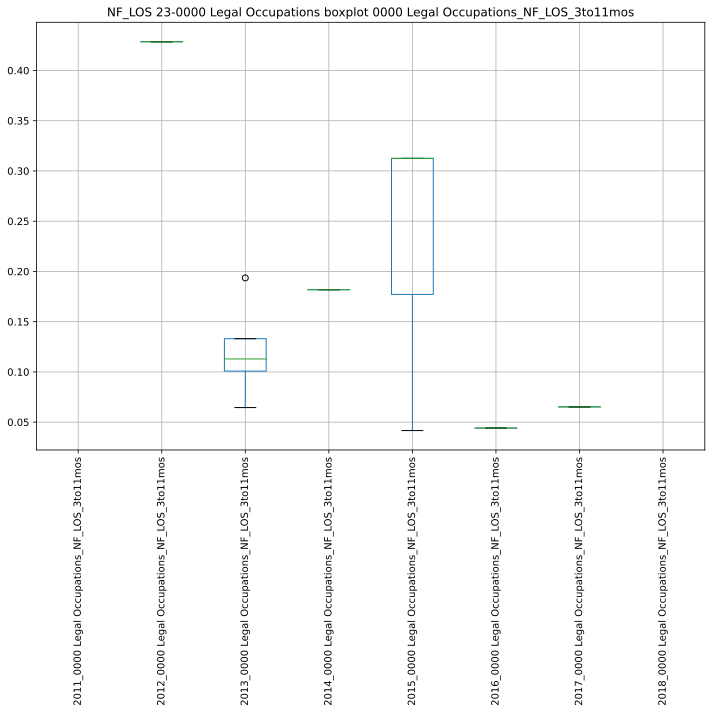

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233430.925849:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233430.970548:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233431.184072:INFO:headless_shell.cc(660)] Written to file /tmp/tmpebc096d4/temp.png.
[1013/233431.411854:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233431.449337:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233431.742309:INFO:headless_shell.cc(660)] Written to file /tmp/tmpc0vth5b0/temp.png.
[1013/233432.000733:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233432.039080:WARNI

,2011_0000 Legal Occupations_NF_LOS_3to11mos,2012_0000 Legal Occupations_NF_LOS_3to11mos,2013_0000 Legal Occupations_NF_LOS_3to11mos,2014_0000 Legal Occupations_NF_LOS_3to11mos,2015_0000 Legal Occupations_NF_LOS_3to11mos,2016_0000 Legal Occupations_NF_LOS_3to11mos,2017_0000 Legal Occupations_NF_LOS_3to11mos,2018_0000 Legal Occupations_NF_LOS_3to11mos
2011_0000 Legal Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan
2012_0000 Legal Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan
2013_0000 Legal Occupations_NF_LOS_3to11mos,nan,nan,1.000000,nan,nan,nan,nan,nan
2014_0000 Legal Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan
2015_0000 Legal Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,1.000000,nan,nan,nan
2016_0000 Legal Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan
2017_0000 Legal Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan
2018_0000 Legal Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan


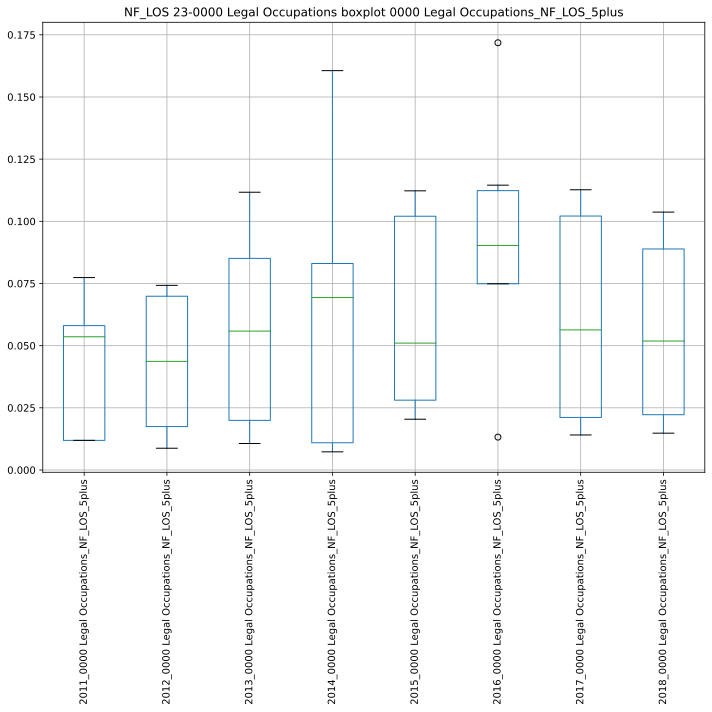

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233434.623457:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233434.665669:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233434.934155:INFO:headless_shell.cc(660)] Written to file /tmp/tmpys6drtxf/temp.png.
[1013/233435.160184:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233435.197521:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233435.486986:INFO:headless_shell.cc(660)] Written to file /tmp/tmpwwna699j/temp.png.
[1013/233435.737596:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233435.776081:WARNI

,2011_0000 Legal Occupations_NF_LOS_5plus,2012_0000 Legal Occupations_NF_LOS_5plus,2013_0000 Legal Occupations_NF_LOS_5plus,2014_0000 Legal Occupations_NF_LOS_5plus,2015_0000 Legal Occupations_NF_LOS_5plus,2016_0000 Legal Occupations_NF_LOS_5plus,2017_0000 Legal Occupations_NF_LOS_5plus,2018_0000 Legal Occupations_NF_LOS_5plus
2011_0000 Legal Occupations_NF_LOS_5plus,1.000000,0.290652,0.250447,0.998813,-0.089830,0.988233,0.682026,0.504098
2012_0000 Legal Occupations_NF_LOS_5plus,0.290652,1.000000,0.957985,-0.067826,0.967429,0.243560,0.515034,0.798417
2013_0000 Legal Occupations_NF_LOS_5plus,0.250447,0.957985,1.000000,0.010258,0.933817,0.280207,0.538715,0.821555
2014_0000 Legal Occupations_NF_LOS_5plus,0.998813,-0.067826,0.010258,1.000000,-0.122684,0.134458,0.353803,0.077301
2015_0000 Legal Occupations_NF_LOS_5plus,-0.089830,0.967429,0.933817,-0.122684,1.000000,0.154545,0.228638,0.805426
2016_0000 Legal Occupations_NF_LOS_5plus,0.988233,0.243560,0.280207,0.134458,0.154545,1.000000,-0.703488,0.220374
2017_0000 Legal Occupations_NF_LOS_5plus,0.682026,0.515034,0.538715,0.353803,0.228638,-0.703488,1.000000,0.633023
2018_0000 Legal Occupations_NF_LOS_5plus,0.504098,0.798417,0.821555,0.077301,0.805426,0.220374,0.633023,1.000000


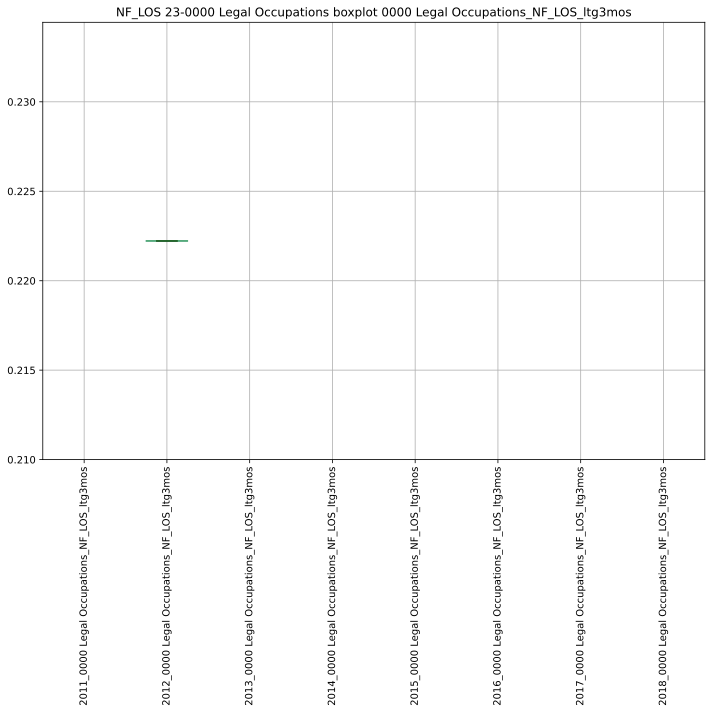

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233437.392146:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233437.431191:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233437.655962:INFO:headless_shell.cc(660)] Written to file /tmp/tmp0s3b7k7o/temp.png.
[1013/233437.875539:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233437.914897:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233438.208976:INFO:headless_shell.cc(660)] Written to file /tmp/tmpi61arqgu/temp.png.
[1013/233438.473259:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233438.515096:WARNI

,2011_0000 Legal Occupations_NF_LOS_ltg3mos,2012_0000 Legal Occupations_NF_LOS_ltg3mos,2013_0000 Legal Occupations_NF_LOS_ltg3mos,2014_0000 Legal Occupations_NF_LOS_ltg3mos,2015_0000 Legal Occupations_NF_LOS_ltg3mos,2016_0000 Legal Occupations_NF_LOS_ltg3mos,2017_0000 Legal Occupations_NF_LOS_ltg3mos,2018_0000 Legal Occupations_NF_LOS_ltg3mos
2011_0000 Legal Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2012_0000 Legal Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2013_0000 Legal Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2014_0000 Legal Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2015_0000 Legal Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2016_0000 Legal Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2017_0000 Legal Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2018_0000 Legal Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan


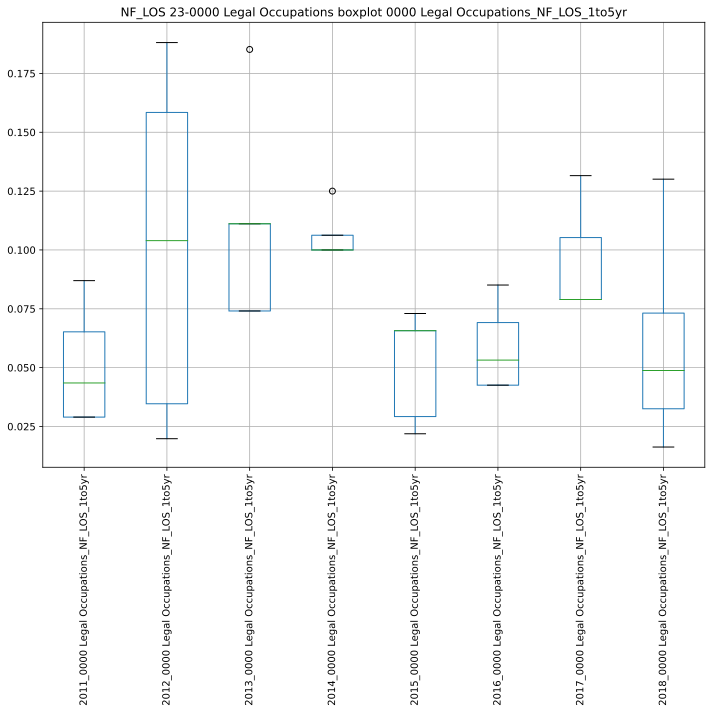

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233440.356467:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233440.393288:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233440.603274:INFO:headless_shell.cc(660)] Written to file /tmp/tmp0e3qapqu/temp.png.
[1013/233440.822020:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233440.861424:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233441.160585:INFO:headless_shell.cc(660)] Written to file /tmp/tmp7_csgvv8/temp.png.
[1013/233441.434614:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233441.475189:WARNI

,2011_0000 Legal Occupations_NF_LOS_1to5yr,2012_0000 Legal Occupations_NF_LOS_1to5yr,2013_0000 Legal Occupations_NF_LOS_1to5yr,2014_0000 Legal Occupations_NF_LOS_1to5yr,2015_0000 Legal Occupations_NF_LOS_1to5yr,2016_0000 Legal Occupations_NF_LOS_1to5yr,2017_0000 Legal Occupations_NF_LOS_1to5yr,2018_0000 Legal Occupations_NF_LOS_1to5yr
2011_0000 Legal Occupations_NF_LOS_1to5yr,1.000000,-0.891042,nan,-0.500000,-0.941795,-0.866025,nan,-1.000000
2012_0000 Legal Occupations_NF_LOS_1to5yr,-0.891042,1.000000,-0.304082,nan,0.986942,0.644902,1.000000,0.667904
2013_0000 Legal Occupations_NF_LOS_1to5yr,nan,-0.304082,1.000000,nan,nan,nan,nan,-0.487950
2014_0000 Legal Occupations_NF_LOS_1to5yr,-0.500000,nan,nan,1.000000,0.492366,0.870388,nan,nan
2015_0000 Legal Occupations_NF_LOS_1to5yr,-0.941795,0.986942,nan,0.492366,1.000000,0.642824,nan,0.628619
2016_0000 Legal Occupations_NF_LOS_1to5yr,-0.866025,0.644902,nan,0.870388,0.642824,1.000000,nan,nan
2017_0000 Legal Occupations_NF_LOS_1to5yr,nan,1.000000,nan,nan,nan,nan,1.000000,nan
2018_0000 Legal Occupations_NF_LOS_1to5yr,-1.000000,0.667904,-0.487950,nan,0.628619,nan,nan,1.000000


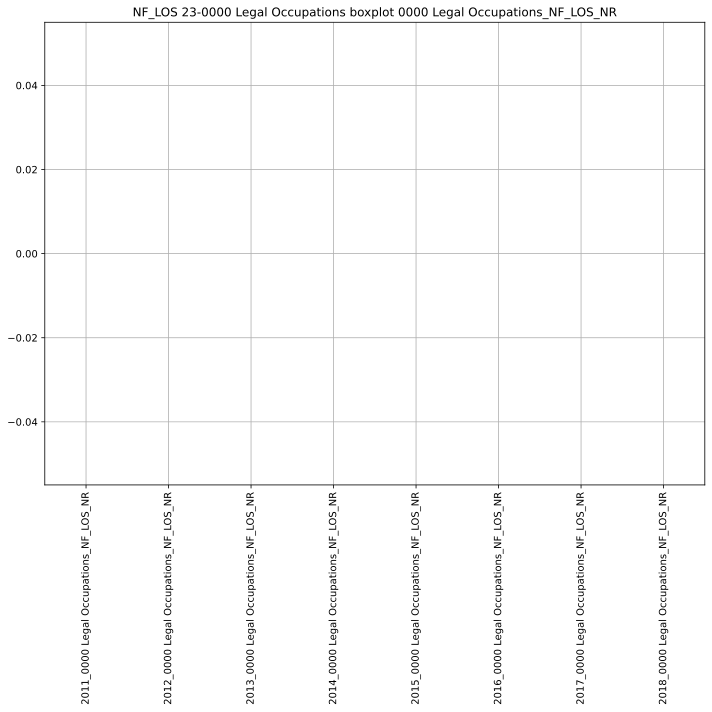

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233443.073815:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233443.102332:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233443.331423:INFO:headless_shell.cc(660)] Written to file /tmp/tmpv2wplb3u/temp.png.
[1013/233443.557586:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233443.597166:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233443.889305:INFO:headless_shell.cc(660)] Written to file /tmp/tmp4l_619jh/temp.png.
[1013/233444.152827:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233444.189954:WARNI

,2011_0000 Legal Occupations_NF_LOS_NR,2012_0000 Legal Occupations_NF_LOS_NR,2013_0000 Legal Occupations_NF_LOS_NR,2014_0000 Legal Occupations_NF_LOS_NR,2015_0000 Legal Occupations_NF_LOS_NR,2016_0000 Legal Occupations_NF_LOS_NR,2017_0000 Legal Occupations_NF_LOS_NR,2018_0000 Legal Occupations_NF_LOS_NR
2011_0000 Legal Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2012_0000 Legal Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2013_0000 Legal Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2014_0000 Legal Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2015_0000 Legal Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2016_0000 Legal Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2017_0000 Legal Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2018_0000 Legal Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan


########################################## CORRELATIONS ###############################################
['23-0000 Legal Occupations_NF_LOS_3to11mos', '23-0000 Legal Occupations_NF_LOS_5plus', '23-0000 Legal Occupations_NF_LOS_ltg3mos', '23-0000 Legal Occupations_NF_LOS_1to5yr', '23-0000 Legal Occupations_NF_LOS_NR']


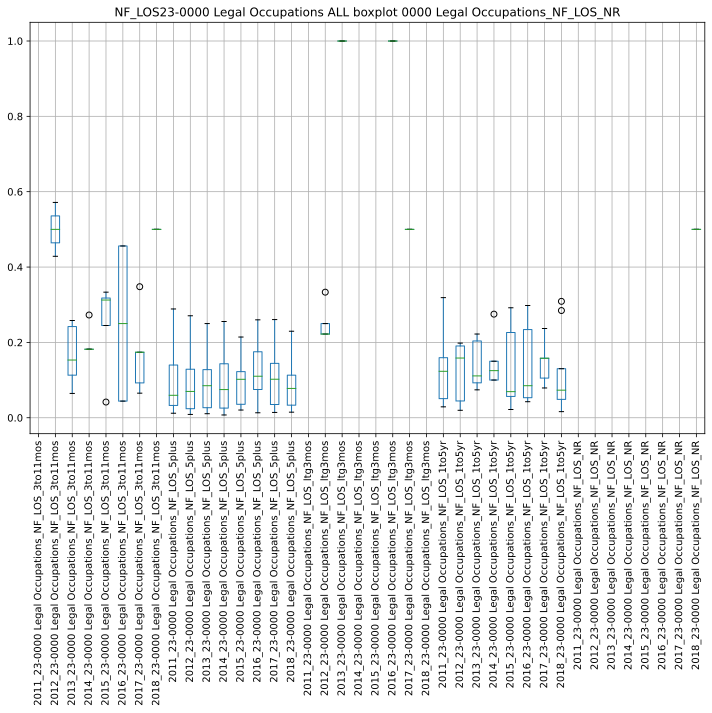

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233447.527247:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233447.564777:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233447.891490:INFO:headless_shell.cc(660)] Written to file /tmp/tmpf13_8sa0/temp.png.
[1013/233448.117765:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233448.155585:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233448.669798:INFO:headless_shell.cc(660)] Written to file /tmp/tmpf3nz660e/temp.png.
[1013/233448.980901:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233449.021396:WARNI

,2011_23-0000 Legal Occupations_NF_LOS_3to11mos,2012_23-0000 Legal Occupations_NF_LOS_3to11mos,2013_23-0000 Legal Occupations_NF_LOS_3to11mos,2014_23-0000 Legal Occupations_NF_LOS_3to11mos,2015_23-0000 Legal Occupations_NF_LOS_3to11mos,2016_23-0000 Legal Occupations_NF_LOS_3to11mos,2017_23-0000 Legal Occupations_NF_LOS_3to11mos,2018_23-0000 Legal Occupations_NF_LOS_3to11mos,2011_23-0000 Legal Occupations_NF_LOS_5plus,2012_23-0000 Legal Occupations_NF_LOS_5plus,2013_23-0000 Legal Occupations_NF_LOS_5plus,2014_23-0000 Legal Occupations_NF_LOS_5plus,2015_23-0000 Legal Occupations_NF_LOS_5plus,2016_23-0000 Legal Occupations_NF_LOS_5plus,2017_23-0000 Legal Occupations_NF_LOS_5plus,2018_23-0000 Legal Occupations_NF_LOS_5plus,2011_23-0000 Legal Occupations_NF_LOS_ltg3mos,2012_23-0000 Legal Occupations_NF_LOS_ltg3mos,2013_23-0000 Legal Occupations_NF_LOS_ltg3mos,2014_23-0000 Legal Occupations_NF_LOS_ltg3mos,2015_23-0000 Legal Occupations_NF_LOS_ltg3mos,2016_23-0000 Legal Occupations_NF_LOS_ltg3mos,2017_23-0000 Legal Occupations_NF_LOS_ltg3mos,2018_23-0000 Legal Occupations_NF_LOS_ltg3mos,2011_23-0000 Legal Occupations_NF_LOS_1to5yr,2012_23-0000 Legal Occupations_NF_LOS_1to5yr,2013_23-0000 Legal Occupations_NF_LOS_1to5yr,2014_23-0000 Legal Occupations_NF_LOS_1to5yr,2015_23-0000 Legal Occupations_NF_LOS_1to5yr,2016_23-0000 Legal Occupations_NF_LOS_1to5yr,2017_23-0000 Legal Occupations_NF_LOS_1to5yr,2018_23-0000 Legal Occupations_NF_LOS_1to5yr,2011_23-0000 Legal Occupations_NF_LOS_NR,2012_23-0000 Legal Occupations_NF_LOS_NR,2013_23-0000 Legal Occupations_NF_LOS_NR,2014_23-0000 Legal Occupations_NF_LOS_NR,2015_23-0000 Legal Occupations_NF_LOS_NR,2016_23-0000 Legal Occupations_NF_LOS_NR,2017_23-0000 Legal Occupations_NF_LOS_NR,2018_23-0000 Legal Occupations_NF_LOS_NR
2011_23-0000 Legal Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2012_23-0000 Legal Occupations_NF_LOS_3to11mos,nan,1.000000,nan,nan,-1.000000,nan,nan,nan,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,nan,-1.000000,nan,nan,nan,nan,nan,nan,nan,1.000000,nan,1.000000,1.000000,1.000000,1.000000,1.000000,nan,nan,nan,nan,nan,nan,nan,nan
2013_23-0000 Legal Occupations_NF_LOS_3to11mos,nan,nan,1.000000,0.545921,0.518321,-1.000000,0.649766,nan,-0.235558,-0.745954,-0.836625,-0.610004,-0.942138,0.062540,0.062522,-0.899391,nan,-0.577350,nan,nan,nan,nan,nan,nan,0.648866,-0.435239,-0.053272,0.769087,0.943343,0.958146,-0.029117,-0.616898,nan,nan,nan,nan,nan,nan,nan,nan
2014_23-0000 Legal Occupations_NF_LOS_3to11mos,nan,nan,0.545921,1.000000,0.299253,-0.577350,0.882696,nan,-0.349480,-0.410191,-0.270437,-0.575213,-0.430002,0.972602,-0.708892,-0.246818,nan,-0.333333,nan,nan,nan,nan,nan,nan,0.838757,-0.966252,0.147442,0.951747,0.634625,0.625375,0.853125,-0.535050,nan,nan,nan,nan,nan,nan,nan,nan
2015_23-0000 Legal Occupations_NF_LOS_3to11mos,nan,-1.000000,0.518321,0.299253,1.000000,-0.518321,0.438836,nan,-0.559360,-0.724395,-0.754046,-0.545495,-0.658169,0.170378,0.044575,-0.715764,nan,0.399004,nan,nan,nan,nan,nan,nan,0.456754,-0.332572,-0.423207,0.272708,0.480700,0.437821,-0.079801,-0.569828,nan,nan,nan,nan,nan,nan,nan,nan
2016_23-0000 Legal Occupations_NF_LOS_3to11mos,nan,nan,-1.000000,-0.577350,-0.518321,1.000000,-0.846649,nan,0.998813,0.937201,0.945611,0.999427,0.983078,-0.400617,-0.178612,0.953206,nan,0.577350,nan,nan,nan,nan,nan,nan,-0.881219,0.549972,0.816497,-0.742781,-0.970988,-0.970495,-0.115470,0.998115,nan,nan,nan,nan,nan,nan,nan,nan
2017_23-0000 Legal Occupations_NF_LOS_3to11mos,nan,nan,0.649766,0.882696,0.438836,-0.846649,1.000000,nan,-0.105828,-0.154896,-0.251048,-0.812497,-0.559137,0.719676,-0.350947,-0.367286,nan,-0.488813,nan,nan,nan,nan,nan,nan,0.995350,-0.907755,-0.284543,0.886022,0.810415,0.759406,0.516335,-0.827040,nan,nan,nan,nan,nan,nan,nan,nan
2018_23-0000 Legal Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
25-0000 Educational Instruction and Library Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
25-0000 Educational Instruction and Library Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
25-0000 Educational Instruction and Library Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ########

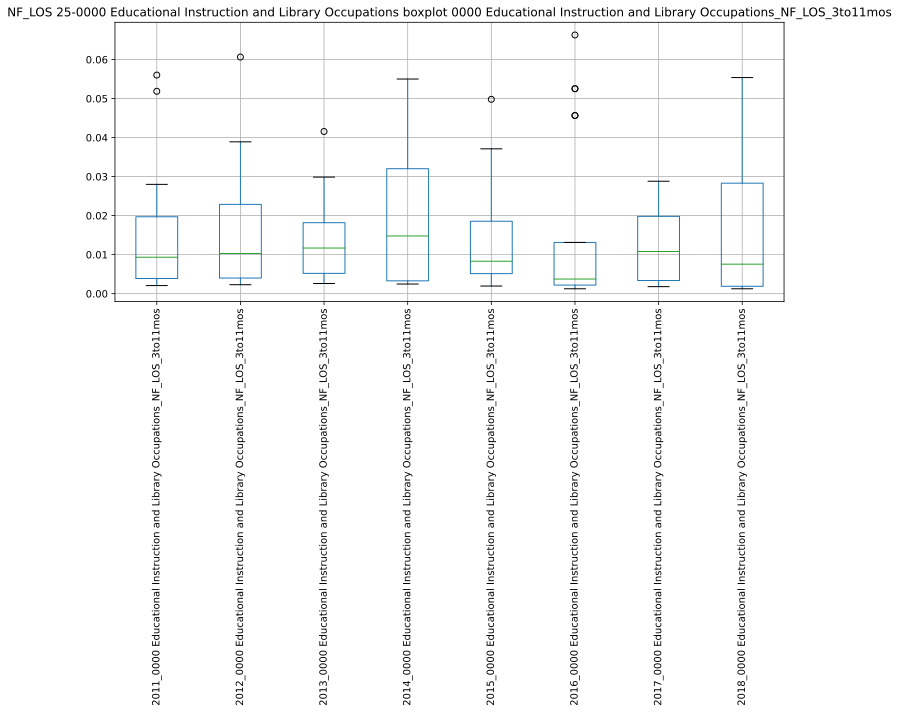

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233509.161916:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233509.201257:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233509.417545:INFO:headless_shell.cc(660)] Written to file /tmp/tmp23aifgnj/temp.png.
[1013/233509.654050:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233509.692396:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233510.002679:INFO:headless_shell.cc(660)] Written to file /tmp/tmp0s2jipq1/temp.png.
[1013/233510.271333:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233510.312834:WARNI

,2011_0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,2012_0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,2013_0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,2014_0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,2015_0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,2016_0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,2017_0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,2018_0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos
2011_0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,1.000000,0.348995,0.433577,0.286266,0.020598,0.090446,-0.055185,0.196125
2012_0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,0.348995,1.000000,0.238989,-0.028594,-0.145297,0.248675,-0.258446,0.358582
2013_0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,0.433577,0.238989,1.000000,0.140260,-0.033046,0.391207,0.069093,0.518536
2014_0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,0.286266,-0.028594,0.140260,1.000000,0.444493,-0.009355,0.669582,0.466445
2015_0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,0.020598,-0.145297,-0.033046,0.444493,1.000000,0.214312,0.472038,0.113900
2016_0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,0.090446,0.248675,0.391207,-0.009355,0.214312,1.000000,0.218387,0.760385
2017_0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,-0.055185,-0.258446,0.069093,0.669582,0.472038,0.218387,1.000000,0.162991
2018_0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,0.196125,0.358582,0.518536,0.466445,0.113900,0.760385,0.162991,1.000000


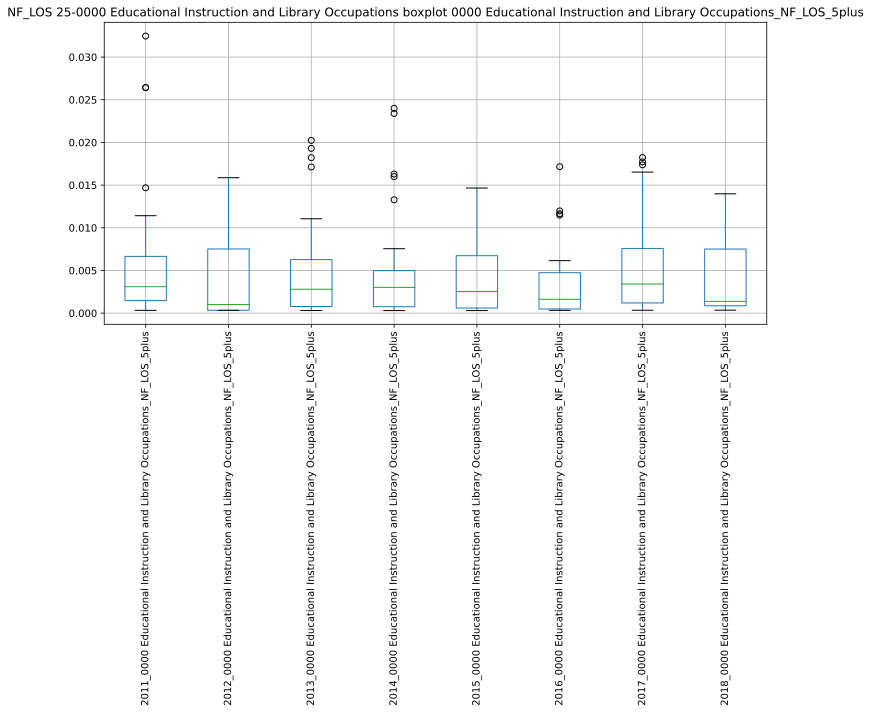

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233514.346763:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233514.387891:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233514.618190:INFO:headless_shell.cc(660)] Written to file /tmp/tmpn6vjof1p/temp.png.
[1013/233514.843285:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233514.882081:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233515.172977:INFO:headless_shell.cc(660)] Written to file /tmp/tmpbekbam2h/temp.png.
[1013/233515.448275:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233515.488299:WARNI

,2011_0000 Educational Instruction and Library Occupations_NF_LOS_5plus,2012_0000 Educational Instruction and Library Occupations_NF_LOS_5plus,2013_0000 Educational Instruction and Library Occupations_NF_LOS_5plus,2014_0000 Educational Instruction and Library Occupations_NF_LOS_5plus,2015_0000 Educational Instruction and Library Occupations_NF_LOS_5plus,2016_0000 Educational Instruction and Library Occupations_NF_LOS_5plus,2017_0000 Educational Instruction and Library Occupations_NF_LOS_5plus,2018_0000 Educational Instruction and Library Occupations_NF_LOS_5plus
2011_0000 Educational Instruction and Library Occupations_NF_LOS_5plus,1.000000,-0.184115,0.070653,0.048021,0.132357,0.353428,-0.051285,0.260719
2012_0000 Educational Instruction and Library Occupations_NF_LOS_5plus,-0.184115,1.000000,0.305231,0.405730,-0.102322,-0.057699,-0.052090,-0.003957
2013_0000 Educational Instruction and Library Occupations_NF_LOS_5plus,0.070653,0.305231,1.000000,0.948886,-0.011442,0.000763,0.345232,0.552240
2014_0000 Educational Instruction and Library Occupations_NF_LOS_5plus,0.048021,0.405730,0.948886,1.000000,-0.139404,0.140907,0.236074,0.499419
2015_0000 Educational Instruction and Library Occupations_NF_LOS_5plus,0.132357,-0.102322,-0.011442,-0.139404,1.000000,0.308307,0.347657,-0.045194
2016_0000 Educational Instruction and Library Occupations_NF_LOS_5plus,0.353428,-0.057699,0.000763,0.140907,0.308307,1.000000,0.496714,0.056734
2017_0000 Educational Instruction and Library Occupations_NF_LOS_5plus,-0.051285,-0.052090,0.345232,0.236074,0.347657,0.496714,1.000000,0.092458
2018_0000 Educational Instruction and Library Occupations_NF_LOS_5plus,0.260719,-0.003957,0.552240,0.499419,-0.045194,0.056734,0.092458,1.000000


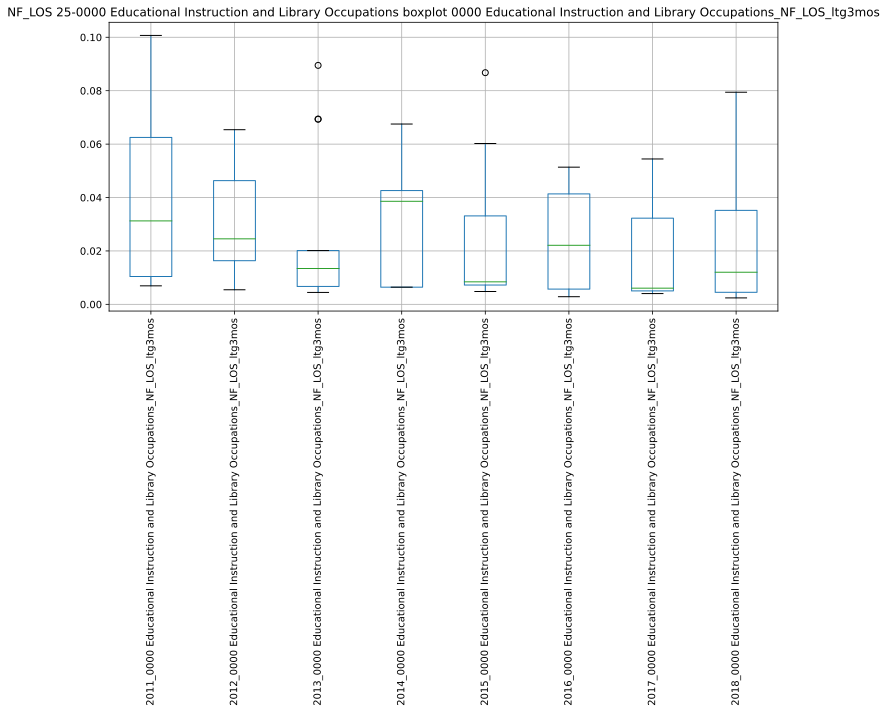

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233519.536422:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233519.573793:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233519.802195:INFO:headless_shell.cc(660)] Written to file /tmp/tmpbeh7iwka/temp.png.
[1013/233520.028537:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233520.069208:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233520.371140:INFO:headless_shell.cc(660)] Written to file /tmp/tmpf8c4neu4/temp.png.
[1013/233520.635025:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233520.673546:WARNI

,2011_0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,2012_0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,2013_0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,2014_0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,2015_0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,2016_0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,2017_0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,2018_0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos
2011_0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,1.000000,0.485590,-0.441966,0.455260,0.216638,0.254514,0.178157,0.330290
2012_0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,0.485590,1.000000,0.017725,-0.341009,-0.027314,-0.204998,0.235363,-0.002249
2013_0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,-0.441966,0.017725,1.000000,-0.114781,0.080675,0.011095,0.189115,-0.433336
2014_0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,0.455260,-0.341009,-0.114781,1.000000,0.531765,0.826923,0.682705,0.020982
2015_0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,0.216638,-0.027314,0.080675,0.531765,1.000000,0.698481,0.630652,0.353088
2016_0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,0.254514,-0.204998,0.011095,0.826923,0.698481,1.000000,0.799124,0.088385
2017_0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,0.178157,0.235363,0.189115,0.682705,0.630652,0.799124,1.000000,0.032783
2018_0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,0.330290,-0.002249,-0.433336,0.020982,0.353088,0.088385,0.032783,1.000000


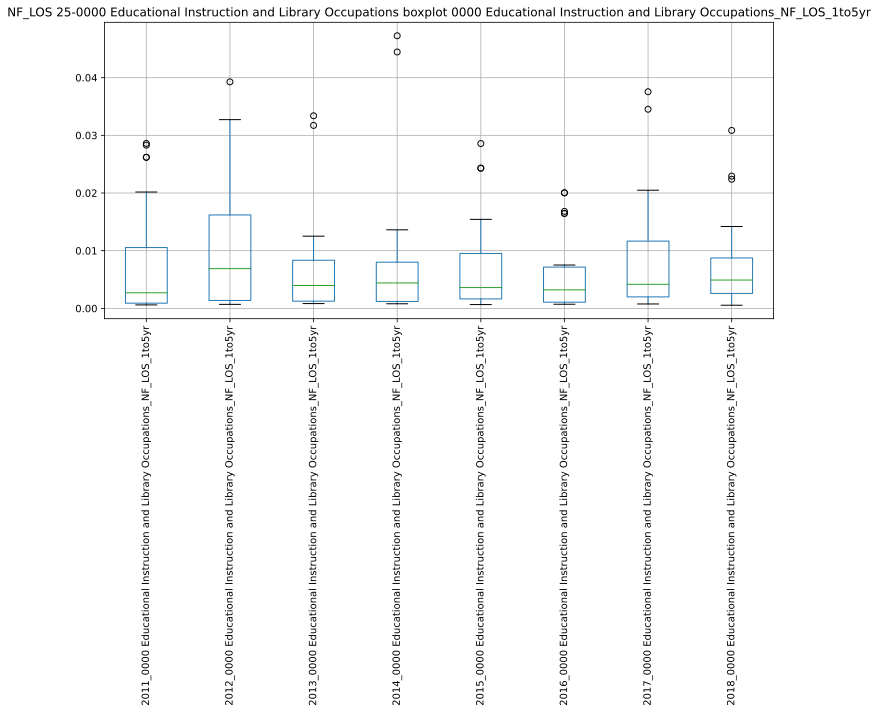

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233524.831538:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233524.873138:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233525.102840:INFO:headless_shell.cc(660)] Written to file /tmp/tmp1nr04dkc/temp.png.
[1013/233525.324012:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233525.361192:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233525.648339:INFO:headless_shell.cc(660)] Written to file /tmp/tmp9sfoywrh/temp.png.
[1013/233525.919362:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233525.957107:WARNI

,2011_0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,2012_0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,2013_0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,2014_0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,2015_0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,2016_0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,2017_0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,2018_0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr
2011_0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,1.000000,0.237888,0.677179,0.206917,-0.233059,0.371139,-0.025940,0.182111
2012_0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,0.237888,1.000000,-0.033573,0.151021,0.006840,0.748457,-0.275801,0.285349
2013_0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,0.677179,-0.033573,1.000000,0.432903,-0.195204,0.146189,0.001508,-0.105734
2014_0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,0.206917,0.151021,0.432903,1.000000,0.325301,0.676081,0.053929,-0.038930
2015_0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,-0.233059,0.006840,-0.195204,0.325301,1.000000,0.228085,0.349557,0.565142
2016_0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,0.371139,0.748457,0.146189,0.676081,0.228085,1.000000,0.331001,0.127783
2017_0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,-0.025940,-0.275801,0.001508,0.053929,0.349557,0.331001,1.000000,0.098898
2018_0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,0.182111,0.285349,-0.105734,-0.038930,0.565142,0.127783,0.098898,1.000000


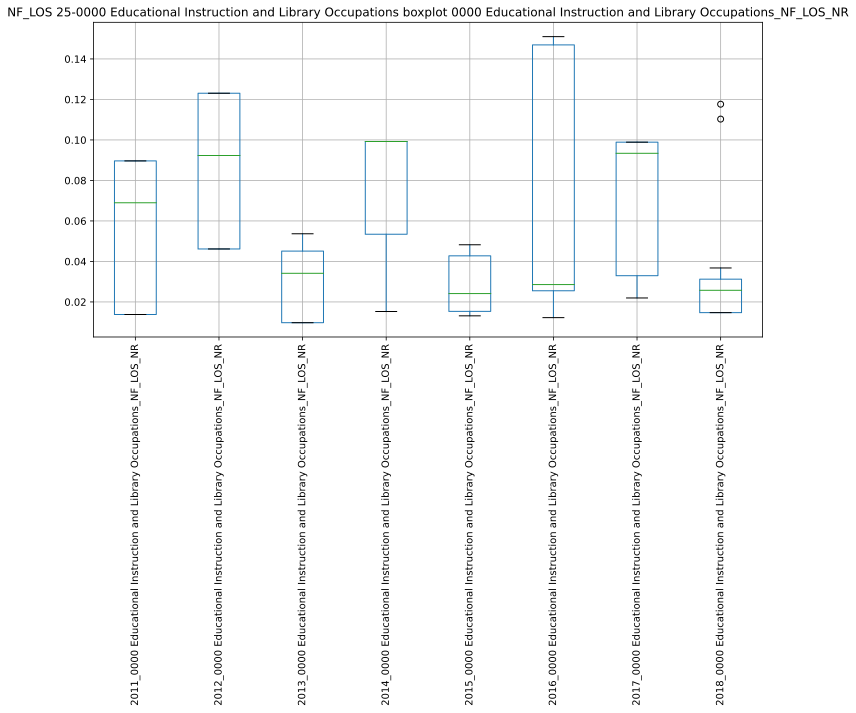

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233529.981528:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233530.019644:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233530.238067:INFO:headless_shell.cc(660)] Written to file /tmp/tmp_y174e77/temp.png.
[1013/233530.461782:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233530.500709:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233530.802601:INFO:headless_shell.cc(660)] Written to file /tmp/tmpnrlx0tgt/temp.png.
[1013/233531.073023:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233531.111835:WARNI

,2011_0000 Educational Instruction and Library Occupations_NF_LOS_NR,2012_0000 Educational Instruction and Library Occupations_NF_LOS_NR,2013_0000 Educational Instruction and Library Occupations_NF_LOS_NR,2014_0000 Educational Instruction and Library Occupations_NF_LOS_NR,2015_0000 Educational Instruction and Library Occupations_NF_LOS_NR,2016_0000 Educational Instruction and Library Occupations_NF_LOS_NR,2017_0000 Educational Instruction and Library Occupations_NF_LOS_NR,2018_0000 Educational Instruction and Library Occupations_NF_LOS_NR
2011_0000 Educational Instruction and Library Occupations_NF_LOS_NR,1.000000,0.607024,0.046747,0.998058,0.326655,0.492320,-0.180625,0.148573
2012_0000 Educational Instruction and Library Occupations_NF_LOS_NR,0.607024,1.000000,0.537184,0.632456,0.321983,0.594843,0.632936,-0.685408
2013_0000 Educational Instruction and Library Occupations_NF_LOS_NR,0.046747,0.537184,1.000000,-0.253226,-0.222355,-0.214353,0.036564,-0.142618
2014_0000 Educational Instruction and Library Occupations_NF_LOS_NR,0.998058,0.632456,-0.253226,1.000000,-0.173492,nan,0.571060,-0.127279
2015_0000 Educational Instruction and Library Occupations_NF_LOS_NR,0.326655,0.321983,-0.222355,-0.173492,1.000000,0.963880,-0.232224,-0.092376
2016_0000 Educational Instruction and Library Occupations_NF_LOS_NR,0.492320,0.594843,-0.214353,nan,0.963880,1.000000,0.191079,-0.239135
2017_0000 Educational Instruction and Library Occupations_NF_LOS_NR,-0.180625,0.632936,0.036564,0.571060,-0.232224,0.191079,1.000000,-0.979148
2018_0000 Educational Instruction and Library Occupations_NF_LOS_NR,0.148573,-0.685408,-0.142618,-0.127279,-0.092376,-0.239135,-0.979148,1.000000


########################################## CORRELATIONS ###############################################
['25-0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos', '25-0000 Educational Instruction and Library Occupations_NF_LOS_5plus', '25-0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos', '25-0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr', '25-0000 Educational Instruction and Library Occupations_NF_LOS_NR']


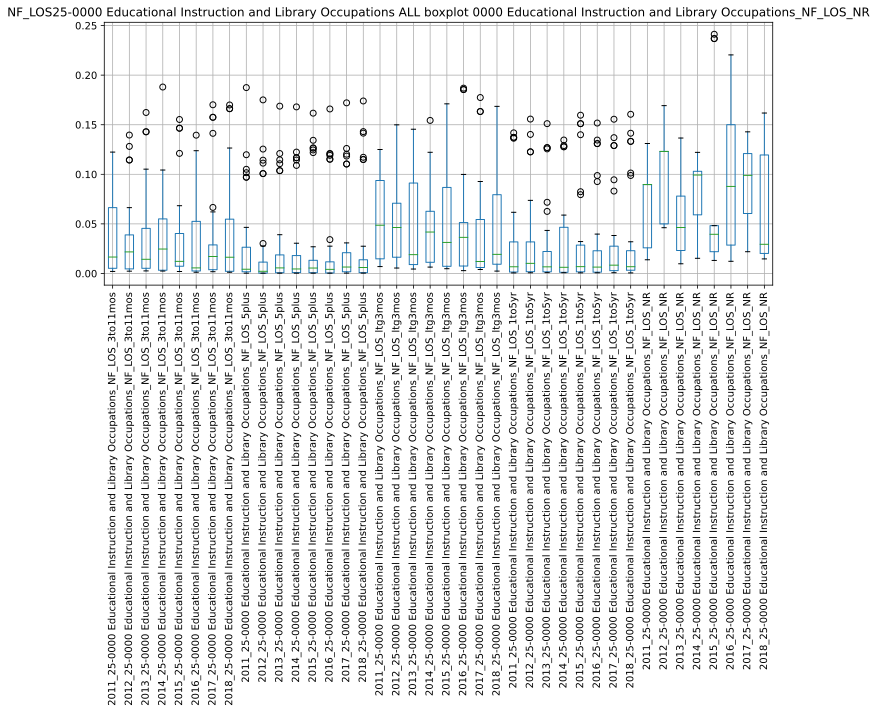

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233535.830126:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233535.869759:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233536.185944:INFO:headless_shell.cc(660)] Written to file /tmp/tmpqqcls1_4/temp.png.
[1013/233536.413621:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233536.454186:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233536.964044:INFO:headless_shell.cc(660)] Written to file /tmp/tmp4bt6ezof/temp.png.
[1013/233537.288263:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233537.329411:WARNI

,2011_25-0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,2012_25-0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,2013_25-0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,2014_25-0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,2015_25-0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,2016_25-0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,2017_25-0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,2018_25-0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,2011_25-0000 Educational Instruction and Library Occupations_NF_LOS_5plus,2012_25-0000 Educational Instruction and Library Occupations_NF_LOS_5plus,2013_25-0000 Educational Instruction and Library Occupations_NF_LOS_5plus,2014_25-0000 Educational Instruction and Library Occupations_NF_LOS_5plus,2015_25-0000 Educational Instruction and Library Occupations_NF_LOS_5plus,2016_25-0000 Educational Instruction and Library Occupations_NF_LOS_5plus,2017_25-0000 Educational Instruction and Library Occupations_NF_LOS_5plus,2018_25-0000 Educational Instruction and Library Occupations_NF_LOS_5plus,2011_25-0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,2012_25-0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,2013_25-0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,2014_25-0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,2015_25-0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,2016_25-0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,2017_25-0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,2018_25-0000 Educational Instruction and Library Occupations_NF_LOS_ltg3mos,2011_25-0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,2012_25-0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,2013_25-0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,2014_25-0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,2015_25-0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,2016_25-0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,2017_25-0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,2018_25-0000 Educational Instruction and Library Occupations_NF_LOS_1to5yr,2011_25-0000 Educational Instruction and Library Occupations_NF_LOS_NR,2012_25-0000 Educational Instruction and Library Occupations_NF_LOS_NR,2013_25-0000 Educational Instruction and Library Occupations_NF_LOS_NR,2014_25-0000 Educational Instruction and Library Occupations_NF_LOS_NR,2015_25-0000 Educational Instruction and Library Occupations_NF_LOS_NR,2016_25-0000 Educational Instruction and Library Occupations_NF_LOS_NR,2017_25-0000 Educational Instruction and Library Occupations_NF_LOS_NR,2018_25-0000 Educational Instruction and Library Occupations_NF_LOS_NR
2011_25-0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,1.000000,-0.164190,0.655585,-0.367061,0.246114,0.113556,-0.118564,0.350698,-0.225084,0.025330,-0.207218,-0.184592,-0.001496,-0.045484,0.322793,-0.172334,0.251409,0.215301,-0.061469,0.213158,-0.064197,0.280684,0.044104,0.274945,-0.112854,0.340330,-0.139554,0.286044,-0.108812,0.331246,-0.026596,0.131220,0.190561,-0.122681,0.060333,0.348348,-0.266617,-0.252364,-0.241855,0.310433
2012_25-0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,-0.164190,1.000000,-0.045846,0.210781,-0.017533,0.548968,0.198676,0.004993,-0.101817,-0.246912,-0.066560,-0.081250,0.208336,-0.057855,0.024240,-0.104435,0.133771,-0.045208,0.204008,-0.067304,0.105341,-0.117660,0.317806,-0.072462,-0.041088,0.035548,-0.040748,-0.176175,0.551069,0.061822,0.277729,0.210575,0.172604,-0.393454,-0.256842,-0.061259,-0.359537,0.166882,-0.543329,0.235699
2013_25-0000 Educational Instruction and Library Occupations_NF_LOS_3to11mos,0.655585,-0.045846,1.000

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
27-0000 Arts, Design, Entertainment, Sports, and Media Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
27-0000 Arts, Design, Entertainment, Sports, and Media Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
27-0000 Arts, Design, Entertainment, Sports, and Media Occupations
 
########## NEED TO EVAL ##################

/home/ediaz/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/ediaz/.local/lib/python3.8/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


############ OCCUPATION ############
27-0000 Arts, Design, Entertainment, Sports, and Media Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
27-0000 Arts, Design, Entertainment, Sports, and Media Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
27-0000 Arts, Design, Entertainment, Sports, and Media Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
27-0000 Arts, Design, Entertainment, Sports, and Media Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
27-0000 Arts, Design, Entertainment, Sports, and Media Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
########################################

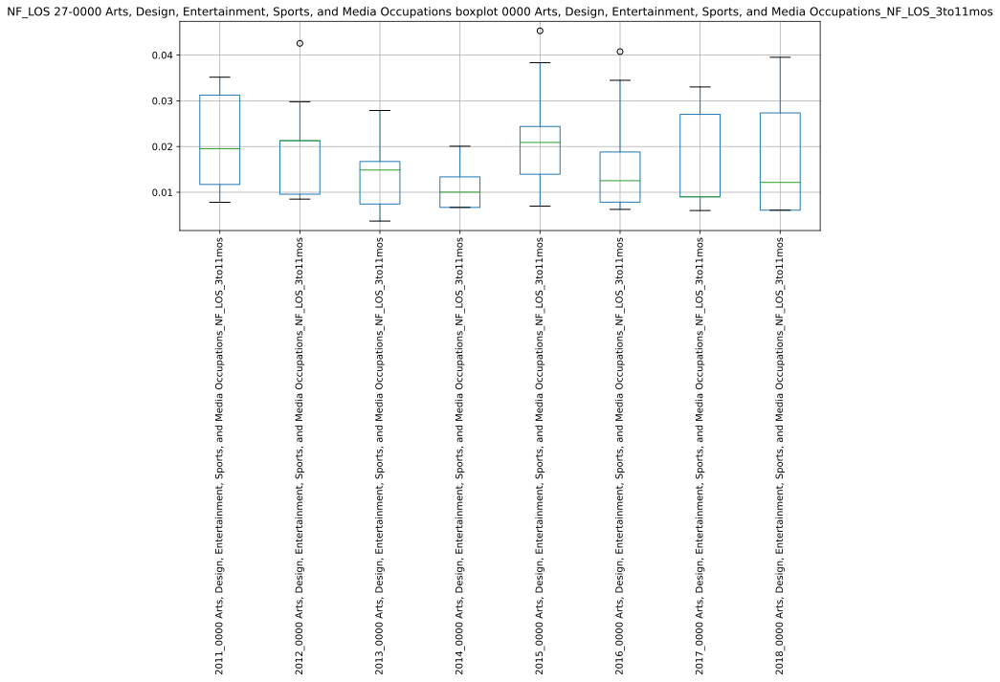

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233617.000157:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233617.040154:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233617.246389:INFO:headless_shell.cc(660)] Written to file /tmp/tmp4dvqoor0/temp.png.
[1013/233617.455834:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233617.493619:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233617.811243:INFO:headless_shell.cc(660)] Written to file /tmp/tmpyfpbz8rr/temp.png.
[1013/233618.080784:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233618.120945:WARNI

,"2011_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos","2012_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos","2013_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos","2014_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos","2015_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos","2016_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos","2017_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos","2018_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos"
"2011_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos",1.000000,-0.312876,-0.005469,0.006130,0.638196,0.241093,-0.175607,0.673680
"2012_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos",-0.312876,1.000000,-0.283998,-0.018624,-0.180075,-0.416480,-0.044859,-0.433413
"2013_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos",-0.005469,-0.283998,1.000000,0.744933,-0.445779,0.272221,0.185541,-0.163451
"2014_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos",0.006130,-0.018624,0.744933,1.000000,-0.229147,0.083195,0.036976,-0.193297
"2015_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos",0.638196,-0.180075,-0.445779,-0.229147,1.000000,0.515124,-0.083488,0.173375
"2016_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos",0.241093,-0.416480,0.272221,0.083195,0.515124,1.000000,-0.031127,0.202924
"2017_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos",-0.175607,-0.044859,0.185541,0.036976,-0.083488,-0.031127,1.000000,-0.480876
"2018_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos",0.673680,-0.433413,-0.163451,-0.193297,0.173375,0.202924,-0.480876,1.000000


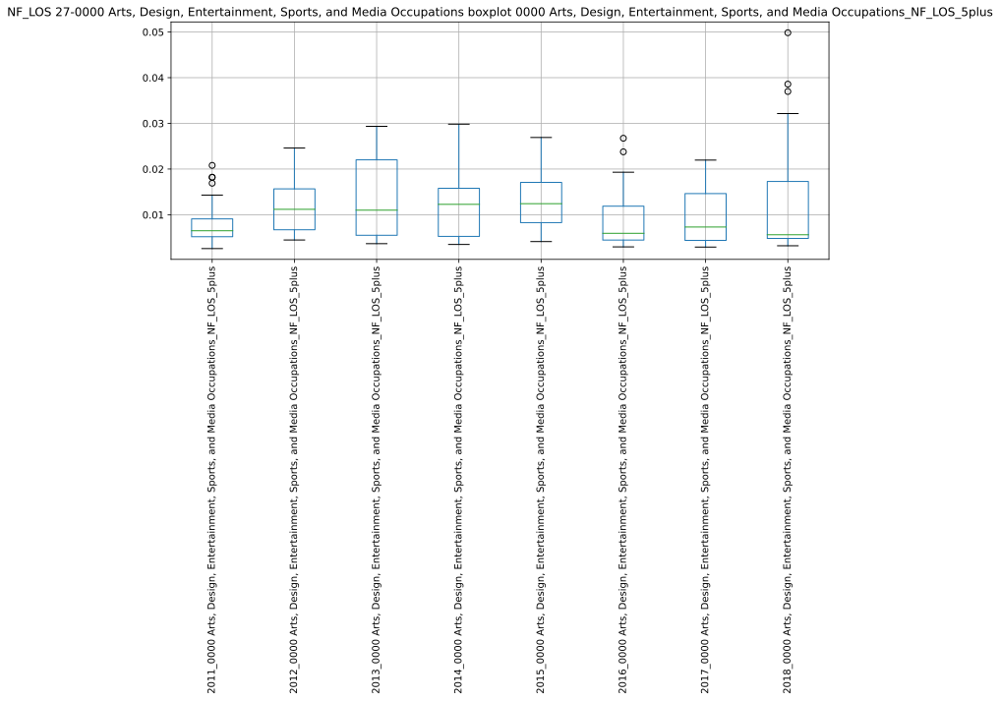

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233622.229992:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233622.269469:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233622.485701:INFO:headless_shell.cc(660)] Written to file /tmp/tmp468vb719/temp.png.
[1013/233622.707888:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233622.744938:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233623.022059:INFO:headless_shell.cc(660)] Written to file /tmp/tmp313sbqz8/temp.png.
[1013/233623.291695:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233623.329399:WARNI

,"2011_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus","2012_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus","2013_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus","2014_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus","2015_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus","2016_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus","2017_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus","2018_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus"
"2011_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus",1.000000,0.224994,-0.095456,0.267443,-0.053016,-0.171247,0.023367,-0.197497
"2012_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus",0.224994,1.000000,0.077439,-0.038981,0.093699,0.039110,-0.171668,-0.133553
"2013_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus",-0.095456,0.077439,1.000000,-0.607323,0.514133,0.045380,-0.131780,0.024412
"2014_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus",0.267443,-0.038981,-0.607323,1.000000,-0.500520,-0.125613,0.412058,-0.224806
"2015_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus",-0.053016,0.093699,0.514133,-0.500520,1.000000,0.036617,-0.595395,-0.202232
"2016_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus",-0.171247,0.039110,0.045380,-0.125613,0.036617,1.000000,0.586290,0.260770
"2017_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus",0.023367,-0.171668,-0.131780,0.412058,-0.595395,0.586290,1.000000,0.385342
"2018_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus",-0.197497,-0.133553,0.024412,-0.224806,-0.202232,0.260770,0.385342,1.000000


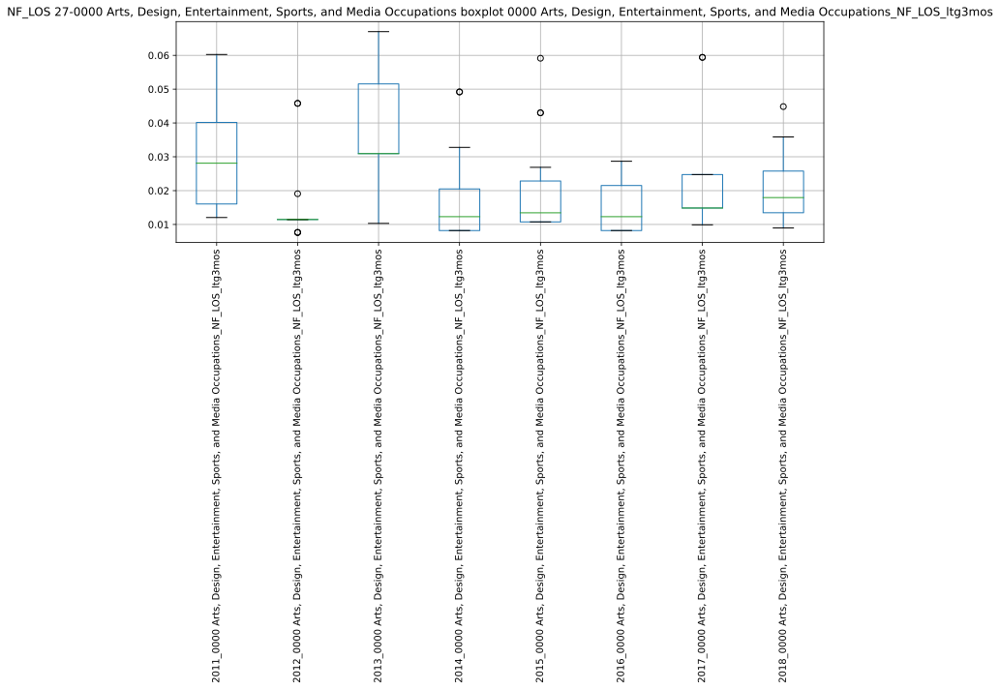

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233627.475275:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233627.515000:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233627.752088:INFO:headless_shell.cc(660)] Written to file /tmp/tmp3c8ovjpm/temp.png.
[1013/233627.975968:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233628.017056:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233628.324682:INFO:headless_shell.cc(660)] Written to file /tmp/tmpznut_15w/temp.png.
[1013/233628.596133:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233628.634077:WARNI

,"2011_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos","2012_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos","2013_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos","2014_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos","2015_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos","2016_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos","2017_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos","2018_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos"
"2011_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos",1.000000,-0.076924,0.670477,-0.337188,-0.169481,-0.403331,-0.184482,-0.203074
"2012_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos",-0.076924,1.000000,-0.086146,0.204784,0.443980,0.413825,0.949067,-0.063078
"2013_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos",0.670477,-0.086146,1.000000,0.385271,0.206363,-0.128532,-0.247460,-0.425922
"2014_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos",-0.337188,0.204784,0.385271,1.000000,-0.117621,0.052093,0.083022,0.035319
"2015_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos",-0.169481,0.443980,0.206363,-0.117621,1.000000,0.027554,0.452663,0.158592
"2016_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos",-0.403331,0.413825,-0.128532,0.052093,0.027554,1.000000,0.393445,0.124073
"2017_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos",-0.184482,0.949067,-0.247460,0.083022,0.452663,0.393445,1.000000,0.613222
"2018_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos",-0.203074,-0.063078,-0.425922,0.035319,0.158592,0.124073,0.613222,1.000000


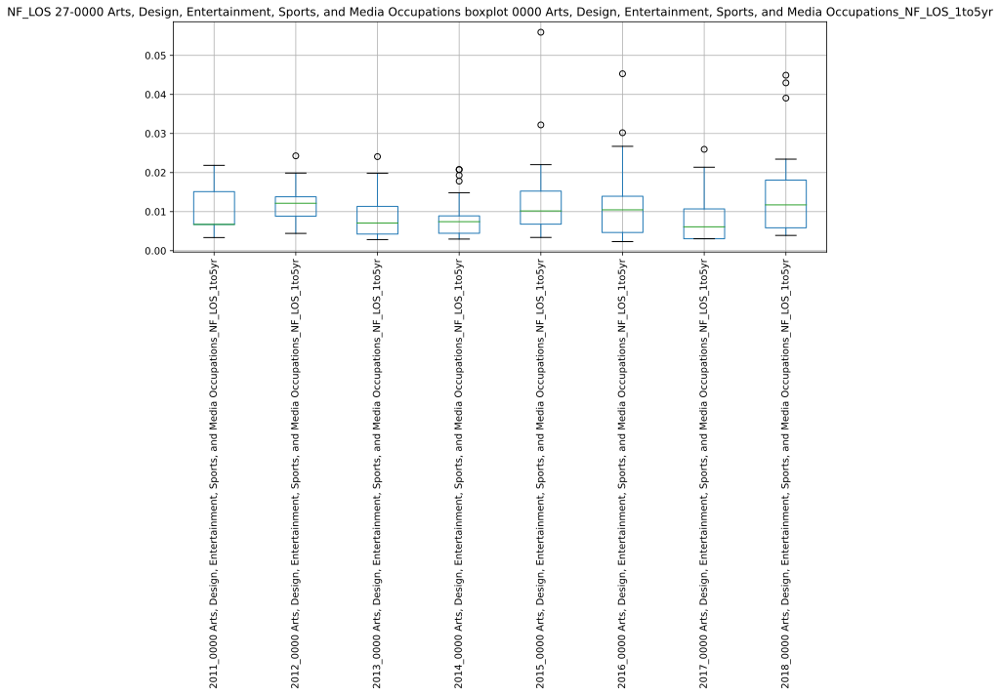

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233632.949596:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233632.987148:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233633.234154:INFO:headless_shell.cc(660)] Written to file /tmp/tmpfv4m74kw/temp.png.
[1013/233633.462013:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233633.499212:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233633.804925:INFO:headless_shell.cc(660)] Written to file /tmp/tmpgcypmkdy/temp.png.
[1013/233634.081135:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233634.120560:WARNI

,"2011_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr","2012_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr","2013_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr","2014_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr","2015_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr","2016_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr","2017_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr","2018_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr"
"2011_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr",1.000000,0.068727,0.070842,0.388289,0.137645,-0.013656,0.029591,-0.156574
"2012_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr",0.068727,1.000000,0.259929,-0.262436,0.093987,0.398208,-0.214875,0.239416
"2013_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr",0.070842,0.259929,1.000000,-0.242180,0.316557,0.127349,0.293040,-0.051870
"2014_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr",0.388289,-0.262436,-0.242180,1.000000,-0.009513,0.036220,0.173037,-0.379446
"2015_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr",0.137645,0.093987,0.316557,-0.009513,1.000000,0.700076,0.033674,-0.150979
"2016_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr",-0.013656,0.398208,0.127349,0.036220,0.700076,1.000000,-0.090188,0.107497
"2017_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr",0.029591,-0.214875,0.293040,0.173037,0.033674,-0.090188,1.000000,-0.192544
"2018_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr",-0.156574,0.239416,-0.051870,-0.379446,-0.150979,0.107497,-0.192544,1.000000


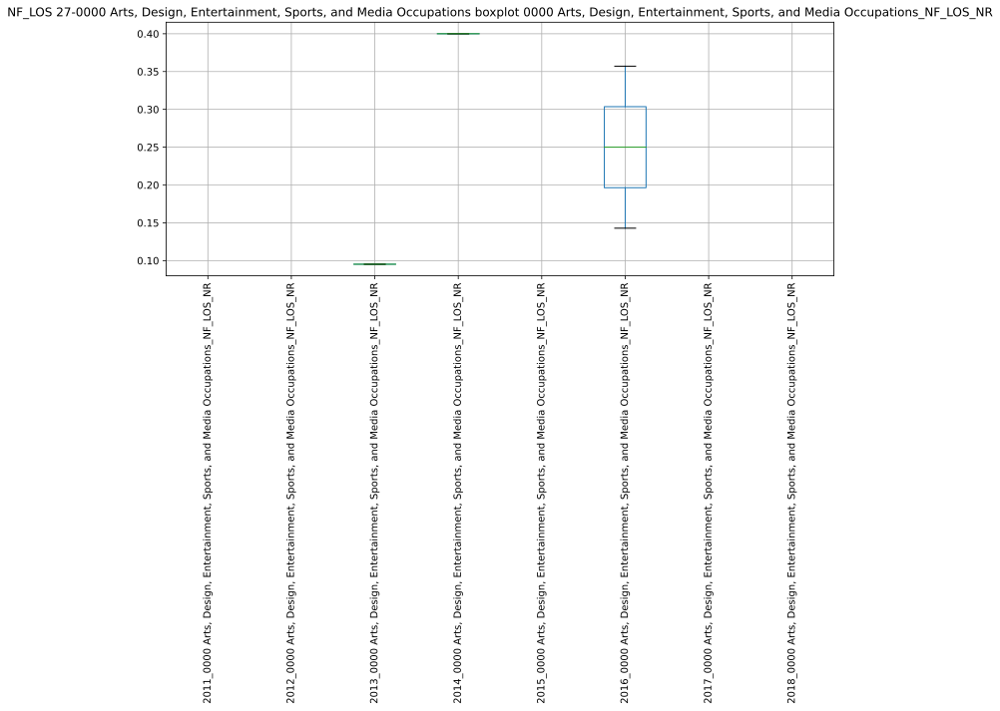

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233638.232038:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233638.270227:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233638.477212:INFO:headless_shell.cc(660)] Written to file /tmp/tmp2mu6x3i8/temp.png.
[1013/233638.699271:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233638.739653:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233639.015220:INFO:headless_shell.cc(660)] Written to file /tmp/tmpcaiwjvxp/temp.png.
[1013/233639.286008:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233639.324946:WARNI

,"2011_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR","2012_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR","2013_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR","2014_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR","2015_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR","2016_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR","2017_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR","2018_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR"
"2011_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR",nan,nan,nan,nan,nan,nan,nan,nan
"2012_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR",nan,nan,nan,nan,nan,nan,nan,nan
"2013_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR",nan,nan,nan,nan,nan,nan,nan,nan
"2014_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR",nan,nan,nan,nan,nan,nan,nan,nan
"2015_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR",nan,nan,nan,nan,nan,nan,nan,nan
"2016_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR",nan,nan,nan,nan,nan,1.000000,nan,nan
"2017_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR",nan,nan,nan,nan,nan,nan,nan,nan
"2018_0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR",nan,nan,nan,nan,nan,nan,nan,nan


########################################## CORRELATIONS ###############################################
['27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos', '27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus', '27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos', '27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr', '27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR']


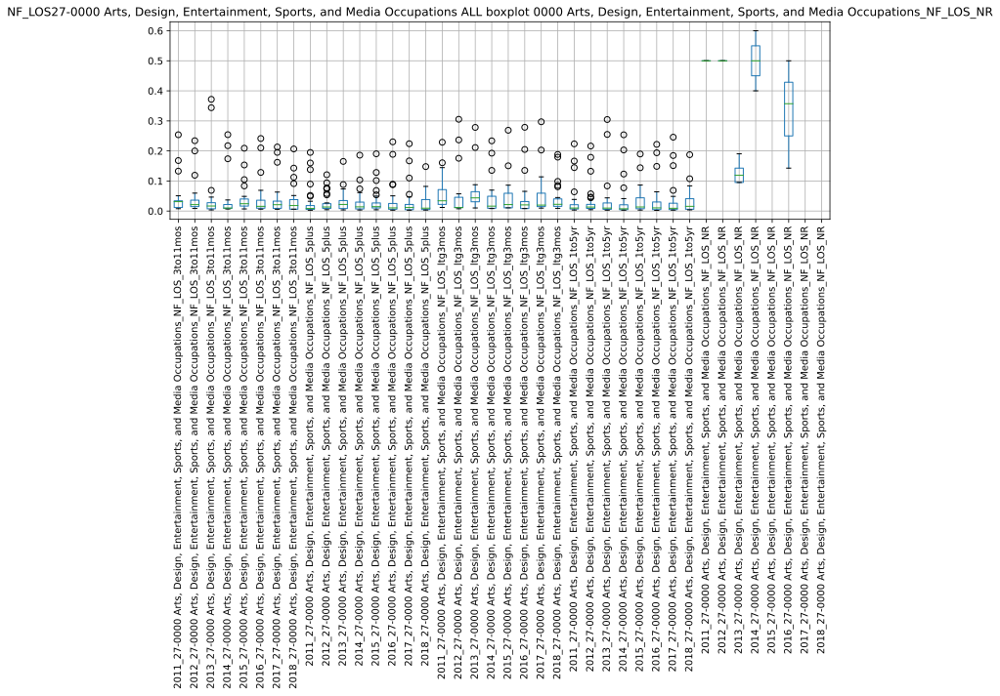

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233645.562759:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233645.600376:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233645.939360:INFO:headless_shell.cc(660)] Written to file /tmp/tmp8zbzcrqm/temp.png.
[1013/233646.162728:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233646.204769:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233646.696984:INFO:headless_shell.cc(660)] Written to file /tmp/tmpmli1_69d/temp.png.
[1013/233647.015689:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233647.054350:WARNI

,"2011_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos","2012_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos","2013_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos","2014_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos","2015_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos","2016_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos","2017_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos","2018_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos","2011_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus","2012_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus","2013_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus","2014_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus","2015_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus","2016_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus","2017_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus","2018_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_5plus","2011_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos","2012_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos","2013_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos","2014_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos","2015_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos","2016_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos","2017_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos","2018_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_ltg3mos","2011_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr","2012_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr","2013_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr","2014_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr","2015_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr","2016_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr","2017_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr","2018_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_1to5yr","2011_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR","2012_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR","2013_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR","2014_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR","2015_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR","2016_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR","2017_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR","2018_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_NR"
"2011_27-0000 Arts, Design, Entertainment, Sports, and Media Occupations_NF_LOS_3to11mos",1.000000,0.952543,0.633530,-0.140190,0.925766,-0.089336,0.533554,0.094570,0.107040,-0.016316,-0.141194,0.054241,0.129638,-0.160324,-0.140414,0.106787,0.884809,0.974841,0.051177,0.916948,0.143894,0.895817,0.102546,-0.047335,-0.147633,0.242150,0.329951,-0.167038,0.062762,0.268978,0.236501,-0.182638,nan,nan,-0.157843,1.000000,nan,-0.898442,nan,nan
"2012_27-0000 Arts, Design, Entertainment, Sports, and Med

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
29-0000 Healthcare Practitioners and Technical Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
29-0000 Healthcare Practitioners and Technical Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
29-0000 Healthcare Practitioners and Technical Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL

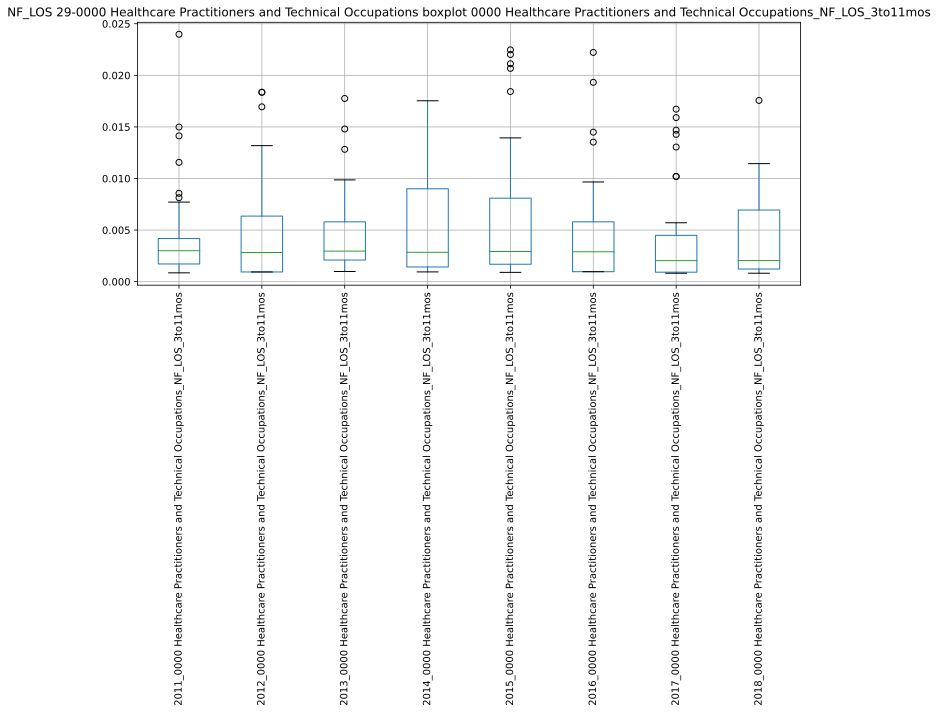

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233807.645511:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233807.687236:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233807.902321:INFO:headless_shell.cc(660)] Written to file /tmp/tmpbkq_q3jq/temp.png.
[1013/233808.136078:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233808.175764:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233808.499476:INFO:headless_shell.cc(660)] Written to file /tmp/tmp44jc9ax6/temp.png.
[1013/233808.785026:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233808.823810:WARNI

,2011_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,2012_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,2013_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,2014_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,2015_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,2016_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,2017_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,2018_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos
2011_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,1.000000,0.468945,0.875122,-0.195829,0.636821,0.348987,0.344716,0.064814
2012_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,0.468945,1.000000,0.235969,-0.485700,-0.037135,0.176051,-0.239651,-0.146160
2013_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,0.875122,0.235969,1.000000,-0.126271,0.668986,-0.122705,0.322594,0.306789
2014_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,-0.195829,-0.485700,-0.126271,1.000000,-0.138563,-0.055369,0.495761,-0.005167
2015_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,0.636821,-0.037135,0.668986,-0.138563,1.000000,0.270814,0.300458,0.434763
2016_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,0.348987,0.176051,-0.122705,-0.055369,0.270814,1.000000,0.134031,-0.102877
2017_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,0.344716,-0.239651,0.322594,0.495761,0.300458,0.134031,1.000000,0.290052
2018_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,0.064814,-0.146160,0.306789,-0.005167,0.434763,-0.102877,0.290052,1.000000


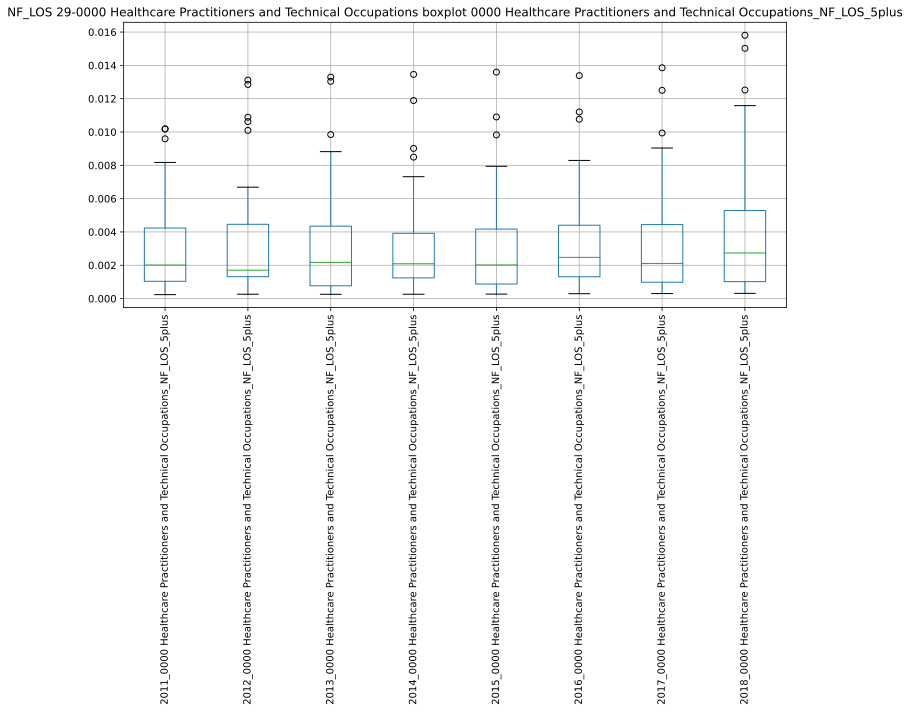

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233812.974196:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233813.015185:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233813.256017:INFO:headless_shell.cc(660)] Written to file /tmp/tmp0mb242ox/temp.png.
[1013/233813.482810:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233813.523491:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233813.823446:INFO:headless_shell.cc(660)] Written to file /tmp/tmpm7r1ymfm/temp.png.
[1013/233814.092317:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233814.134082:WARNI

,2011_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,2012_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,2013_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,2014_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,2015_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,2016_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,2017_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,2018_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus
2011_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,1.000000,0.695833,-0.129162,0.167986,-0.093705,-0.025912,-0.150506,0.801183
2012_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,0.695833,1.000000,0.049540,0.213051,-0.101592,-0.056423,-0.275347,0.668540
2013_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,-0.129162,0.049540,1.000000,-0.216727,0.773268,0.780676,-0.186996,-0.021079
2014_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,0.167986,0.213051,-0.216727,1.000000,-0.027695,-0.040618,0.025401,0.303926
2015_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,-0.093705,-0.101592,0.773268,-0.027695,1.000000,0.846266,-0.015092,0.044809
2016_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,-0.025912,-0.056423,0.780676,-0.040618,0.846266,1.000000,0.042816,0.032543
2017_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,-0.150506,-0.275347,-0.186996,0.025401,-0.015092,0.042816,1.000000,-0.080060
2018_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,0.801183,0.668540,-0.021079,0.303926,0.044809,0.032543,-0.080060,1.000000


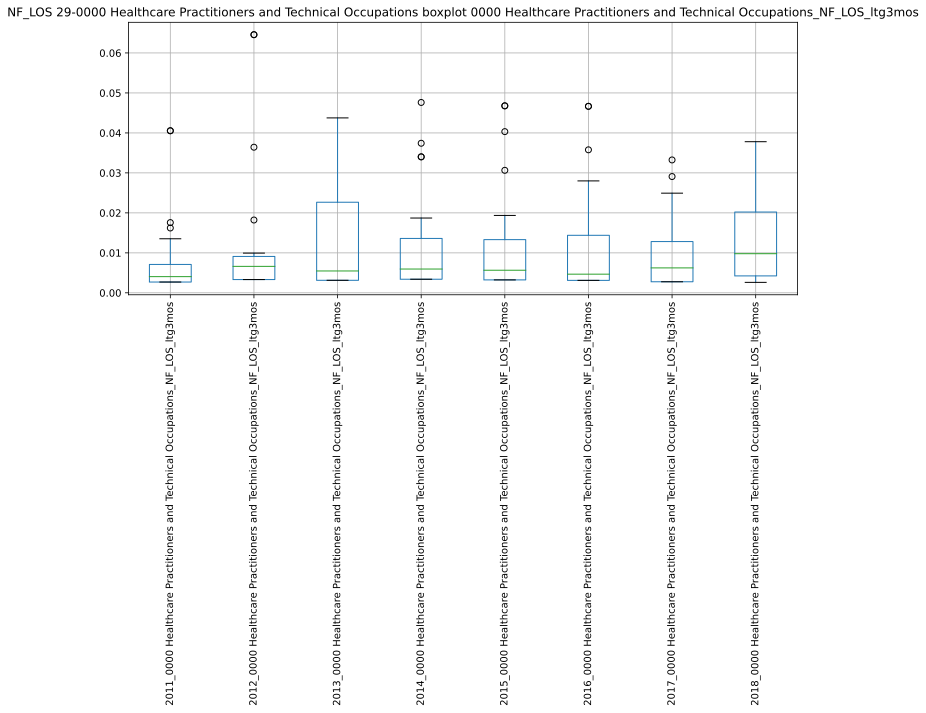

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233818.186162:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233818.227454:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233818.438992:INFO:headless_shell.cc(660)] Written to file /tmp/tmpo3942js6/temp.png.
[1013/233818.658355:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233818.698089:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233818.967137:INFO:headless_shell.cc(660)] Written to file /tmp/tmpsu3m8fwr/temp.png.
[1013/233819.236430:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233819.278933:WARNI

,2011_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,2012_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,2013_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,2014_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,2015_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,2016_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,2017_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,2018_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos
2011_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,1.000000,-0.178154,0.596379,0.649022,0.120864,0.407273,0.422213,0.157604
2012_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,-0.178154,1.000000,0.085698,0.239579,0.568447,0.459488,0.076682,0.327493
2013_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,0.596379,0.085698,1.000000,0.404570,-0.211283,0.359778,0.328237,0.700348
2014_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,0.649022,0.239579,0.404570,1.000000,0.399769,0.871699,0.160939,0.055374
2015_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,0.120864,0.568447,-0.211283,0.399769,1.000000,0.464295,0.535640,-0.124342
2016_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,0.407273,0.459488,0.359778,0.871699,0.464295,1.000000,0.208800,0.069741
2017_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,0.422213,0.076682,0.328237,0.160939,0.535640,0.208800,1.000000,0.231396
2018_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,0.157604,0.327493,0.700348,0.055374,-0.124342,0.069741,0.231396,1.000000


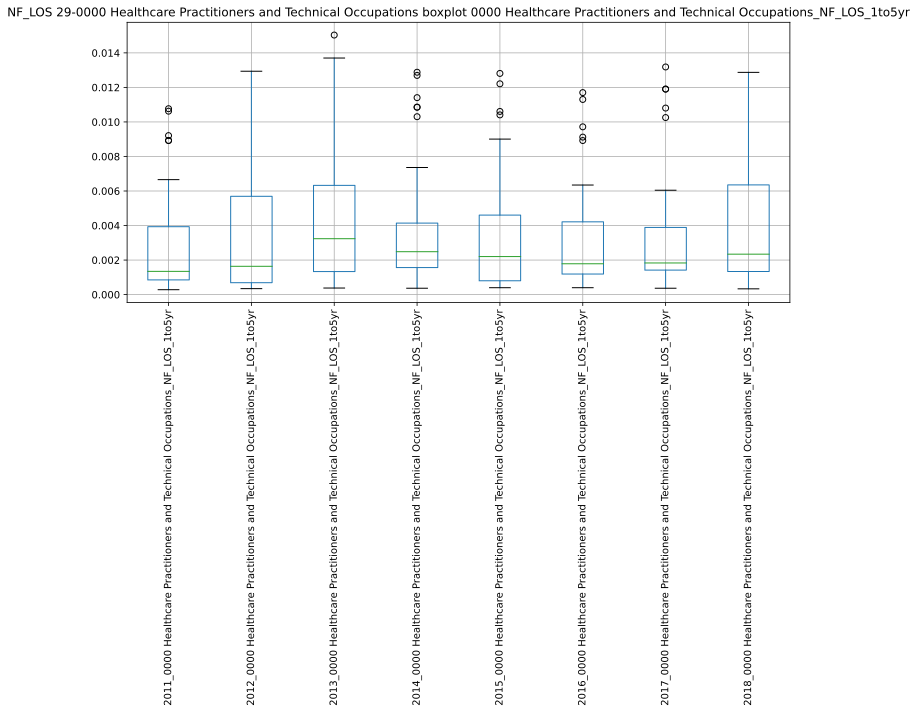

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233823.534420:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233823.574373:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233823.793534:INFO:headless_shell.cc(660)] Written to file /tmp/tmpz13ivyoa/temp.png.
[1013/233824.009844:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233824.051138:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233824.361282:INFO:headless_shell.cc(660)] Written to file /tmp/tmpgheww2t6/temp.png.
[1013/233824.625018:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233824.664380:WARNI

,2011_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,2012_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,2013_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,2014_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,2015_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,2016_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,2017_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,2018_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr
2011_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,1.000000,-0.090204,-0.103020,0.080388,0.205887,0.022526,0.195898,0.373298
2012_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,-0.090204,1.000000,0.468726,0.124579,0.133733,0.572578,-0.022124,-0.022726
2013_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,-0.103020,0.468726,1.000000,0.164029,0.025952,0.368015,0.281609,0.177538
2014_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,0.080388,0.124579,0.164029,1.000000,0.251085,0.004173,0.626661,0.065458
2015_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,0.205887,0.133733,0.025952,0.251085,1.000000,0.282556,0.174108,0.299097
2016_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,0.022526,0.572578,0.368015,0.004173,0.282556,1.000000,0.246795,0.075199
2017_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,0.195898,-0.022124,0.281609,0.626661,0.174108,0.246795,1.000000,0.226020
2018_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,0.373298,-0.022726,0.177538,0.065458,0.299097,0.075199,0.226020,1.000000


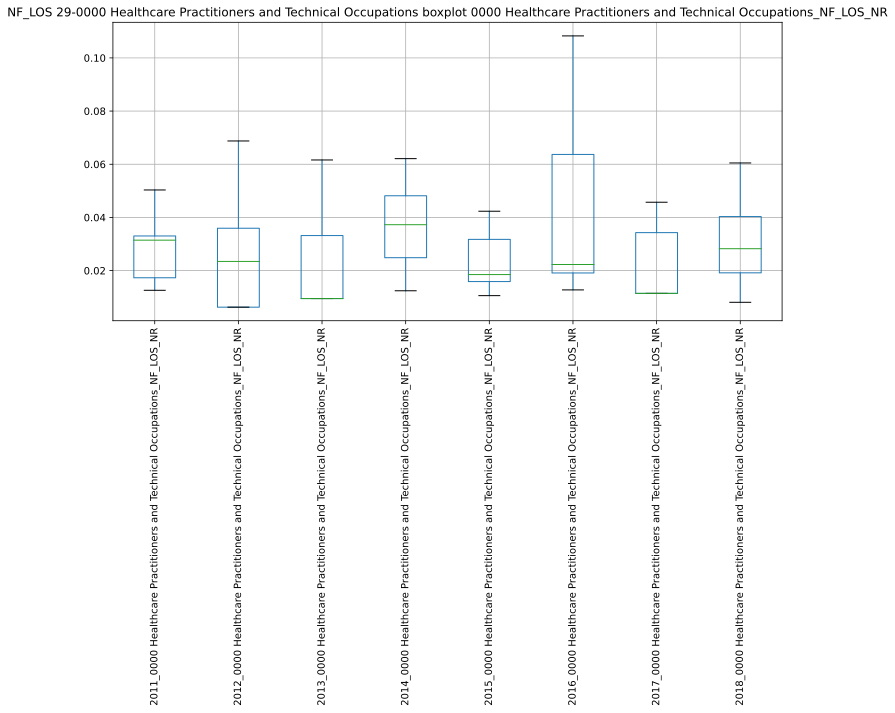

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233828.714458:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233828.755337:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233828.996972:INFO:headless_shell.cc(660)] Written to file /tmp/tmpsv5k3y79/temp.png.
[1013/233829.223759:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233829.252179:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233829.547736:INFO:headless_shell.cc(660)] Written to file /tmp/tmp6j2jwqja/temp.png.
[1013/233829.810986:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233829.848827:WARNI

,2011_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,2012_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,2013_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,2014_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,2015_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,2016_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,2017_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,2018_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR
2011_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,1.000000,0.660401,-0.252418,0.167343,-0.189688,0.214768,0.284135,0.320503
2012_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,0.660401,1.000000,-0.134296,0.476017,0.637092,0.182519,-0.238759,0.064282
2013_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,-0.252418,-0.134296,1.000000,-0.397151,-0.026049,0.025391,-0.271682,0.037487
2014_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,0.167343,0.476017,-0.397151,1.000000,0.587945,0.592297,0.704647,0.633254
2015_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,-0.189688,0.637092,-0.026049,0.587945,1.000000,0.449807,0.028714,0.336020
2016_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,0.214768,0.182519,0.025391,0.592297,0.449807,1.000000,0.955573,0.681176
2017_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,0.284135,-0.238759,-0.271682,0.704647,0.028714,0.955573,1.000000,0.718948
2018_0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,0.320503,0.064282,0.037487,0.633254,0.336020,0.681176,0.718948,1.000000


########################################## CORRELATIONS ###############################################
['29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos', '29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus', '29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos', '29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr', '29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR']


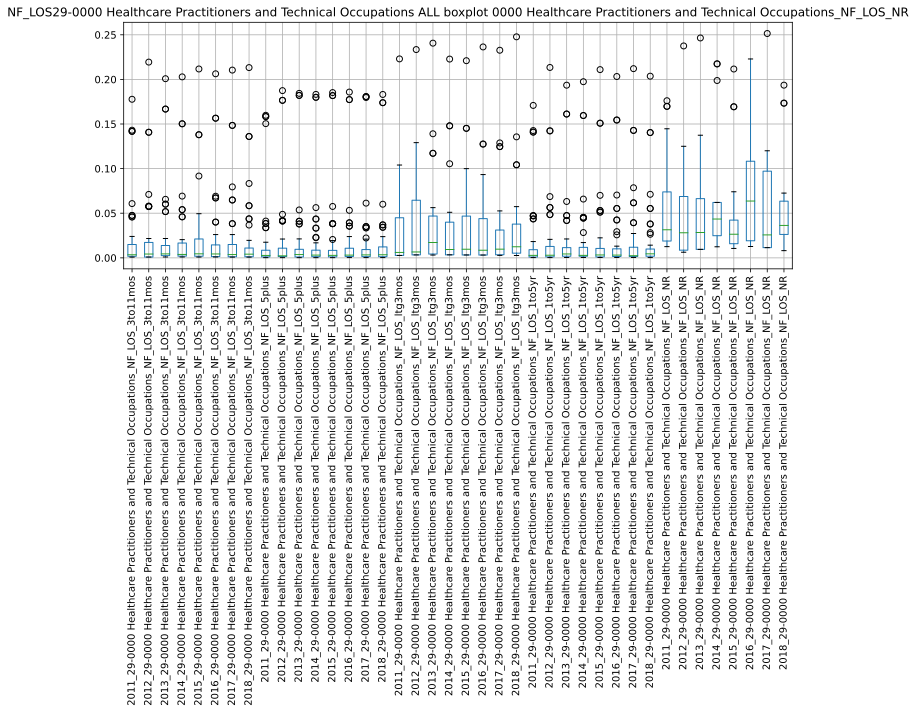

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233835.978009:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233836.015654:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233836.354797:INFO:headless_shell.cc(660)] Written to file /tmp/tmpx1lj9ucw/temp.png.
[1013/233836.590186:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233836.627259:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233837.127400:INFO:headless_shell.cc(660)] Written to file /tmp/tmpax8h87p6/temp.png.
[1013/233837.456706:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233837.496144:WARNI

,2011_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,2012_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,2013_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,2014_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,2015_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,2016_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,2017_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,2018_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,2011_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,2012_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,2013_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,2014_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,2015_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,2016_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,2017_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,2018_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_5plus,2011_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,2012_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,2013_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,2014_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,2015_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,2016_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,2017_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,2018_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_ltg3mos,2011_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,2012_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,2013_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,2014_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,2015_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,2016_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,2017_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,2018_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_1to5yr,2011_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,2012_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,2013_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,2014_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,2015_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,2016_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,2017_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR,2018_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_NR
2011_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,1.000000,-0.092283,0.872064,0.308596,0.165011,0.085215,-0.154052,0.070291,-0.092459,-0.046691,-0.119972,-0.006050,-0.115983,-0.119690,-0.153892,-0.053857,-0.119298,-0.059708,0.159464,-0.164846,-0.118784,-0.150063,-0.153921,0.226798,-0.158133,-0.169749,-0.164060,-0.073837,-0.152818,-0.179290,-0.083334,-0.067192,-0.264937,0.241026,0.060327,-0.151835,0.188516,-0.283861,-0.060337,-0.336722
2012_29-0000 Healthcare Practitioners and Technical Occupations_NF_LOS_3to11mos,-0.092283,1.000000,-0.055518,-0.172300,0.355470,0.279835,0.233253,0.169972,-0.056294,-0.010375,-0.101839,-0.023421,-0.092357,-0.086077,-0.132518,-0.010113,0.246707,-0.088490,-0.059935,-0.170395,-0.020229,-0.123698,0.229217,-0.145898,-0.110730,-0.137882,-0.149812,-0.012253,-0.102606,-0.131725,-0.029418,-0.009536,-0.207563,-0.208734,0.132073,-0.0

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
31-0000 Healthcare Support Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
31-0000 Healthcare Support Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
31-0000 Healthcare Support Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
31-

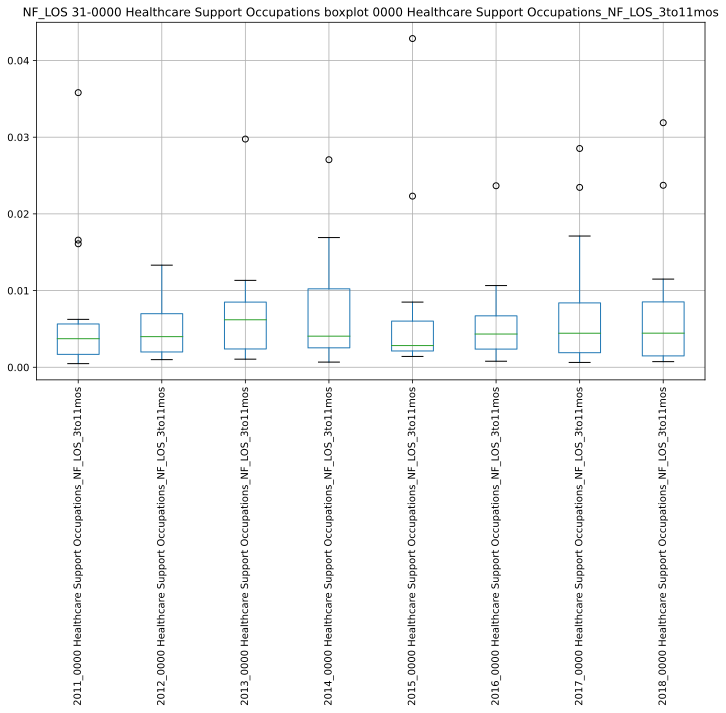

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233916.887939:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233916.928186:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233917.148546:INFO:headless_shell.cc(660)] Written to file /tmp/tmpursbf9th/temp.png.
[1013/233917.378265:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233917.415590:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233917.726760:INFO:headless_shell.cc(660)] Written to file /tmp/tmpljvosoy7/temp.png.
[1013/233917.997535:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233918.036128:WARNI

,2011_0000 Healthcare Support Occupations_NF_LOS_3to11mos,2012_0000 Healthcare Support Occupations_NF_LOS_3to11mos,2013_0000 Healthcare Support Occupations_NF_LOS_3to11mos,2014_0000 Healthcare Support Occupations_NF_LOS_3to11mos,2015_0000 Healthcare Support Occupations_NF_LOS_3to11mos,2016_0000 Healthcare Support Occupations_NF_LOS_3to11mos,2017_0000 Healthcare Support Occupations_NF_LOS_3to11mos,2018_0000 Healthcare Support Occupations_NF_LOS_3to11mos
2011_0000 Healthcare Support Occupations_NF_LOS_3to11mos,1.000000,-0.120903,0.295176,0.620259,0.968782,0.233400,0.472824,0.244751
2012_0000 Healthcare Support Occupations_NF_LOS_3to11mos,-0.120903,1.000000,0.575785,0.521755,0.060744,0.832676,0.718592,0.515124
2013_0000 Healthcare Support Occupations_NF_LOS_3to11mos,0.295176,0.575785,1.000000,0.740888,0.462904,0.828594,0.676005,0.807291
2014_0000 Healthcare Support Occupations_NF_LOS_3to11mos,0.620259,0.521755,0.740888,1.000000,0.669303,0.743080,0.769630,0.709624
2015_0000 Healthcare Support Occupations_NF_LOS_3to11mos,0.968782,0.060744,0.462904,0.669303,1.000000,0.416735,0.582182,0.516473
2016_0000 Healthcare Support Occupations_NF_LOS_3to11mos,0.233400,0.832676,0.828594,0.743080,0.416735,1.000000,0.816600,0.784811
2017_0000 Healthcare Support Occupations_NF_LOS_3to11mos,0.472824,0.718592,0.676005,0.769630,0.582182,0.816600,1.000000,0.619463
2018_0000 Healthcare Support Occupations_NF_LOS_3to11mos,0.244751,0.515124,0.807291,0.709624,0.516473,0.784811,0.619463,1.000000


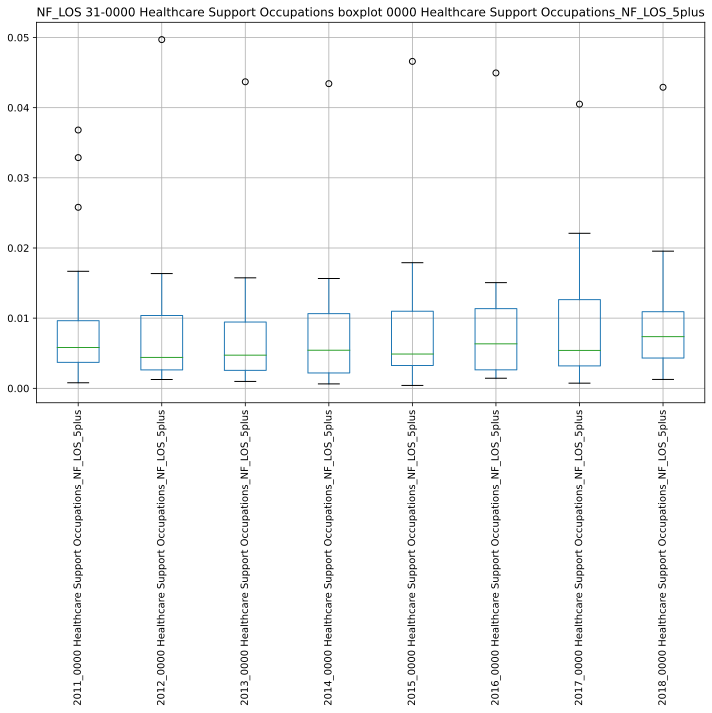

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233920.778718:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233920.818412:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233921.041318:INFO:headless_shell.cc(660)] Written to file /tmp/tmp3g_9zdyl/temp.png.
[1013/233921.262998:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233921.301271:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233921.590444:INFO:headless_shell.cc(660)] Written to file /tmp/tmp0e3pgjwf/temp.png.
[1013/233921.856301:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233921.894196:WARNI

,2011_0000 Healthcare Support Occupations_NF_LOS_5plus,2012_0000 Healthcare Support Occupations_NF_LOS_5plus,2013_0000 Healthcare Support Occupations_NF_LOS_5plus,2014_0000 Healthcare Support Occupations_NF_LOS_5plus,2015_0000 Healthcare Support Occupations_NF_LOS_5plus,2016_0000 Healthcare Support Occupations_NF_LOS_5plus,2017_0000 Healthcare Support Occupations_NF_LOS_5plus,2018_0000 Healthcare Support Occupations_NF_LOS_5plus
2011_0000 Healthcare Support Occupations_NF_LOS_5plus,1.000000,0.853397,0.844417,0.835174,0.783433,0.747593,0.843030,0.008349
2012_0000 Healthcare Support Occupations_NF_LOS_5plus,0.853397,1.000000,0.982738,0.958435,0.957145,0.927344,0.912153,0.640198
2013_0000 Healthcare Support Occupations_NF_LOS_5plus,0.844417,0.982738,1.000000,0.977858,0.961143,0.935856,0.956033,0.634217
2014_0000 Healthcare Support Occupations_NF_LOS_5plus,0.835174,0.958435,0.977858,1.000000,0.966407,0.916699,0.962579,0.657356
2015_0000 Healthcare Support Occupations_NF_LOS_5plus,0.783433,0.957145,0.961143,0.966407,1.000000,0.934389,0.924233,0.875271
2016_0000 Healthcare Support Occupations_NF_LOS_5plus,0.747593,0.927344,0.935856,0.916699,0.934389,1.000000,0.866694,0.665479
2017_0000 Healthcare Support Occupations_NF_LOS_5plus,0.843030,0.912153,0.956033,0.962579,0.924233,0.866694,1.000000,0.512165
2018_0000 Healthcare Support Occupations_NF_LOS_5plus,0.008349,0.640198,0.634217,0.657356,0.875271,0.665479,0.512165,1.000000


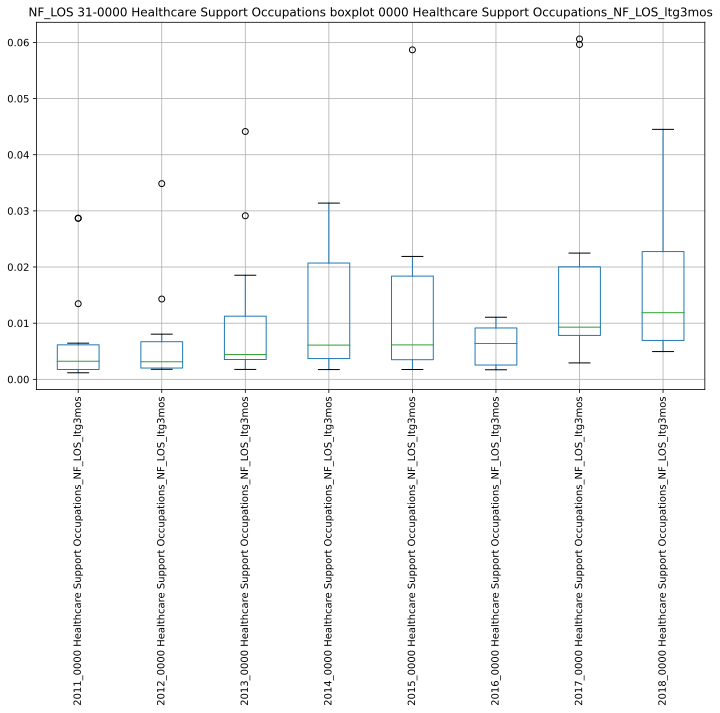

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233924.624146:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233924.663926:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233924.874864:INFO:headless_shell.cc(660)] Written to file /tmp/tmpmzkhcprw/temp.png.
[1013/233925.103657:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233925.144784:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233925.435146:INFO:headless_shell.cc(660)] Written to file /tmp/tmpbp7j3cbc/temp.png.
[1013/233925.708177:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233925.745839:WARNI

,2011_0000 Healthcare Support Occupations_NF_LOS_ltg3mos,2012_0000 Healthcare Support Occupations_NF_LOS_ltg3mos,2013_0000 Healthcare Support Occupations_NF_LOS_ltg3mos,2014_0000 Healthcare Support Occupations_NF_LOS_ltg3mos,2015_0000 Healthcare Support Occupations_NF_LOS_ltg3mos,2016_0000 Healthcare Support Occupations_NF_LOS_ltg3mos,2017_0000 Healthcare Support Occupations_NF_LOS_ltg3mos,2018_0000 Healthcare Support Occupations_NF_LOS_ltg3mos
2011_0000 Healthcare Support Occupations_NF_LOS_ltg3mos,1.000000,0.691484,0.583437,-0.160160,-0.183240,0.481687,-0.326452,-0.224887
2012_0000 Healthcare Support Occupations_NF_LOS_ltg3mos,0.691484,1.000000,0.875956,-0.189621,-0.293036,0.478586,-0.272749,-0.328223
2013_0000 Healthcare Support Occupations_NF_LOS_ltg3mos,0.583437,0.875956,1.000000,-0.015505,-0.004961,0.465878,-0.260567,-0.251138
2014_0000 Healthcare Support Occupations_NF_LOS_ltg3mos,-0.160160,-0.189621,-0.015505,1.000000,0.032221,-0.290739,0.231054,0.380478
2015_0000 Healthcare Support Occupations_NF_LOS_ltg3mos,-0.183240,-0.293036,-0.004961,0.032221,1.000000,0.283409,-0.529151,-0.409614
2016_0000 Healthcare Support Occupations_NF_LOS_ltg3mos,0.481687,0.478586,0.465878,-0.290739,0.283409,1.000000,-0.619375,-0.507328
2017_0000 Healthcare Support Occupations_NF_LOS_ltg3mos,-0.326452,-0.272749,-0.260567,0.231054,-0.529151,-0.619375,1.000000,0.908800
2018_0000 Healthcare Support Occupations_NF_LOS_ltg3mos,-0.224887,-0.328223,-0.251138,0.380478,-0.409614,-0.507328,0.908800,1.000000


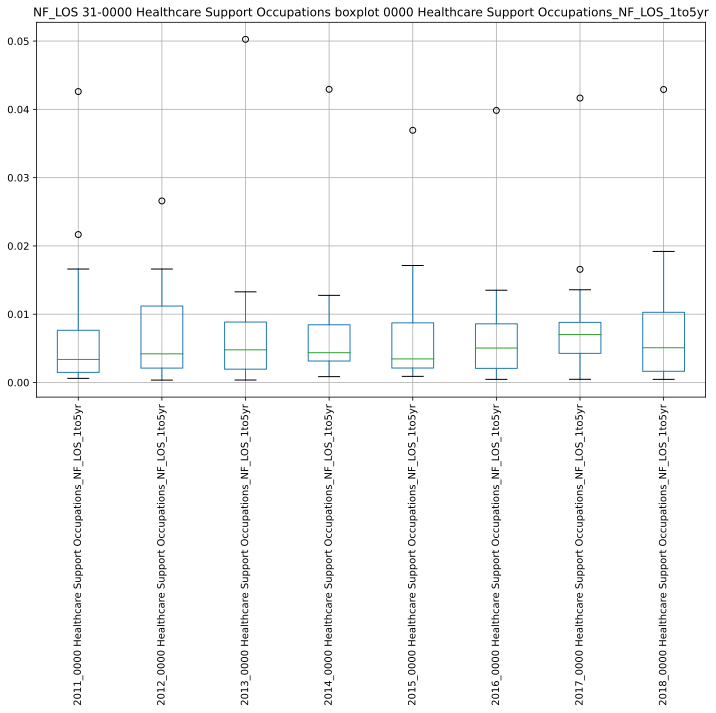

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233928.466753:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233928.505985:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233928.762934:INFO:headless_shell.cc(660)] Written to file /tmp/tmpldot1h1z/temp.png.
[1013/233928.979450:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233929.017545:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233929.340145:INFO:headless_shell.cc(660)] Written to file /tmp/tmpo61_gta6/temp.png.
[1013/233929.619679:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233929.660094:WARNI

,2011_0000 Healthcare Support Occupations_NF_LOS_1to5yr,2012_0000 Healthcare Support Occupations_NF_LOS_1to5yr,2013_0000 Healthcare Support Occupations_NF_LOS_1to5yr,2014_0000 Healthcare Support Occupations_NF_LOS_1to5yr,2015_0000 Healthcare Support Occupations_NF_LOS_1to5yr,2016_0000 Healthcare Support Occupations_NF_LOS_1to5yr,2017_0000 Healthcare Support Occupations_NF_LOS_1to5yr,2018_0000 Healthcare Support Occupations_NF_LOS_1to5yr
2011_0000 Healthcare Support Occupations_NF_LOS_1to5yr,1.000000,0.201829,0.283482,-0.017085,0.041436,0.257860,0.025768,-0.144987
2012_0000 Healthcare Support Occupations_NF_LOS_1to5yr,0.201829,1.000000,0.883820,0.853160,0.880759,0.907063,0.834275,0.813076
2013_0000 Healthcare Support Occupations_NF_LOS_1to5yr,0.283482,0.883820,1.000000,0.957131,0.941107,0.989096,0.936772,0.888162
2014_0000 Healthcare Support Occupations_NF_LOS_1to5yr,-0.017085,0.853160,0.957131,1.000000,0.979530,0.951178,0.990241,0.949340
2015_0000 Healthcare Support Occupations_NF_LOS_1to5yr,0.041436,0.880759,0.941107,0.979530,1.000000,0.947494,0.979788,0.962926
2016_0000 Healthcare Support Occupations_NF_LOS_1to5yr,0.257860,0.907063,0.989096,0.951178,0.947494,1.000000,0.935825,0.871024
2017_0000 Healthcare Support Occupations_NF_LOS_1to5yr,0.025768,0.834275,0.936772,0.990241,0.979788,0.935825,1.000000,0.952447
2018_0000 Healthcare Support Occupations_NF_LOS_1to5yr,-0.144987,0.813076,0.888162,0.949340,0.962926,0.871024,0.952447,1.000000


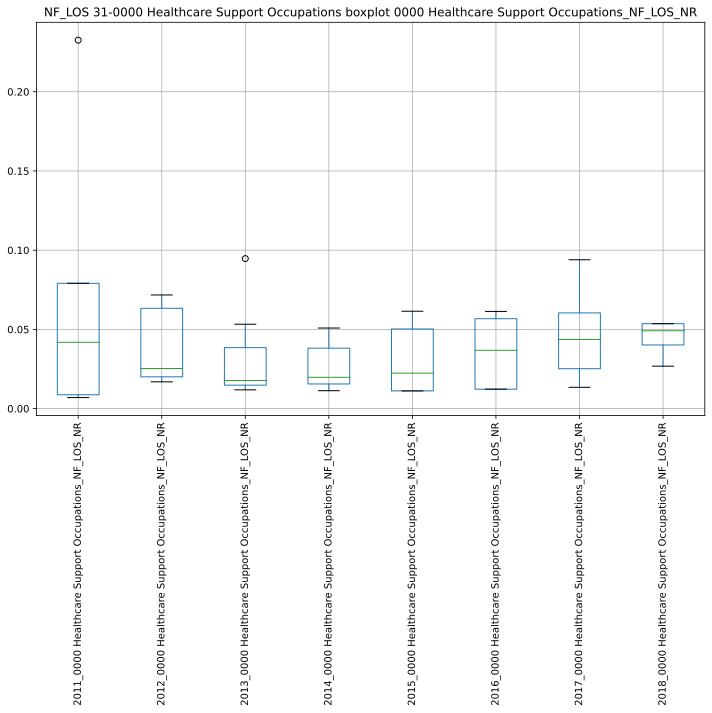

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233932.355842:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233932.383522:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233932.630252:INFO:headless_shell.cc(660)] Written to file /tmp/tmpnejkmxng/temp.png.
[1013/233932.861302:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233932.901648:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233933.217012:INFO:headless_shell.cc(660)] Written to file /tmp/tmp9ffqkevs/temp.png.
[1013/233933.481067:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233933.521553:WARNI

,2011_0000 Healthcare Support Occupations_NF_LOS_NR,2012_0000 Healthcare Support Occupations_NF_LOS_NR,2013_0000 Healthcare Support Occupations_NF_LOS_NR,2014_0000 Healthcare Support Occupations_NF_LOS_NR,2015_0000 Healthcare Support Occupations_NF_LOS_NR,2016_0000 Healthcare Support Occupations_NF_LOS_NR,2017_0000 Healthcare Support Occupations_NF_LOS_NR,2018_0000 Healthcare Support Occupations_NF_LOS_NR
2011_0000 Healthcare Support Occupations_NF_LOS_NR,1.000000,-0.196408,-0.123633,0.065245,0.392815,-0.470245,-0.359228,0.499108
2012_0000 Healthcare Support Occupations_NF_LOS_NR,-0.196408,1.000000,0.281884,0.169604,-0.008006,-0.344081,0.000000,-0.188982
2013_0000 Healthcare Support Occupations_NF_LOS_NR,-0.123633,0.281884,1.000000,0.342672,0.582544,0.492802,-0.082511,0.339422
2014_0000 Healthcare Support Occupations_NF_LOS_NR,0.065245,0.169604,0.342672,1.000000,-0.047754,0.143514,0.097215,1.000000
2015_0000 Healthcare Support Occupations_NF_LOS_NR,0.392815,-0.008006,0.582544,-0.047754,1.000000,0.291535,0.170552,-0.188982
2016_0000 Healthcare Support Occupations_NF_LOS_NR,-0.470245,-0.344081,0.492802,0.143514,0.291535,1.000000,0.583989,-0.755929
2017_0000 Healthcare Support Occupations_NF_LOS_NR,-0.359228,0.000000,-0.082511,0.097215,0.170552,0.583989,1.000000,-0.986912
2018_0000 Healthcare Support Occupations_NF_LOS_NR,0.499108,-0.188982,0.339422,1.000000,-0.188982,-0.755929,-0.986912,1.000000


########################################## CORRELATIONS ###############################################
['31-0000 Healthcare Support Occupations_NF_LOS_3to11mos', '31-0000 Healthcare Support Occupations_NF_LOS_5plus', '31-0000 Healthcare Support Occupations_NF_LOS_ltg3mos', '31-0000 Healthcare Support Occupations_NF_LOS_1to5yr', '31-0000 Healthcare Support Occupations_NF_LOS_NR']


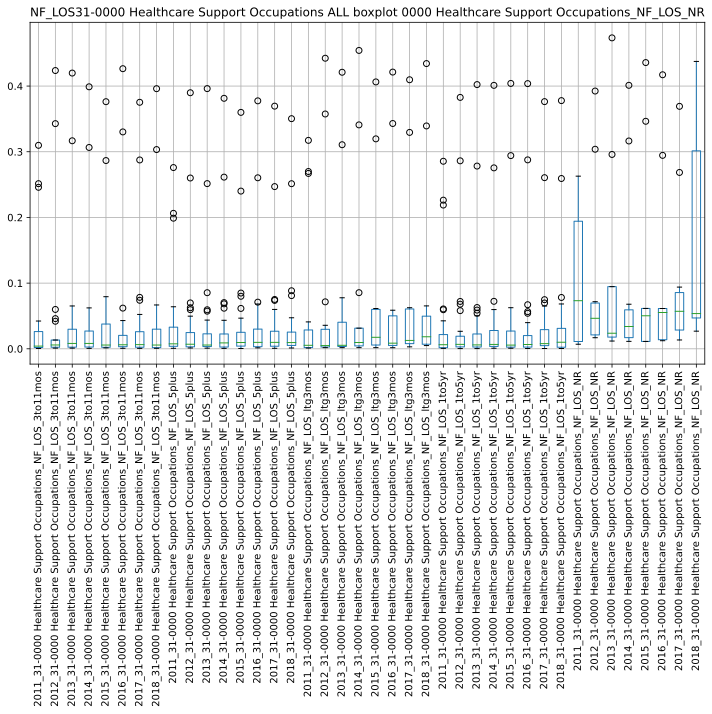

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/233938.107594:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233938.151099:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233938.485486:INFO:headless_shell.cc(660)] Written to file /tmp/tmpcj_qomk1/temp.png.
[1013/233938.718291:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233938.757608:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/233939.283638:INFO:headless_shell.cc(660)] Written to file /tmp/tmpsp0j4xp3/temp.png.
[1013/233939.604127:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/233939.642397:WARNI

,2011_31-0000 Healthcare Support Occupations_NF_LOS_3to11mos,2012_31-0000 Healthcare Support Occupations_NF_LOS_3to11mos,2013_31-0000 Healthcare Support Occupations_NF_LOS_3to11mos,2014_31-0000 Healthcare Support Occupations_NF_LOS_3to11mos,2015_31-0000 Healthcare Support Occupations_NF_LOS_3to11mos,2016_31-0000 Healthcare Support Occupations_NF_LOS_3to11mos,2017_31-0000 Healthcare Support Occupations_NF_LOS_3to11mos,2018_31-0000 Healthcare Support Occupations_NF_LOS_3to11mos,2011_31-0000 Healthcare Support Occupations_NF_LOS_5plus,2012_31-0000 Healthcare Support Occupations_NF_LOS_5plus,2013_31-0000 Healthcare Support Occupations_NF_LOS_5plus,2014_31-0000 Healthcare Support Occupations_NF_LOS_5plus,2015_31-0000 Healthcare Support Occupations_NF_LOS_5plus,2016_31-0000 Healthcare Support Occupations_NF_LOS_5plus,2017_31-0000 Healthcare Support Occupations_NF_LOS_5plus,2018_31-0000 Healthcare Support Occupations_NF_LOS_5plus,2011_31-0000 Healthcare Support Occupations_NF_LOS_ltg3mos,2012_31-0000 Healthcare Support Occupations_NF_LOS_ltg3mos,2013_31-0000 Healthcare Support Occupations_NF_LOS_ltg3mos,2014_31-0000 Healthcare Support Occupations_NF_LOS_ltg3mos,2015_31-0000 Healthcare Support Occupations_NF_LOS_ltg3mos,2016_31-0000 Healthcare Support Occupations_NF_LOS_ltg3mos,2017_31-0000 Healthcare Support Occupations_NF_LOS_ltg3mos,2018_31-0000 Healthcare Support Occupations_NF_LOS_ltg3mos,2011_31-0000 Healthcare Support Occupations_NF_LOS_1to5yr,2012_31-0000 Healthcare Support Occupations_NF_LOS_1to5yr,2013_31-0000 Healthcare Support Occupations_NF_LOS_1to5yr,2014_31-0000 Healthcare Support Occupations_NF_LOS_1to5yr,2015_31-0000 Healthcare Support Occupations_NF_LOS_1to5yr,2016_31-0000 Healthcare Support Occupations_NF_LOS_1to5yr,2017_31-0000 Healthcare Support Occupations_NF_LOS_1to5yr,2018_31-0000 Healthcare Support Occupations_NF_LOS_1to5yr,2011_31-0000 Healthcare Support Occupations_NF_LOS_NR,2012_31-0000 Healthcare Support Occupations_NF_LOS_NR,2013_31-0000 Healthcare Support Occupations_NF_LOS_NR,2014_31-0000 Healthcare Support Occupations_NF_LOS_NR,2015_31-0000 Healthcare Support Occupations_NF_LOS_NR,2016_31-0000 Healthcare Support Occupations_NF_LOS_NR,2017_31-0000 Healthcare Support Occupations_NF_LOS_NR,2018_31-0000 Healthcare Support Occupations_NF_LOS_NR
2011_31-0000 Healthcare Support Occupations_NF_LOS_3to11mos,1.000000,0.463628,0.493030,0.478523,0.471249,0.488526,0.476243,0.486616,0.989284,0.562097,0.595056,0.550056,0.543002,0.540588,0.559287,0.498977,0.989111,0.440139,0.473093,0.437515,0.421645,0.427254,0.389738,0.405671,0.995279,0.489476,0.537824,0.528159,0.510450,0.518364,0.514564,0.523019,0.943730,0.410664,0.503536,0.462608,0.427728,0.415926,0.376305,0.784942
2012_31-0000 Healthcare Support Occupations_NF_LOS_3to11mos,0.463628,1.000000,0.985851,0.976680,0.960546,0.999384,0.991945,0.974240,0.510855,0.984604,0.977164,0.985235,0.977087,0.986143,0.981088,0.982897,0.419102,0.988852,0.981614,0.992115,0.982180,0.985057,0.983743,0.995411,0.463580,0.994093,0.992110,0.992508,0.996002,0.994880,0.989199,0.988003,0.247754,0.975466,0.977110,0.990555,0.986917,0.986698,0.967653,0.388297
2013_31-0000 Healthcare Support Occupations_NF_LOS_3to11mos,0.493030,0.985851,1.000000,0.997090,0.989390,0.987424,0.966710,0.996342,0.540316,0.969702,0.964908,0.965558,0.952050,0.966081,0.958940,0.954760,0.452266,0.992804,0.991553,0.991873,0.974636,0.983757,0.980233,0.988608,0.494391,0.971995,0.978145,0.977593,0.979346,0.979917,0.967574,0.966910,0.282109,0.975955,0.985961,0.989303,0.986579,0.989709,0.967985,0.435976
2014_31-0000 Healthcare Support Occupations_NF_LOS_3to11mos,0.478523,0.976680,0.997090,1.000000,0.995669,0.977838,0.956238,0.998515,0.524481,0.957756,0.952974,0.953956,0.939411,0.954415,0.947018,0.942557,0.439253,0.986009,0.983480,0.987471,0.965152,0.976477,0.977149,0.984885,0.478810,0.960864,0.966666,0.965850,0.968424,0.968619,0.955192,0.954771,0.281329,0.978102,0.985217,0.990920,0.988905,0.989730,0.969855,0.429855
2015_31-0000 He

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
33-0000 Protective Service Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
33-0000 Protective Service Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
33-0000 Protective Service Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
33-

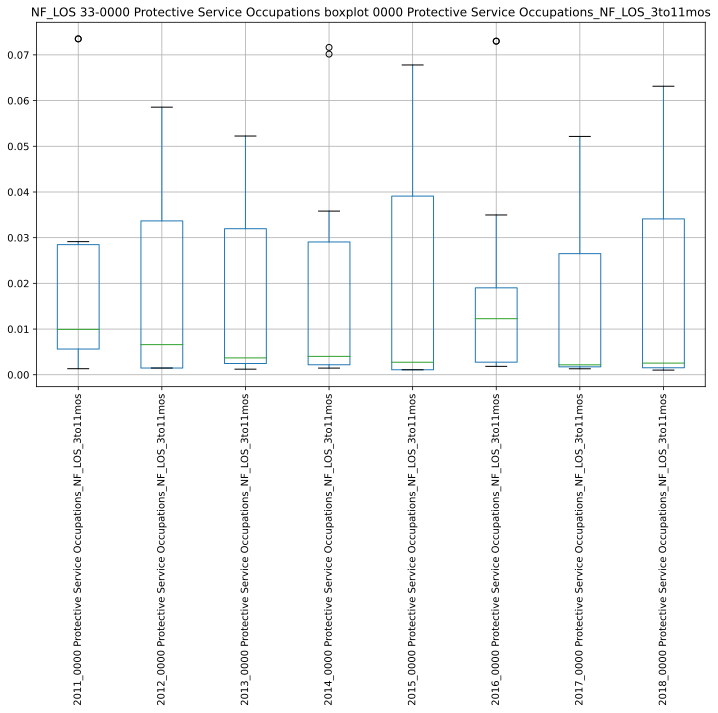

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234019.480302:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234019.517037:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234019.756774:INFO:headless_shell.cc(660)] Written to file /tmp/tmpu5waixi1/temp.png.
[1013/234019.965375:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234020.006255:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234020.284099:INFO:headless_shell.cc(660)] Written to file /tmp/tmp56o89757/temp.png.
[1013/234020.551308:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234020.589525:WARNI

,2011_0000 Protective Service Occupations_NF_LOS_3to11mos,2012_0000 Protective Service Occupations_NF_LOS_3to11mos,2013_0000 Protective Service Occupations_NF_LOS_3to11mos,2014_0000 Protective Service Occupations_NF_LOS_3to11mos,2015_0000 Protective Service Occupations_NF_LOS_3to11mos,2016_0000 Protective Service Occupations_NF_LOS_3to11mos,2017_0000 Protective Service Occupations_NF_LOS_3to11mos,2018_0000 Protective Service Occupations_NF_LOS_3to11mos
2011_0000 Protective Service Occupations_NF_LOS_3to11mos,1.000000,-0.305953,0.136570,0.604908,0.427777,0.941874,0.742817,0.308394
2012_0000 Protective Service Occupations_NF_LOS_3to11mos,-0.305953,1.000000,-0.156205,-0.324678,0.028774,-0.238994,0.554457,-0.454987
2013_0000 Protective Service Occupations_NF_LOS_3to11mos,0.136570,-0.156205,1.000000,0.503791,0.141851,-0.136309,0.347899,0.723876
2014_0000 Protective Service Occupations_NF_LOS_3to11mos,0.604908,-0.324678,0.503791,1.000000,-0.111771,-0.366262,0.312226,0.626705
2015_0000 Protective Service Occupations_NF_LOS_3to11mos,0.427777,0.028774,0.141851,-0.111771,1.000000,0.002035,-0.195489,-0.147371
2016_0000 Protective Service Occupations_NF_LOS_3to11mos,0.941874,-0.238994,-0.136309,-0.366262,0.002035,1.000000,0.312590,0.211523
2017_0000 Protective Service Occupations_NF_LOS_3to11mos,0.742817,0.554457,0.347899,0.312226,-0.195489,0.312590,1.000000,0.847745
2018_0000 Protective Service Occupations_NF_LOS_3to11mos,0.308394,-0.454987,0.723876,0.626705,-0.147371,0.211523,0.847745,1.000000


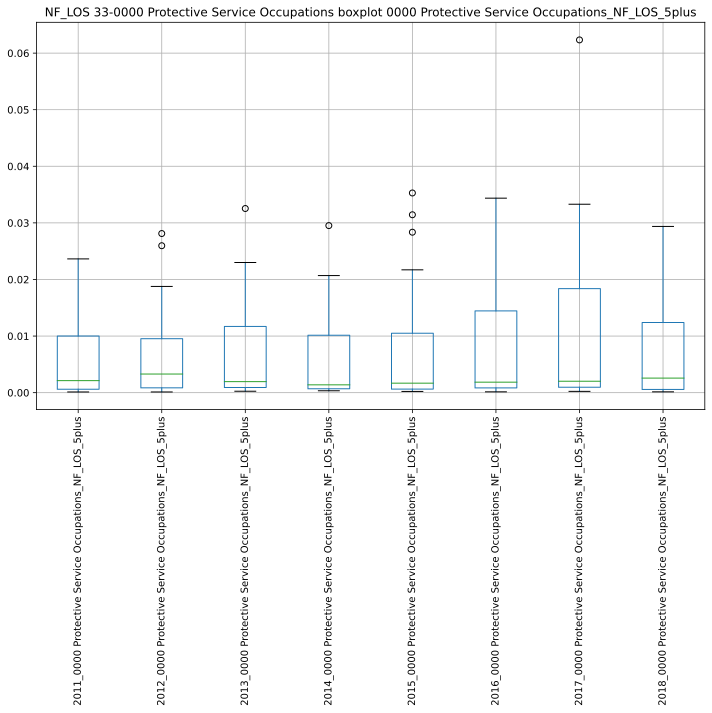

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234023.298154:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234023.340493:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234023.561961:INFO:headless_shell.cc(660)] Written to file /tmp/tmps2_hzzq3/temp.png.
[1013/234023.782977:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234023.819864:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234024.135312:INFO:headless_shell.cc(660)] Written to file /tmp/tmp1ovvatss/temp.png.
[1013/234024.407942:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234024.445908:WARNI

,2011_0000 Protective Service Occupations_NF_LOS_5plus,2012_0000 Protective Service Occupations_NF_LOS_5plus,2013_0000 Protective Service Occupations_NF_LOS_5plus,2014_0000 Protective Service Occupations_NF_LOS_5plus,2015_0000 Protective Service Occupations_NF_LOS_5plus,2016_0000 Protective Service Occupations_NF_LOS_5plus,2017_0000 Protective Service Occupations_NF_LOS_5plus,2018_0000 Protective Service Occupations_NF_LOS_5plus
2011_0000 Protective Service Occupations_NF_LOS_5plus,1.000000,0.709530,0.365049,0.442702,0.478918,0.550193,0.585425,0.572191
2012_0000 Protective Service Occupations_NF_LOS_5plus,0.709530,1.000000,0.392000,0.448213,0.417163,0.542244,0.574570,0.529004
2013_0000 Protective Service Occupations_NF_LOS_5plus,0.365049,0.392000,1.000000,0.969871,0.795909,0.939684,0.313583,0.887308
2014_0000 Protective Service Occupations_NF_LOS_5plus,0.442702,0.448213,0.969871,1.000000,0.813724,0.959262,0.278876,0.960964
2015_0000 Protective Service Occupations_NF_LOS_5plus,0.478918,0.417163,0.795909,0.813724,1.000000,0.876228,0.341348,0.838778
2016_0000 Protective Service Occupations_NF_LOS_5plus,0.550193,0.542244,0.939684,0.959262,0.876228,1.000000,0.405563,0.960279
2017_0000 Protective Service Occupations_NF_LOS_5plus,0.585425,0.574570,0.313583,0.278876,0.341348,0.405563,1.000000,0.339331
2018_0000 Protective Service Occupations_NF_LOS_5plus,0.572191,0.529004,0.887308,0.960964,0.838778,0.960279,0.339331,1.000000


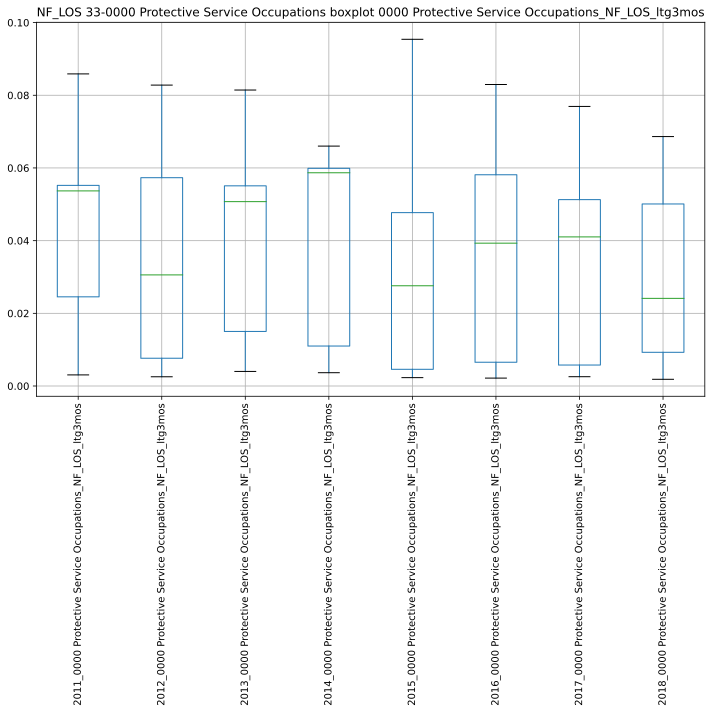

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234027.173095:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234027.211641:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234027.438994:INFO:headless_shell.cc(660)] Written to file /tmp/tmpvtwmh8vn/temp.png.
[1013/234027.658829:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234027.696492:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234027.996429:INFO:headless_shell.cc(660)] Written to file /tmp/tmpd8swdpuj/temp.png.
[1013/234028.277430:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234028.315379:WARNI

,2011_0000 Protective Service Occupations_NF_LOS_ltg3mos,2012_0000 Protective Service Occupations_NF_LOS_ltg3mos,2013_0000 Protective Service Occupations_NF_LOS_ltg3mos,2014_0000 Protective Service Occupations_NF_LOS_ltg3mos,2015_0000 Protective Service Occupations_NF_LOS_ltg3mos,2016_0000 Protective Service Occupations_NF_LOS_ltg3mos,2017_0000 Protective Service Occupations_NF_LOS_ltg3mos,2018_0000 Protective Service Occupations_NF_LOS_ltg3mos
2011_0000 Protective Service Occupations_NF_LOS_ltg3mos,1.000000,-0.195435,0.529088,-0.040883,0.166705,0.535313,0.137227,-0.382372
2012_0000 Protective Service Occupations_NF_LOS_ltg3mos,-0.195435,1.000000,-0.762365,0.785658,0.080697,-0.252446,0.072130,0.772896
2013_0000 Protective Service Occupations_NF_LOS_ltg3mos,0.529088,-0.762365,1.000000,-0.500825,-0.196102,0.744166,0.255445,-0.839245
2014_0000 Protective Service Occupations_NF_LOS_ltg3mos,-0.040883,0.785658,-0.500825,1.000000,-0.100149,-0.100021,0.610221,0.814478
2015_0000 Protective Service Occupations_NF_LOS_ltg3mos,0.166705,0.080697,-0.196102,-0.100149,1.000000,-0.087731,0.333445,0.109339
2016_0000 Protective Service Occupations_NF_LOS_ltg3mos,0.535313,-0.252446,0.744166,-0.100021,-0.087731,1.000000,-0.130122,-0.582346
2017_0000 Protective Service Occupations_NF_LOS_ltg3mos,0.137227,0.072130,0.255445,0.610221,0.333445,-0.130122,1.000000,0.543365
2018_0000 Protective Service Occupations_NF_LOS_ltg3mos,-0.382372,0.772896,-0.839245,0.814478,0.109339,-0.582346,0.543365,1.000000


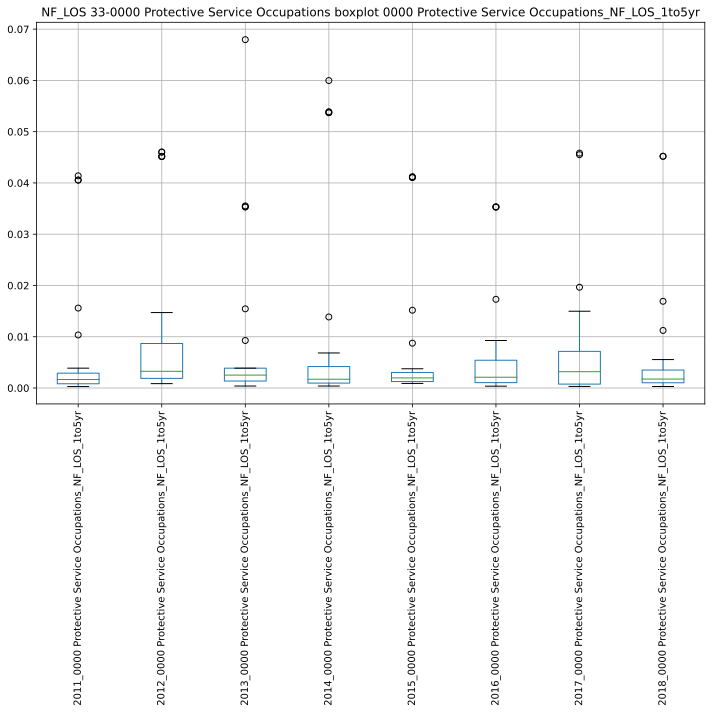

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234031.153669:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234031.191527:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234031.399848:INFO:headless_shell.cc(660)] Written to file /tmp/tmpiodp2bm9/temp.png.
[1013/234031.627400:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234031.666185:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234031.962349:INFO:headless_shell.cc(660)] Written to file /tmp/tmp8xxva3ls/temp.png.
[1013/234032.233700:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234032.273302:WARNI

,2011_0000 Protective Service Occupations_NF_LOS_1to5yr,2012_0000 Protective Service Occupations_NF_LOS_1to5yr,2013_0000 Protective Service Occupations_NF_LOS_1to5yr,2014_0000 Protective Service Occupations_NF_LOS_1to5yr,2015_0000 Protective Service Occupations_NF_LOS_1to5yr,2016_0000 Protective Service Occupations_NF_LOS_1to5yr,2017_0000 Protective Service Occupations_NF_LOS_1to5yr,2018_0000 Protective Service Occupations_NF_LOS_1to5yr
2011_0000 Protective Service Occupations_NF_LOS_1to5yr,1.000000,0.809359,0.586800,0.790881,0.973142,0.957255,0.167695,0.098905
2012_0000 Protective Service Occupations_NF_LOS_1to5yr,0.809359,1.000000,0.385474,0.520508,0.697728,0.775186,-0.013621,-0.061766
2013_0000 Protective Service Occupations_NF_LOS_1to5yr,0.586800,0.385474,1.000000,0.691979,0.730889,0.573382,0.299483,0.980129
2014_0000 Protective Service Occupations_NF_LOS_1to5yr,0.790881,0.520508,0.691979,1.000000,0.990477,0.806919,0.662258,0.792701
2015_0000 Protective Service Occupations_NF_LOS_1to5yr,0.973142,0.697728,0.730889,0.990477,1.000000,0.970013,0.321873,0.845748
2016_0000 Protective Service Occupations_NF_LOS_1to5yr,0.957255,0.775186,0.573382,0.806919,0.970013,1.000000,0.089902,0.121833
2017_0000 Protective Service Occupations_NF_LOS_1to5yr,0.167695,-0.013621,0.299483,0.662258,0.321873,0.089902,1.000000,0.575828
2018_0000 Protective Service Occupations_NF_LOS_1to5yr,0.098905,-0.061766,0.980129,0.792701,0.845748,0.121833,0.575828,1.000000


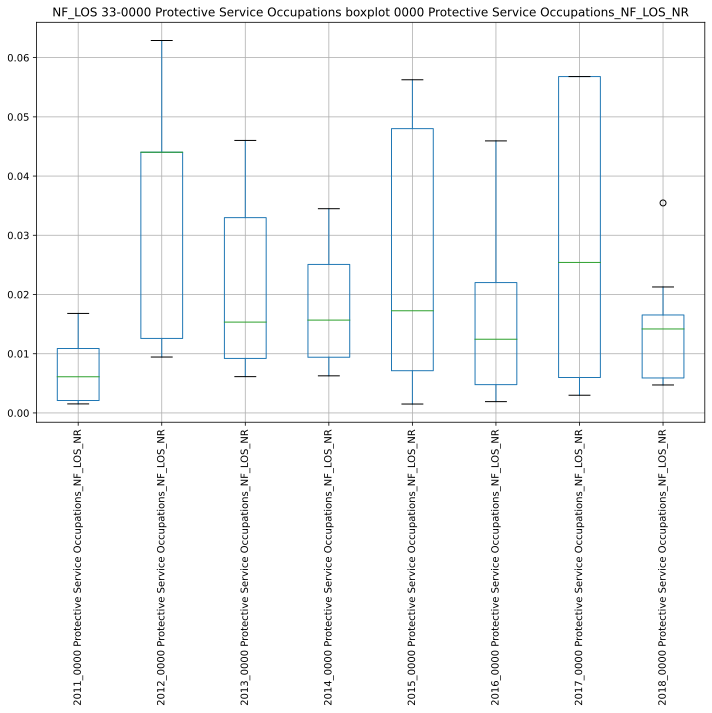

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234034.983100:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234035.022711:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234035.276036:INFO:headless_shell.cc(660)] Written to file /tmp/tmppvnrdlku/temp.png.
[1013/234035.502007:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234035.539702:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234035.817094:INFO:headless_shell.cc(660)] Written to file /tmp/tmp98zsee5p/temp.png.
[1013/234036.083333:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234036.118087:WARNI

,2011_0000 Protective Service Occupations_NF_LOS_NR,2012_0000 Protective Service Occupations_NF_LOS_NR,2013_0000 Protective Service Occupations_NF_LOS_NR,2014_0000 Protective Service Occupations_NF_LOS_NR,2015_0000 Protective Service Occupations_NF_LOS_NR,2016_0000 Protective Service Occupations_NF_LOS_NR,2017_0000 Protective Service Occupations_NF_LOS_NR,2018_0000 Protective Service Occupations_NF_LOS_NR
2011_0000 Protective Service Occupations_NF_LOS_NR,1.000000,0.143582,0.091657,0.339668,0.530205,0.094628,0.340210,0.038370
2012_0000 Protective Service Occupations_NF_LOS_NR,0.143582,1.000000,0.753403,-0.035675,0.261819,0.482069,-0.238462,0.573145
2013_0000 Protective Service Occupations_NF_LOS_NR,0.091657,0.753403,1.000000,-0.004800,0.311732,0.053258,-0.570488,0.493988
2014_0000 Protective Service Occupations_NF_LOS_NR,0.339668,-0.035675,-0.004800,1.000000,0.300399,0.411236,0.262419,0.532681
2015_0000 Protective Service Occupations_NF_LOS_NR,0.530205,0.261819,0.311732,0.300399,1.000000,0.076048,-0.216835,0.422630
2016_0000 Protective Service Occupations_NF_LOS_NR,0.094628,0.482069,0.053258,0.411236,0.076048,1.000000,-0.186351,0.563252
2017_0000 Protective Service Occupations_NF_LOS_NR,0.340210,-0.238462,-0.570488,0.262419,-0.216835,-0.186351,1.000000,0.069457
2018_0000 Protective Service Occupations_NF_LOS_NR,0.038370,0.573145,0.493988,0.532681,0.422630,0.563252,0.069457,1.000000


########################################## CORRELATIONS ###############################################
['33-0000 Protective Service Occupations_NF_LOS_3to11mos', '33-0000 Protective Service Occupations_NF_LOS_5plus', '33-0000 Protective Service Occupations_NF_LOS_ltg3mos', '33-0000 Protective Service Occupations_NF_LOS_1to5yr', '33-0000 Protective Service Occupations_NF_LOS_NR']


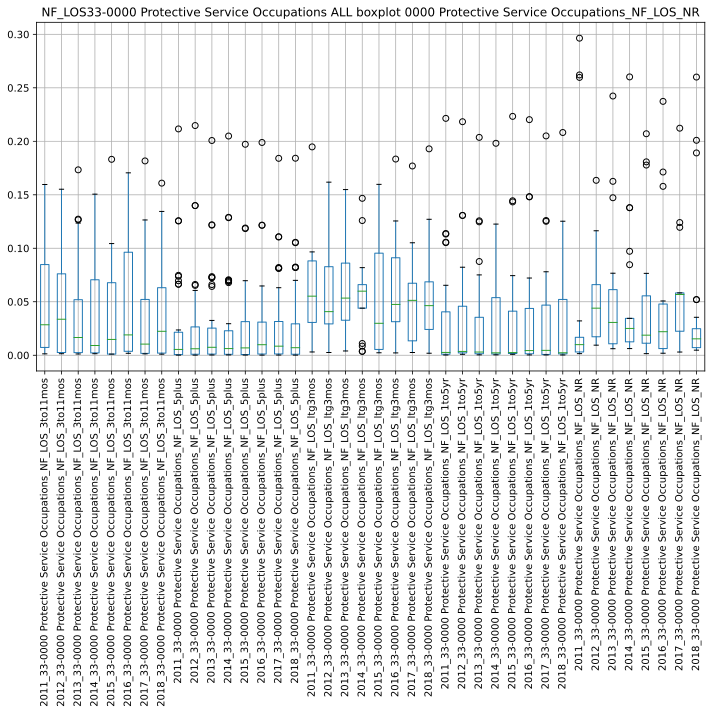

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234040.637820:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234040.677740:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234041.014944:INFO:headless_shell.cc(660)] Written to file /tmp/tmps0n0o1u9/temp.png.
[1013/234041.237474:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234041.276287:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234041.796097:INFO:headless_shell.cc(660)] Written to file /tmp/tmp96pfni35/temp.png.
[1013/234042.125848:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234042.155480:WARNI

,2011_33-0000 Protective Service Occupations_NF_LOS_3to11mos,2012_33-0000 Protective Service Occupations_NF_LOS_3to11mos,2013_33-0000 Protective Service Occupations_NF_LOS_3to11mos,2014_33-0000 Protective Service Occupations_NF_LOS_3to11mos,2015_33-0000 Protective Service Occupations_NF_LOS_3to11mos,2016_33-0000 Protective Service Occupations_NF_LOS_3to11mos,2017_33-0000 Protective Service Occupations_NF_LOS_3to11mos,2018_33-0000 Protective Service Occupations_NF_LOS_3to11mos,2011_33-0000 Protective Service Occupations_NF_LOS_5plus,2012_33-0000 Protective Service Occupations_NF_LOS_5plus,2013_33-0000 Protective Service Occupations_NF_LOS_5plus,2014_33-0000 Protective Service Occupations_NF_LOS_5plus,2015_33-0000 Protective Service Occupations_NF_LOS_5plus,2016_33-0000 Protective Service Occupations_NF_LOS_5plus,2017_33-0000 Protective Service Occupations_NF_LOS_5plus,2018_33-0000 Protective Service Occupations_NF_LOS_5plus,2011_33-0000 Protective Service Occupations_NF_LOS_ltg3mos,2012_33-0000 Protective Service Occupations_NF_LOS_ltg3mos,2013_33-0000 Protective Service Occupations_NF_LOS_ltg3mos,2014_33-0000 Protective Service Occupations_NF_LOS_ltg3mos,2015_33-0000 Protective Service Occupations_NF_LOS_ltg3mos,2016_33-0000 Protective Service Occupations_NF_LOS_ltg3mos,2017_33-0000 Protective Service Occupations_NF_LOS_ltg3mos,2018_33-0000 Protective Service Occupations_NF_LOS_ltg3mos,2011_33-0000 Protective Service Occupations_NF_LOS_1to5yr,2012_33-0000 Protective Service Occupations_NF_LOS_1to5yr,2013_33-0000 Protective Service Occupations_NF_LOS_1to5yr,2014_33-0000 Protective Service Occupations_NF_LOS_1to5yr,2015_33-0000 Protective Service Occupations_NF_LOS_1to5yr,2016_33-0000 Protective Service Occupations_NF_LOS_1to5yr,2017_33-0000 Protective Service Occupations_NF_LOS_1to5yr,2018_33-0000 Protective Service Occupations_NF_LOS_1to5yr,2011_33-0000 Protective Service Occupations_NF_LOS_NR,2012_33-0000 Protective Service Occupations_NF_LOS_NR,2013_33-0000 Protective Service Occupations_NF_LOS_NR,2014_33-0000 Protective Service Occupations_NF_LOS_NR,2015_33-0000 Protective Service Occupations_NF_LOS_NR,2016_33-0000 Protective Service Occupations_NF_LOS_NR,2017_33-0000 Protective Service Occupations_NF_LOS_NR,2018_33-0000 Protective Service Occupations_NF_LOS_NR
2011_33-0000 Protective Service Occupations_NF_LOS_3to11mos,1.000000,0.243774,0.385305,0.269019,0.347784,0.441768,0.395394,0.494681,-0.002783,0.568010,0.612680,0.596010,0.585955,0.569323,0.041938,0.598004,0.160697,0.399613,0.114837,0.249412,0.373691,0.087592,0.198584,0.442770,0.515974,0.256300,0.149766,0.455888,0.218493,-0.021047,0.061858,0.206921,0.492624,0.525859,0.475118,0.062920,0.472925,0.413940,-0.056811,-0.082994
2012_33-0000 Protective Service Occupations_NF_LOS_3to11mos,0.243774,1.000000,-0.294124,-0.023439,0.140857,0.297145,-0.410902,-0.359543,-0.336375,0.145687,0.138482,0.130262,0.131817,0.125231,-0.438259,0.096626,0.097119,0.659302,0.580330,0.659704,-0.007073,-0.176964,0.522801,0.645397,0.139922,0.421445,-0.124842,0.048158,0.038651,0.082168,0.066128,-0.140822,0.285312,0.125624,0.029401,0.082130,0.209706,-0.249023,0.522769,-0.379444
2013_33-0000 Protective Service Occupations_NF_LOS_3to11mos,0.385305,-0.294124,1.000000,0.266995,-0.194980,0.429185,0.795127,0.937169,-0.023679,0.038650,0.045542,0.041688,0.023347,0.027349,0.336164,0.013890,0.744426,0.054620,-0.248028,-0.057255,0.308601,0.560666,-0.261297,0.030976,-0.013074,-0.090768,0.207442,0.094452,0.042851,-0.103623,0.037898,0.210253,-0.250449,0.096872,0.079689,-0.121333,0.173546,0.187648,-0.296339,-0.087298
2014_33-0000 Protective Service Occupations_NF_LOS_3to11mos,0.269019,-0.023439,0.266995,1.000000,-0.074334,0.435353,0.299391,0.377980,0.142107,0.058728,0.081601,0.071674,0.051293,0.043292,0.121527,0.090382,0.047253,0.275924,-0.329021,0.165885,0.279803,0.015746,-0.396092,0.143786,0.004304,0.236339,0.289329,0.041618,-0.036973,0.222031,0.350938,0.302245,-0.137111,0.280797,0.366238,0.149461,0.071255,0.58519

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
35-0000 Food Preparation and Serving Related Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
35-0000 Food Preparation and Serving Related Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
35-0000 Food Preparation and Serving Related Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL #####

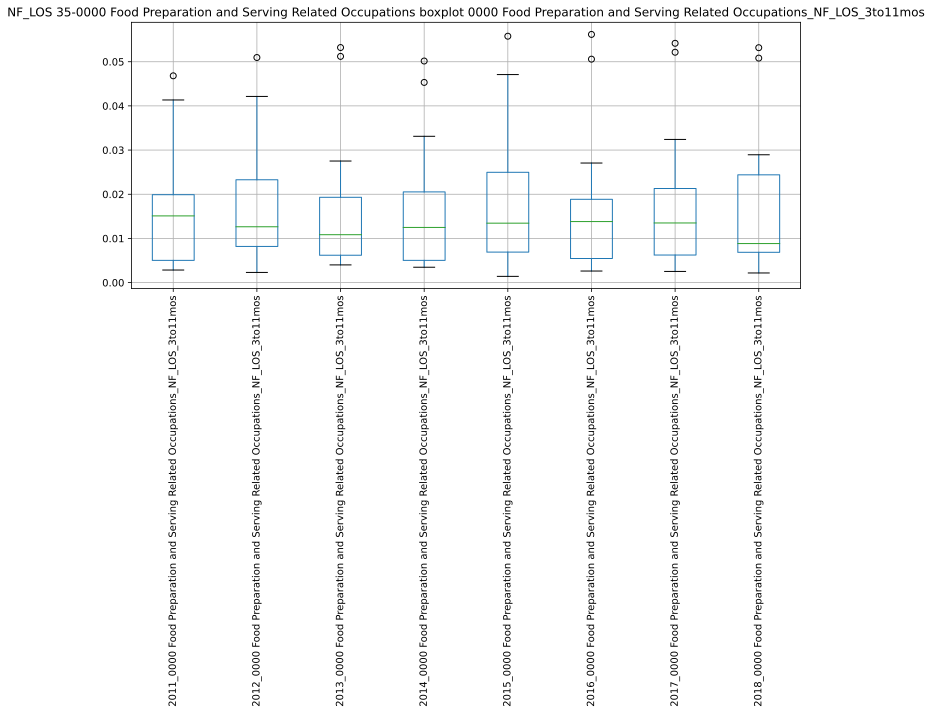

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234111.334201:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234111.370652:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234111.613577:INFO:headless_shell.cc(660)] Written to file /tmp/tmppzsjt2gv/temp.png.
[1013/234111.850758:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234111.879358:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234112.188120:INFO:headless_shell.cc(660)] Written to file /tmp/tmpewfo6en9/temp.png.
[1013/234112.456574:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234112.495545:WARNI

,2011_0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,2012_0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,2013_0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,2014_0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,2015_0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,2016_0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,2017_0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,2018_0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos
2011_0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,1.000000,0.969614,0.912449,0.935164,0.965914,0.938264,0.974906,0.899991
2012_0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,0.969614,1.000000,0.855550,0.884503,0.965305,0.877737,0.972322,0.887800
2013_0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,0.912449,0.855550,1.000000,0.923580,0.919164,0.979924,0.962034,0.969120
2014_0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,0.935164,0.884503,0.923580,1.000000,0.957414,0.959785,0.940587,0.947446
2015_0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,0.965914,0.965305,0.919164,0.957414,1.000000,0.941892,0.989582,0.951437
2016_0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,0.938264,0.877737,0.979924,0.959785,0.941892,1.000000,0.979314,0.972103
2017_0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,0.974906,0.972322,0.962034,0.940587,0.989582,0.979314,1.000000,0.952182
2018_0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,0.899991,0.887800,0.969120,0.947446,0.951437,0.972103,0.952182,1.000000


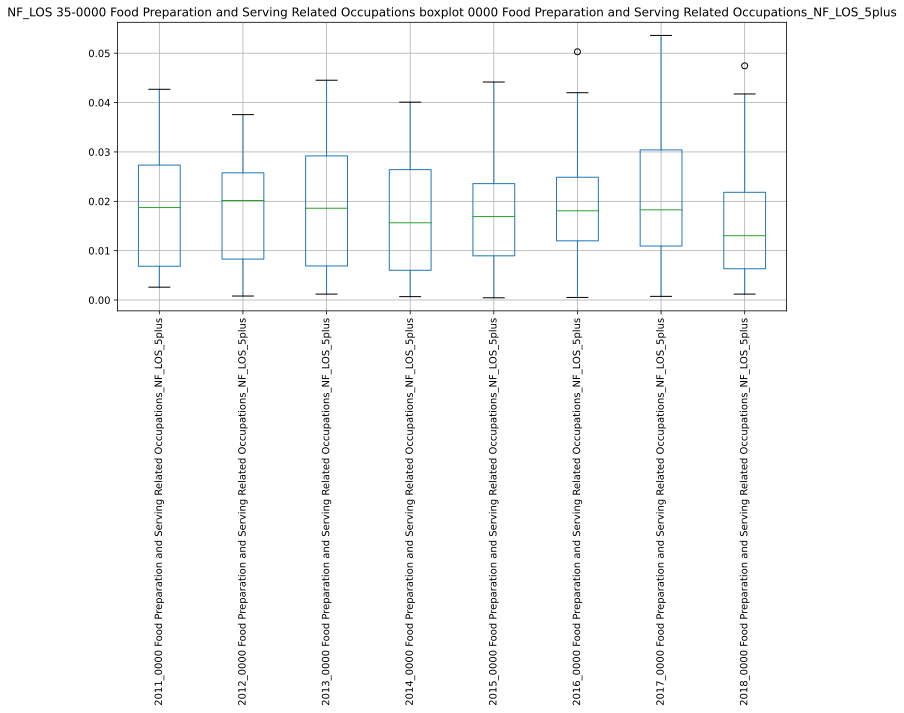

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234116.621530:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234116.662179:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234116.891749:INFO:headless_shell.cc(660)] Written to file /tmp/tmp_lpips14/temp.png.
[1013/234117.118971:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234117.156497:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234117.474944:INFO:headless_shell.cc(660)] Written to file /tmp/tmpx9rr7pqs/temp.png.
[1013/234117.745441:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234117.785546:WARNI

,2011_0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,2012_0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,2013_0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,2014_0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,2015_0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,2016_0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,2017_0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,2018_0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus
2011_0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,1.000000,0.964420,0.899212,0.904199,0.889172,0.273349,0.393428,0.716373
2012_0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,0.964420,1.000000,0.901953,0.907676,0.920063,0.182425,0.298143,0.791547
2013_0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,0.899212,0.901953,1.000000,0.946512,0.895110,0.292072,0.398819,0.806155
2014_0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,0.904199,0.907676,0.946512,1.000000,0.879907,0.233870,0.360900,0.859087
2015_0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,0.889172,0.920063,0.895110,0.879907,1.000000,0.261273,0.358282,0.825951
2016_0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,0.273349,0.182425,0.292072,0.233870,0.261273,1.000000,0.965283,-0.047246
2017_0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,0.393428,0.298143,0.398819,0.360900,0.358282,0.965283,1.000000,0.057578
2018_0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,0.716373,0.791547,0.806155,0.859087,0.825951,-0.047246,0.057578,1.000000


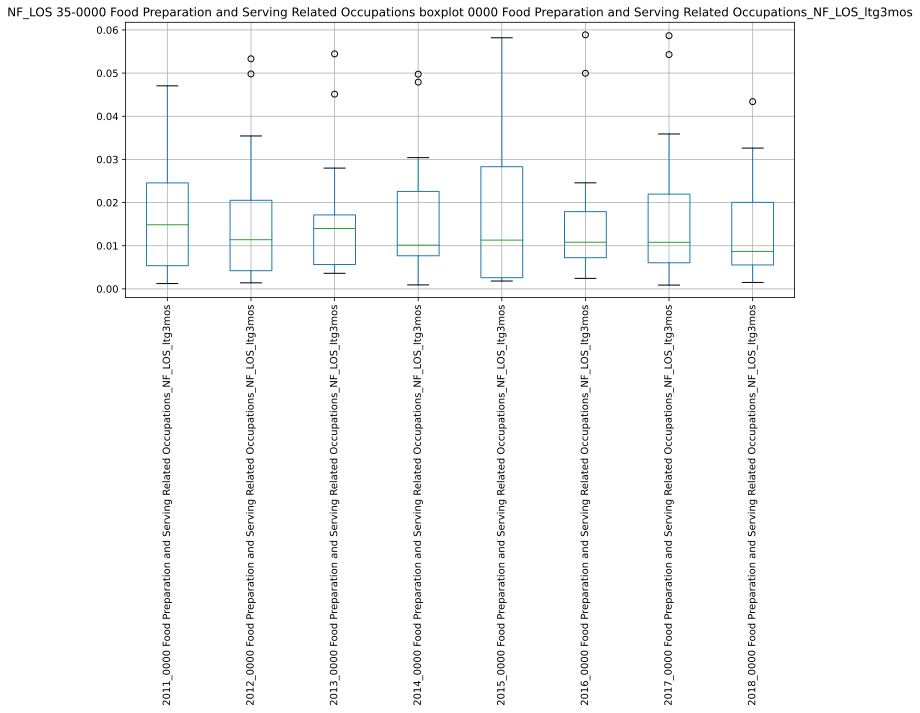

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234121.868441:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234121.907484:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234122.136048:INFO:headless_shell.cc(660)] Written to file /tmp/tmpjouqhkg4/temp.png.
[1013/234122.379559:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234122.407832:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234122.711827:INFO:headless_shell.cc(660)] Written to file /tmp/tmp2960chgz/temp.png.
[1013/234122.996079:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234123.045448:WARNI

,2011_0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,2012_0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,2013_0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,2014_0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,2015_0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,2016_0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,2017_0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,2018_0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos
2011_0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,1.000000,0.900036,0.894753,0.902715,0.151721,0.789159,0.894986,0.888825
2012_0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,0.900036,1.000000,0.845548,0.939125,0.073012,0.877657,0.953717,0.936822
2013_0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,0.894753,0.845548,1.000000,0.843412,0.023749,0.870649,0.861280,0.847461
2014_0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,0.902715,0.939125,0.843412,1.000000,0.097145,0.919075,0.968142,0.884701
2015_0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,0.151721,0.073012,0.023749,0.097145,1.000000,0.082511,0.082817,0.004972
2016_0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,0.789159,0.877657,0.870649,0.919075,0.082511,1.000000,0.936378,0.816968
2017_0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,0.894986,0.953717,0.861280,0.968142,0.082817,0.936378,1.000000,0.951713
2018_0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,0.888825,0.936822,0.847461,0.884701,0.004972,0.816968,0.951713,1.000000


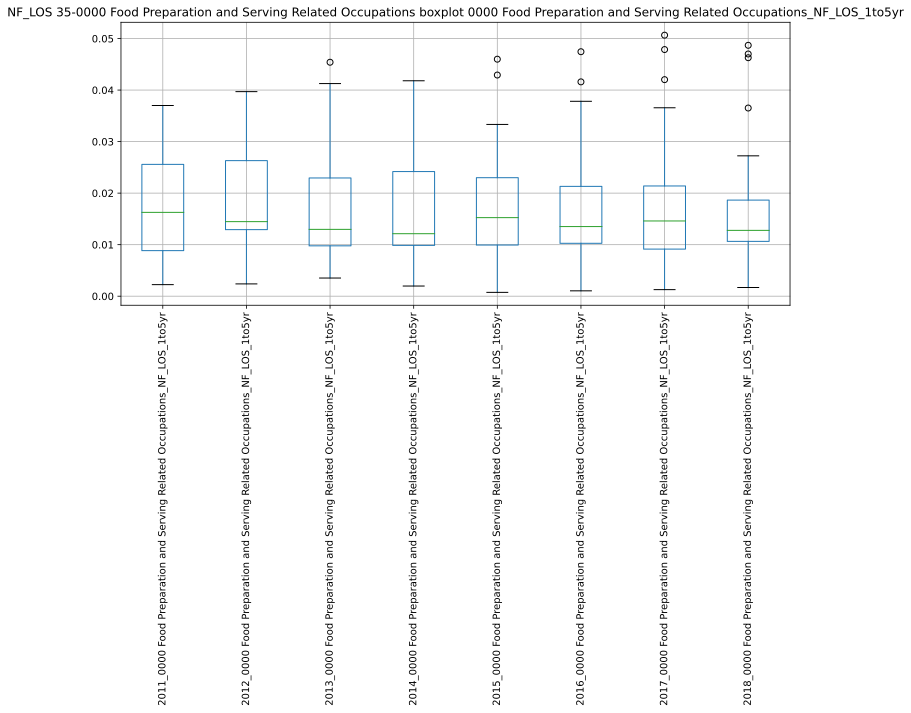

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234127.309092:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234127.346498:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234127.587163:INFO:headless_shell.cc(660)] Written to file /tmp/tmpulimzgcg/temp.png.
[1013/234127.812068:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234127.850037:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234128.147677:INFO:headless_shell.cc(660)] Written to file /tmp/tmp5ojvlyp3/temp.png.
[1013/234128.424441:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234128.467628:WARNI

,2011_0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,2012_0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,2013_0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,2014_0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,2015_0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,2016_0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,2017_0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,2018_0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr
2011_0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,1.000000,0.882235,0.784520,0.691399,0.840842,0.638440,0.716180,0.634646
2012_0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,0.882235,1.000000,0.939448,0.870094,0.949810,0.849523,0.924748,0.880042
2013_0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,0.784520,0.939448,1.000000,0.926068,0.959957,0.878069,0.947780,0.932409
2014_0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,0.691399,0.870094,0.926068,1.000000,0.934053,0.947157,0.931621,0.889180
2015_0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,0.840842,0.949810,0.959957,0.934053,1.000000,0.892561,0.925170,0.884179
2016_0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,0.638440,0.849523,0.878069,0.947157,0.892561,1.000000,0.971393,0.945524
2017_0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,0.716180,0.924748,0.947780,0.931621,0.925170,0.971393,1.000000,0.980275
2018_0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,0.634646,0.880042,0.932409,0.889180,0.884179,0.945524,0.980275,1.000000


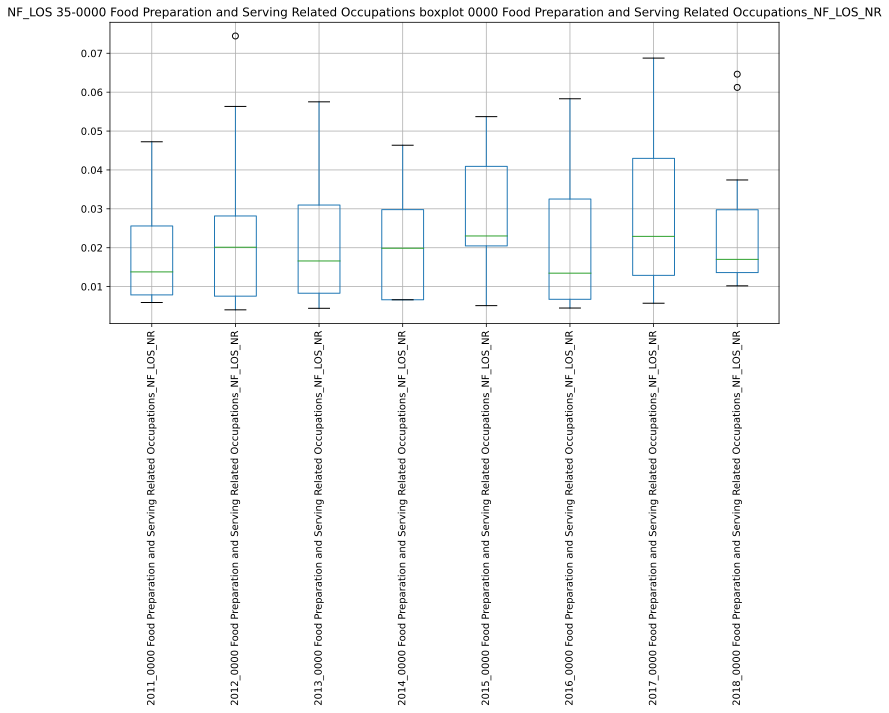

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234132.559920:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234132.598246:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234132.841336:INFO:headless_shell.cc(660)] Written to file /tmp/tmpmont54e4/temp.png.
[1013/234133.058331:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234133.098365:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234133.402822:INFO:headless_shell.cc(660)] Written to file /tmp/tmpobxgwrm8/temp.png.
[1013/234133.675355:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234133.721728:WARNI

,2011_0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,2012_0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,2013_0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,2014_0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,2015_0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,2016_0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,2017_0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,2018_0000 Food Preparation and Serving Related Occupations_NF_LOS_NR
2011_0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,1.000000,-0.366407,0.670114,-0.188244,-0.059473,0.426083,0.190681,0.294672
2012_0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,-0.366407,1.000000,-0.312688,0.061492,-0.039718,0.148321,0.083516,0.061032
2013_0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,0.670114,-0.312688,1.000000,-0.089253,-0.106236,0.329852,0.631346,0.174632
2014_0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,-0.188244,0.061492,-0.089253,1.000000,0.044408,0.363637,0.515567,0.045625
2015_0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,-0.059473,-0.039718,-0.106236,0.044408,1.000000,-0.263512,0.469830,0.023297
2016_0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,0.426083,0.148321,0.329852,0.363637,-0.263512,1.000000,0.442535,0.355583
2017_0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,0.190681,0.083516,0.631346,0.515567,0.469830,0.442535,1.000000,0.331900
2018_0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,0.294672,0.061032,0.174632,0.045625,0.023297,0.355583,0.331900,1.000000


########################################## CORRELATIONS ###############################################
['35-0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos', '35-0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus', '35-0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos', '35-0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr', '35-0000 Food Preparation and Serving Related Occupations_NF_LOS_NR']


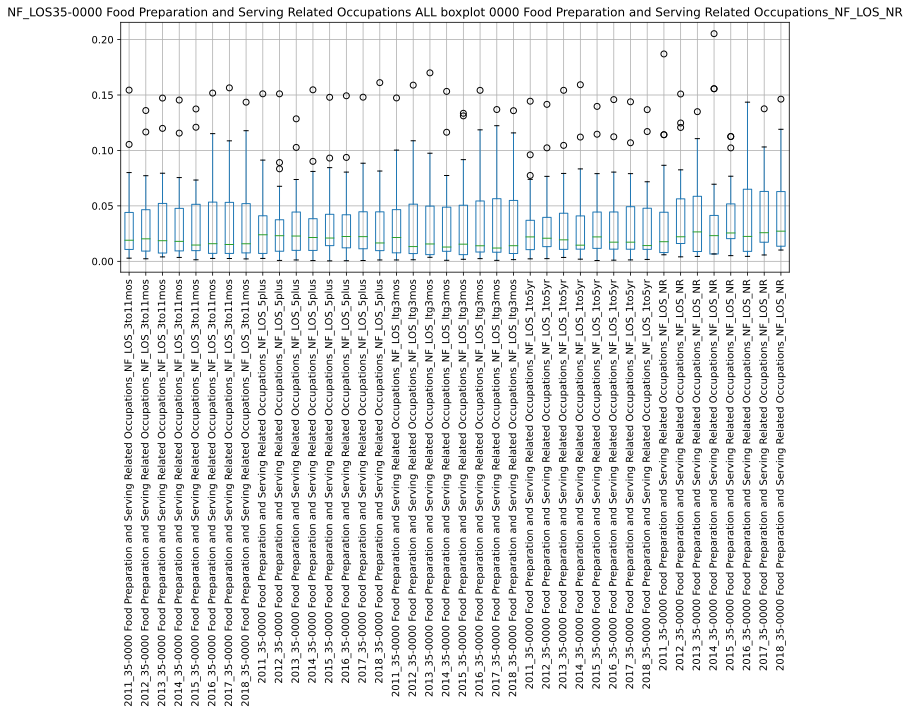

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234139.843606:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234139.881187:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234140.219651:INFO:headless_shell.cc(660)] Written to file /tmp/tmpyrma7zkx/temp.png.
[1013/234140.448795:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234140.487897:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234141.008755:INFO:headless_shell.cc(660)] Written to file /tmp/tmpa7_hyvd0/temp.png.
[1013/234141.332376:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234141.371412:WARNI

,2011_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,2012_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,2013_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,2014_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,2015_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,2016_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,2017_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,2018_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,2011_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,2012_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,2013_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,2014_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,2015_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,2016_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,2017_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,2018_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_5plus,2011_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,2012_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,2013_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,2014_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,2015_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,2016_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,2017_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,2018_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_ltg3mos,2011_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,2012_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,2013_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,2014_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,2015_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,2016_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,2017_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,2018_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_1to5yr,2011_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,2012_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,2013_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,2014_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,2015_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,2016_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,2017_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_NR,2018_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_NR
2011_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,1.000000,0.977081,0.977274,0.986372,0.979982,0.983163,0.990018,0.978548,0.913025,0.945114,0.913407,0.940832,0.925303,0.614472,0.595259,0.906956,0.988250,0.988619,0.979469,0.985948,0.527646,0.974791,0.962776,0.960851,0.973299,0.980673,0.987252,0.983015,0.978826,0.971752,0.971860,0.963336,0.400281,-0.109870,0.234659,0.380525,0.270337,0.014628,0.322022,-0.154816
2012_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,0.977081,1.000000,0.977115,0.980595,0.992195,0.977388,0.981447,0.979032,0.885992,0.911662,0.908101,0.893428,0.894719,0.502928,0.481231,0.852732,0.978039,0.983740,0.927674,0.979245,0.410312,0.972034,0.984805,0.975767,0.956041,0.969485,0.960912,0.959831,0.979067,0.966600,0.964272,0.959986,0.329872,-0.124690,0.204418,0.364219,0.189887,0.040932,0.303899,-0.176809
2013_35-0000 Food Preparation and Serving Related Occupations_NF_LOS_3to11mos,0.977274,0.977115

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
37-0000 Building and Grounds Cleaning and Maintenance Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
37-0000 Building and Grounds Cleaning and Maintenance Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
37-0000 Building and Grounds Cleaning and Maintenance Occupations
 
########## NEED TO EVAL ##################
##

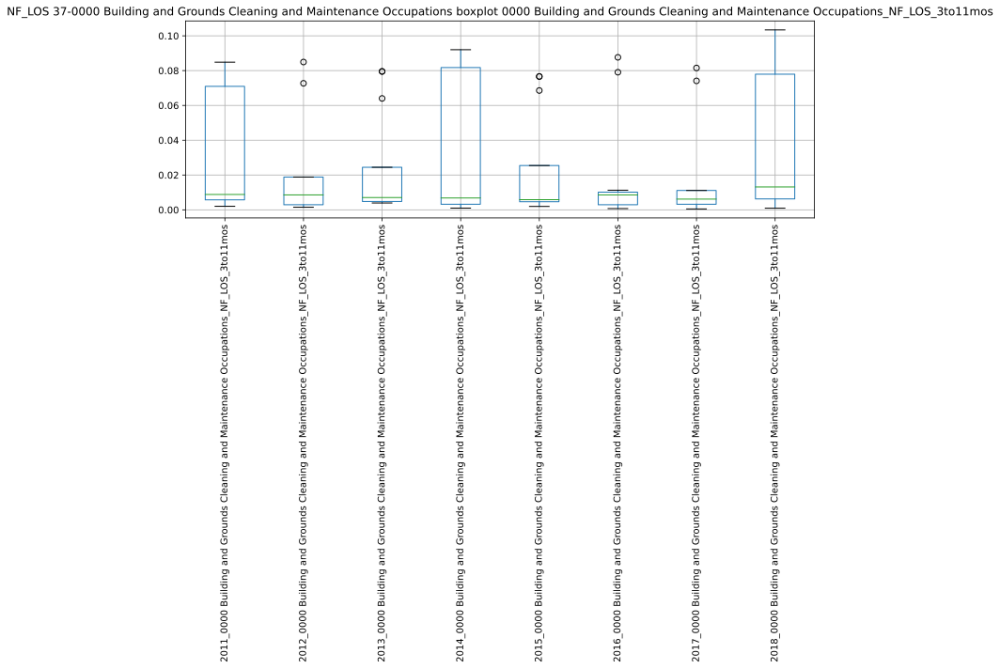

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234221.763346:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234221.801275:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234222.018948:INFO:headless_shell.cc(660)] Written to file /tmp/tmp0e0qktf8/temp.png.
[1013/234222.230657:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234222.282850:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234222.540737:INFO:headless_shell.cc(660)] Written to file /tmp/tmpptj84x__/temp.png.
[1013/234222.794785:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234222.833657:WARNI

,2011_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,2012_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,2013_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,2014_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,2015_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,2016_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,2017_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,2018_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos
2011_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,1.000000,0.969359,0.991188,0.989241,0.997158,0.974110,0.975444,0.963626
2012_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,0.969359,1.000000,0.943974,0.967508,0.953335,0.971138,0.979124,0.958081
2013_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,0.991188,0.943974,1.000000,0.992447,0.995959,0.980966,0.987015,0.991720
2014_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,0.989241,0.967508,0.992447,1.000000,0.997658,0.991775,0.988960,0.987573
2015_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,0.997158,0.953335,0.995959,0.997658,1.000000,0.991295,0.993125,0.994270
2016_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,0.974110,0.971138,0.980966,0.991775,0.991295,1.000000,0.995009,0.991914
2017_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,0.975444,0.979124,0.987015,0.988960,0.993125,0.995009,1.000000,0.991145
2018_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,0.963626,0.958081,0.991720,0.987573,0.994270,0.991914,0.991145,1.000000


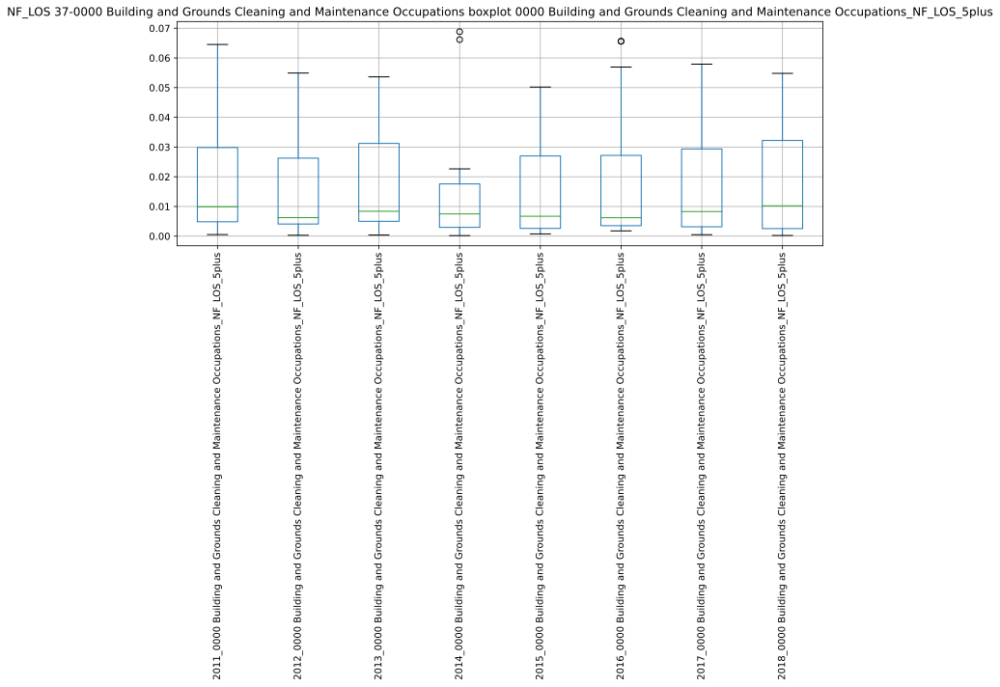

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234226.962375:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234226.999017:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234227.227857:INFO:headless_shell.cc(660)] Written to file /tmp/tmpuodq4c4g/temp.png.
[1013/234227.454378:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234227.496730:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234227.795342:INFO:headless_shell.cc(660)] Written to file /tmp/tmph2kfhnm8/temp.png.
[1013/234228.074123:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234228.113347:WARNI

,2011_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,2012_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,2013_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,2014_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,2015_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,2016_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,2017_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,2018_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus
2011_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,1.000000,0.997387,0.985051,0.984875,0.992505,0.992307,0.993569,0.984128
2012_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,0.997387,1.000000,0.989230,0.990348,0.997083,0.995611,0.998082,0.987104
2013_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,0.985051,0.989230,1.000000,0.935092,0.990563,0.973583,0.985993,0.991197
2014_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,0.984875,0.990348,0.935092,1.000000,0.983907,0.993253,0.989240,0.952521
2015_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,0.992505,0.997083,0.990563,0.983907,1.000000,0.991349,0.998314,0.993875
2016_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,0.992307,0.995611,0.973583,0.993253,0.991349,1.000000,0.995161,0.975510
2017_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,0.993569,0.998082,0.985993,0.989240,0.998314,0.995161,1.000000,0.987044
2018_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,0.984128,0.987104,0.991197,0.952521,0.993875,0.975510,0.987044,1.000000


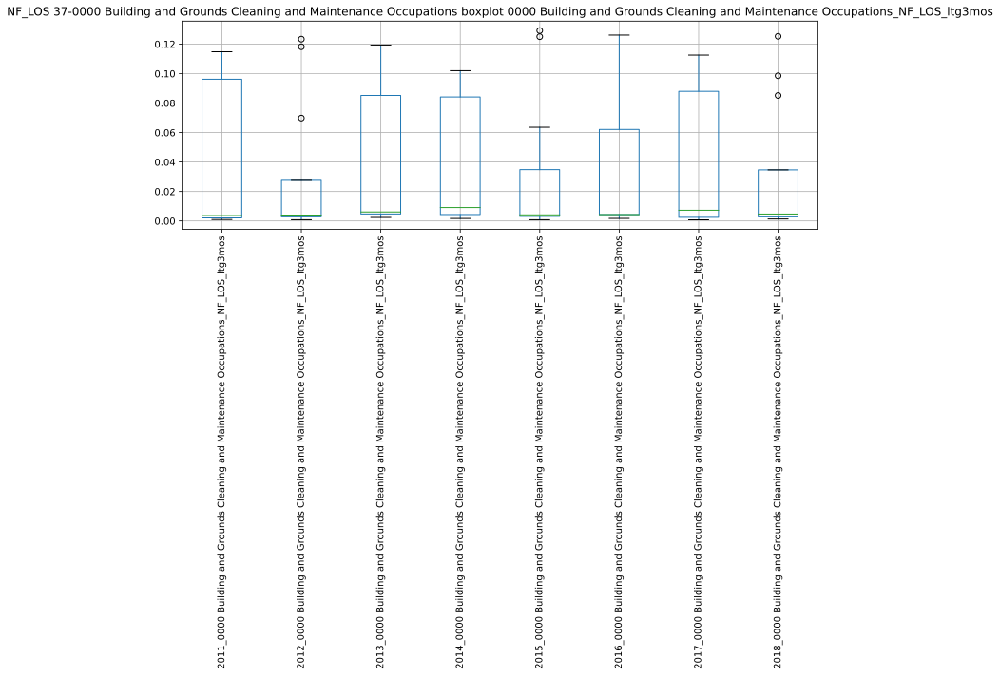

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234232.282526:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234232.320479:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234232.543588:INFO:headless_shell.cc(660)] Written to file /tmp/tmpc3s9ewso/temp.png.
[1013/234232.772428:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234232.810424:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234233.131811:INFO:headless_shell.cc(660)] Written to file /tmp/tmpcfsf53zg/temp.png.
[1013/234233.399176:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234233.437201:WARNI

,2011_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,2012_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,2013_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,2014_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,2015_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,2016_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,2017_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,2018_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos
2011_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,1.000000,0.198247,0.463376,0.449033,0.248194,0.981903,0.455768,0.104227
2012_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,0.198247,1.000000,0.988777,0.966722,0.995514,0.566987,0.977161,0.986174
2013_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,0.463376,0.988777,1.000000,0.994311,0.985074,0.607278,0.996124,0.993634
2014_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,0.449033,0.966722,0.994311,1.000000,0.960683,0.563219,0.998133,0.980036
2015_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,0.248194,0.995514,0.985074,0.960683,1.000000,0.617128,0.975535,0.968820
2016_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,0.981903,0.566987,0.607278,0.563219,0.617128,1.000000,0.570077,0.428462
2017_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,0.455768,0.977161,0.996124,0.998133,0.975535,0.570077,1.000000,0.983231
2018_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,0.104227,0.986174,0.993634,0.980036,0.968820,0.428462,0.983231,1.000000


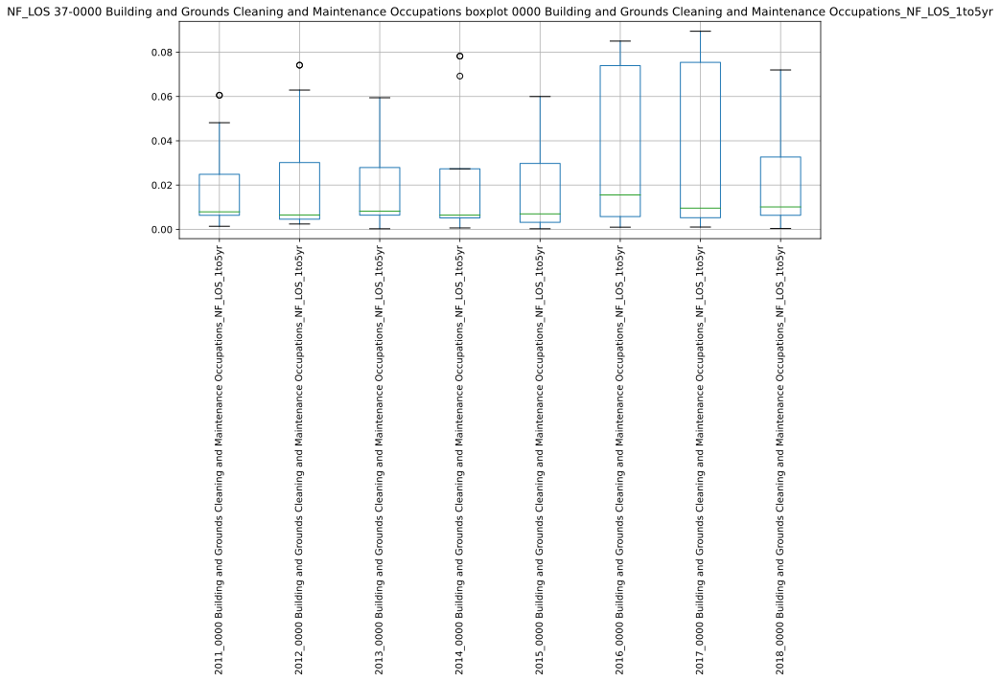

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234237.782516:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234237.820673:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234238.036440:INFO:headless_shell.cc(660)] Written to file /tmp/tmpya34huwz/temp.png.
[1013/234238.274056:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234238.316546:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234238.595792:INFO:headless_shell.cc(660)] Written to file /tmp/tmpcbihcfxf/temp.png.
[1013/234238.865859:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234238.905642:WARNI

,2011_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,2012_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,2013_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,2014_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,2015_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,2016_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,2017_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,2018_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr
2011_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,1.000000,0.995568,0.993317,0.993393,0.991263,0.992118,0.992153,0.994817
2012_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,0.995568,1.000000,0.988011,0.995979,0.994730,0.991442,0.996355,0.995272
2013_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,0.993317,0.988011,1.000000,0.982182,0.991164,0.973578,0.975598,0.993718
2014_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,0.993393,0.995979,0.982182,1.000000,0.987617,0.992850,0.997405,0.992986
2015_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,0.991263,0.994730,0.991164,0.987617,1.000000,0.983463,0.986977,0.996470
2016_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,0.992118,0.991442,0.973578,0.992850,0.983463,1.000000,0.996788,0.988770
2017_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,0.992153,0.996355,0.975598,0.997405,0.986977,0.996788,1.000000,0.989678
2018_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,0.994817,0.995272,0.993718,0.992986,0.996470,0.988770,0.989678,1.000000


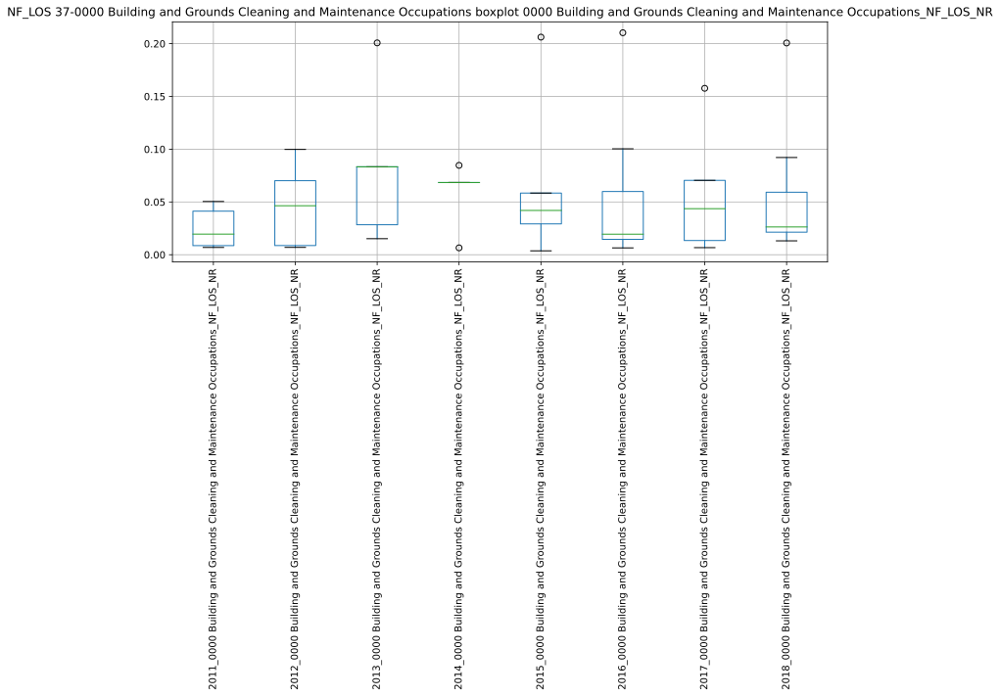

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234243.045679:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234243.082908:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234243.305342:INFO:headless_shell.cc(660)] Written to file /tmp/tmpm1k3pb6s/temp.png.
[1013/234243.533946:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234243.571373:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234243.905054:INFO:headless_shell.cc(660)] Written to file /tmp/tmp58bo9acn/temp.png.
[1013/234244.180373:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234244.222582:WARNI

,2011_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,2012_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,2013_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,2014_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,2015_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,2016_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,2017_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,2018_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR
2011_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,1.000000,0.242844,0.355341,nan,0.475782,0.662341,0.021864,0.643600
2012_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,0.242844,1.000000,0.823893,nan,0.229828,0.218053,-0.075253,0.230577
2013_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,0.355341,0.823893,1.000000,nan,-0.161434,0.777921,0.292029,0.792687
2014_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,nan,nan,nan,1.000000,-0.518177,nan,0.790140,nan
2015_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,0.475782,0.229828,-0.161434,-0.518177,1.000000,0.961482,0.221577,0.972639
2016_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,0.662341,0.218053,0.777921,nan,0.961482,1.000000,0.799275,0.998843
2017_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,0.021864,-0.075253,0.292029,0.790140,0.221577,0.799275,1.000000,0.784335
2018_0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,0.643600,0.230577,0.792687,nan,0.972639,0.998843,0.784335,1.000000


########################################## CORRELATIONS ###############################################
['37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos', '37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus', '37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos', '37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr', '37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR']


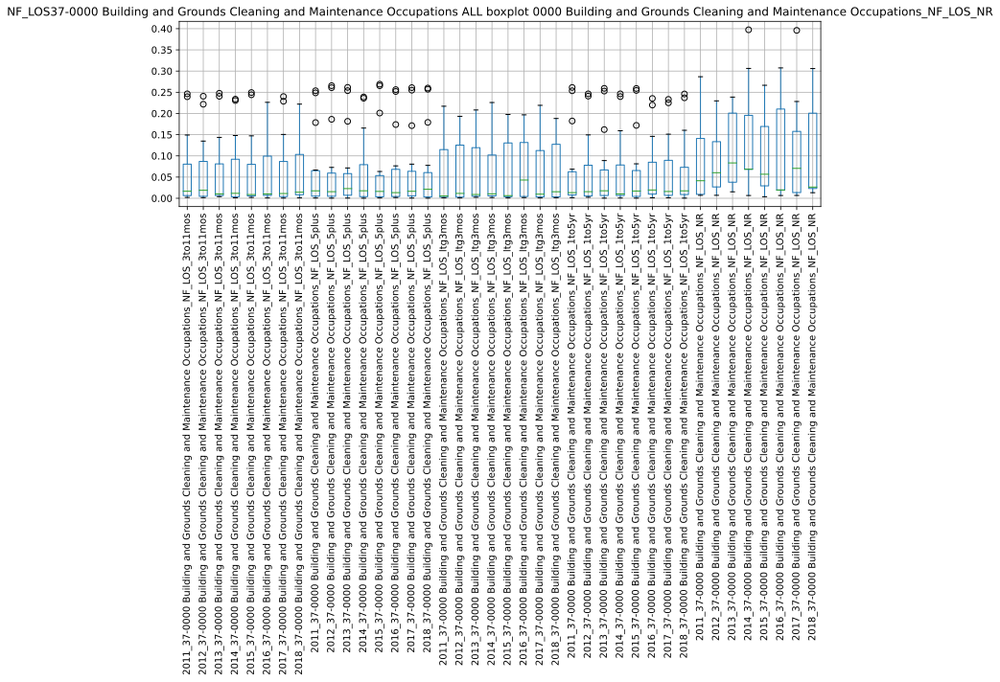

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234250.942121:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234250.979969:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234251.309448:INFO:headless_shell.cc(660)] Written to file /tmp/tmpqece6xbo/temp.png.
[1013/234251.550126:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234251.590027:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234252.103872:INFO:headless_shell.cc(660)] Written to file /tmp/tmpzi8abusc/temp.png.
[1013/234252.422880:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234252.462246:WARNI

,2011_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,2012_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,2013_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,2014_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,2015_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,2016_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,2017_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,2018_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,2011_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,2012_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,2013_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,2014_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,2015_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,2016_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,2017_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,2018_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_5plus,2011_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,2012_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,2013_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,2014_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,2015_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,2016_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,2017_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,2018_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_ltg3mos,2011_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,2012_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,2013_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,2014_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,2015_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,2016_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,2017_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,2018_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_1to5yr,2011_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,2012_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,2013_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,2014_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,2015_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,2016_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,2017_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR,2018_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_NR
2011_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,1.000000,0.994501,0.998917,0.994792,0.999516,0.988039,0.996055,0.981353,0.991471,0.988181,0.985553,0.995551,0.980866,0.995547,0.993058,0.987978,0.532773,0.917503,0.955220,0.983808,0.921042,0.455481,0.965602,0.900216,0.990328,0.999303,0.993146,0.998980,0.993973,0.996060,0.994831,0.997669,0.565845,0.556933,0.521526,-0.689246,0.973423,0.584070,-0.402202,0.553999
2012_37-0000 Building and Grounds Cleaning and Maintenance Occupations_NF_LOS_3to11mos,0.994501,1.000000,0.995674,0.994911,0.995463,0.993762,0.996868,0.990031,0.97832

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
39-0000 Personal Care and Service Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
39-0000 Personal Care and Service Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
39-0000 Personal Care and Service Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPA

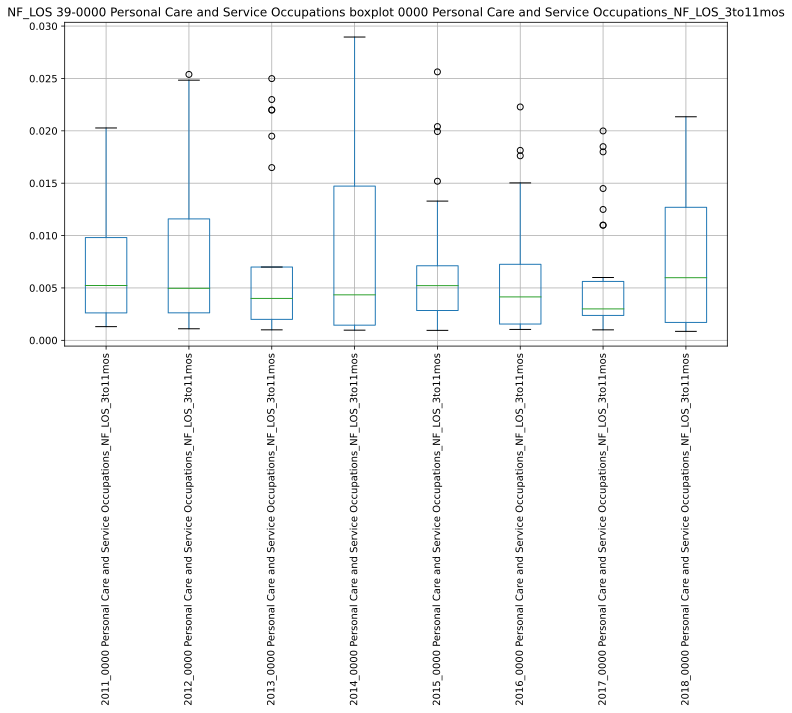

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234413.510095:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234413.547058:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234413.769238:INFO:headless_shell.cc(660)] Written to file /tmp/tmpxnrt265c/temp.png.
[1013/234413.999287:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234414.032439:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234414.351685:INFO:headless_shell.cc(660)] Written to file /tmp/tmpda78d1pe/temp.png.
[1013/234414.623815:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234414.661764:WARNI

,2011_0000 Personal Care and Service Occupations_NF_LOS_3to11mos,2012_0000 Personal Care and Service Occupations_NF_LOS_3to11mos,2013_0000 Personal Care and Service Occupations_NF_LOS_3to11mos,2014_0000 Personal Care and Service Occupations_NF_LOS_3to11mos,2015_0000 Personal Care and Service Occupations_NF_LOS_3to11mos,2016_0000 Personal Care and Service Occupations_NF_LOS_3to11mos,2017_0000 Personal Care and Service Occupations_NF_LOS_3to11mos,2018_0000 Personal Care and Service Occupations_NF_LOS_3to11mos
2011_0000 Personal Care and Service Occupations_NF_LOS_3to11mos,1.000000,0.147379,-0.002601,0.130135,0.719361,0.508787,0.686629,-0.236870
2012_0000 Personal Care and Service Occupations_NF_LOS_3to11mos,0.147379,1.000000,0.307832,0.061919,-0.003408,0.128505,0.196490,0.519495
2013_0000 Personal Care and Service Occupations_NF_LOS_3to11mos,-0.002601,0.307832,1.000000,0.488443,-0.042332,0.390812,0.048552,0.071182
2014_0000 Personal Care and Service Occupations_NF_LOS_3to11mos,0.130135,0.061919,0.488443,1.000000,0.348516,0.436033,0.352331,-0.041340
2015_0000 Personal Care and Service Occupations_NF_LOS_3to11mos,0.719361,-0.003408,-0.042332,0.348516,1.000000,0.836783,0.561948,-0.357232
2016_0000 Personal Care and Service Occupations_NF_LOS_3to11mos,0.508787,0.128505,0.390812,0.436033,0.836783,1.000000,0.765121,-0.145486
2017_0000 Personal Care and Service Occupations_NF_LOS_3to11mos,0.686629,0.196490,0.048552,0.352331,0.561948,0.765121,1.000000,0.002093
2018_0000 Personal Care and Service Occupations_NF_LOS_3to11mos,-0.236870,0.519495,0.071182,-0.041340,-0.357232,-0.145486,0.002093,1.000000


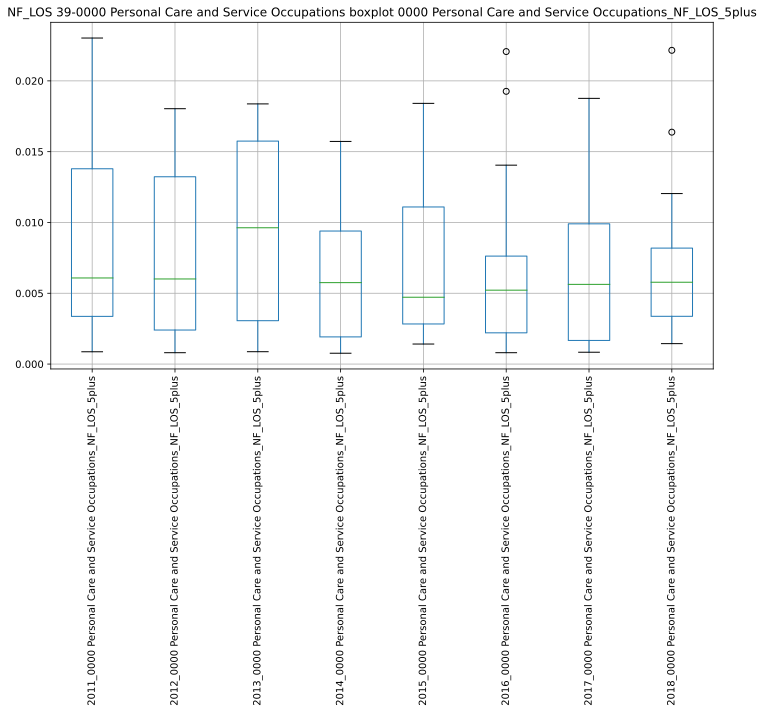

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234417.379083:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234417.418758:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234417.649706:INFO:headless_shell.cc(660)] Written to file /tmp/tmpkb_uuhqx/temp.png.
[1013/234417.881495:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234417.918220:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234418.211219:INFO:headless_shell.cc(660)] Written to file /tmp/tmpndaydhuo/temp.png.
[1013/234418.490504:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234418.530628:WARNI

,2011_0000 Personal Care and Service Occupations_NF_LOS_5plus,2012_0000 Personal Care and Service Occupations_NF_LOS_5plus,2013_0000 Personal Care and Service Occupations_NF_LOS_5plus,2014_0000 Personal Care and Service Occupations_NF_LOS_5plus,2015_0000 Personal Care and Service Occupations_NF_LOS_5plus,2016_0000 Personal Care and Service Occupations_NF_LOS_5plus,2017_0000 Personal Care and Service Occupations_NF_LOS_5plus,2018_0000 Personal Care and Service Occupations_NF_LOS_5plus
2011_0000 Personal Care and Service Occupations_NF_LOS_5plus,1.000000,0.168214,-0.222016,0.270606,0.593275,0.310379,0.131109,-0.067162
2012_0000 Personal Care and Service Occupations_NF_LOS_5plus,0.168214,1.000000,0.164460,-0.093064,0.320906,-0.130801,-0.061814,-0.145932
2013_0000 Personal Care and Service Occupations_NF_LOS_5plus,-0.222016,0.164460,1.000000,0.530840,0.040684,-0.177885,0.160609,0.243242
2014_0000 Personal Care and Service Occupations_NF_LOS_5plus,0.270606,-0.093064,0.530840,1.000000,0.149843,0.139719,0.318142,0.154072
2015_0000 Personal Care and Service Occupations_NF_LOS_5plus,0.593275,0.320906,0.040684,0.149843,1.000000,0.475294,0.223336,0.114416
2016_0000 Personal Care and Service Occupations_NF_LOS_5plus,0.310379,-0.130801,-0.177885,0.139719,0.475294,1.000000,0.559948,0.277555
2017_0000 Personal Care and Service Occupations_NF_LOS_5plus,0.131109,-0.061814,0.160609,0.318142,0.223336,0.559948,1.000000,0.382787
2018_0000 Personal Care and Service Occupations_NF_LOS_5plus,-0.067162,-0.145932,0.243242,0.154072,0.114416,0.277555,0.382787,1.000000


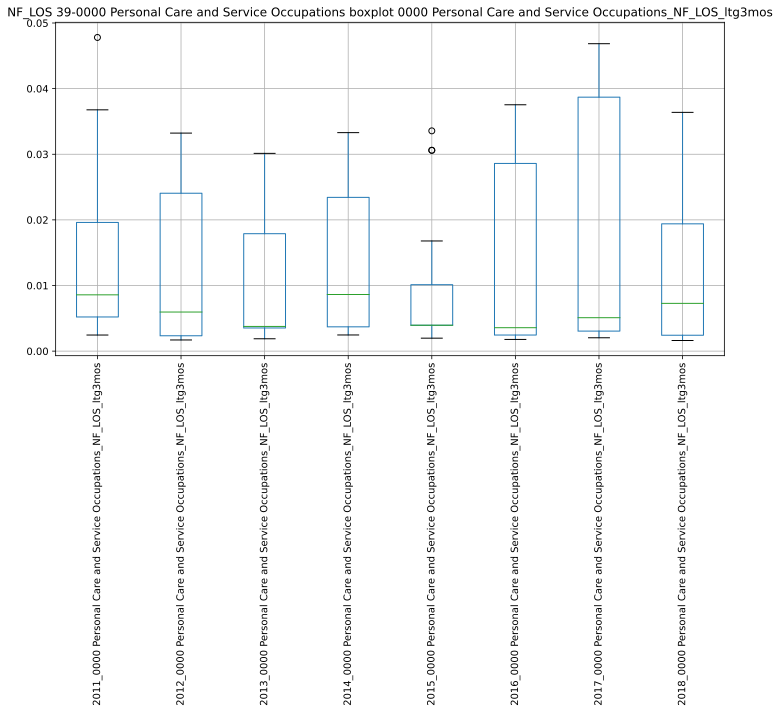

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234421.267234:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234421.305053:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234421.510609:INFO:headless_shell.cc(660)] Written to file /tmp/tmpgrppwbp_/temp.png.
[1013/234421.728778:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234421.765888:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234422.082915:INFO:headless_shell.cc(660)] Written to file /tmp/tmpfwzs33_6/temp.png.
[1013/234422.353501:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234422.395280:WARNI

,2011_0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,2012_0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,2013_0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,2014_0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,2015_0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,2016_0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,2017_0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,2018_0000 Personal Care and Service Occupations_NF_LOS_ltg3mos
2011_0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,1.000000,-0.131909,0.534237,0.269665,0.920471,-0.145842,-0.523702,0.526144
2012_0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,-0.131909,1.000000,-0.441450,-0.447194,-0.140336,0.351362,0.033464,-0.061924
2013_0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,0.534237,-0.441450,1.000000,0.216656,0.259852,-0.378651,0.124479,0.717543
2014_0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,0.269665,-0.447194,0.216656,1.000000,0.669950,0.498846,-0.053098,-0.062297
2015_0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,0.920471,-0.140336,0.259852,0.669950,1.000000,0.286199,-0.216492,0.296595
2016_0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,-0.145842,0.351362,-0.378651,0.498846,0.286199,1.000000,0.020670,-0.235105
2017_0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,-0.523702,0.033464,0.124479,-0.053098,-0.216492,0.020670,1.000000,0.249175
2018_0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,0.526144,-0.061924,0.717543,-0.062297,0.296595,-0.235105,0.249175,1.000000


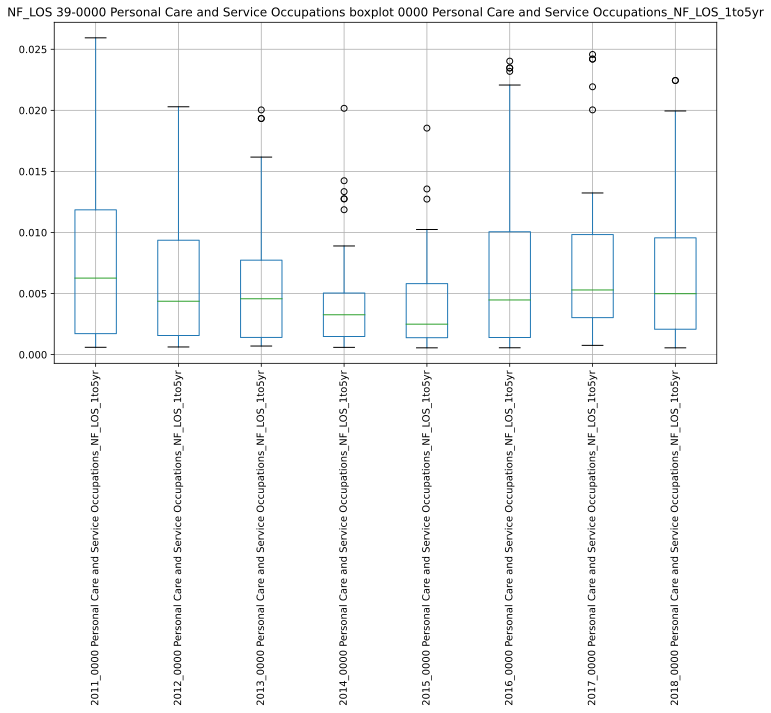

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234425.205891:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234425.250885:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234425.456340:INFO:headless_shell.cc(660)] Written to file /tmp/tmp53bucji_/temp.png.
[1013/234425.668296:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234425.706465:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234425.975207:INFO:headless_shell.cc(660)] Written to file /tmp/tmpo3opi8vu/temp.png.
[1013/234426.237013:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234426.274142:WARNI

,2011_0000 Personal Care and Service Occupations_NF_LOS_1to5yr,2012_0000 Personal Care and Service Occupations_NF_LOS_1to5yr,2013_0000 Personal Care and Service Occupations_NF_LOS_1to5yr,2014_0000 Personal Care and Service Occupations_NF_LOS_1to5yr,2015_0000 Personal Care and Service Occupations_NF_LOS_1to5yr,2016_0000 Personal Care and Service Occupations_NF_LOS_1to5yr,2017_0000 Personal Care and Service Occupations_NF_LOS_1to5yr,2018_0000 Personal Care and Service Occupations_NF_LOS_1to5yr
2011_0000 Personal Care and Service Occupations_NF_LOS_1to5yr,1.000000,0.412129,0.388621,0.359966,0.575842,0.754519,-0.142428,0.724394
2012_0000 Personal Care and Service Occupations_NF_LOS_1to5yr,0.412129,1.000000,0.065668,-0.269046,0.210570,0.398117,0.088872,0.312143
2013_0000 Personal Care and Service Occupations_NF_LOS_1to5yr,0.388621,0.065668,1.000000,0.739659,0.511201,0.617284,-0.197763,0.122458
2014_0000 Personal Care and Service Occupations_NF_LOS_1to5yr,0.359966,-0.269046,0.739659,1.000000,0.429455,0.741957,-0.216300,0.389604
2015_0000 Personal Care and Service Occupations_NF_LOS_1to5yr,0.575842,0.210570,0.511201,0.429455,1.000000,0.662134,-0.185160,0.540234
2016_0000 Personal Care and Service Occupations_NF_LOS_1to5yr,0.754519,0.398117,0.617284,0.741957,0.662134,1.000000,-0.037281,0.696030
2017_0000 Personal Care and Service Occupations_NF_LOS_1to5yr,-0.142428,0.088872,-0.197763,-0.216300,-0.185160,-0.037281,1.000000,0.156990
2018_0000 Personal Care and Service Occupations_NF_LOS_1to5yr,0.724394,0.312143,0.122458,0.389604,0.540234,0.696030,0.156990,1.000000


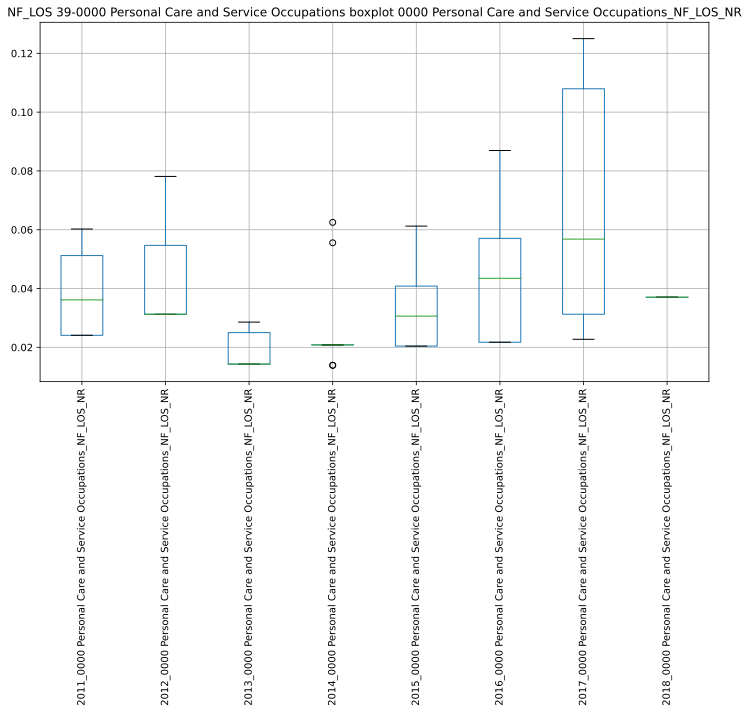

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234428.949521:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234428.988886:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234429.211579:INFO:headless_shell.cc(660)] Written to file /tmp/tmp09b13pkc/temp.png.
[1013/234429.447927:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234429.486130:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234429.788410:INFO:headless_shell.cc(660)] Written to file /tmp/tmp5cbdwi5g/temp.png.
[1013/234430.063304:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234430.105601:WARNI

,2011_0000 Personal Care and Service Occupations_NF_LOS_NR,2012_0000 Personal Care and Service Occupations_NF_LOS_NR,2013_0000 Personal Care and Service Occupations_NF_LOS_NR,2014_0000 Personal Care and Service Occupations_NF_LOS_NR,2015_0000 Personal Care and Service Occupations_NF_LOS_NR,2016_0000 Personal Care and Service Occupations_NF_LOS_NR,2017_0000 Personal Care and Service Occupations_NF_LOS_NR,2018_0000 Personal Care and Service Occupations_NF_LOS_NR
2011_0000 Personal Care and Service Occupations_NF_LOS_NR,1.000000,0.488901,-0.717172,-0.406572,-0.773021,0.369473,0.032686,nan
2012_0000 Personal Care and Service Occupations_NF_LOS_NR,0.488901,1.000000,nan,-0.389249,0.441726,-0.286299,-0.755929,nan
2013_0000 Personal Care and Service Occupations_NF_LOS_NR,-0.717172,nan,1.000000,0.709221,-0.577350,-0.180151,-1.000000,nan
2014_0000 Personal Care and Service Occupations_NF_LOS_NR,-0.406572,-0.389249,0.709221,1.000000,-0.194257,0.120096,-0.287527,nan
2015_0000 Personal Care and Service Occupations_NF_LOS_NR,-0.773021,0.441726,-0.577350,-0.194257,1.000000,-0.476690,-0.134595,nan
2016_0000 Personal Care and Service Occupations_NF_LOS_NR,0.369473,-0.286299,-0.180151,0.120096,-0.476690,1.000000,0.874818,nan
2017_0000 Personal Care and Service Occupations_NF_LOS_NR,0.032686,-0.755929,-1.000000,-0.287527,-0.134595,0.874818,1.000000,nan
2018_0000 Personal Care and Service Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan


########################################## CORRELATIONS ###############################################
['39-0000 Personal Care and Service Occupations_NF_LOS_3to11mos', '39-0000 Personal Care and Service Occupations_NF_LOS_5plus', '39-0000 Personal Care and Service Occupations_NF_LOS_ltg3mos', '39-0000 Personal Care and Service Occupations_NF_LOS_1to5yr', '39-0000 Personal Care and Service Occupations_NF_LOS_NR']


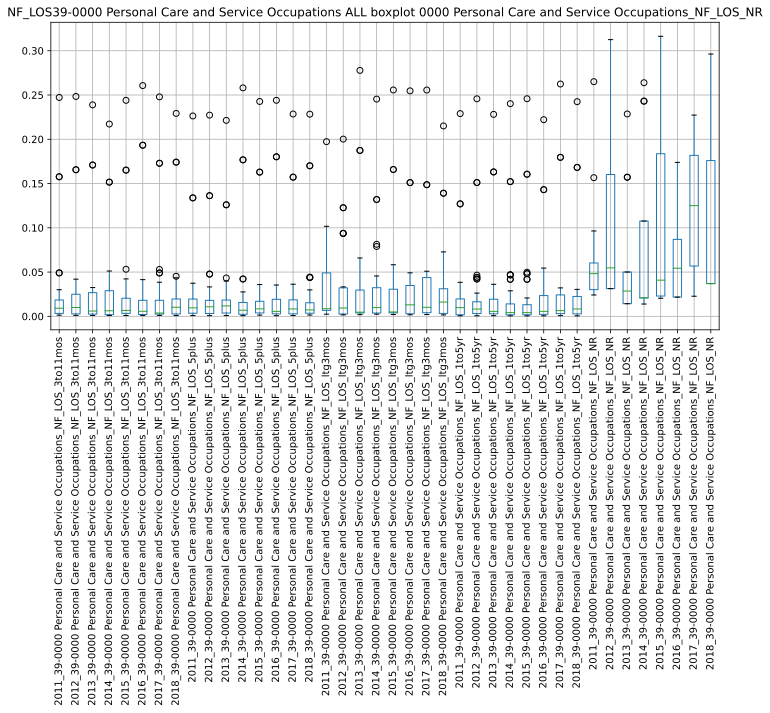

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234434.803515:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234434.832185:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234435.149743:INFO:headless_shell.cc(660)] Written to file /tmp/tmp5oc72eyn/temp.png.
[1013/234435.370560:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234435.409833:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234435.914667:INFO:headless_shell.cc(660)] Written to file /tmp/tmprp7rk85x/temp.png.
[1013/234436.226552:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234436.270153:WARNI

,2011_39-0000 Personal Care and Service Occupations_NF_LOS_3to11mos,2012_39-0000 Personal Care and Service Occupations_NF_LOS_3to11mos,2013_39-0000 Personal Care and Service Occupations_NF_LOS_3to11mos,2014_39-0000 Personal Care and Service Occupations_NF_LOS_3to11mos,2015_39-0000 Personal Care and Service Occupations_NF_LOS_3to11mos,2016_39-0000 Personal Care and Service Occupations_NF_LOS_3to11mos,2017_39-0000 Personal Care and Service Occupations_NF_LOS_3to11mos,2018_39-0000 Personal Care and Service Occupations_NF_LOS_3to11mos,2011_39-0000 Personal Care and Service Occupations_NF_LOS_5plus,2012_39-0000 Personal Care and Service Occupations_NF_LOS_5plus,2013_39-0000 Personal Care and Service Occupations_NF_LOS_5plus,2014_39-0000 Personal Care and Service Occupations_NF_LOS_5plus,2015_39-0000 Personal Care and Service Occupations_NF_LOS_5plus,2016_39-0000 Personal Care and Service Occupations_NF_LOS_5plus,2017_39-0000 Personal Care and Service Occupations_NF_LOS_5plus,2018_39-0000 Personal Care and Service Occupations_NF_LOS_5plus,2011_39-0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,2012_39-0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,2013_39-0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,2014_39-0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,2015_39-0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,2016_39-0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,2017_39-0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,2018_39-0000 Personal Care and Service Occupations_NF_LOS_ltg3mos,2011_39-0000 Personal Care and Service Occupations_NF_LOS_1to5yr,2012_39-0000 Personal Care and Service Occupations_NF_LOS_1to5yr,2013_39-0000 Personal Care and Service Occupations_NF_LOS_1to5yr,2014_39-0000 Personal Care and Service Occupations_NF_LOS_1to5yr,2015_39-0000 Personal Care and Service Occupations_NF_LOS_1to5yr,2016_39-0000 Personal Care and Service Occupations_NF_LOS_1to5yr,2017_39-0000 Personal Care and Service Occupations_NF_LOS_1to5yr,2018_39-0000 Personal Care and Service Occupations_NF_LOS_1to5yr,2011_39-0000 Personal Care and Service Occupations_NF_LOS_NR,2012_39-0000 Personal Care and Service Occupations_NF_LOS_NR,2013_39-0000 Personal Care and Service Occupations_NF_LOS_NR,2014_39-0000 Personal Care and Service Occupations_NF_LOS_NR,2015_39-0000 Personal Care and Service Occupations_NF_LOS_NR,2016_39-0000 Personal Care and Service Occupations_NF_LOS_NR,2017_39-0000 Personal Care and Service Occupations_NF_LOS_NR,2018_39-0000 Personal Care and Service Occupations_NF_LOS_NR
2011_39-0000 Personal Care and Service Occupations_NF_LOS_3to11mos,1.000000,-0.113632,0.364853,0.348990,-0.113284,-0.100634,0.096318,0.290550,0.309788,-0.091686,0.274715,0.093692,0.067917,0.271256,0.240497,0.966671,-0.067490,0.051717,-0.139504,-0.114603,-0.113346,-0.110551,-0.279936,-0.106255,0.322304,0.972297,-0.102651,0.259107,-0.079592,0.936067,-0.069890,0.280007,0.295598,0.009337,0.187892,0.000387,0.294833,-0.217577,-0.476722,0.793356
2012_39-0000 Personal Care and Service Occupations_NF_LOS_3to11mos,-0.113632,1.000000,0.273731,0.253365,0.266343,0.246476,0.244866,-0.011017,-0.085701,0.007948,-0.051917,-0.111784,-0.096217,-0.090292,-0.070715,-0.116763,0.110933,-0.041438,-0.149427,-0.184958,0.341630,-0.172161,-0.121482,0.171876,-0.056658,-0.114183,-0.012369,-0.025447,-0.025682,-0.161386,0.240653,-0.100758,-0.338385,0.288823,-0.130553,-0.170570,0.691025,-0.162590,0.178247,0.064980
2013_39-0000 Personal Care and Service Occupations_NF_LOS_3to11mos,0.364853,0.273731,1.000000,0.981860,0.050424,0.018676,0.296601,0.235764,-0.149153,-0.145498,0.293051,-0.091743,-0.089774,-0.131564,-0.106259,0.303737,-0.242023,-0.178767,-0.004103,-0.096797,-0.183443,-0.080539,0.356251,-0.196151,-0.154948,0.376045,-0.142320,-0.111260,-0.135801,0.298855,0.014798,-0.140230,0.250932,0.135517,0.119512,0.075609,-0.141206,-0.415260,-0.029491,0.204448
2014_39-0000 Personal Care and Service Occupations_NF_LOS_3to11mos,0.348

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
41-0000 Sales and Related Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
41-0000 Sales and Related Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
41-0000 Sales and Related Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
41-000

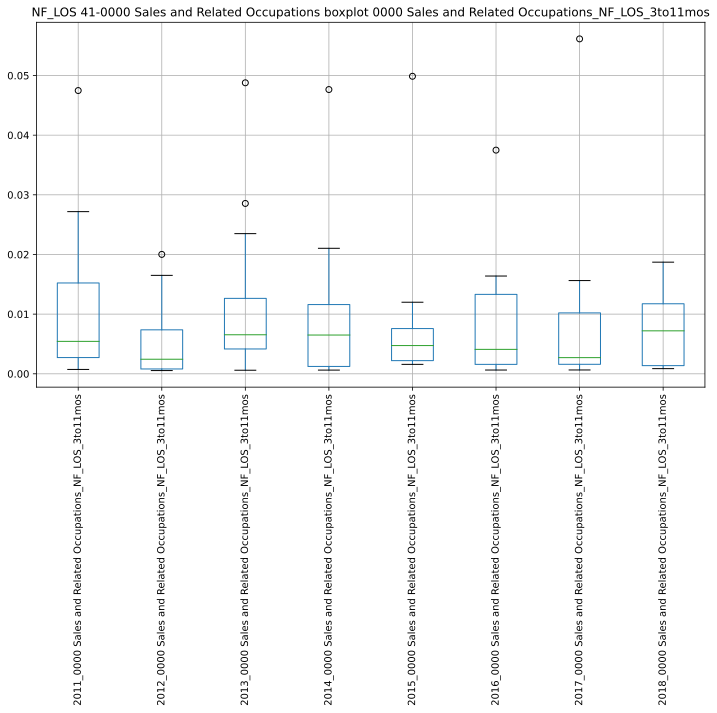

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234515.540680:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234515.580715:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234515.797617:INFO:headless_shell.cc(660)] Written to file /tmp/tmpggup3ten/temp.png.
[1013/234516.010333:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234516.052925:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234516.358480:INFO:headless_shell.cc(660)] Written to file /tmp/tmpg0fz5835/temp.png.
[1013/234516.622014:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234516.662094:WARNI

,2011_0000 Sales and Related Occupations_NF_LOS_3to11mos,2012_0000 Sales and Related Occupations_NF_LOS_3to11mos,2013_0000 Sales and Related Occupations_NF_LOS_3to11mos,2014_0000 Sales and Related Occupations_NF_LOS_3to11mos,2015_0000 Sales and Related Occupations_NF_LOS_3to11mos,2016_0000 Sales and Related Occupations_NF_LOS_3to11mos,2017_0000 Sales and Related Occupations_NF_LOS_3to11mos,2018_0000 Sales and Related Occupations_NF_LOS_3to11mos
2011_0000 Sales and Related Occupations_NF_LOS_3to11mos,1.000000,0.120059,0.608056,0.482781,0.883332,0.543836,0.709100,0.056055
2012_0000 Sales and Related Occupations_NF_LOS_3to11mos,0.120059,1.000000,-0.242623,-0.074715,-0.202416,-0.082532,0.588659,0.251375
2013_0000 Sales and Related Occupations_NF_LOS_3to11mos,0.608056,-0.242623,1.000000,0.677407,0.735047,0.664950,0.668645,0.108261
2014_0000 Sales and Related Occupations_NF_LOS_3to11mos,0.482781,-0.074715,0.677407,1.000000,0.700646,0.850058,0.696728,0.627032
2015_0000 Sales and Related Occupations_NF_LOS_3to11mos,0.883332,-0.202416,0.735047,0.700646,1.000000,0.738440,0.867243,-0.272624
2016_0000 Sales and Related Occupations_NF_LOS_3to11mos,0.543836,-0.082532,0.664950,0.850058,0.738440,1.000000,0.709876,0.653032
2017_0000 Sales and Related Occupations_NF_LOS_3to11mos,0.709100,0.588659,0.668645,0.696728,0.867243,0.709876,1.000000,0.156617
2018_0000 Sales and Related Occupations_NF_LOS_3to11mos,0.056055,0.251375,0.108261,0.627032,-0.272624,0.653032,0.156617,1.000000


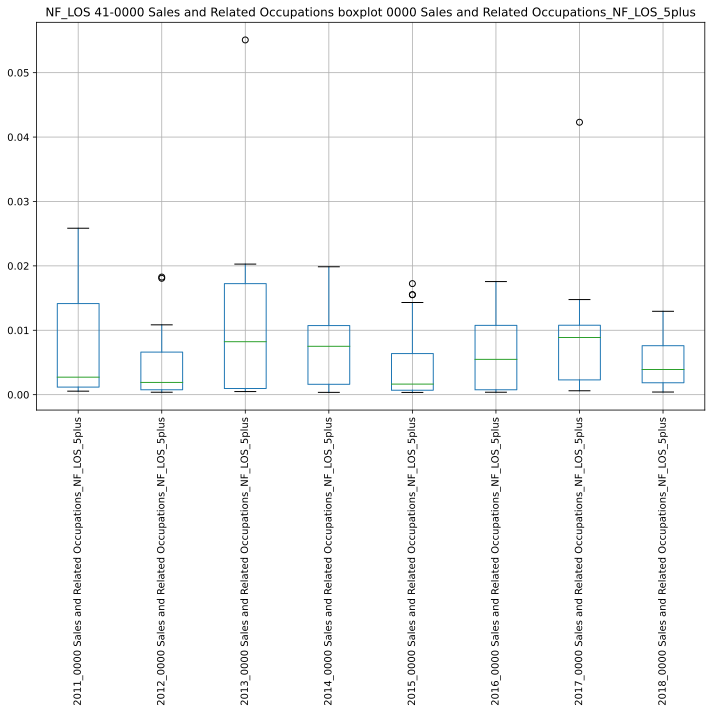

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234519.342034:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234519.385048:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234519.633584:INFO:headless_shell.cc(660)] Written to file /tmp/tmp_fqhf6zr/temp.png.
[1013/234519.851784:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234519.891438:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234520.171001:INFO:headless_shell.cc(660)] Written to file /tmp/tmpdjavl_yr/temp.png.
[1013/234520.430932:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234520.474575:WARNI

,2011_0000 Sales and Related Occupations_NF_LOS_5plus,2012_0000 Sales and Related Occupations_NF_LOS_5plus,2013_0000 Sales and Related Occupations_NF_LOS_5plus,2014_0000 Sales and Related Occupations_NF_LOS_5plus,2015_0000 Sales and Related Occupations_NF_LOS_5plus,2016_0000 Sales and Related Occupations_NF_LOS_5plus,2017_0000 Sales and Related Occupations_NF_LOS_5plus,2018_0000 Sales and Related Occupations_NF_LOS_5plus
2011_0000 Sales and Related Occupations_NF_LOS_5plus,1.000000,0.739709,0.164840,0.361795,0.888228,0.294477,-0.036134,0.420905
2012_0000 Sales and Related Occupations_NF_LOS_5plus,0.739709,1.000000,0.232067,0.466448,0.923350,0.343776,0.151799,0.429664
2013_0000 Sales and Related Occupations_NF_LOS_5plus,0.164840,0.232067,1.000000,0.618062,0.026427,0.627020,0.760293,0.628658
2014_0000 Sales and Related Occupations_NF_LOS_5plus,0.361795,0.466448,0.618062,1.000000,0.216640,0.818790,0.217981,0.926595
2015_0000 Sales and Related Occupations_NF_LOS_5plus,0.888228,0.923350,0.026427,0.216640,1.000000,0.139664,-0.073780,0.280179
2016_0000 Sales and Related Occupations_NF_LOS_5plus,0.294477,0.343776,0.627020,0.818790,0.139664,1.000000,0.120010,0.917436
2017_0000 Sales and Related Occupations_NF_LOS_5plus,-0.036134,0.151799,0.760293,0.217981,-0.073780,0.120010,1.000000,0.105616
2018_0000 Sales and Related Occupations_NF_LOS_5plus,0.420905,0.429664,0.628658,0.926595,0.280179,0.917436,0.105616,1.000000


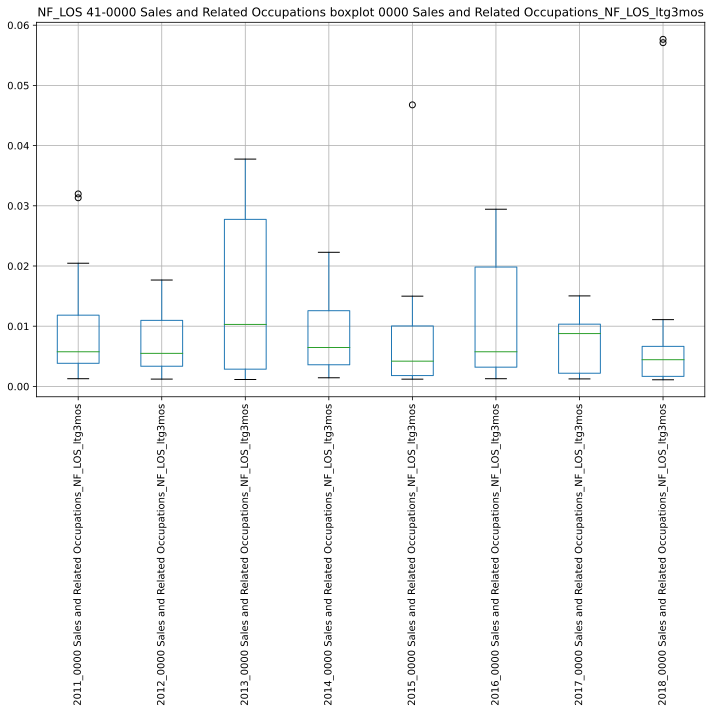

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234523.098552:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234523.136865:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234523.354458:INFO:headless_shell.cc(660)] Written to file /tmp/tmpwkbl5kaf/temp.png.
[1013/234523.558747:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234523.594535:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234523.874379:INFO:headless_shell.cc(660)] Written to file /tmp/tmpz35pl_j6/temp.png.
[1013/234524.133946:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234524.178882:WARNI

,2011_0000 Sales and Related Occupations_NF_LOS_ltg3mos,2012_0000 Sales and Related Occupations_NF_LOS_ltg3mos,2013_0000 Sales and Related Occupations_NF_LOS_ltg3mos,2014_0000 Sales and Related Occupations_NF_LOS_ltg3mos,2015_0000 Sales and Related Occupations_NF_LOS_ltg3mos,2016_0000 Sales and Related Occupations_NF_LOS_ltg3mos,2017_0000 Sales and Related Occupations_NF_LOS_ltg3mos,2018_0000 Sales and Related Occupations_NF_LOS_ltg3mos
2011_0000 Sales and Related Occupations_NF_LOS_ltg3mos,1.000000,0.076811,0.511146,0.455284,0.235385,0.301747,0.750049,0.601569
2012_0000 Sales and Related Occupations_NF_LOS_ltg3mos,0.076811,1.000000,-0.058302,0.242645,0.312150,0.749116,0.425210,-0.236212
2013_0000 Sales and Related Occupations_NF_LOS_ltg3mos,0.511146,-0.058302,1.000000,0.435118,0.266000,0.521100,0.400944,0.341568
2014_0000 Sales and Related Occupations_NF_LOS_ltg3mos,0.455284,0.242645,0.435118,1.000000,0.419461,0.639715,0.261025,-0.036917
2015_0000 Sales and Related Occupations_NF_LOS_ltg3mos,0.235385,0.312150,0.266000,0.419461,1.000000,0.308480,0.144753,-0.098745
2016_0000 Sales and Related Occupations_NF_LOS_ltg3mos,0.301747,0.749116,0.521100,0.639715,0.308480,1.000000,0.490475,-0.379948
2017_0000 Sales and Related Occupations_NF_LOS_ltg3mos,0.750049,0.425210,0.400944,0.261025,0.144753,0.490475,1.000000,0.083045
2018_0000 Sales and Related Occupations_NF_LOS_ltg3mos,0.601569,-0.236212,0.341568,-0.036917,-0.098745,-0.379948,0.083045,1.000000


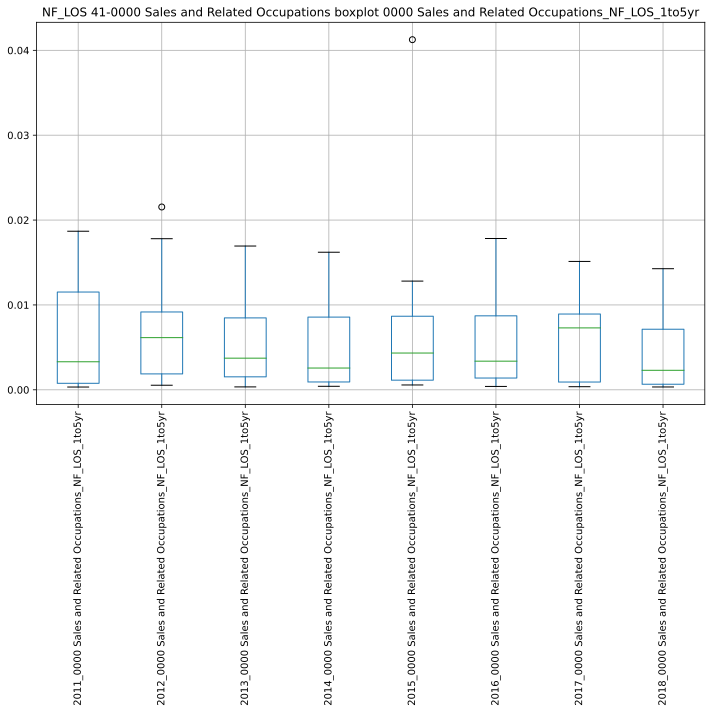

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234526.879449:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234526.920313:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234527.138092:INFO:headless_shell.cc(660)] Written to file /tmp/tmp_c_bxd99/temp.png.
[1013/234527.355876:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234527.395231:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234527.694746:INFO:headless_shell.cc(660)] Written to file /tmp/tmpe70gzlkn/temp.png.
[1013/234527.953243:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234527.991264:WARNI

,2011_0000 Sales and Related Occupations_NF_LOS_1to5yr,2012_0000 Sales and Related Occupations_NF_LOS_1to5yr,2013_0000 Sales and Related Occupations_NF_LOS_1to5yr,2014_0000 Sales and Related Occupations_NF_LOS_1to5yr,2015_0000 Sales and Related Occupations_NF_LOS_1to5yr,2016_0000 Sales and Related Occupations_NF_LOS_1to5yr,2017_0000 Sales and Related Occupations_NF_LOS_1to5yr,2018_0000 Sales and Related Occupations_NF_LOS_1to5yr
2011_0000 Sales and Related Occupations_NF_LOS_1to5yr,1.000000,0.141903,0.196798,0.698621,0.228223,0.659704,0.765411,0.231663
2012_0000 Sales and Related Occupations_NF_LOS_1to5yr,0.141903,1.000000,0.818459,0.160198,0.811982,0.157000,0.233093,0.138407
2013_0000 Sales and Related Occupations_NF_LOS_1to5yr,0.196798,0.818459,1.000000,0.339083,0.720513,0.333226,0.376508,0.085019
2014_0000 Sales and Related Occupations_NF_LOS_1to5yr,0.698621,0.160198,0.339083,1.000000,0.242080,0.624732,0.792539,0.131223
2015_0000 Sales and Related Occupations_NF_LOS_1to5yr,0.228223,0.811982,0.720513,0.242080,1.000000,0.041787,0.219779,0.033833
2016_0000 Sales and Related Occupations_NF_LOS_1to5yr,0.659704,0.157000,0.333226,0.624732,0.041787,1.000000,0.622282,0.237781
2017_0000 Sales and Related Occupations_NF_LOS_1to5yr,0.765411,0.233093,0.376508,0.792539,0.219779,0.622282,1.000000,0.182466
2018_0000 Sales and Related Occupations_NF_LOS_1to5yr,0.231663,0.138407,0.085019,0.131223,0.033833,0.237781,0.182466,1.000000


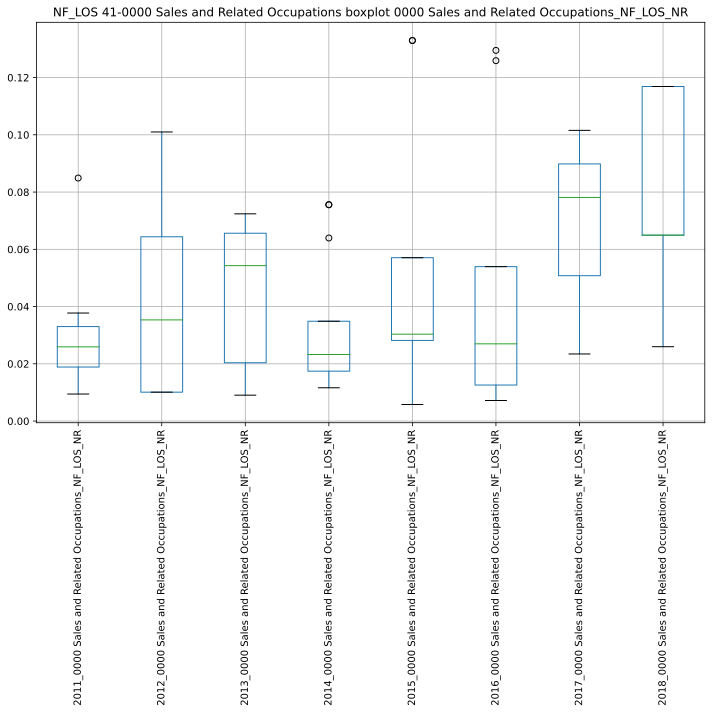

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234530.627643:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234530.664986:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234530.876403:INFO:headless_shell.cc(660)] Written to file /tmp/tmp2juh2s37/temp.png.
[1013/234531.096907:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234531.138549:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234531.443081:INFO:headless_shell.cc(660)] Written to file /tmp/tmpl88u1khm/temp.png.
[1013/234531.705345:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234531.742749:WARNI

,2011_0000 Sales and Related Occupations_NF_LOS_NR,2012_0000 Sales and Related Occupations_NF_LOS_NR,2013_0000 Sales and Related Occupations_NF_LOS_NR,2014_0000 Sales and Related Occupations_NF_LOS_NR,2015_0000 Sales and Related Occupations_NF_LOS_NR,2016_0000 Sales and Related Occupations_NF_LOS_NR,2017_0000 Sales and Related Occupations_NF_LOS_NR,2018_0000 Sales and Related Occupations_NF_LOS_NR
2011_0000 Sales and Related Occupations_NF_LOS_NR,1.000000,0.767401,-0.214788,0.131446,-0.204682,0.873761,-0.926727,0.823658
2012_0000 Sales and Related Occupations_NF_LOS_NR,0.767401,1.000000,0.288645,0.290539,0.144376,0.873905,-0.645925,0.986993
2013_0000 Sales and Related Occupations_NF_LOS_NR,-0.214788,0.288645,1.000000,-0.743157,0.402481,-0.064749,-0.121862,-0.577350
2014_0000 Sales and Related Occupations_NF_LOS_NR,0.131446,0.290539,-0.743157,1.000000,-0.464663,0.430722,-0.463981,0.272692
2015_0000 Sales and Related Occupations_NF_LOS_NR,-0.204682,0.144376,0.402481,-0.464663,1.000000,-0.405369,0.731090,-0.999802
2016_0000 Sales and Related Occupations_NF_LOS_NR,0.873761,0.873905,-0.064749,0.430722,-0.405369,1.000000,-0.958100,0.999748
2017_0000 Sales and Related Occupations_NF_LOS_NR,-0.926727,-0.645925,-0.121862,-0.463981,0.731090,-0.958100,1.000000,-0.787499
2018_0000 Sales and Related Occupations_NF_LOS_NR,0.823658,0.986993,-0.577350,0.272692,-0.999802,0.999748,-0.787499,1.000000


########################################## CORRELATIONS ###############################################
['41-0000 Sales and Related Occupations_NF_LOS_3to11mos', '41-0000 Sales and Related Occupations_NF_LOS_5plus', '41-0000 Sales and Related Occupations_NF_LOS_ltg3mos', '41-0000 Sales and Related Occupations_NF_LOS_1to5yr', '41-0000 Sales and Related Occupations_NF_LOS_NR']


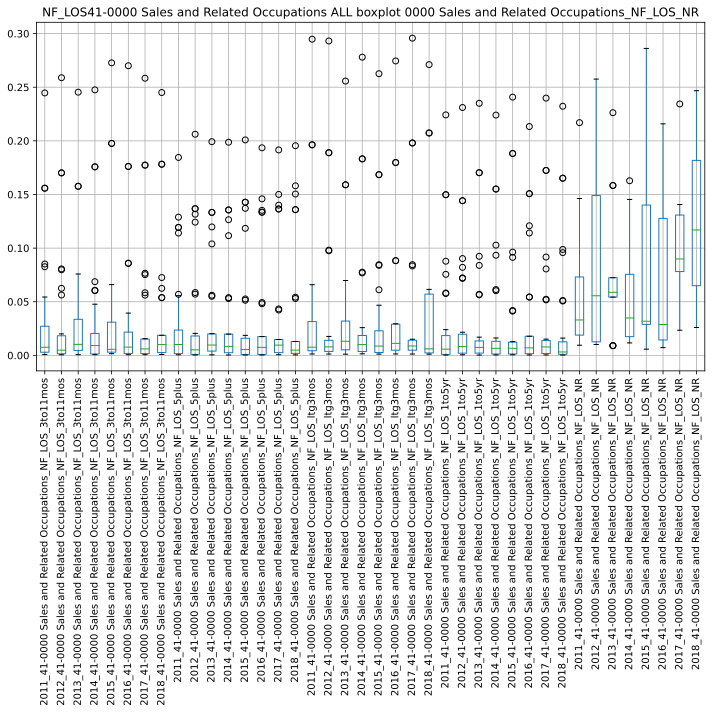

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234536.318352:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234536.356231:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234536.696069:INFO:headless_shell.cc(660)] Written to file /tmp/tmp0piq9ywg/temp.png.
[1013/234536.935823:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234536.972800:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234537.505310:INFO:headless_shell.cc(660)] Written to file /tmp/tmpnlupymdz/temp.png.
[1013/234537.827931:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234537.865108:WARNI

,2011_41-0000 Sales and Related Occupations_NF_LOS_3to11mos,2012_41-0000 Sales and Related Occupations_NF_LOS_3to11mos,2013_41-0000 Sales and Related Occupations_NF_LOS_3to11mos,2014_41-0000 Sales and Related Occupations_NF_LOS_3to11mos,2015_41-0000 Sales and Related Occupations_NF_LOS_3to11mos,2016_41-0000 Sales and Related Occupations_NF_LOS_3to11mos,2017_41-0000 Sales and Related Occupations_NF_LOS_3to11mos,2018_41-0000 Sales and Related Occupations_NF_LOS_3to11mos,2011_41-0000 Sales and Related Occupations_NF_LOS_5plus,2012_41-0000 Sales and Related Occupations_NF_LOS_5plus,2013_41-0000 Sales and Related Occupations_NF_LOS_5plus,2014_41-0000 Sales and Related Occupations_NF_LOS_5plus,2015_41-0000 Sales and Related Occupations_NF_LOS_5plus,2016_41-0000 Sales and Related Occupations_NF_LOS_5plus,2017_41-0000 Sales and Related Occupations_NF_LOS_5plus,2018_41-0000 Sales and Related Occupations_NF_LOS_5plus,2011_41-0000 Sales and Related Occupations_NF_LOS_ltg3mos,2012_41-0000 Sales and Related Occupations_NF_LOS_ltg3mos,2013_41-0000 Sales and Related Occupations_NF_LOS_ltg3mos,2014_41-0000 Sales and Related Occupations_NF_LOS_ltg3mos,2015_41-0000 Sales and Related Occupations_NF_LOS_ltg3mos,2016_41-0000 Sales and Related Occupations_NF_LOS_ltg3mos,2017_41-0000 Sales and Related Occupations_NF_LOS_ltg3mos,2018_41-0000 Sales and Related Occupations_NF_LOS_ltg3mos,2011_41-0000 Sales and Related Occupations_NF_LOS_1to5yr,2012_41-0000 Sales and Related Occupations_NF_LOS_1to5yr,2013_41-0000 Sales and Related Occupations_NF_LOS_1to5yr,2014_41-0000 Sales and Related Occupations_NF_LOS_1to5yr,2015_41-0000 Sales and Related Occupations_NF_LOS_1to5yr,2016_41-0000 Sales and Related Occupations_NF_LOS_1to5yr,2017_41-0000 Sales and Related Occupations_NF_LOS_1to5yr,2018_41-0000 Sales and Related Occupations_NF_LOS_1to5yr,2011_41-0000 Sales and Related Occupations_NF_LOS_NR,2012_41-0000 Sales and Related Occupations_NF_LOS_NR,2013_41-0000 Sales and Related Occupations_NF_LOS_NR,2014_41-0000 Sales and Related Occupations_NF_LOS_NR,2015_41-0000 Sales and Related Occupations_NF_LOS_NR,2016_41-0000 Sales and Related Occupations_NF_LOS_NR,2017_41-0000 Sales and Related Occupations_NF_LOS_NR,2018_41-0000 Sales and Related Occupations_NF_LOS_NR
2011_41-0000 Sales and Related Occupations_NF_LOS_3to11mos,1.000000,0.770545,0.765757,0.977154,0.987436,0.988265,0.761403,0.975657,0.694382,0.712623,0.718560,0.703930,0.694248,0.672321,0.669090,0.662966,0.193243,0.981043,0.212460,0.980445,0.996429,0.982484,0.752274,0.977663,0.760717,0.773089,0.741040,0.736557,0.719272,0.711733,0.740934,0.744928,-0.108518,-0.377748,-0.404110,-0.384591,-0.256722,-0.449077,-0.145856,-0.369555
2012_41-0000 Sales and Related Occupations_NF_LOS_3to11mos,0.770545,1.000000,0.988987,0.733838,0.729748,0.746159,0.997258,0.729113,0.906911,0.924849,0.941334,0.930083,0.921808,0.891827,0.883931,0.875956,-0.061489,0.733539,-0.031353,0.739194,0.758678,0.728040,0.977924,0.706065,0.978842,0.987675,0.984007,0.972649,0.971643,0.946636,0.980355,0.971122,-0.114112,-0.232028,-0.234527,-0.446746,-0.134419,-0.401553,-0.109867,-0.389131
2013_41-0000 Sales and Related Occupations_NF_LOS_3to11mos,0.765757,0.988987,1.000000,0.728446,0.727871,0.745843,0.989942,0.722168,0.890038,0.910711,0.923748,0.913363,0.905698,0.869916,0.859493,0.853781,-0.074880,0.739766,-0.047242,0.740033,0.752140,0.732703,0.980252,0.706035,0.970644,0.971501,0.970253,0.960406,0.958390,0.930927,0.971483,0.962377,-0.147618,-0.245686,-0.233344,-0.429962,-0.125869,-0.422544,-0.101720,-0.402446
2014_41-0000 Sales and Related Occupations_NF_LOS_3to11mos,0.977154,0.733838,0.728446,1.000000,0.991931,0.986644,0.727043,0.995361,0.681421,0.697413,0.702586,0.696118,0.685377,0.670231,0.666846,0.657454,0.240267,0.968701,0.262942,0.982788,0.986864,0.979734,0.708674,0.991839,0.743987,0.742282,0.723341,0.718203,0.708223,0.701632,0.726438,0.730182,-0.067230,-0.390704,-0.350562,-0.369982,-0.239239,-0.375980,-0.152384,-0.329331
2015_41-0000 Sales and 

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
43-0000 Office and Administrative Support Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
43-0000 Office and Administrative Support Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
43-0000 Office and Administrative Support Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##############

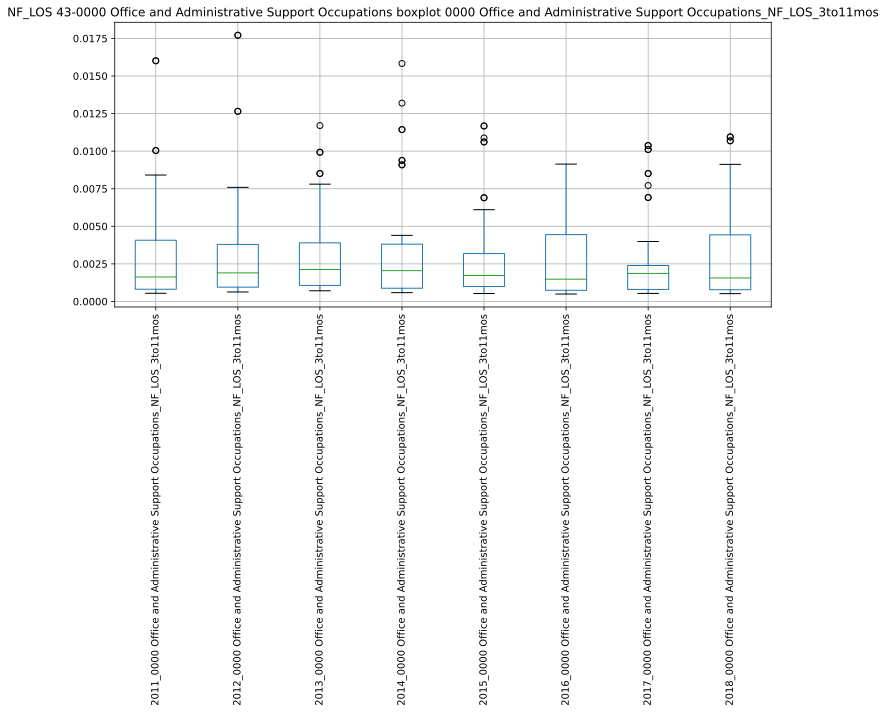

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234607.621561:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234607.651821:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234607.896204:INFO:headless_shell.cc(660)] Written to file /tmp/tmp0jbu3bhh/temp.png.
[1013/234608.118987:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234608.156939:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234608.437806:INFO:headless_shell.cc(660)] Written to file /tmp/tmpdzl8c2wx/temp.png.
[1013/234608.712447:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234608.753389:WARNI

,2011_0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,2012_0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,2013_0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,2014_0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,2015_0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,2016_0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,2017_0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,2018_0000 Office and Administrative Support Occupations_NF_LOS_3to11mos
2011_0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,1.000000,0.024598,-0.077298,-0.067911,-0.040140,0.091156,0.025314,0.130232
2012_0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,0.024598,1.000000,-0.094659,-0.044474,-0.099931,0.075117,0.103101,0.003142
2013_0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,-0.077298,-0.094659,1.000000,-0.252893,0.165755,-0.230512,-0.079228,-0.175581
2014_0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,-0.067911,-0.044474,-0.252893,1.000000,-0.041652,0.357884,-0.296706,0.150835
2015_0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,-0.040140,-0.099931,0.165755,-0.041652,1.000000,-0.025379,0.080008,0.030140
2016_0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,0.091156,0.075117,-0.230512,0.357884,-0.025379,1.000000,-0.214521,0.524344
2017_0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,0.025314,0.103101,-0.079228,-0.296706,0.080008,-0.214521,1.000000,-0.139072
2018_0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,0.130232,0.003142,-0.175581,0.150835,0.030140,0.524344,-0.139072,1.000000


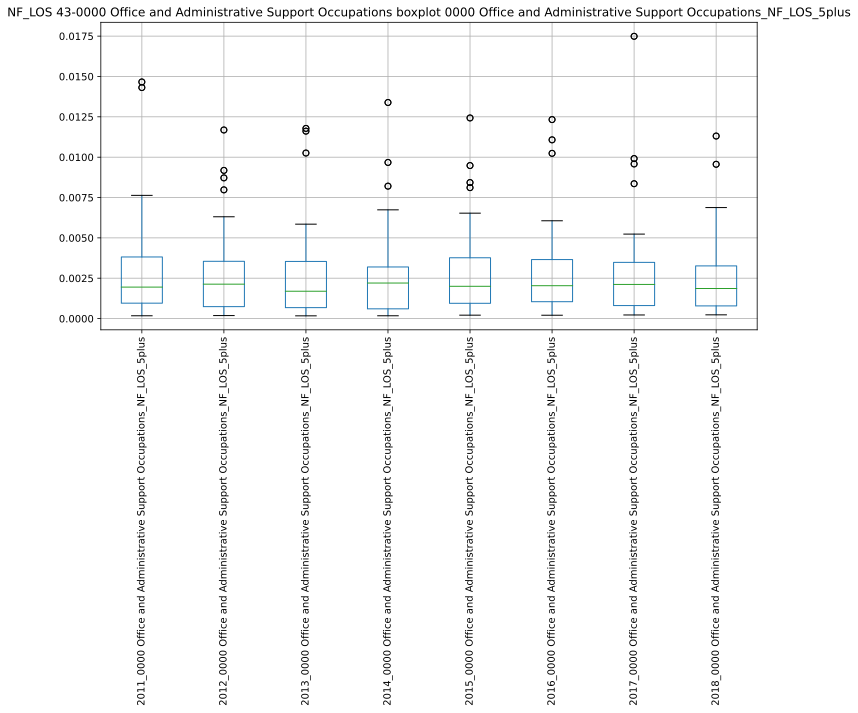

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234612.797486:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234612.840381:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234613.062193:INFO:headless_shell.cc(660)] Written to file /tmp/tmpjrcc4kf8/temp.png.
[1013/234613.278603:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234613.316537:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234613.621883:INFO:headless_shell.cc(660)] Written to file /tmp/tmp7zdoa61f/temp.png.
[1013/234613.891254:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234613.928352:WARNI

,2011_0000 Office and Administrative Support Occupations_NF_LOS_5plus,2012_0000 Office and Administrative Support Occupations_NF_LOS_5plus,2013_0000 Office and Administrative Support Occupations_NF_LOS_5plus,2014_0000 Office and Administrative Support Occupations_NF_LOS_5plus,2015_0000 Office and Administrative Support Occupations_NF_LOS_5plus,2016_0000 Office and Administrative Support Occupations_NF_LOS_5plus,2017_0000 Office and Administrative Support Occupations_NF_LOS_5plus,2018_0000 Office and Administrative Support Occupations_NF_LOS_5plus
2011_0000 Office and Administrative Support Occupations_NF_LOS_5plus,1.000000,0.246875,0.186948,0.789549,0.639253,0.614106,0.557989,-0.089601
2012_0000 Office and Administrative Support Occupations_NF_LOS_5plus,0.246875,1.000000,0.429203,0.551595,0.215250,0.070688,-0.113193,-0.112234
2013_0000 Office and Administrative Support Occupations_NF_LOS_5plus,0.186948,0.429203,1.000000,0.474875,0.136783,0.091785,-0.151548,-0.000707
2014_0000 Office and Administrative Support Occupations_NF_LOS_5plus,0.789549,0.551595,0.474875,1.000000,0.539958,0.508469,0.237969,-0.140592
2015_0000 Office and Administrative Support Occupations_NF_LOS_5plus,0.639253,0.215250,0.136783,0.539958,1.000000,0.883307,0.834921,0.018392
2016_0000 Office and Administrative Support Occupations_NF_LOS_5plus,0.614106,0.070688,0.091785,0.508469,0.883307,1.000000,0.785441,0.324672
2017_0000 Office and Administrative Support Occupations_NF_LOS_5plus,0.557989,-0.113193,-0.151548,0.237969,0.834921,0.785441,1.000000,0.076575
2018_0000 Office and Administrative Support Occupations_NF_LOS_5plus,-0.089601,-0.112234,-0.000707,-0.140592,0.018392,0.324672,0.076575,1.000000


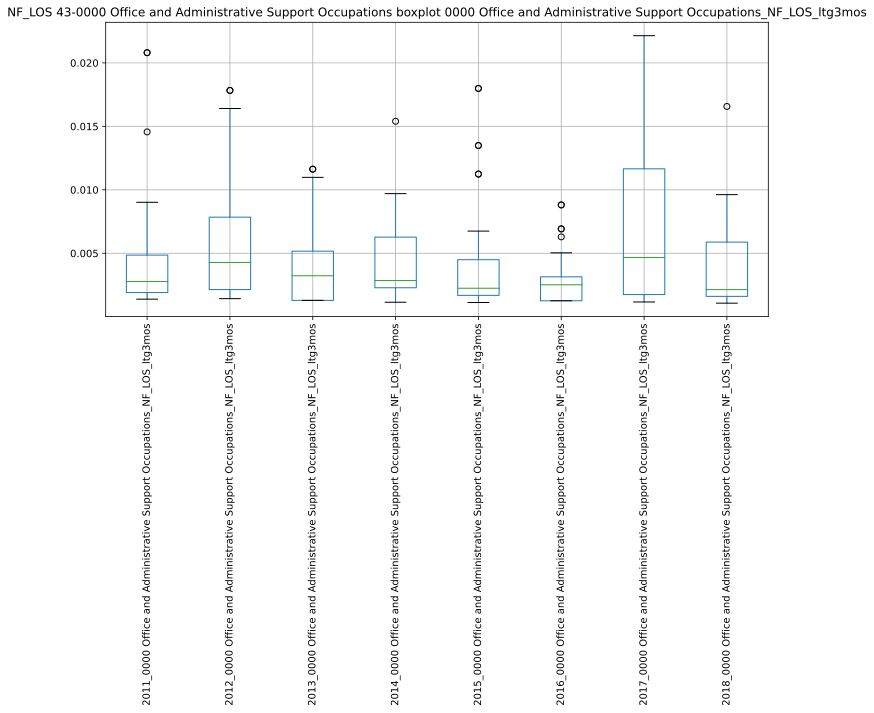

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234616.616735:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234616.655929:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234616.875950:INFO:headless_shell.cc(660)] Written to file /tmp/tmp44qr7252/temp.png.
[1013/234617.105258:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234617.147103:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234617.451525:INFO:headless_shell.cc(660)] Written to file /tmp/tmptcxmbjrp/temp.png.
[1013/234617.736041:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234617.764585:WARNI

,2011_0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,2012_0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,2013_0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,2014_0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,2015_0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,2016_0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,2017_0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,2018_0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos
2011_0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,1.000000,-0.251585,-0.214023,0.621032,-0.002504,0.105751,0.029209,0.007566
2012_0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,-0.251585,1.000000,0.028606,0.305861,0.160333,0.014662,0.228646,0.075418
2013_0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,-0.214023,0.028606,1.000000,-0.033057,-0.092550,0.368419,0.280982,0.317856
2014_0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,0.621032,0.305861,-0.033057,1.000000,-0.156187,0.113750,0.584199,0.147009
2015_0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,-0.002504,0.160333,-0.092550,-0.156187,1.000000,0.309122,-0.223290,-0.190200
2016_0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,0.105751,0.014662,0.368419,0.113750,0.309122,1.000000,0.453506,-0.128635
2017_0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,0.029209,0.228646,0.280982,0.584199,-0.223290,0.453506,1.000000,0.055436
2018_0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,0.007566,0.075418,0.317856,0.147009,-0.190200,-0.128635,0.055436,1.000000


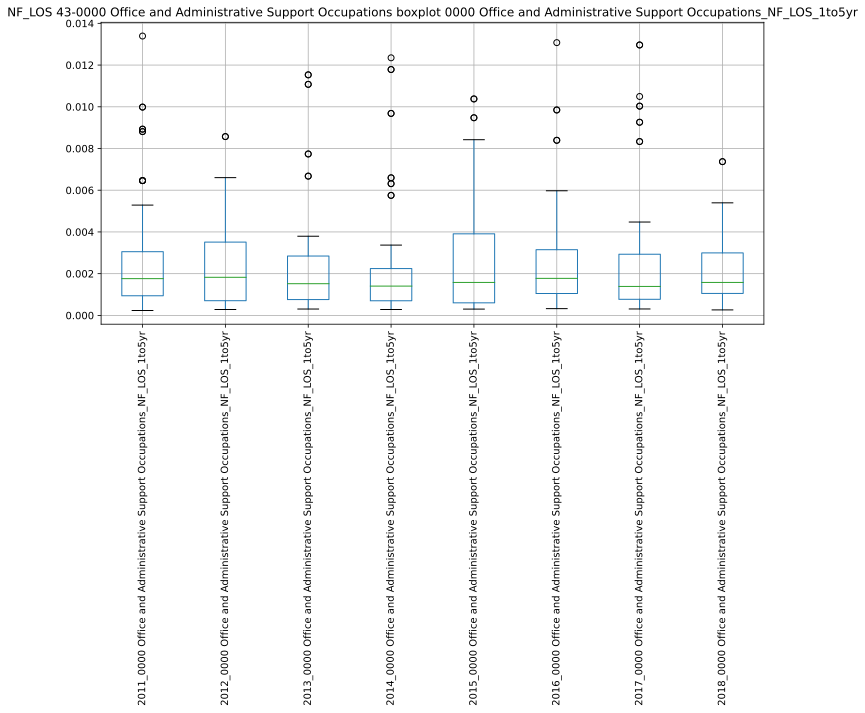

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234622.060911:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234622.099298:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234622.307725:INFO:headless_shell.cc(660)] Written to file /tmp/tmpqw7jej4p/temp.png.
[1013/234622.531948:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234622.569132:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234622.858480:INFO:headless_shell.cc(660)] Written to file /tmp/tmpp5z5yujh/temp.png.
[1013/234623.120678:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234623.159166:WARNI

,2011_0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,2012_0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,2013_0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,2014_0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,2015_0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,2016_0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,2017_0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,2018_0000 Office and Administrative Support Occupations_NF_LOS_1to5yr
2011_0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,1.000000,0.137875,0.189166,0.266512,0.102349,-0.098726,0.315931,0.001250
2012_0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,0.137875,1.000000,0.637571,0.314305,0.126268,0.181128,0.279677,0.209720
2013_0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,0.189166,0.637571,1.000000,0.104505,0.041749,0.068211,0.219242,-0.036749
2014_0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,0.266512,0.314305,0.104505,1.000000,0.574310,0.327768,0.616335,0.669021
2015_0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,0.102349,0.126268,0.041749,0.574310,1.000000,0.265136,0.449544,0.210401
2016_0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,-0.098726,0.181128,0.068211,0.327768,0.265136,1.000000,0.240123,0.355837
2017_0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,0.315931,0.279677,0.219242,0.616335,0.449544,0.240123,1.000000,0.239438
2018_0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,0.001250,0.209720,-0.036749,0.669021,0.210401,0.355837,0.239438,1.000000


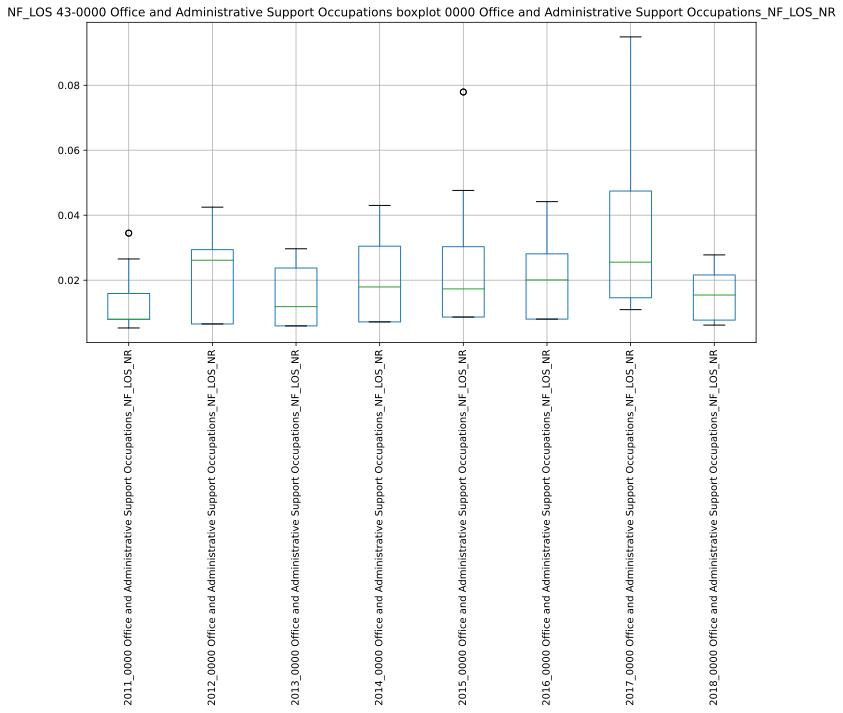

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234625.890063:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234625.934106:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234626.135006:INFO:headless_shell.cc(660)] Written to file /tmp/tmpy1b4y8l3/temp.png.
[1013/234626.343197:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234626.381391:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234626.689248:INFO:headless_shell.cc(660)] Written to file /tmp/tmp__gvy_wx/temp.png.
[1013/234626.945564:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234626.983561:WARNI

,2011_0000 Office and Administrative Support Occupations_NF_LOS_NR,2012_0000 Office and Administrative Support Occupations_NF_LOS_NR,2013_0000 Office and Administrative Support Occupations_NF_LOS_NR,2014_0000 Office and Administrative Support Occupations_NF_LOS_NR,2015_0000 Office and Administrative Support Occupations_NF_LOS_NR,2016_0000 Office and Administrative Support Occupations_NF_LOS_NR,2017_0000 Office and Administrative Support Occupations_NF_LOS_NR,2018_0000 Office and Administrative Support Occupations_NF_LOS_NR
2011_0000 Office and Administrative Support Occupations_NF_LOS_NR,1.000000,0.622950,0.249412,-0.281432,0.136379,-0.541732,-0.120718,0.173789
2012_0000 Office and Administrative Support Occupations_NF_LOS_NR,0.622950,1.000000,-0.558271,0.208465,0.213994,-0.469992,0.357540,0.609687
2013_0000 Office and Administrative Support Occupations_NF_LOS_NR,0.249412,-0.558271,1.000000,0.294189,0.208116,-0.026332,0.702351,0.142824
2014_0000 Office and Administrative Support Occupations_NF_LOS_NR,-0.281432,0.208465,0.294189,1.000000,0.217960,0.186933,0.722604,0.634622
2015_0000 Office and Administrative Support Occupations_NF_LOS_NR,0.136379,0.213994,0.208116,0.217960,1.000000,-0.149454,0.524605,0.385035
2016_0000 Office and Administrative Support Occupations_NF_LOS_NR,-0.541732,-0.469992,-0.026332,0.186933,-0.149454,1.000000,-0.179683,0.134299
2017_0000 Office and Administrative Support Occupations_NF_LOS_NR,-0.120718,0.357540,0.702351,0.722604,0.524605,-0.179683,1.000000,0.602465
2018_0000 Office and Administrative Support Occupations_NF_LOS_NR,0.173789,0.609687,0.142824,0.634622,0.385035,0.134299,0.602465,1.000000


########################################## CORRELATIONS ###############################################
['43-0000 Office and Administrative Support Occupations_NF_LOS_3to11mos', '43-0000 Office and Administrative Support Occupations_NF_LOS_5plus', '43-0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos', '43-0000 Office and Administrative Support Occupations_NF_LOS_1to5yr', '43-0000 Office and Administrative Support Occupations_NF_LOS_NR']


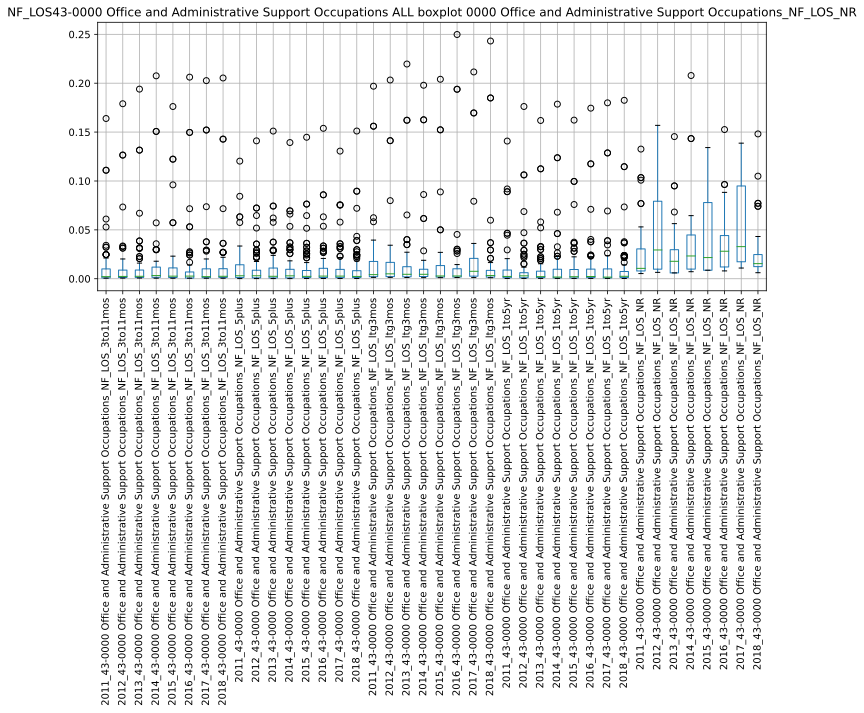

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234631.854661:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234631.894506:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234632.230846:INFO:headless_shell.cc(660)] Written to file /tmp/tmp8pomw5ka/temp.png.
[1013/234632.461368:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234632.498417:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234633.009427:INFO:headless_shell.cc(660)] Written to file /tmp/tmp5b2kdkpb/temp.png.
[1013/234633.326810:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234633.366759:WARNI

,2011_43-0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,2012_43-0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,2013_43-0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,2014_43-0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,2015_43-0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,2016_43-0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,2017_43-0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,2018_43-0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,2011_43-0000 Office and Administrative Support Occupations_NF_LOS_5plus,2012_43-0000 Office and Administrative Support Occupations_NF_LOS_5plus,2013_43-0000 Office and Administrative Support Occupations_NF_LOS_5plus,2014_43-0000 Office and Administrative Support Occupations_NF_LOS_5plus,2015_43-0000 Office and Administrative Support Occupations_NF_LOS_5plus,2016_43-0000 Office and Administrative Support Occupations_NF_LOS_5plus,2017_43-0000 Office and Administrative Support Occupations_NF_LOS_5plus,2018_43-0000 Office and Administrative Support Occupations_NF_LOS_5plus,2011_43-0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,2012_43-0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,2013_43-0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,2014_43-0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,2015_43-0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,2016_43-0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,2017_43-0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,2018_43-0000 Office and Administrative Support Occupations_NF_LOS_ltg3mos,2011_43-0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,2012_43-0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,2013_43-0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,2014_43-0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,2015_43-0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,2016_43-0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,2017_43-0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,2018_43-0000 Office and Administrative Support Occupations_NF_LOS_1to5yr,2011_43-0000 Office and Administrative Support Occupations_NF_LOS_NR,2012_43-0000 Office and Administrative Support Occupations_NF_LOS_NR,2013_43-0000 Office and Administrative Support Occupations_NF_LOS_NR,2014_43-0000 Office and Administrative Support Occupations_NF_LOS_NR,2015_43-0000 Office and Administrative Support Occupations_NF_LOS_NR,2016_43-0000 Office and Administrative Support Occupations_NF_LOS_NR,2017_43-0000 Office and Administrative Support Occupations_NF_LOS_NR,2018_43-0000 Office and Administrative Support Occupations_NF_LOS_NR
2011_43-0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,1.000000,0.074551,0.064750,-0.125846,-0.006318,-0.032512,0.246332,-0.104143,0.200790,0.015436,-0.054455,0.195836,0.051418,0.062188,0.015177,-0.073817,-0.099819,-0.072797,-0.086994,-0.066228,-0.079112,-0.075478,0.038487,-0.091864,-0.072003,0.224519,0.183037,-0.079271,-0.047026,-0.022615,-0.005101,-0.045442,-0.029176,0.483510,-0.251501,0.083618,-0.120697,-0.101686,-0.506526,-0.032666
2012_43-0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,0.074551,1.000000,0.007099,0.003276,-0.089424,0.069501,-0.026296,-0.006906,-0.110489,0.270715,0.104704,-0.101264,-0.101393,-0.086437,-0.102527,-0.077387,-0.136016,-0.123643,-0.092472,-0.095029,-0.110891,-0.120169,0.077093,-0.089710,0.006141,-0.081011,-0.099360,-0.069726,-0.026576,0.681615,-0.073785,-0.028639,-0.108651,0.173741,-0.249566,0.052544,-0.352456,-0.064948,-0.245912,-0.044064
2013_43-0000 Office and Administrative Support Occupations_NF_LOS_3to11mos,0.064750,0.007099,1.000000,-0.057464,0.414089,-0.064305,-0.001139,-0.083126,-0.035684,-0.082869,0

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
45-0000 Farming, Fishing, and Forestry Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
45-0000 Farming, Fishing, and Forestry Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
45-0000 Farming, Fishing, and Forestry Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
####

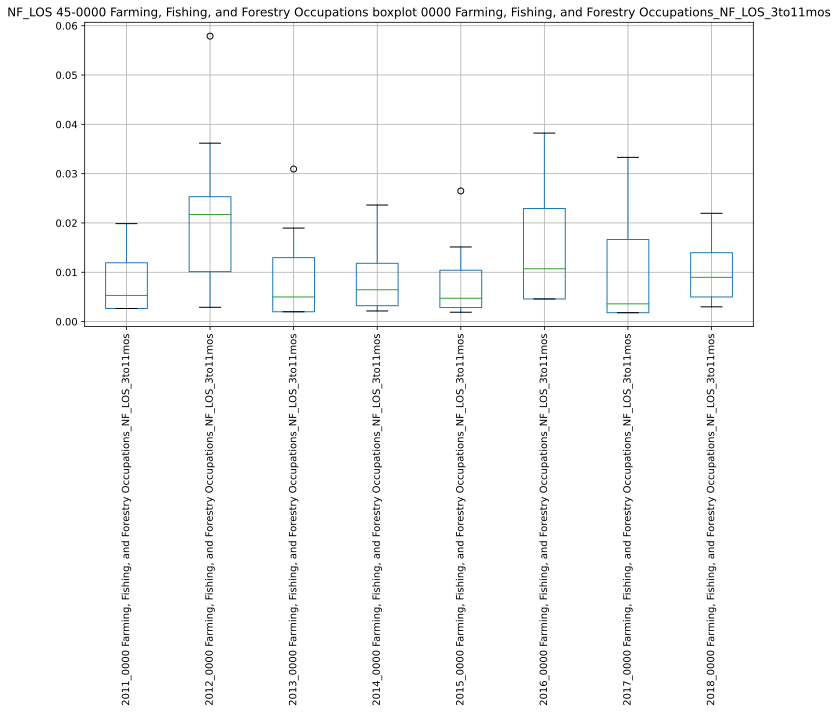

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234713.018415:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234713.055321:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234713.273746:INFO:headless_shell.cc(660)] Written to file /tmp/tmpblo03pbm/temp.png.
[1013/234713.496131:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234713.532965:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234713.822025:INFO:headless_shell.cc(660)] Written to file /tmp/tmpl_d1h67y/temp.png.
[1013/234714.089341:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234714.131660:WARNI

,"2011_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos","2012_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos","2013_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos","2014_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos","2015_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos","2016_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos","2017_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos","2018_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos"
"2011_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos",1.000000,0.309423,0.532076,-0.192753,0.332934,-0.318528,-0.040233,0.783188
"2012_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos",0.309423,1.000000,0.456295,0.097717,0.429457,-0.054435,0.384337,0.420391
"2013_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos",0.532076,0.456295,1.000000,0.491021,0.814693,-0.178382,0.275928,0.666885
"2014_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos",-0.192753,0.097717,0.491021,1.000000,0.910692,0.399131,0.647691,0.134248
"2015_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos",0.332934,0.429457,0.814693,0.910692,1.000000,-0.331486,0.407497,0.623679
"2016_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos",-0.318528,-0.054435,-0.178382,0.399131,-0.331486,1.000000,0.449856,-0.206387
"2017_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos",-0.040233,0.384337,0.275928,0.647691,0.407497,0.449856,1.000000,0.101945
"2018_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos",0.783188,0.420391,0.666885,0.134248,0.623679,-0.206387,0.101945,1.000000


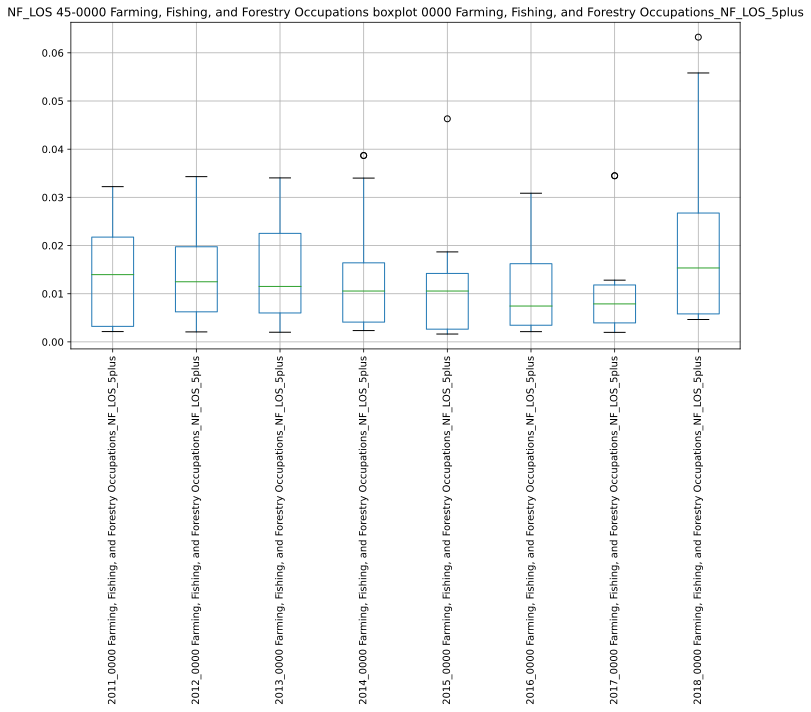

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234716.876505:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234716.914389:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234717.166784:INFO:headless_shell.cc(660)] Written to file /tmp/tmp06o62k9s/temp.png.
[1013/234717.399306:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234717.440099:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234717.752507:INFO:headless_shell.cc(660)] Written to file /tmp/tmp4tgjtjhu/temp.png.
[1013/234718.030527:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234718.078679:WARNI

,"2011_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus","2012_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus","2013_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus","2014_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus","2015_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus","2016_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus","2017_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus","2018_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus"
"2011_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus",1.000000,0.601270,0.883135,0.651419,0.234527,0.695546,0.763100,0.590215
"2012_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus",0.601270,1.000000,0.219917,0.533403,0.232615,0.472135,0.617793,-0.038238
"2013_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus",0.883135,0.219917,1.000000,0.391720,0.025534,0.359792,0.436671,0.269432
"2014_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus",0.651419,0.533403,0.391720,1.000000,0.730528,0.937087,0.861851,0.312329
"2015_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus",0.234527,0.232615,0.025534,0.730528,1.000000,0.772007,0.651034,0.291994
"2016_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus",0.695546,0.472135,0.359792,0.937087,0.772007,1.000000,0.822865,0.460340
"2017_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus",0.763100,0.617793,0.436671,0.861851,0.651034,0.822865,1.000000,-0.047413
"2018_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus",0.590215,-0.038238,0.269432,0.312329,0.291994,0.460340,-0.047413,1.000000


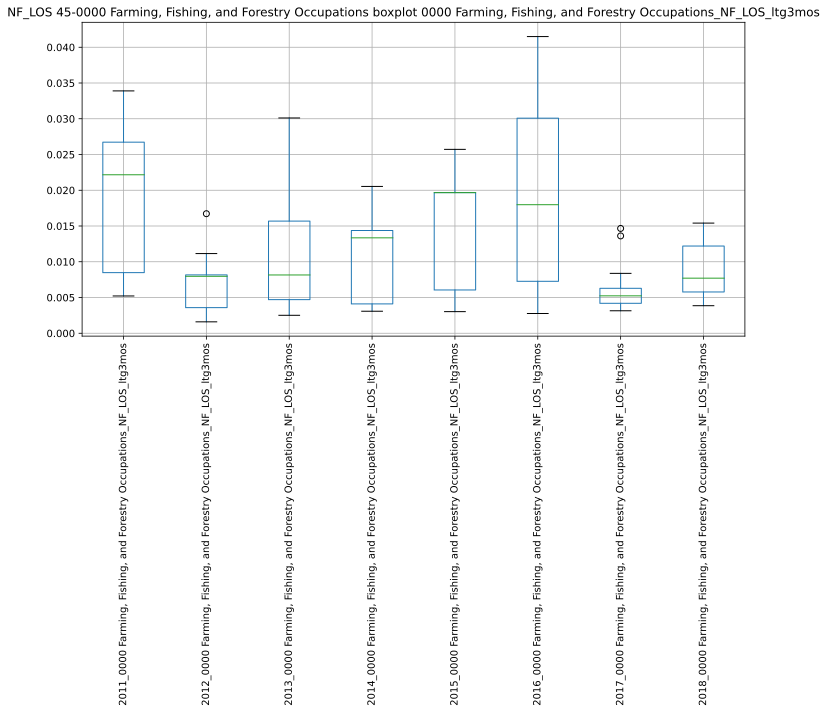

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234720.804160:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234720.842071:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234721.047596:INFO:headless_shell.cc(660)] Written to file /tmp/tmptq5xdk82/temp.png.
[1013/234721.280178:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234721.320886:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234721.614695:INFO:headless_shell.cc(660)] Written to file /tmp/tmp17gl5r5x/temp.png.
[1013/234721.874034:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234721.915689:WARNI

,"2011_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos","2012_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos","2013_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos","2014_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos","2015_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos","2016_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos","2017_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos","2018_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos"
"2011_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos",1.000000,-0.571731,0.029560,0.243980,0.423601,-0.088581,0.676517,0.733699
"2012_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos",-0.571731,1.000000,-0.066775,-0.687680,-0.361362,0.114953,0.491790,-0.663057
"2013_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos",0.029560,-0.066775,1.000000,0.433610,-0.062257,-0.459243,-0.444425,0.342010
"2014_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos",0.243980,-0.687680,0.433610,1.000000,0.363211,-0.712100,-0.126504,0.407331
"2015_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos",0.423601,-0.361362,-0.062257,0.363211,1.000000,0.344789,0.454221,0.249029
"2016_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos",-0.088581,0.114953,-0.459243,-0.712100,0.344789,1.000000,0.346759,-0.199614
"2017_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos",0.676517,0.491790,-0.444425,-0.126504,0.454221,0.346759,1.000000,-0.154475
"2018_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos",0.733699,-0.663057,0.342010,0.407331,0.249029,-0.199614,-0.154475,1.000000


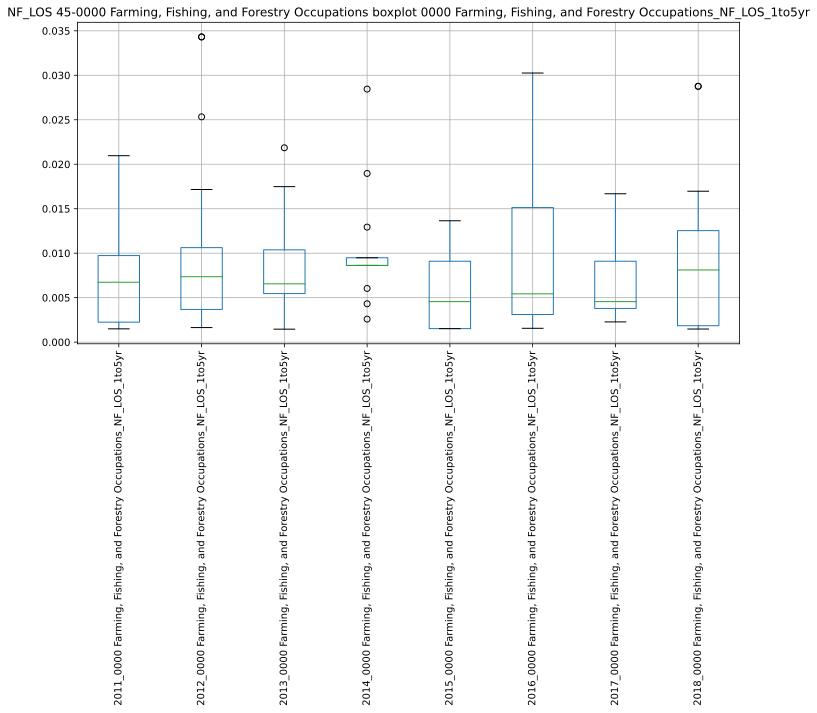

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234724.798471:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234724.838302:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234725.062484:INFO:headless_shell.cc(660)] Written to file /tmp/tmpl38_iyeh/temp.png.
[1013/234725.283491:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234725.326875:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234725.626591:INFO:headless_shell.cc(660)] Written to file /tmp/tmpbac_6x5p/temp.png.
[1013/234725.906529:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234725.945906:WARNI

,"2011_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr","2012_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr","2013_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr","2014_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr","2015_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr","2016_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr","2017_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr","2018_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr"
"2011_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr",1.000000,0.083375,0.050580,-0.047492,0.200720,0.356155,-0.028186,0.180055
"2012_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr",0.083375,1.000000,-0.225759,-0.042845,-0.216544,0.231774,0.265508,0.805934
"2013_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr",0.050580,-0.225759,1.000000,0.906126,-0.197573,-0.409856,0.440667,-0.386830
"2014_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr",-0.047492,-0.042845,0.906126,1.000000,-0.168725,-0.310683,0.195928,-0.202454
"2015_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr",0.200720,-0.216544,-0.197573,-0.168725,1.000000,-0.426332,0.140025,-0.331040
"2016_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr",0.356155,0.231774,-0.409856,-0.310683,-0.426332,1.000000,-0.062062,0.547570
"2017_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr",-0.028186,0.265508,0.440667,0.195928,0.140025,-0.062062,1.000000,0.138986
"2018_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr",0.180055,0.805934,-0.386830,-0.202454,-0.331040,0.547570,0.138986,1.000000


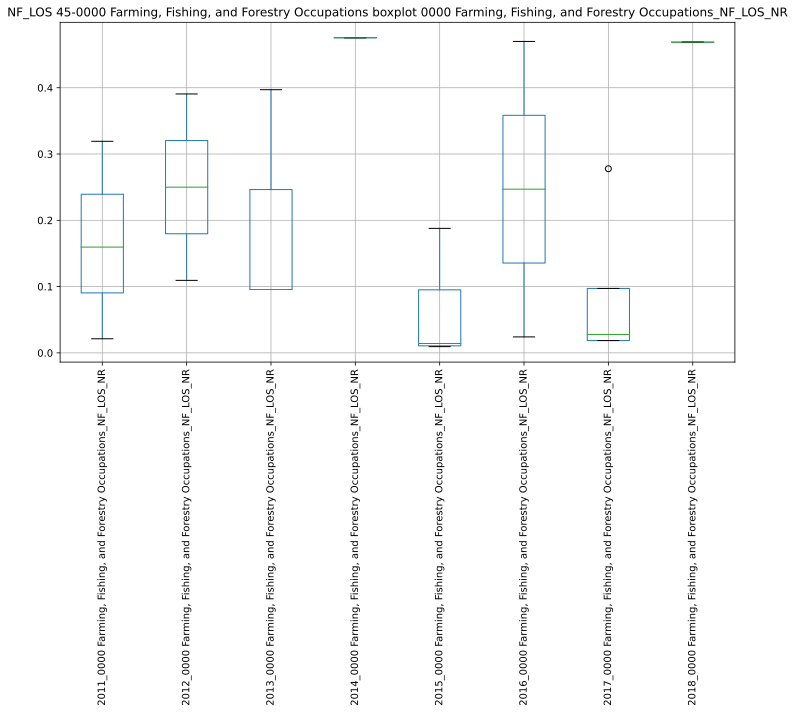

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234728.614638:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234728.652379:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234728.885144:INFO:headless_shell.cc(660)] Written to file /tmp/tmpznytltw5/temp.png.
[1013/234729.110452:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234729.150278:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234729.451883:INFO:headless_shell.cc(660)] Written to file /tmp/tmp0ot71mnj/temp.png.
[1013/234729.720178:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234729.761679:WARNI

,"2011_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR","2012_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR","2013_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR","2014_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR","2015_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR","2016_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR","2017_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR","2018_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR"
"2011_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR",1.000000,-1.000000,1.000000,nan,1.000000,-1.000000,nan,nan
"2012_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR",-1.000000,1.000000,nan,nan,nan,1.000000,nan,nan
"2013_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR",1.000000,nan,1.000000,nan,1.000000,nan,nan,nan
"2014_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR",nan,nan,nan,nan,nan,nan,nan,nan
"2015_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR",1.000000,nan,1.000000,nan,1.000000,nan,1.000000,nan
"2016_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR",-1.000000,1.000000,nan,nan,nan,1.000000,nan,nan
"2017_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR",nan,nan,nan,nan,1.000000,nan,1.000000,nan
"2018_0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR",nan,nan,nan,nan,nan,nan,nan,nan


########################################## CORRELATIONS ###############################################
['45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos', '45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus', '45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos', '45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr', '45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR']


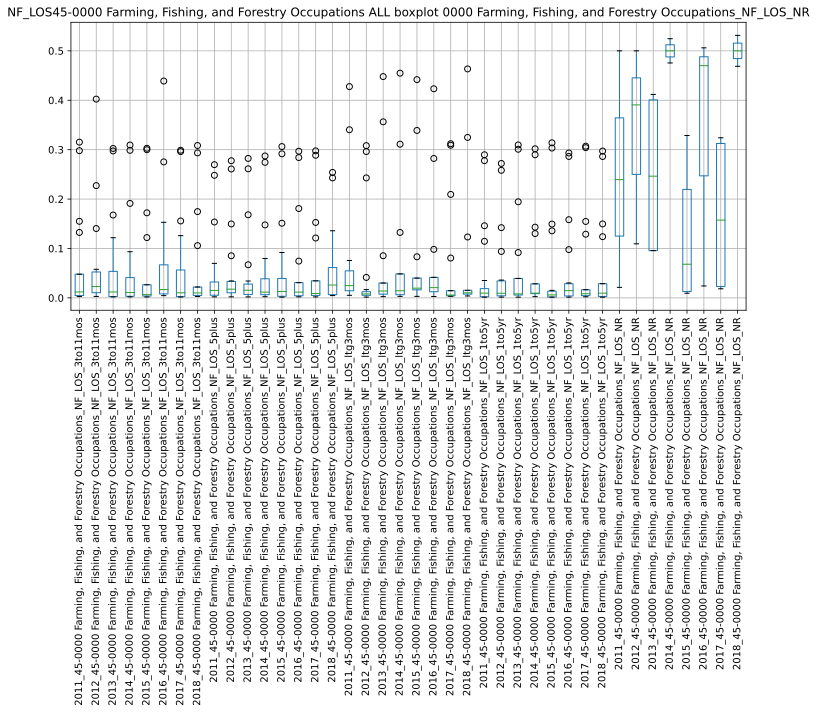

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234734.477801:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234734.519646:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234734.846030:INFO:headless_shell.cc(660)] Written to file /tmp/tmpygq04vuz/temp.png.
[1013/234735.078353:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234735.120503:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234735.658283:INFO:headless_shell.cc(660)] Written to file /tmp/tmpbzuk3wjx/temp.png.
[1013/234735.975115:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234736.013179:WARNI

,"2011_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos","2012_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos","2013_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos","2014_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos","2015_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos","2016_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos","2017_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos","2018_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos","2011_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus","2012_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus","2013_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus","2014_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus","2015_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus","2016_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus","2017_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus","2018_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_5plus","2011_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos","2012_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos","2013_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos","2014_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos","2015_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos","2016_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos","2017_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos","2018_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_ltg3mos","2011_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr","2012_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr","2013_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr","2014_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr","2015_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr","2016_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr","2017_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr","2018_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_1to5yr","2011_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR","2012_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR","2013_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR","2014_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR","2015_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR","2016_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR","2017_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR","2018_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_NR"
"2011_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos",1.000000,0.691522,0.996769,0.522476,0.996363,0.614658,0.993464,0.996094,0.250111,0.542975,0.252820,0.549544,0.580210,0.533607,0.992553,0.512422,0.451806,0.954748,0.511624,0.587452,0.494475,0.534977,0.983063,0.571232,0.546939,0.252476,0.989838,0.998928,0.998519,0.538990,0.997777,0.530505,0.216769,-0.962472,0.626750,nan,0.886386,-0.997731,0.110649,nan
"2012_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos",0.691522,1.000000,0.666994,0.493406,0.663360,0.988043,0.662788,0.693177,0.422505,0.504708,0.423415,0.502713,0.518900,0.496093,0.674327,0.494434,0.961305,0.664432,0.968195,0.986076,0.966113,0.975283,0.667447,0.983875,0.513559,0.408993,0.676408,0.684416,0.684865,0.499389,0.669280,0.500636,0.222570,-0.962472,0.607272,nan,0.595447,-0.997731,0.555872,nan
"2013_45-0000 Farming, Fishing, and Forestry Occupations_NF_LOS_3to11mos",0.996769,0.666994,1.000000,0.535044,0.998994,0.584475,0.994025,0.997333,0.241863,0.553777,0.244302,0.560248,0.590130,0.541858,0.990388,0.522476,0.421642,0.964508,0.479355,0.556435,0.460244,0.499570,0.988419,0.

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
47-0000 Construction and Extraction Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
47-0000 Construction and Extraction Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
47-0000 Construction and Extraction Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ 

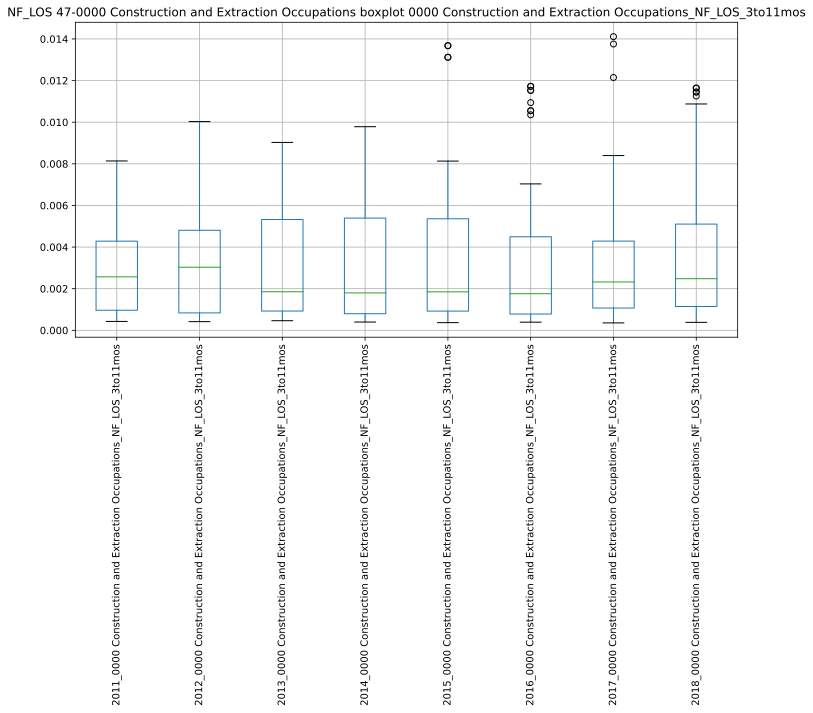

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234815.838701:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234815.876931:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234816.106960:INFO:headless_shell.cc(660)] Written to file /tmp/tmpfkqncuvx/temp.png.
[1013/234816.333654:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234816.371467:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234816.669336:INFO:headless_shell.cc(660)] Written to file /tmp/tmpneqbo16l/temp.png.
[1013/234816.937987:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234816.978947:WARNI

,2011_0000 Construction and Extraction Occupations_NF_LOS_3to11mos,2012_0000 Construction and Extraction Occupations_NF_LOS_3to11mos,2013_0000 Construction and Extraction Occupations_NF_LOS_3to11mos,2014_0000 Construction and Extraction Occupations_NF_LOS_3to11mos,2015_0000 Construction and Extraction Occupations_NF_LOS_3to11mos,2016_0000 Construction and Extraction Occupations_NF_LOS_3to11mos,2017_0000 Construction and Extraction Occupations_NF_LOS_3to11mos,2018_0000 Construction and Extraction Occupations_NF_LOS_3to11mos
2011_0000 Construction and Extraction Occupations_NF_LOS_3to11mos,1.000000,0.212352,0.379109,0.406136,0.474443,0.039049,0.341548,0.303806
2012_0000 Construction and Extraction Occupations_NF_LOS_3to11mos,0.212352,1.000000,0.284776,0.357184,0.219486,0.337329,0.367437,0.287938
2013_0000 Construction and Extraction Occupations_NF_LOS_3to11mos,0.379109,0.284776,1.000000,0.095062,0.409637,0.037824,0.380058,0.237208
2014_0000 Construction and Extraction Occupations_NF_LOS_3to11mos,0.406136,0.357184,0.095062,1.000000,0.224555,0.102757,0.342969,0.433286
2015_0000 Construction and Extraction Occupations_NF_LOS_3to11mos,0.474443,0.219486,0.409637,0.224555,1.000000,0.261282,0.178266,0.002881
2016_0000 Construction and Extraction Occupations_NF_LOS_3to11mos,0.039049,0.337329,0.037824,0.102757,0.261282,1.000000,0.126173,-0.199409
2017_0000 Construction and Extraction Occupations_NF_LOS_3to11mos,0.341548,0.367437,0.380058,0.342969,0.178266,0.126173,1.000000,0.113425
2018_0000 Construction and Extraction Occupations_NF_LOS_3to11mos,0.303806,0.287938,0.237208,0.433286,0.002881,-0.199409,0.113425,1.000000


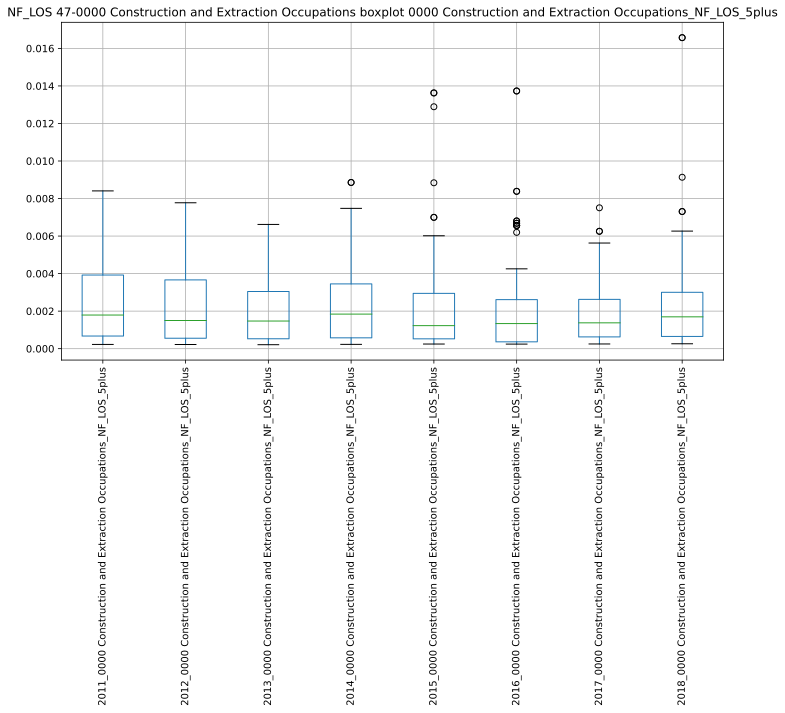

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234819.738692:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234819.779220:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234820.005134:INFO:headless_shell.cc(660)] Written to file /tmp/tmpwqocbz9b/temp.png.
[1013/234820.234148:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234820.273693:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234820.573651:INFO:headless_shell.cc(660)] Written to file /tmp/tmpuzzp8gma/temp.png.
[1013/234820.830880:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234820.869233:WARNI

,2011_0000 Construction and Extraction Occupations_NF_LOS_5plus,2012_0000 Construction and Extraction Occupations_NF_LOS_5plus,2013_0000 Construction and Extraction Occupations_NF_LOS_5plus,2014_0000 Construction and Extraction Occupations_NF_LOS_5plus,2015_0000 Construction and Extraction Occupations_NF_LOS_5plus,2016_0000 Construction and Extraction Occupations_NF_LOS_5plus,2017_0000 Construction and Extraction Occupations_NF_LOS_5plus,2018_0000 Construction and Extraction Occupations_NF_LOS_5plus
2011_0000 Construction and Extraction Occupations_NF_LOS_5plus,1.000000,0.119011,0.385045,0.389382,0.346092,0.383705,0.493696,0.408063
2012_0000 Construction and Extraction Occupations_NF_LOS_5plus,0.119011,1.000000,0.501010,0.638068,-0.021808,-0.031468,0.179537,-0.197713
2013_0000 Construction and Extraction Occupations_NF_LOS_5plus,0.385045,0.501010,1.000000,0.637572,0.268699,0.040591,0.543448,-0.117559
2014_0000 Construction and Extraction Occupations_NF_LOS_5plus,0.389382,0.638068,0.637572,1.000000,0.213389,0.001852,0.497579,-0.129798
2015_0000 Construction and Extraction Occupations_NF_LOS_5plus,0.346092,-0.021808,0.268699,0.213389,1.000000,0.585601,0.492558,0.528841
2016_0000 Construction and Extraction Occupations_NF_LOS_5plus,0.383705,-0.031468,0.040591,0.001852,0.585601,1.000000,0.153712,0.814440
2017_0000 Construction and Extraction Occupations_NF_LOS_5plus,0.493696,0.179537,0.543448,0.497579,0.492558,0.153712,1.000000,0.147075
2018_0000 Construction and Extraction Occupations_NF_LOS_5plus,0.408063,-0.197713,-0.117559,-0.129798,0.528841,0.814440,0.147075,1.000000


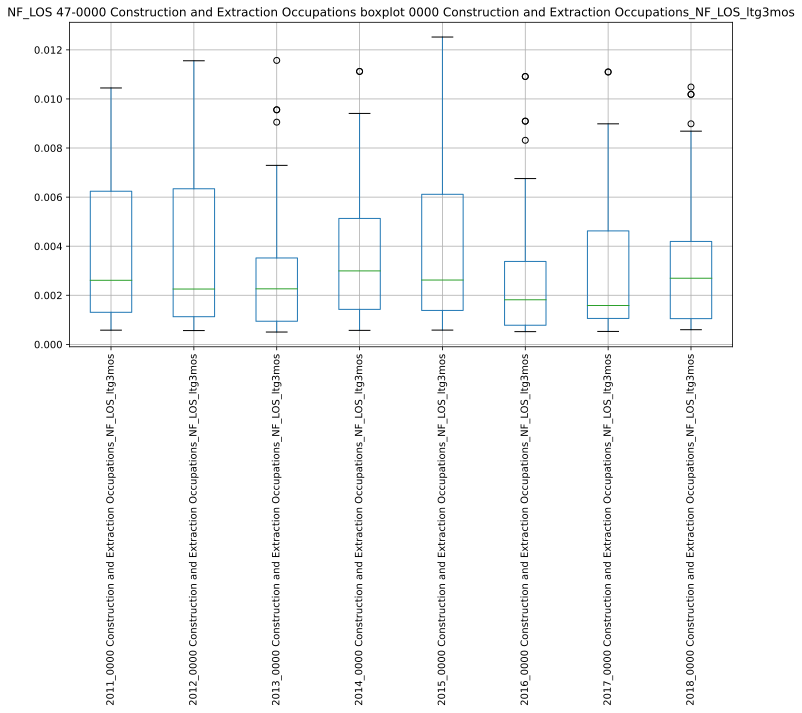

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234823.586429:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234823.628458:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234823.860800:INFO:headless_shell.cc(660)] Written to file /tmp/tmpz97eza0z/temp.png.
[1013/234824.072938:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234824.112124:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234824.412994:INFO:headless_shell.cc(660)] Written to file /tmp/tmpcyalt9g4/temp.png.
[1013/234824.684184:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234824.729448:WARNI

,2011_0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,2012_0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,2013_0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,2014_0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,2015_0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,2016_0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,2017_0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,2018_0000 Construction and Extraction Occupations_NF_LOS_ltg3mos
2011_0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,1.000000,-0.210977,0.124624,0.299516,0.104830,0.131478,0.198423,-0.148740
2012_0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,-0.210977,1.000000,-0.067559,-0.003245,0.343825,0.274650,0.055766,0.210294
2013_0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,0.124624,-0.067559,1.000000,-0.157663,0.260582,0.103618,-0.229954,-0.042513
2014_0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,0.299516,-0.003245,-0.157663,1.000000,0.121315,-0.109607,-0.000507,0.061528
2015_0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,0.104830,0.343825,0.260582,0.121315,1.000000,0.096202,-0.218853,-0.062322
2016_0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,0.131478,0.274650,0.103618,-0.109607,0.096202,1.000000,0.163295,-0.129408
2017_0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,0.198423,0.055766,-0.229954,-0.000507,-0.218853,0.163295,1.000000,-0.159809
2018_0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,-0.148740,0.210294,-0.042513,0.061528,-0.062322,-0.129408,-0.159809,1.000000


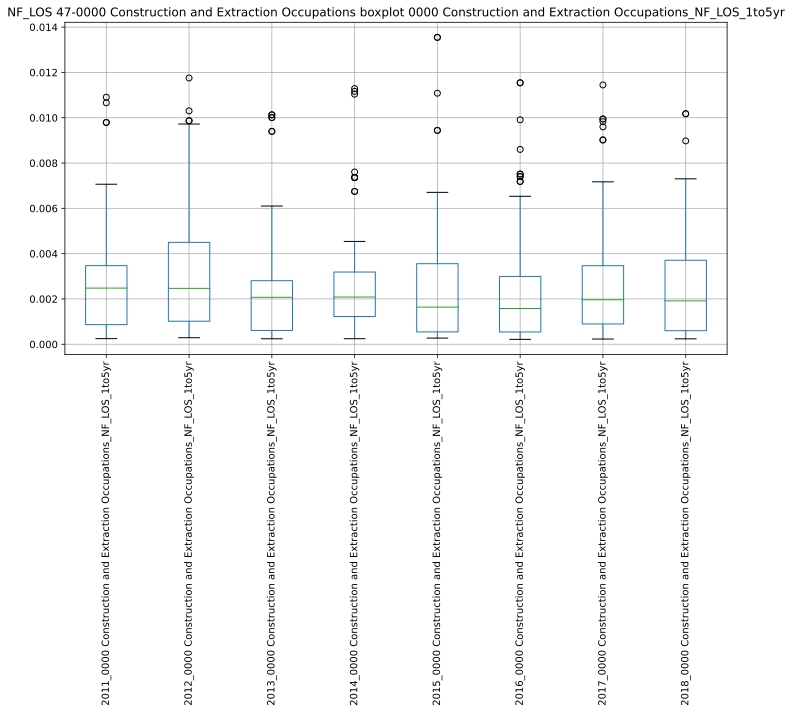

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234827.635485:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234827.674388:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234827.906217:INFO:headless_shell.cc(660)] Written to file /tmp/tmp1kebvkkh/temp.png.
[1013/234828.134749:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234828.173346:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234828.467837:INFO:headless_shell.cc(660)] Written to file /tmp/tmpvcm8aw58/temp.png.
[1013/234828.721705:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234828.769669:WARNI

,2011_0000 Construction and Extraction Occupations_NF_LOS_1to5yr,2012_0000 Construction and Extraction Occupations_NF_LOS_1to5yr,2013_0000 Construction and Extraction Occupations_NF_LOS_1to5yr,2014_0000 Construction and Extraction Occupations_NF_LOS_1to5yr,2015_0000 Construction and Extraction Occupations_NF_LOS_1to5yr,2016_0000 Construction and Extraction Occupations_NF_LOS_1to5yr,2017_0000 Construction and Extraction Occupations_NF_LOS_1to5yr,2018_0000 Construction and Extraction Occupations_NF_LOS_1to5yr
2011_0000 Construction and Extraction Occupations_NF_LOS_1to5yr,1.000000,0.258180,-0.071825,0.549350,0.085923,0.472446,-0.054655,-0.266536
2012_0000 Construction and Extraction Occupations_NF_LOS_1to5yr,0.258180,1.000000,0.372156,0.551222,0.453936,0.516155,0.020812,0.152928
2013_0000 Construction and Extraction Occupations_NF_LOS_1to5yr,-0.071825,0.372156,1.000000,0.507100,0.403848,0.279536,0.196044,0.032957
2014_0000 Construction and Extraction Occupations_NF_LOS_1to5yr,0.549350,0.551222,0.507100,1.000000,0.271981,0.761328,0.139107,0.023220
2015_0000 Construction and Extraction Occupations_NF_LOS_1to5yr,0.085923,0.453936,0.403848,0.271981,1.000000,0.273031,0.227593,0.125513
2016_0000 Construction and Extraction Occupations_NF_LOS_1to5yr,0.472446,0.516155,0.279536,0.761328,0.273031,1.000000,-0.028828,-0.193271
2017_0000 Construction and Extraction Occupations_NF_LOS_1to5yr,-0.054655,0.020812,0.196044,0.139107,0.227593,-0.028828,1.000000,0.569122
2018_0000 Construction and Extraction Occupations_NF_LOS_1to5yr,-0.266536,0.152928,0.032957,0.023220,0.125513,-0.193271,0.569122,1.000000


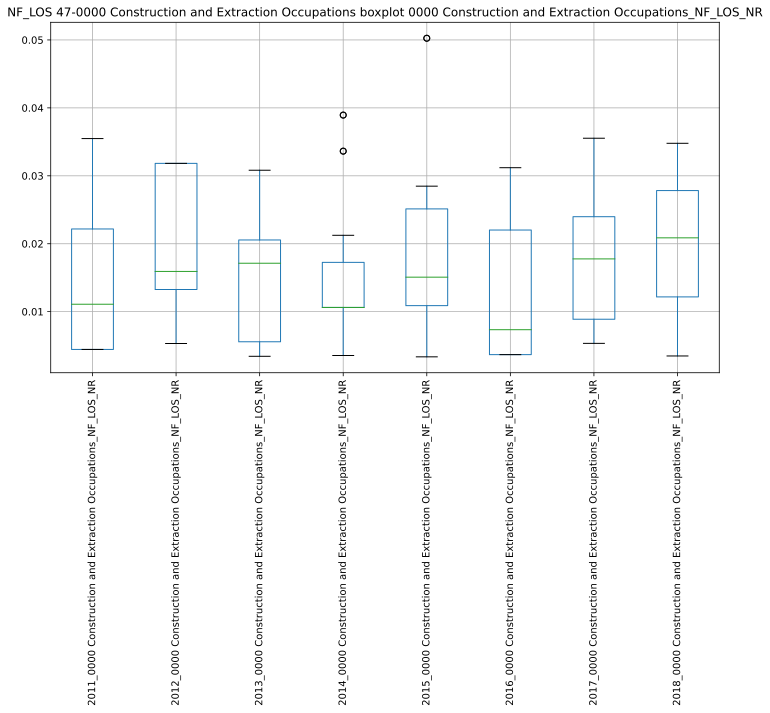

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234831.413852:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234831.451966:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234831.666855:INFO:headless_shell.cc(660)] Written to file /tmp/tmpme_zq0pz/temp.png.
[1013/234831.874830:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234831.928538:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234832.231384:INFO:headless_shell.cc(660)] Written to file /tmp/tmpe2e99ngq/temp.png.
[1013/234832.502063:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234832.542613:WARNI

,2011_0000 Construction and Extraction Occupations_NF_LOS_NR,2012_0000 Construction and Extraction Occupations_NF_LOS_NR,2013_0000 Construction and Extraction Occupations_NF_LOS_NR,2014_0000 Construction and Extraction Occupations_NF_LOS_NR,2015_0000 Construction and Extraction Occupations_NF_LOS_NR,2016_0000 Construction and Extraction Occupations_NF_LOS_NR,2017_0000 Construction and Extraction Occupations_NF_LOS_NR,2018_0000 Construction and Extraction Occupations_NF_LOS_NR
2011_0000 Construction and Extraction Occupations_NF_LOS_NR,1.000000,0.835279,-0.370735,-0.088350,0.112088,-0.097967,-0.454156,0.485994
2012_0000 Construction and Extraction Occupations_NF_LOS_NR,0.835279,1.000000,-0.197721,0.150122,-0.436123,0.331479,-0.000617,0.337772
2013_0000 Construction and Extraction Occupations_NF_LOS_NR,-0.370735,-0.197721,1.000000,-0.248390,-0.046005,0.178135,0.473098,-0.447438
2014_0000 Construction and Extraction Occupations_NF_LOS_NR,-0.088350,0.150122,-0.248390,1.000000,-0.015043,-0.262243,0.592534,0.665603
2015_0000 Construction and Extraction Occupations_NF_LOS_NR,0.112088,-0.436123,-0.046005,-0.015043,1.000000,-0.228624,0.466828,0.339833
2016_0000 Construction and Extraction Occupations_NF_LOS_NR,-0.097967,0.331479,0.178135,-0.262243,-0.228624,1.000000,-0.022144,-0.109617
2017_0000 Construction and Extraction Occupations_NF_LOS_NR,-0.454156,-0.000617,0.473098,0.592534,0.466828,-0.022144,1.000000,0.562431
2018_0000 Construction and Extraction Occupations_NF_LOS_NR,0.485994,0.337772,-0.447438,0.665603,0.339833,-0.109617,0.562431,1.000000


########################################## CORRELATIONS ###############################################
['47-0000 Construction and Extraction Occupations_NF_LOS_3to11mos', '47-0000 Construction and Extraction Occupations_NF_LOS_5plus', '47-0000 Construction and Extraction Occupations_NF_LOS_ltg3mos', '47-0000 Construction and Extraction Occupations_NF_LOS_1to5yr', '47-0000 Construction and Extraction Occupations_NF_LOS_NR']


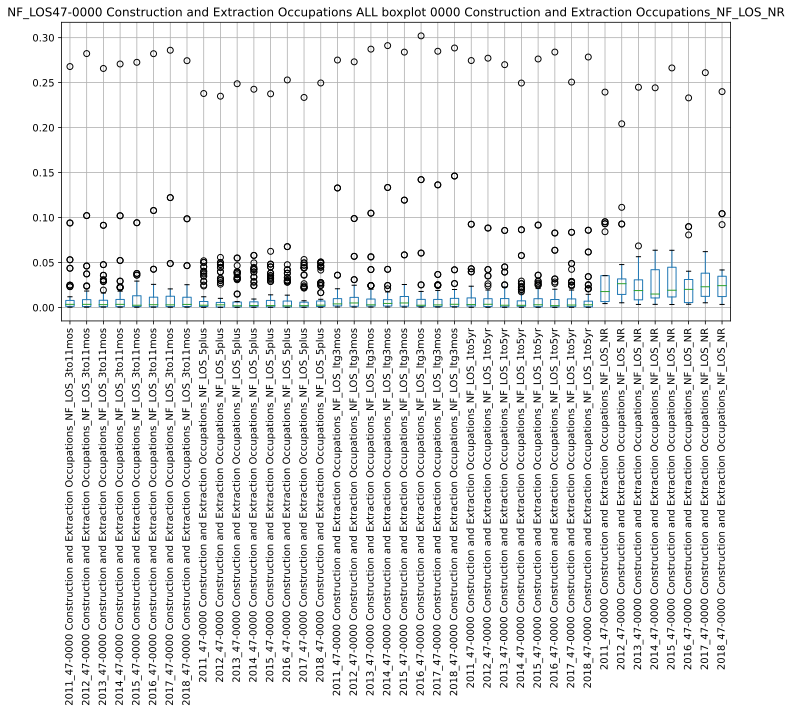

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234837.194516:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234837.233514:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234837.563210:INFO:headless_shell.cc(660)] Written to file /tmp/tmphg8l01a9/temp.png.
[1013/234837.794911:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234837.833982:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234838.338501:INFO:headless_shell.cc(660)] Written to file /tmp/tmp_775c6_x/temp.png.
[1013/234838.658444:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234838.698776:WARNI

,2011_47-0000 Construction and Extraction Occupations_NF_LOS_3to11mos,2012_47-0000 Construction and Extraction Occupations_NF_LOS_3to11mos,2013_47-0000 Construction and Extraction Occupations_NF_LOS_3to11mos,2014_47-0000 Construction and Extraction Occupations_NF_LOS_3to11mos,2015_47-0000 Construction and Extraction Occupations_NF_LOS_3to11mos,2016_47-0000 Construction and Extraction Occupations_NF_LOS_3to11mos,2017_47-0000 Construction and Extraction Occupations_NF_LOS_3to11mos,2018_47-0000 Construction and Extraction Occupations_NF_LOS_3to11mos,2011_47-0000 Construction and Extraction Occupations_NF_LOS_5plus,2012_47-0000 Construction and Extraction Occupations_NF_LOS_5plus,2013_47-0000 Construction and Extraction Occupations_NF_LOS_5plus,2014_47-0000 Construction and Extraction Occupations_NF_LOS_5plus,2015_47-0000 Construction and Extraction Occupations_NF_LOS_5plus,2016_47-0000 Construction and Extraction Occupations_NF_LOS_5plus,2017_47-0000 Construction and Extraction Occupations_NF_LOS_5plus,2018_47-0000 Construction and Extraction Occupations_NF_LOS_5plus,2011_47-0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,2012_47-0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,2013_47-0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,2014_47-0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,2015_47-0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,2016_47-0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,2017_47-0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,2018_47-0000 Construction and Extraction Occupations_NF_LOS_ltg3mos,2011_47-0000 Construction and Extraction Occupations_NF_LOS_1to5yr,2012_47-0000 Construction and Extraction Occupations_NF_LOS_1to5yr,2013_47-0000 Construction and Extraction Occupations_NF_LOS_1to5yr,2014_47-0000 Construction and Extraction Occupations_NF_LOS_1to5yr,2015_47-0000 Construction and Extraction Occupations_NF_LOS_1to5yr,2016_47-0000 Construction and Extraction Occupations_NF_LOS_1to5yr,2017_47-0000 Construction and Extraction Occupations_NF_LOS_1to5yr,2018_47-0000 Construction and Extraction Occupations_NF_LOS_1to5yr,2011_47-0000 Construction and Extraction Occupations_NF_LOS_NR,2012_47-0000 Construction and Extraction Occupations_NF_LOS_NR,2013_47-0000 Construction and Extraction Occupations_NF_LOS_NR,2014_47-0000 Construction and Extraction Occupations_NF_LOS_NR,2015_47-0000 Construction and Extraction Occupations_NF_LOS_NR,2016_47-0000 Construction and Extraction Occupations_NF_LOS_NR,2017_47-0000 Construction and Extraction Occupations_NF_LOS_NR,2018_47-0000 Construction and Extraction Occupations_NF_LOS_NR
2011_47-0000 Construction and Extraction Occupations_NF_LOS_3to11mos,1.000000,0.869109,0.846338,0.980664,0.852769,0.934459,0.768069,0.878271,0.734298,0.699527,0.723420,0.723662,0.767256,0.721405,0.698587,0.763762,0.794179,0.873571,0.725717,0.816875,0.733746,0.780418,0.798928,0.802449,0.730419,0.728924,0.751983,0.696733,0.738988,0.733096,0.921264,0.849109,0.711245,0.716606,0.819855,0.759719,0.813189,0.766302,0.884442,0.805764
2012_47-0000 Construction and Extraction Occupations_NF_LOS_3to11mos,0.869109,1.000000,0.781848,0.859631,0.755233,0.874091,0.734736,0.764872,0.746189,0.717482,0.739272,0.728809,0.853348,0.730586,0.780208,0.856493,0.931886,0.756838,0.714160,0.725559,0.712100,0.922241,0.954331,0.715653,0.850542,0.747337,0.861134,0.744050,0.749137,0.752439,0.875790,0.964685,0.646179,0.650758,0.832670,0.762362,0.795581,0.709089,0.816162,0.714301
2013_47-0000 Construction and Extraction Occupations_NF_LOS_3to11mos,0.846338,0.781848,1.000000,0.843725,0.938163,0.853915,0.848670,0.938066,0.720095,0.709852,0.731818,0.719628,0.755215,0.725769,0.734601,0.748730,0.676734,0.940749,0.725416,0.958815,0.833802,0.670820,0.698056,0.945630,0.748231,0.745893,0.781071,0.742138,0.750436,0.731850,0.853114,0.792811,0.669392,0.684784,0.800214,0.771156,0.831307,0.740207,0.857185,0.745932
2014_47-0000 Construction and Extraction Occupat

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
49-0000 Installation, Maintenance, and Repair Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
49-0000 Installation, Maintenance, and Repair Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
49-0000 Installation, Maintenance, and Repair Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##

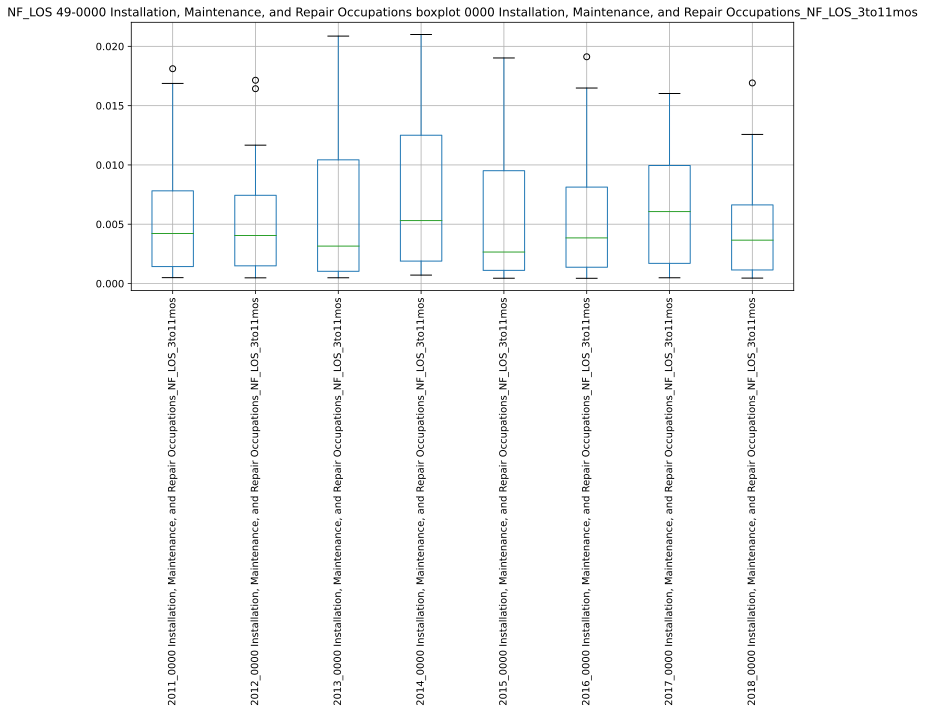

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234918.974283:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234919.012642:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234919.254317:INFO:headless_shell.cc(660)] Written to file /tmp/tmp2kfdtdj1/temp.png.
[1013/234919.484563:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234919.526265:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234919.817003:INFO:headless_shell.cc(660)] Written to file /tmp/tmpn1dp0ik_/temp.png.
[1013/234920.087537:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234920.124739:WARNI

,"2011_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos","2012_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos","2013_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos","2014_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos","2015_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos","2016_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos","2017_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos","2018_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos"
"2011_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos",1.000000,0.289953,0.071820,0.073689,-0.052217,0.420180,-0.299447,0.483717
"2012_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos",0.289953,1.000000,0.073109,-0.069925,-0.162131,0.606436,0.101940,0.302507
"2013_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos",0.071820,0.073109,1.000000,0.300958,0.503291,0.171381,0.298956,0.479533
"2014_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos",0.073689,-0.069925,0.300958,1.000000,0.101004,-0.010659,0.507808,0.301237
"2015_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos",-0.052217,-0.162131,0.503291,0.101004,1.000000,0.012339,0.705351,0.121529
"2016_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos",0.420180,0.606436,0.171381,-0.010659,0.012339,1.000000,0.265347,0.560291
"2017_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos",-0.299447,0.101940,0.298956,0.507808,0.705351,0.265347,1.000000,0.274608
"2018_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos",0.483717,0.302507,0.479533,0.301237,0.121529,0.560291,0.274608,1.000000


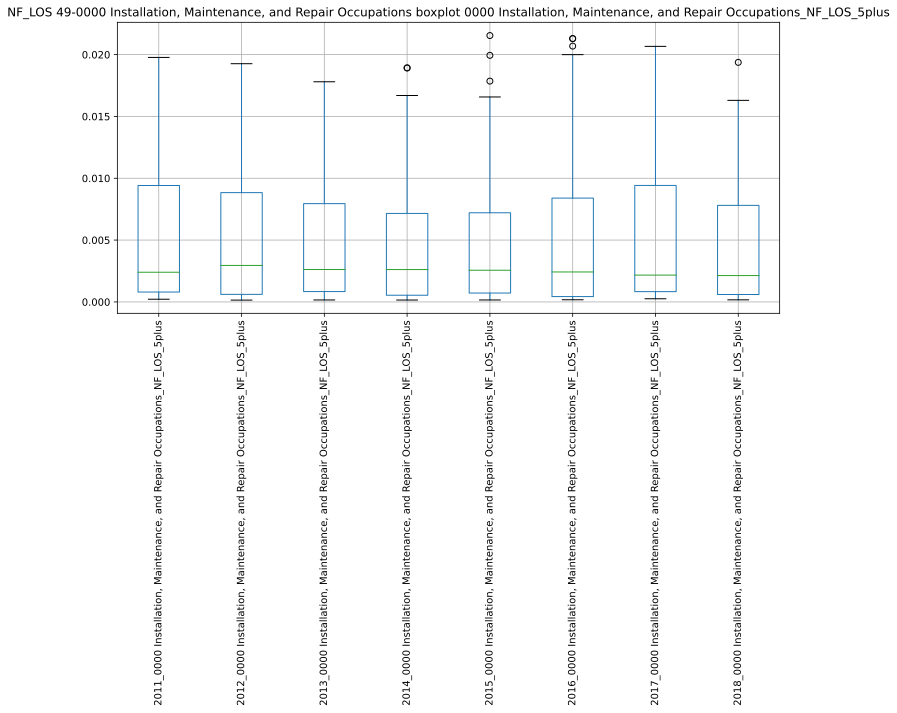

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234924.210350:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234924.251591:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234924.470019:INFO:headless_shell.cc(660)] Written to file /tmp/tmp50orr1m2/temp.png.
[1013/234924.700699:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234924.736637:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234925.027416:INFO:headless_shell.cc(660)] Written to file /tmp/tmpw2txv7or/temp.png.
[1013/234925.309015:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234925.345939:WARNI

,"2011_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus","2012_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus","2013_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus","2014_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus","2015_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus","2016_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus","2017_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus","2018_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus"
"2011_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus",1.000000,0.603321,0.451344,0.583634,0.647426,0.667352,0.513686,-0.231111
"2012_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus",0.603321,1.000000,0.280353,0.276091,0.231964,0.334321,0.304598,0.357060
"2013_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus",0.451344,0.280353,1.000000,0.504728,0.545679,0.361316,0.451456,0.240771
"2014_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus",0.583634,0.276091,0.504728,1.000000,0.626517,0.678287,0.239266,-0.066251
"2015_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus",0.647426,0.231964,0.545679,0.626517,1.000000,0.370843,0.302623,-0.205808
"2016_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus",0.667352,0.334321,0.361316,0.678287,0.370843,1.000000,0.112319,-0.123251
"2017_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus",0.513686,0.304598,0.451456,0.239266,0.302623,0.112319,1.000000,0.028477
"2018_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus",-0.231111,0.357060,0.240771,-0.066251,-0.205808,-0.123251,0.028477,1.000000


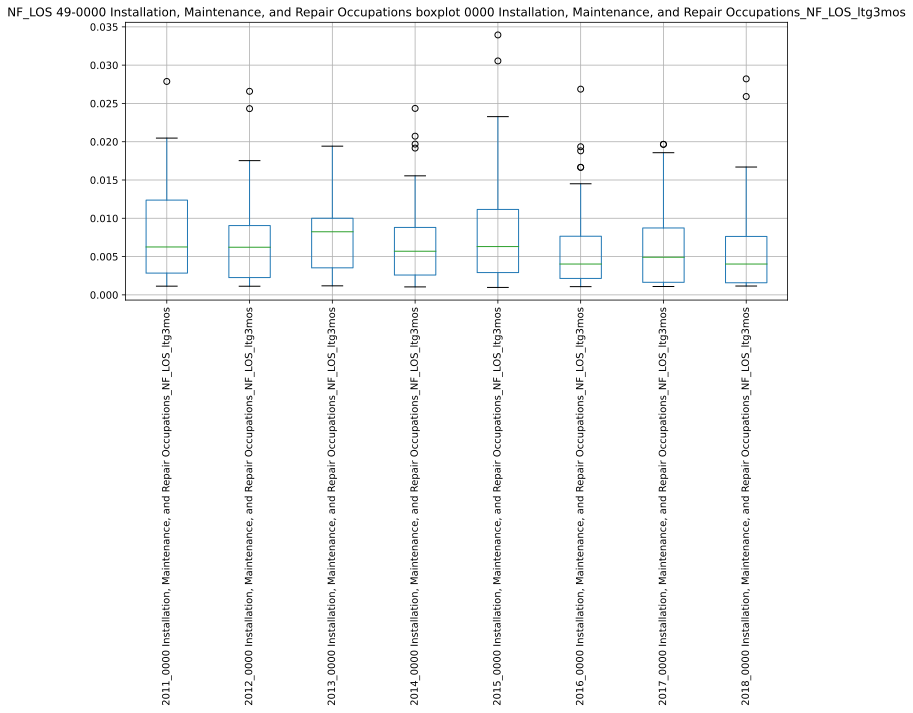

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234929.471533:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234929.510079:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234929.715188:INFO:headless_shell.cc(660)] Written to file /tmp/tmp9cfm1rlf/temp.png.
[1013/234929.939272:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234929.978957:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234930.297711:INFO:headless_shell.cc(660)] Written to file /tmp/tmp7t8j3ikv/temp.png.
[1013/234930.572403:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234930.631147:WARNI

,"2011_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos","2012_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos","2013_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos","2014_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos","2015_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos","2016_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos","2017_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos","2018_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos"
"2011_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos",1.000000,0.238694,0.217931,0.175759,0.573694,-0.144631,0.028661,0.033457
"2012_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos",0.238694,1.000000,0.382506,0.194987,0.324901,0.001697,0.257675,0.274518
"2013_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos",0.217931,0.382506,1.000000,0.062695,0.407598,0.460614,0.034480,0.461555
"2014_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos",0.175759,0.194987,0.062695,1.000000,0.118873,0.211679,0.513483,0.185759
"2015_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos",0.573694,0.324901,0.407598,0.118873,1.000000,0.267064,0.314910,0.307086
"2016_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos",-0.144631,0.001697,0.460614,0.211679,0.267064,1.000000,0.033518,0.074505
"2017_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos",0.028661,0.257675,0.034480,0.513483,0.314910,0.033518,1.000000,0.368975
"2018_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos",0.033457,0.274518,0.461555,0.185759,0.307086,0.074505,0.368975,1.000000


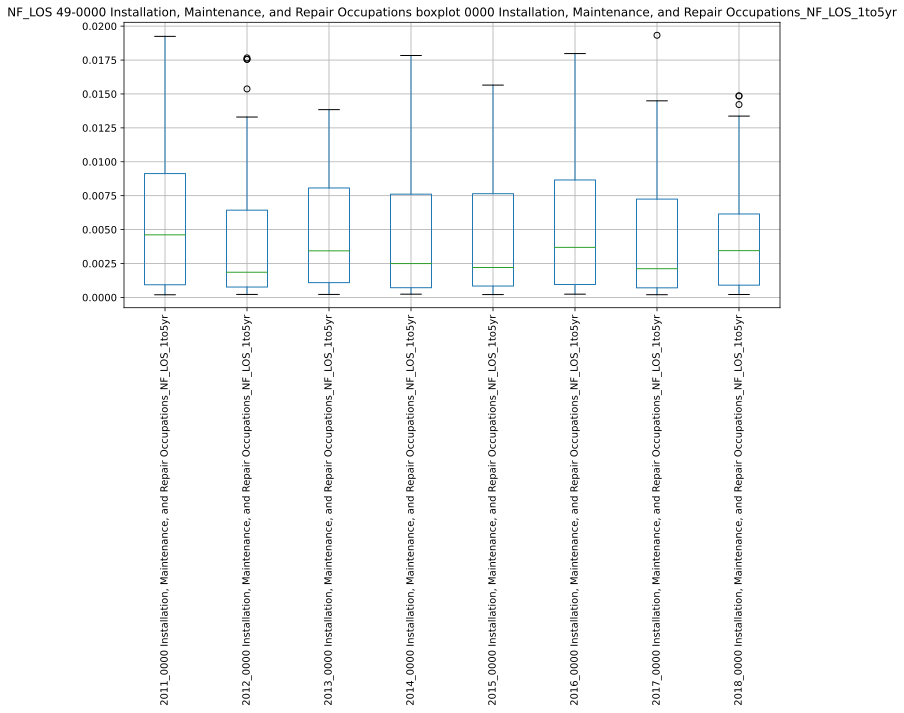

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234934.833981:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234934.876605:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234935.082570:INFO:headless_shell.cc(660)] Written to file /tmp/tmp6oqkqrf2/temp.png.
[1013/234935.310184:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234935.348169:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234935.654676:INFO:headless_shell.cc(660)] Written to file /tmp/tmp04j_cn5j/temp.png.
[1013/234935.913584:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234935.951856:WARNI

,"2011_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr","2012_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr","2013_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr","2014_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr","2015_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr","2016_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr","2017_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr","2018_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr"
"2011_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr",1.000000,0.605610,0.658068,0.613280,0.638577,0.469174,0.130653,0.323967
"2012_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr",0.605610,1.000000,0.252759,0.736698,0.567340,0.616613,-0.146657,-0.001926
"2013_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr",0.658068,0.252759,1.000000,0.062997,0.714926,0.238495,0.297584,0.237956
"2014_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr",0.613280,0.736698,0.062997,1.000000,0.217216,0.341855,-0.157079,-0.101593
"2015_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr",0.638577,0.567340,0.714926,0.217216,1.000000,0.351591,0.080617,0.020658
"2016_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr",0.469174,0.616613,0.238495,0.341855,0.351591,1.000000,0.061235,0.218247
"2017_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr",0.130653,-0.146657,0.297584,-0.157079,0.080617,0.061235,1.000000,0.370175
"2018_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr",0.323967,-0.001926,0.237956,-0.101593,0.020658,0.218247,0.370175,1.000000


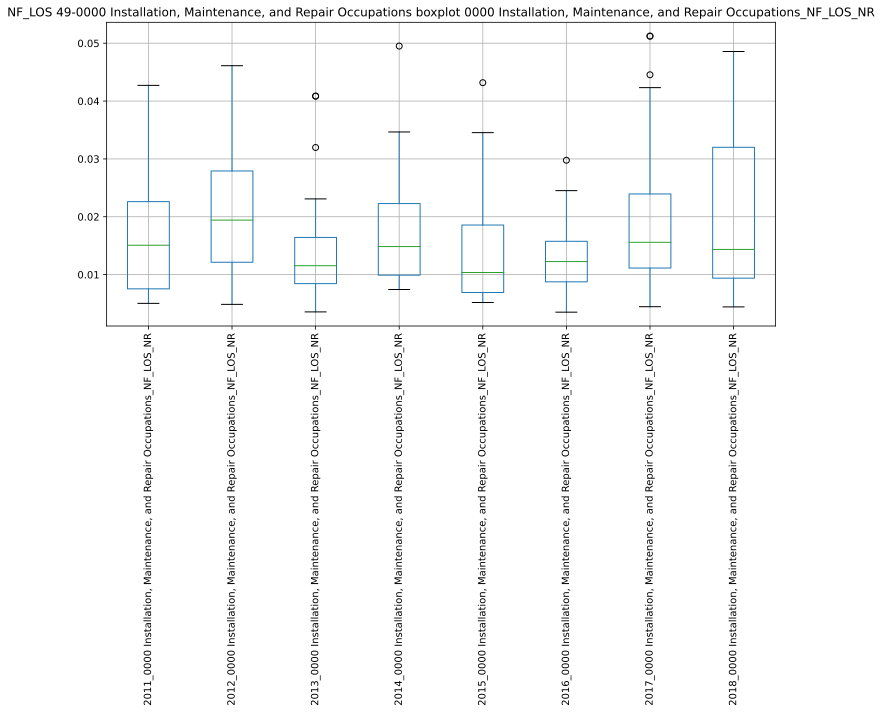

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234939.971541:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234940.013116:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234940.236876:INFO:headless_shell.cc(660)] Written to file /tmp/tmpupqm5b9p/temp.png.
[1013/234940.463311:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234940.504020:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234940.809162:INFO:headless_shell.cc(660)] Written to file /tmp/tmp85jefxmo/temp.png.
[1013/234941.081717:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234941.124396:WARNI

,"2011_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR","2012_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR","2013_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR","2014_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR","2015_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR","2016_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR","2017_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR","2018_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR"
"2011_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR",1.000000,0.162143,0.079188,0.051790,0.078591,-0.023251,0.428141,0.214479
"2012_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR",0.162143,1.000000,0.214703,0.037747,0.692977,-0.442529,0.615827,0.053245
"2013_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR",0.079188,0.214703,1.000000,0.068906,0.086477,0.173865,0.227633,0.133790
"2014_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR",0.051790,0.037747,0.068906,1.000000,0.143295,0.009263,0.409128,-0.062929
"2015_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR",0.078591,0.692977,0.086477,0.143295,1.000000,-0.213327,0.328082,-0.257824
"2016_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR",-0.023251,-0.442529,0.173865,0.009263,-0.213327,1.000000,-0.183224,-0.084350
"2017_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR",0.428141,0.615827,0.227633,0.409128,0.328082,-0.183224,1.000000,-0.322221
"2018_0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR",0.214479,0.053245,0.133790,-0.062929,-0.257824,-0.084350,-0.322221,1.000000


########################################## CORRELATIONS ###############################################
['49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos', '49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus', '49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos', '49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr', '49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR']


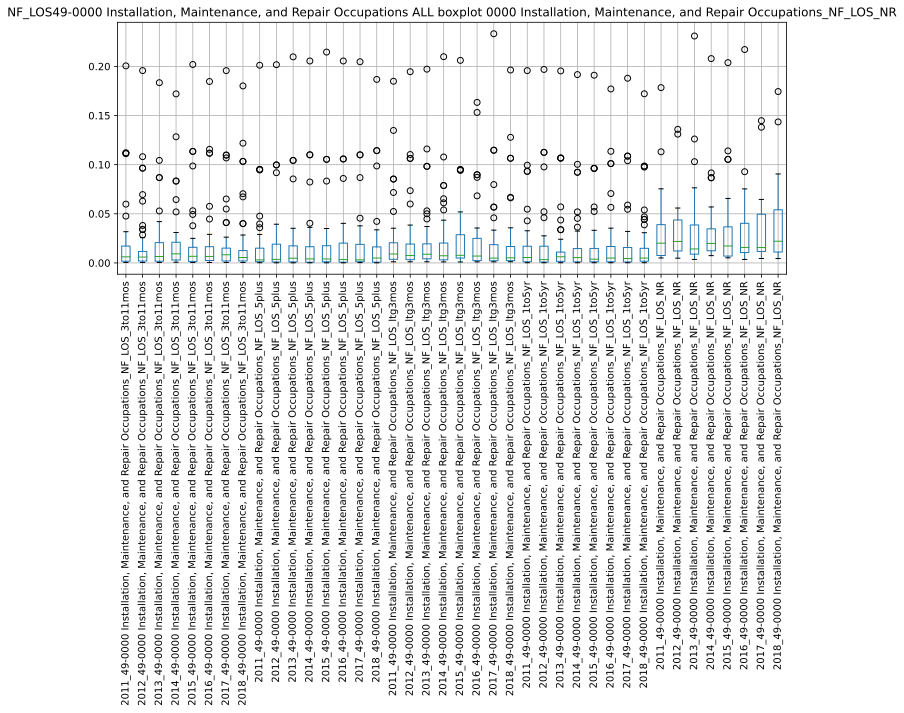

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/234945.899253:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234945.937818:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234946.287291:INFO:headless_shell.cc(660)] Written to file /tmp/tmpfvnpwxal/temp.png.
[1013/234946.518550:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234946.559412:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/234947.065323:INFO:headless_shell.cc(660)] Written to file /tmp/tmphvtp6lon/temp.png.
[1013/234947.385511:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/234947.424936:WARNI

,"2011_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos","2012_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos","2013_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos","2014_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos","2015_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos","2016_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos","2017_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos","2018_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos","2011_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus","2012_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus","2013_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus","2014_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus","2015_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus","2016_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus","2017_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus","2018_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_5plus","2011_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos","2012_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos","2013_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos","2014_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos","2015_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos","2016_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos","2017_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos","2018_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_ltg3mos","2011_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr","2012_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr","2013_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr","2014_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr","2015_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr","2016_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr","2017_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr","2018_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_1to5yr","2011_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR","2012_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR","2013_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR","2014_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR","2015_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR","2016_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR","2017_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR","2018_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_NR"
"2011_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos",1.000000,0.054638,0.139085,-0.128593,0.246244,-0.065152,-0.061071,0.456652,0.043700,-0.042935,-0.064916,0.067900,-0.028350,0.010475,0.054109,0.143062,-0.006834,0.049784,-0.034061,-0.001374,0.055899,-0.048402,0.026805,0.049233,0.056719,-0.077696,-0.057437,0.046694,-0.025549,-0.084779,-0.186954,-0.127695,0.028795,0.088734,0.374262,0.220627,-0.004166,-0.026879,0.100550,0.344591
"2012_49-0000 Installation, Maintenance, and Repair Occupations_NF_LOS_3to11mos",0.054638,1.000000,0.223910,0.053671,0.176635,0.860095,-0.052690,-0.019114,-0.109126,-0.033652,0.601999,-0.113678,-0.006488,-0.132696,-0.167520,0.496712,0.057128,-0.027655,-0.070756,-0.124287,-0.063725,-0.064740,-0.022949,-0.161186,-0.047649,-0.104630,0.208346,-0.118499,-0.069243,-0.145002,-0.079825,0.427105,0.2270

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
51-0000 Production Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
51-0000 Production Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
51-0000 Production Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
51-0000 Production Occupati

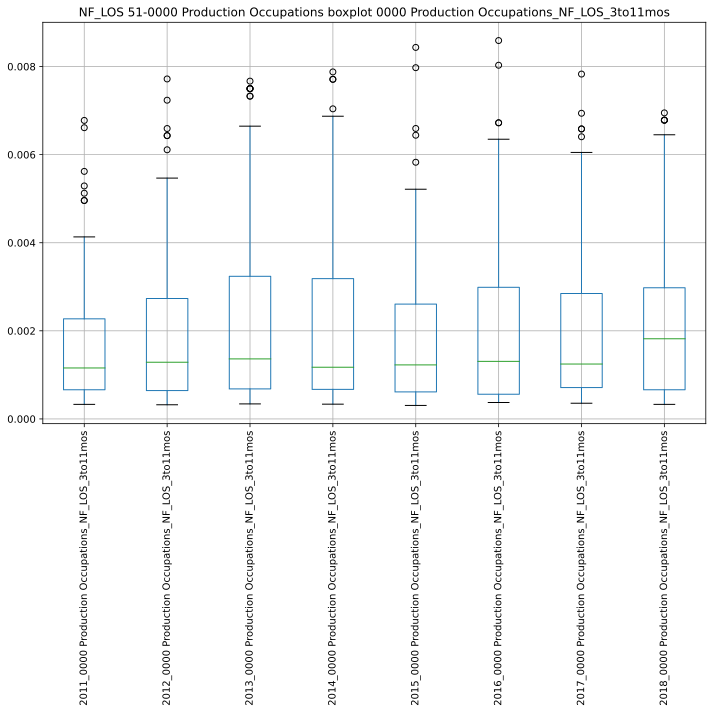

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/235027.074904:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235027.115510:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235027.332721:INFO:headless_shell.cc(660)] Written to file /tmp/tmp12p8omc2/temp.png.
[1013/235027.559590:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235027.600695:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235027.900109:INFO:headless_shell.cc(660)] Written to file /tmp/tmpwlqo892t/temp.png.
[1013/235028.175195:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235028.216587:WARNI

,2011_0000 Production Occupations_NF_LOS_3to11mos,2012_0000 Production Occupations_NF_LOS_3to11mos,2013_0000 Production Occupations_NF_LOS_3to11mos,2014_0000 Production Occupations_NF_LOS_3to11mos,2015_0000 Production Occupations_NF_LOS_3to11mos,2016_0000 Production Occupations_NF_LOS_3to11mos,2017_0000 Production Occupations_NF_LOS_3to11mos,2018_0000 Production Occupations_NF_LOS_3to11mos
2011_0000 Production Occupations_NF_LOS_3to11mos,1.000000,0.104358,-0.010175,0.255778,0.365985,0.233551,-0.121479,0.203896
2012_0000 Production Occupations_NF_LOS_3to11mos,0.104358,1.000000,0.009864,0.172618,0.228021,0.395190,0.060165,0.090956
2013_0000 Production Occupations_NF_LOS_3to11mos,-0.010175,0.009864,1.000000,0.248266,0.128244,-0.002714,-0.066321,0.082877
2014_0000 Production Occupations_NF_LOS_3to11mos,0.255778,0.172618,0.248266,1.000000,0.763535,0.245696,-0.133659,0.174974
2015_0000 Production Occupations_NF_LOS_3to11mos,0.365985,0.228021,0.128244,0.763535,1.000000,0.432605,0.089174,0.161673
2016_0000 Production Occupations_NF_LOS_3to11mos,0.233551,0.395190,-0.002714,0.245696,0.432605,1.000000,0.049248,-0.023149
2017_0000 Production Occupations_NF_LOS_3to11mos,-0.121479,0.060165,-0.066321,-0.133659,0.089174,0.049248,1.000000,0.265504
2018_0000 Production Occupations_NF_LOS_3to11mos,0.203896,0.090956,0.082877,0.174974,0.161673,-0.023149,0.265504,1.000000


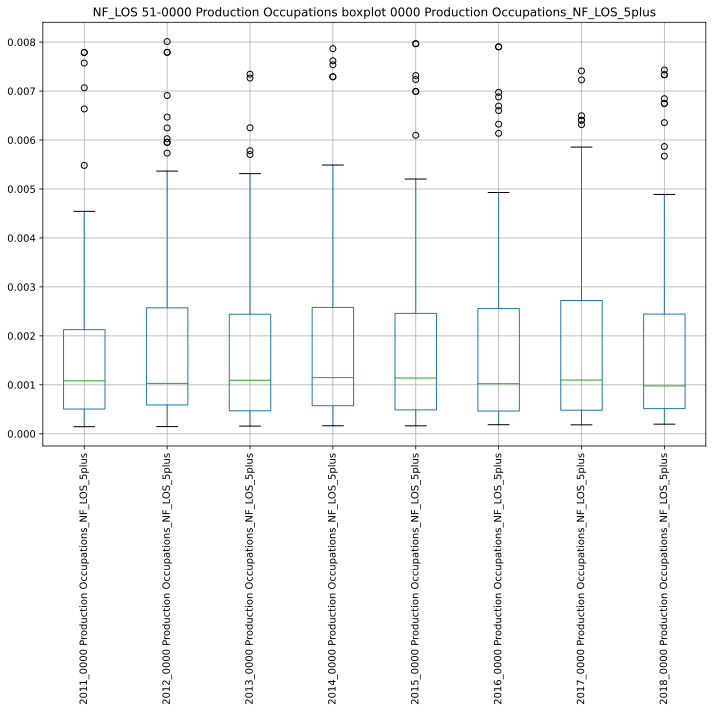

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/235030.907503:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235030.944761:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235031.164903:INFO:headless_shell.cc(660)] Written to file /tmp/tmp9aqjdeij/temp.png.
[1013/235031.388965:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235031.427063:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235031.716475:INFO:headless_shell.cc(660)] Written to file /tmp/tmpqtn2dv1q/temp.png.
[1013/235031.981254:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235032.019684:WARNI

,2011_0000 Production Occupations_NF_LOS_5plus,2012_0000 Production Occupations_NF_LOS_5plus,2013_0000 Production Occupations_NF_LOS_5plus,2014_0000 Production Occupations_NF_LOS_5plus,2015_0000 Production Occupations_NF_LOS_5plus,2016_0000 Production Occupations_NF_LOS_5plus,2017_0000 Production Occupations_NF_LOS_5plus,2018_0000 Production Occupations_NF_LOS_5plus
2011_0000 Production Occupations_NF_LOS_5plus,1.000000,0.068876,0.381600,0.536149,0.129054,-0.070336,0.275728,0.026880
2012_0000 Production Occupations_NF_LOS_5plus,0.068876,1.000000,0.010824,0.008860,0.066807,0.513640,0.254369,0.305032
2013_0000 Production Occupations_NF_LOS_5plus,0.381600,0.010824,1.000000,0.314684,0.382721,-0.051216,0.148200,0.208893
2014_0000 Production Occupations_NF_LOS_5plus,0.536149,0.008860,0.314684,1.000000,0.375104,-0.138552,0.003123,-0.121091
2015_0000 Production Occupations_NF_LOS_5plus,0.129054,0.066807,0.382721,0.375104,1.000000,-0.195506,-0.032854,0.035838
2016_0000 Production Occupations_NF_LOS_5plus,-0.070336,0.513640,-0.051216,-0.138552,-0.195506,1.000000,0.297608,0.467333
2017_0000 Production Occupations_NF_LOS_5plus,0.275728,0.254369,0.148200,0.003123,-0.032854,0.297608,1.000000,0.431327
2018_0000 Production Occupations_NF_LOS_5plus,0.026880,0.305032,0.208893,-0.121091,0.035838,0.467333,0.431327,1.000000


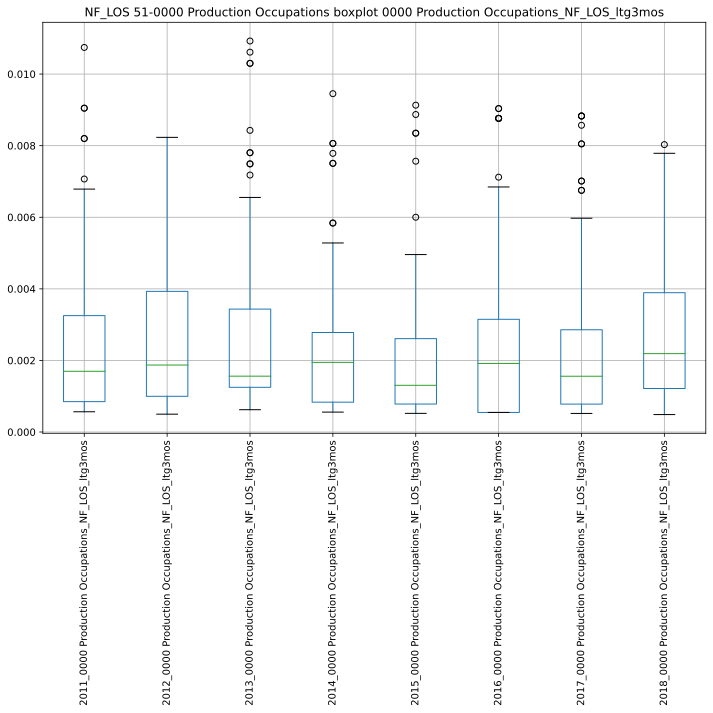

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/235034.606775:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235034.647694:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235034.843577:INFO:headless_shell.cc(660)] Written to file /tmp/tmpghzrtvgb/temp.png.
[1013/235035.056209:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235035.091116:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235035.385428:INFO:headless_shell.cc(660)] Written to file /tmp/tmpr7jcs_br/temp.png.
[1013/235035.661366:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235035.702029:WARNI

,2011_0000 Production Occupations_NF_LOS_ltg3mos,2012_0000 Production Occupations_NF_LOS_ltg3mos,2013_0000 Production Occupations_NF_LOS_ltg3mos,2014_0000 Production Occupations_NF_LOS_ltg3mos,2015_0000 Production Occupations_NF_LOS_ltg3mos,2016_0000 Production Occupations_NF_LOS_ltg3mos,2017_0000 Production Occupations_NF_LOS_ltg3mos,2018_0000 Production Occupations_NF_LOS_ltg3mos
2011_0000 Production Occupations_NF_LOS_ltg3mos,1.000000,0.016042,0.023529,-0.215325,-0.138475,-0.192502,-0.077868,0.191453
2012_0000 Production Occupations_NF_LOS_ltg3mos,0.016042,1.000000,0.128871,-0.004600,-0.086240,0.296921,-0.013456,0.249606
2013_0000 Production Occupations_NF_LOS_ltg3mos,0.023529,0.128871,1.000000,0.263535,0.028420,0.097871,-0.256755,-0.171350
2014_0000 Production Occupations_NF_LOS_ltg3mos,-0.215325,-0.004600,0.263535,1.000000,0.274176,-0.169618,0.198787,-0.234236
2015_0000 Production Occupations_NF_LOS_ltg3mos,-0.138475,-0.086240,0.028420,0.274176,1.000000,0.235416,0.051337,-0.167584
2016_0000 Production Occupations_NF_LOS_ltg3mos,-0.192502,0.296921,0.097871,-0.169618,0.235416,1.000000,0.050847,-0.057408
2017_0000 Production Occupations_NF_LOS_ltg3mos,-0.077868,-0.013456,-0.256755,0.198787,0.051337,0.050847,1.000000,-0.253503
2018_0000 Production Occupations_NF_LOS_ltg3mos,0.191453,0.249606,-0.171350,-0.234236,-0.167584,-0.057408,-0.253503,1.000000


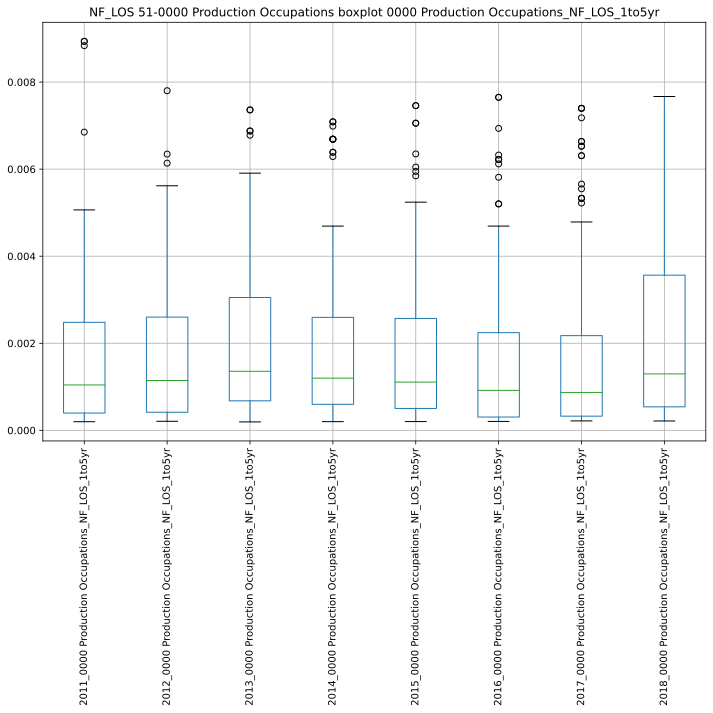

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/235038.542945:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235038.584925:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235038.797672:INFO:headless_shell.cc(660)] Written to file /tmp/tmpcl9ayl7o/temp.png.
[1013/235039.025924:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235039.066679:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235039.364165:INFO:headless_shell.cc(660)] Written to file /tmp/tmpg1hw248q/temp.png.
[1013/235039.635821:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235039.679015:WARNI

,2011_0000 Production Occupations_NF_LOS_1to5yr,2012_0000 Production Occupations_NF_LOS_1to5yr,2013_0000 Production Occupations_NF_LOS_1to5yr,2014_0000 Production Occupations_NF_LOS_1to5yr,2015_0000 Production Occupations_NF_LOS_1to5yr,2016_0000 Production Occupations_NF_LOS_1to5yr,2017_0000 Production Occupations_NF_LOS_1to5yr,2018_0000 Production Occupations_NF_LOS_1to5yr
2011_0000 Production Occupations_NF_LOS_1to5yr,1.000000,0.272976,0.127259,0.190062,0.033243,-0.108551,-0.060316,0.122224
2012_0000 Production Occupations_NF_LOS_1to5yr,0.272976,1.000000,0.438318,0.198887,0.191376,0.038316,0.056671,0.086640
2013_0000 Production Occupations_NF_LOS_1to5yr,0.127259,0.438318,1.000000,0.120486,0.227025,0.151334,-0.085112,0.131974
2014_0000 Production Occupations_NF_LOS_1to5yr,0.190062,0.198887,0.120486,1.000000,0.069705,0.078042,-0.110050,-0.038246
2015_0000 Production Occupations_NF_LOS_1to5yr,0.033243,0.191376,0.227025,0.069705,1.000000,0.302588,0.107932,0.288427
2016_0000 Production Occupations_NF_LOS_1to5yr,-0.108551,0.038316,0.151334,0.078042,0.302588,1.000000,0.107741,0.102330
2017_0000 Production Occupations_NF_LOS_1to5yr,-0.060316,0.056671,-0.085112,-0.110050,0.107932,0.107741,1.000000,0.350754
2018_0000 Production Occupations_NF_LOS_1to5yr,0.122224,0.086640,0.131974,-0.038246,0.288427,0.102330,0.350754,1.000000


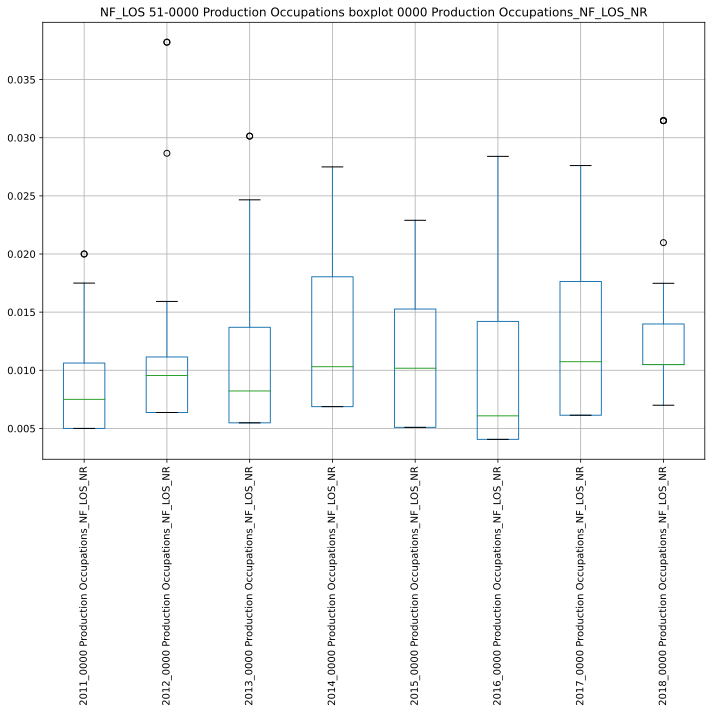

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/235042.289407:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235042.328139:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235042.548307:INFO:headless_shell.cc(660)] Written to file /tmp/tmp80rk3suu/temp.png.
[1013/235042.770633:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235042.811116:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235043.108319:INFO:headless_shell.cc(660)] Written to file /tmp/tmpyc2_54bv/temp.png.
[1013/235043.379134:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235043.420138:WARNI

,2011_0000 Production Occupations_NF_LOS_NR,2012_0000 Production Occupations_NF_LOS_NR,2013_0000 Production Occupations_NF_LOS_NR,2014_0000 Production Occupations_NF_LOS_NR,2015_0000 Production Occupations_NF_LOS_NR,2016_0000 Production Occupations_NF_LOS_NR,2017_0000 Production Occupations_NF_LOS_NR,2018_0000 Production Occupations_NF_LOS_NR
2011_0000 Production Occupations_NF_LOS_NR,1.000000,-0.039075,0.134528,0.267561,-0.026279,0.256958,0.580252,0.179568
2012_0000 Production Occupations_NF_LOS_NR,-0.039075,1.000000,-0.332651,-0.182534,0.143079,0.482708,-0.074641,-0.186885
2013_0000 Production Occupations_NF_LOS_NR,0.134528,-0.332651,1.000000,0.605421,0.347894,-0.039505,-0.025118,0.418466
2014_0000 Production Occupations_NF_LOS_NR,0.267561,-0.182534,0.605421,1.000000,0.188988,0.015763,-0.056773,0.220231
2015_0000 Production Occupations_NF_LOS_NR,-0.026279,0.143079,0.347894,0.188988,1.000000,0.191023,0.044046,0.326600
2016_0000 Production Occupations_NF_LOS_NR,0.256958,0.482708,-0.039505,0.015763,0.191023,1.000000,0.085840,0.346072
2017_0000 Production Occupations_NF_LOS_NR,0.580252,-0.074641,-0.025118,-0.056773,0.044046,0.085840,1.000000,0.456043
2018_0000 Production Occupations_NF_LOS_NR,0.179568,-0.186885,0.418466,0.220231,0.326600,0.346072,0.456043,1.000000


########################################## CORRELATIONS ###############################################
['51-0000 Production Occupations_NF_LOS_3to11mos', '51-0000 Production Occupations_NF_LOS_5plus', '51-0000 Production Occupations_NF_LOS_ltg3mos', '51-0000 Production Occupations_NF_LOS_1to5yr', '51-0000 Production Occupations_NF_LOS_NR']


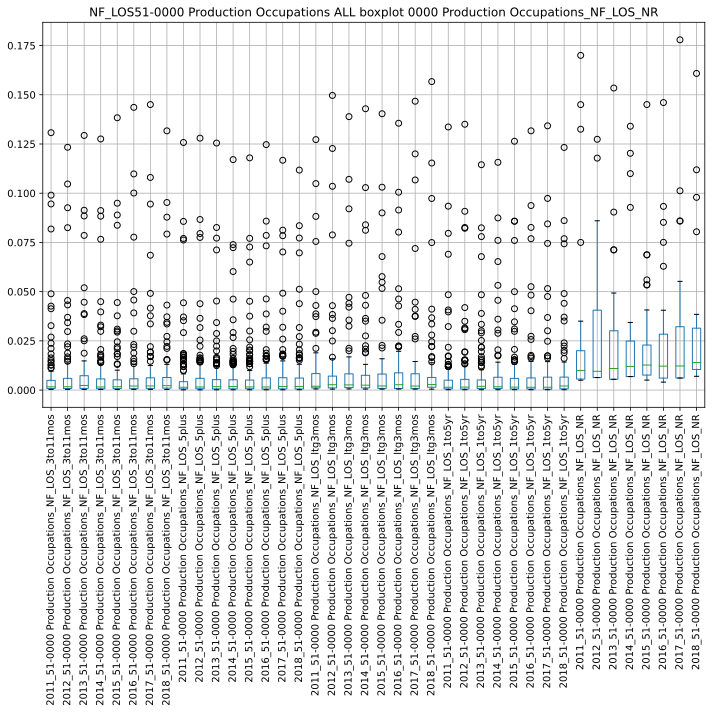

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/235047.107968:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235047.148167:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235047.470238:INFO:headless_shell.cc(660)] Written to file /tmp/tmpc_3w487g/temp.png.
[1013/235047.692375:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235047.732369:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235048.224085:INFO:headless_shell.cc(660)] Written to file /tmp/tmp9n4x36wx/temp.png.
[1013/235048.530644:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235048.571289:WARNI

,2011_51-0000 Production Occupations_NF_LOS_3to11mos,2012_51-0000 Production Occupations_NF_LOS_3to11mos,2013_51-0000 Production Occupations_NF_LOS_3to11mos,2014_51-0000 Production Occupations_NF_LOS_3to11mos,2015_51-0000 Production Occupations_NF_LOS_3to11mos,2016_51-0000 Production Occupations_NF_LOS_3to11mos,2017_51-0000 Production Occupations_NF_LOS_3to11mos,2018_51-0000 Production Occupations_NF_LOS_3to11mos,2011_51-0000 Production Occupations_NF_LOS_5plus,2012_51-0000 Production Occupations_NF_LOS_5plus,2013_51-0000 Production Occupations_NF_LOS_5plus,2014_51-0000 Production Occupations_NF_LOS_5plus,2015_51-0000 Production Occupations_NF_LOS_5plus,2016_51-0000 Production Occupations_NF_LOS_5plus,2017_51-0000 Production Occupations_NF_LOS_5plus,2018_51-0000 Production Occupations_NF_LOS_5plus,2011_51-0000 Production Occupations_NF_LOS_ltg3mos,2012_51-0000 Production Occupations_NF_LOS_ltg3mos,2013_51-0000 Production Occupations_NF_LOS_ltg3mos,2014_51-0000 Production Occupations_NF_LOS_ltg3mos,2015_51-0000 Production Occupations_NF_LOS_ltg3mos,2016_51-0000 Production Occupations_NF_LOS_ltg3mos,2017_51-0000 Production Occupations_NF_LOS_ltg3mos,2018_51-0000 Production Occupations_NF_LOS_ltg3mos,2011_51-0000 Production Occupations_NF_LOS_1to5yr,2012_51-0000 Production Occupations_NF_LOS_1to5yr,2013_51-0000 Production Occupations_NF_LOS_1to5yr,2014_51-0000 Production Occupations_NF_LOS_1to5yr,2015_51-0000 Production Occupations_NF_LOS_1to5yr,2016_51-0000 Production Occupations_NF_LOS_1to5yr,2017_51-0000 Production Occupations_NF_LOS_1to5yr,2018_51-0000 Production Occupations_NF_LOS_1to5yr,2011_51-0000 Production Occupations_NF_LOS_NR,2012_51-0000 Production Occupations_NF_LOS_NR,2013_51-0000 Production Occupations_NF_LOS_NR,2014_51-0000 Production Occupations_NF_LOS_NR,2015_51-0000 Production Occupations_NF_LOS_NR,2016_51-0000 Production Occupations_NF_LOS_NR,2017_51-0000 Production Occupations_NF_LOS_NR,2018_51-0000 Production Occupations_NF_LOS_NR
2011_51-0000 Production Occupations_NF_LOS_3to11mos,1.000000,0.188856,-0.024022,0.495691,0.274930,0.286746,0.002865,0.171459,0.049410,0.304908,0.001603,0.050238,-0.002997,0.324289,0.311591,0.372923,0.276121,0.372778,-0.032160,0.051840,0.074887,0.016539,-0.008128,0.344386,-0.001479,0.025810,0.039149,0.061076,0.336977,0.326158,0.169166,0.592361,-0.140975,0.200525,0.160521,-0.131358,-0.040465,0.140233,-0.186762,-0.102344
2012_51-0000 Production Occupations_NF_LOS_3to11mos,0.188856,1.000000,0.202777,0.166748,-0.023167,0.008188,0.189748,0.318882,-0.031625,0.040422,-0.027872,-0.023084,-0.029381,0.032938,-0.025662,-0.003682,-0.005883,-0.026134,-0.020712,0.246673,0.011527,-0.047915,0.092875,0.016722,-0.001850,-0.038521,0.030090,-0.009999,-0.003066,0.050848,0.242872,0.415294,-0.105834,0.466997,0.001497,-0.105273,-0.038747,0.010940,0.551535,-0.095397
2013_51-0000 Production Occupations_NF_LOS_3to11mos,-0.024022,0.202777,1.000000,-0.004395,0.135313,0.172087,0.162160,0.258515,0.356454,-0.029274,0.037354,0.325615,0.043703,-0.005890,0.013370,0.005798,0.009149,0.051871,0.029284,0.251367,0.096866,0.074546,0.035908,-0.021360,0.085056,0.065786,0.058712,0.047609,-0.040734,0.004921,0.317636,0.340977,0.072592,0.404925,-0.023197,0.020978,-0.021698,0.004541,0.579373,-0.119928
2014_51-0000 Production Occupations_NF_LOS_3to11mos,0.495691,0.166748,-0.004395,1.000000,0.288612,0.272674,0.009498,0.131540,0.020434,0.346646,0.015968,0.056720,-0.018576,0.306555,0.282634,0.335449,-0.030169,0.023554,-0.052995,0.010549,0.058199,0.349585,0.056565,-0.023511,0.005703,-0.005011,0.202503,0.076040,0.316194,0.323544,0.000992,0.158450,-0.065340,0.207466,0.187358,-0.182886,-0.042854,0.107262,-0.193305,-0.100898
2015_51-0000 Production Occupations_NF_LOS_3to11mos,0.274930,-0.023167,0.135313,0.288612,1.000000,0.238236,0.010493,-0.032639,0.028912,0.252225,0.065601,-0.006827,-0.002637,0.248612,0.380997,0.355142,-0.025696,0.012222,-0.052871,0.034291,0.100449,0.005424,0.017004,-0.028478,0.095014,0.024617,0.030553,0.077431,0.27029

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
53-0000 Transportation and Material Moving Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
53-0000 Transportation and Material Moving Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
53-0000 Transportation and Material Moving Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ###########

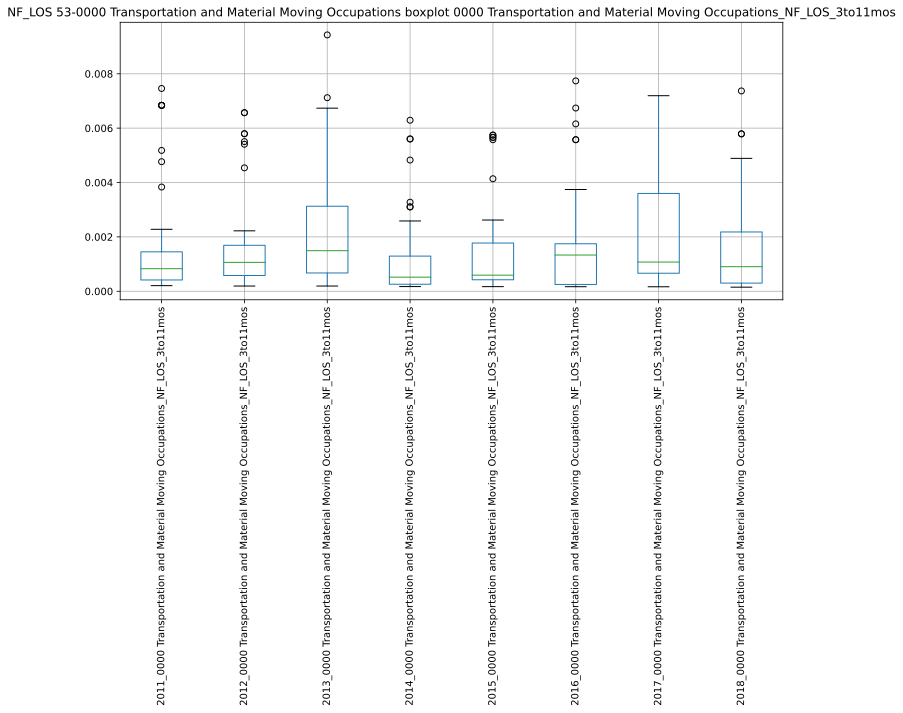

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/235109.025754:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235109.063932:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235109.293274:INFO:headless_shell.cc(660)] Written to file /tmp/tmp4l4xkhlz/temp.png.
[1013/235109.517932:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235109.559792:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235109.846477:INFO:headless_shell.cc(660)] Written to file /tmp/tmpb1huei_w/temp.png.
[1013/235110.116491:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235110.156990:WARNI

,2011_0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,2012_0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,2013_0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,2014_0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,2015_0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,2016_0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,2017_0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,2018_0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos
2011_0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,1.000000,-0.085763,-0.269586,-0.155839,0.436696,0.279581,0.239322,0.233546
2012_0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,-0.085763,1.000000,-0.023532,0.180622,-0.000025,0.654144,0.402417,0.119458
2013_0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,-0.269586,-0.023532,1.000000,0.240589,-0.221140,-0.115584,-0.308456,0.095368
2014_0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,-0.155839,0.180622,0.240589,1.000000,-0.027610,0.134917,-0.324971,0.341911
2015_0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,0.436696,-0.000025,-0.221140,-0.027610,1.000000,-0.170314,0.282965,0.449855
2016_0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,0.279581,0.654144,-0.115584,0.134917,-0.170314,1.000000,0.167941,-0.181872
2017_0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,0.239322,0.402417,-0.308456,-0.324971,0.282965,0.167941,1.000000,-0.115810
2018_0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,0.233546,0.119458,0.095368,0.341911,0.449855,-0.181872,-0.115810,1.000000


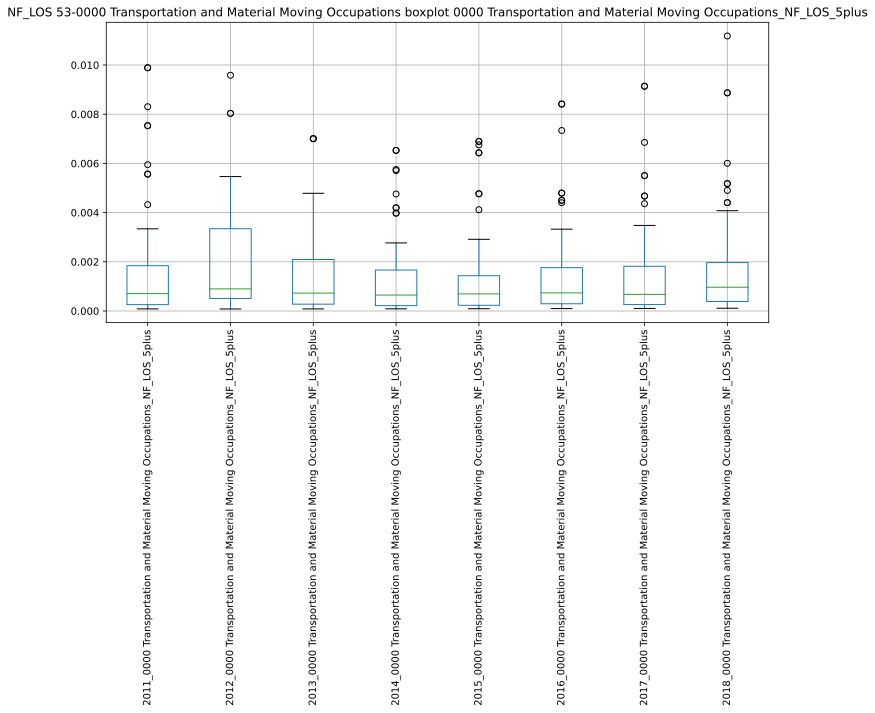

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/235114.246224:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235114.285003:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235114.512391:INFO:headless_shell.cc(660)] Written to file /tmp/tmpv5spubdn/temp.png.
[1013/235114.738954:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235114.777341:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235115.090544:INFO:headless_shell.cc(660)] Written to file /tmp/tmpef15vwbh/temp.png.
[1013/235115.359796:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235115.400541:WARNI

,2011_0000 Transportation and Material Moving Occupations_NF_LOS_5plus,2012_0000 Transportation and Material Moving Occupations_NF_LOS_5plus,2013_0000 Transportation and Material Moving Occupations_NF_LOS_5plus,2014_0000 Transportation and Material Moving Occupations_NF_LOS_5plus,2015_0000 Transportation and Material Moving Occupations_NF_LOS_5plus,2016_0000 Transportation and Material Moving Occupations_NF_LOS_5plus,2017_0000 Transportation and Material Moving Occupations_NF_LOS_5plus,2018_0000 Transportation and Material Moving Occupations_NF_LOS_5plus
2011_0000 Transportation and Material Moving Occupations_NF_LOS_5plus,1.000000,0.176439,0.163091,0.203939,0.301244,0.322140,0.302531,0.266587
2012_0000 Transportation and Material Moving Occupations_NF_LOS_5plus,0.176439,1.000000,0.288244,0.202437,0.325758,0.157255,0.182070,0.320003
2013_0000 Transportation and Material Moving Occupations_NF_LOS_5plus,0.163091,0.288244,1.000000,0.596420,0.684503,0.218866,0.221767,0.077671
2014_0000 Transportation and Material Moving Occupations_NF_LOS_5plus,0.203939,0.202437,0.596420,1.000000,0.709622,0.374453,0.332681,0.305961
2015_0000 Transportation and Material Moving Occupations_NF_LOS_5plus,0.301244,0.325758,0.684503,0.709622,1.000000,0.246060,0.193763,0.271923
2016_0000 Transportation and Material Moving Occupations_NF_LOS_5plus,0.322140,0.157255,0.218866,0.374453,0.246060,1.000000,0.431842,0.390994
2017_0000 Transportation and Material Moving Occupations_NF_LOS_5plus,0.302531,0.182070,0.221767,0.332681,0.193763,0.431842,1.000000,0.380620
2018_0000 Transportation and Material Moving Occupations_NF_LOS_5plus,0.266587,0.320003,0.077671,0.305961,0.271923,0.390994,0.380620,1.000000


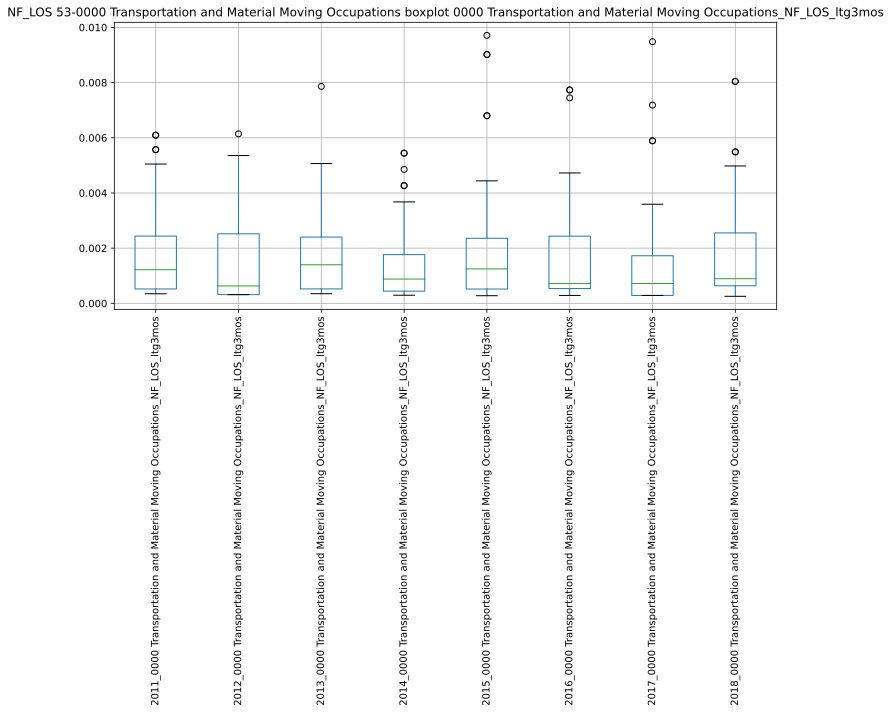

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/235119.533531:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235119.572482:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235119.782601:INFO:headless_shell.cc(660)] Written to file /tmp/tmpjvqajbb_/temp.png.
[1013/235120.004925:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235120.045033:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235120.317042:INFO:headless_shell.cc(660)] Written to file /tmp/tmp1x3zpxqv/temp.png.
[1013/235120.600773:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235120.645159:WARNI

,2011_0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,2012_0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,2013_0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,2014_0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,2015_0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,2016_0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,2017_0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,2018_0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos
2011_0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,1.000000,-0.058380,0.126558,0.370001,-0.152517,0.203709,0.187524,0.051944
2012_0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,-0.058380,1.000000,0.396780,0.270897,0.373113,-0.235213,0.693618,0.295718
2013_0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,0.126558,0.396780,1.000000,0.516073,0.537602,-0.090143,0.328233,0.451556
2014_0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,0.370001,0.270897,0.516073,1.000000,0.659946,0.237433,0.091887,-0.109578
2015_0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,-0.152517,0.373113,0.537602,0.659946,1.000000,-0.324369,0.016424,0.061773
2016_0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,0.203709,-0.235213,-0.090143,0.237433,-0.324369,1.000000,-0.063763,0.205101
2017_0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,0.187524,0.693618,0.328233,0.091887,0.016424,-0.063763,1.000000,0.262791
2018_0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,0.051944,0.295718,0.451556,-0.109578,0.061773,0.205101,0.262791,1.000000


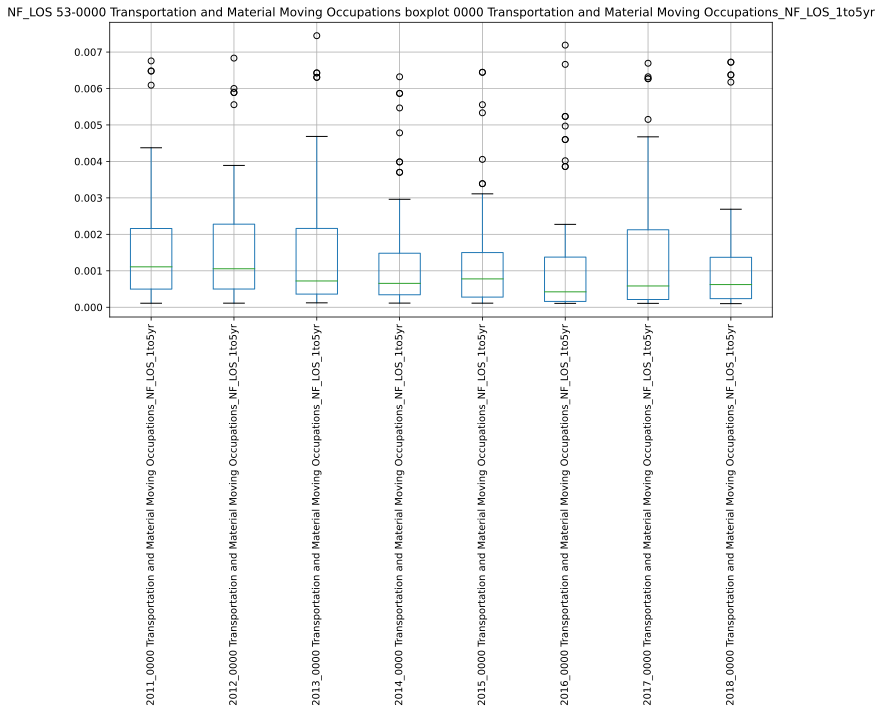

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/235124.872384:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235124.911433:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235125.135756:INFO:headless_shell.cc(660)] Written to file /tmp/tmpq4iqplem/temp.png.
[1013/235125.355298:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235125.392472:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235125.681734:INFO:headless_shell.cc(660)] Written to file /tmp/tmpjbhxpf25/temp.png.
[1013/235125.948155:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235125.988726:WARNI

,2011_0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,2012_0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,2013_0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,2014_0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,2015_0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,2016_0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,2017_0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,2018_0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr
2011_0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,1.000000,0.250319,0.118543,-0.264822,0.319234,0.173428,-0.059591,0.071520
2012_0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,0.250319,1.000000,0.325972,0.259002,0.383470,0.368518,0.568337,0.529106
2013_0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,0.118543,0.325972,1.000000,0.306734,0.409824,0.260479,0.294394,0.228618
2014_0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,-0.264822,0.259002,0.306734,1.000000,0.144229,0.362636,0.344487,0.310176
2015_0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,0.319234,0.383470,0.409824,0.144229,1.000000,0.519616,0.495736,0.398870
2016_0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,0.173428,0.368518,0.260479,0.362636,0.519616,1.000000,0.879529,0.510535
2017_0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,-0.059591,0.568337,0.294394,0.344487,0.495736,0.879529,1.000000,0.564282
2018_0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,0.071520,0.529106,0.228618,0.310176,0.398870,0.510535,0.564282,1.000000


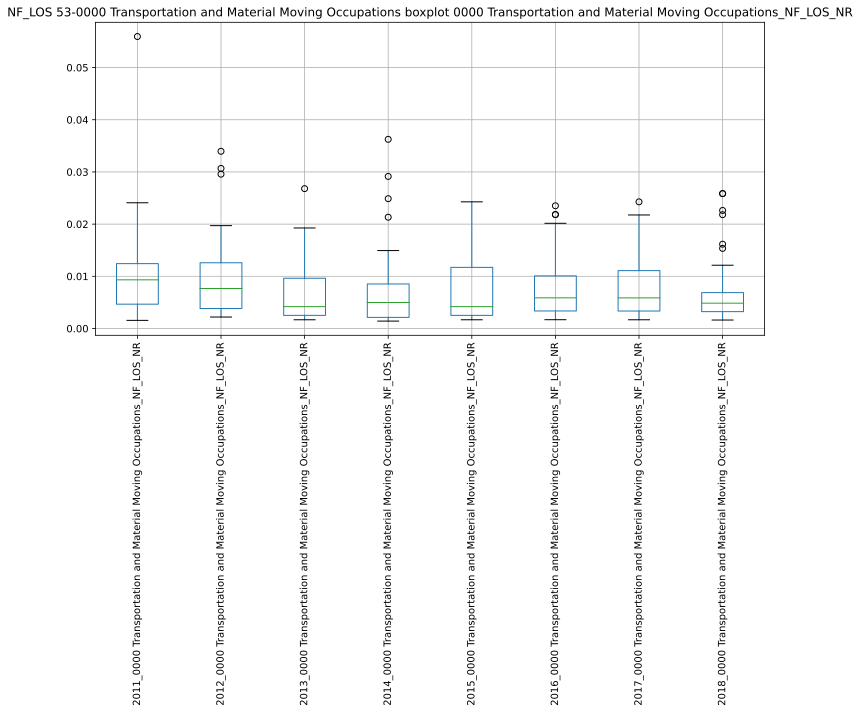

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/235130.076948:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235130.115200:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235130.326246:INFO:headless_shell.cc(660)] Written to file /tmp/tmp_xfb3v_8/temp.png.
[1013/235130.544643:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235130.582944:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235130.875549:INFO:headless_shell.cc(660)] Written to file /tmp/tmpkd2kxa1p/temp.png.
[1013/235131.132791:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235131.175949:WARNI

,2011_0000 Transportation and Material Moving Occupations_NF_LOS_NR,2012_0000 Transportation and Material Moving Occupations_NF_LOS_NR,2013_0000 Transportation and Material Moving Occupations_NF_LOS_NR,2014_0000 Transportation and Material Moving Occupations_NF_LOS_NR,2015_0000 Transportation and Material Moving Occupations_NF_LOS_NR,2016_0000 Transportation and Material Moving Occupations_NF_LOS_NR,2017_0000 Transportation and Material Moving Occupations_NF_LOS_NR,2018_0000 Transportation and Material Moving Occupations_NF_LOS_NR
2011_0000 Transportation and Material Moving Occupations_NF_LOS_NR,1.000000,0.581290,-0.068924,0.218663,-0.097099,-0.044733,0.025354,0.154074
2012_0000 Transportation and Material Moving Occupations_NF_LOS_NR,0.581290,1.000000,-0.154391,0.081204,0.040140,0.319702,0.189994,-0.104388
2013_0000 Transportation and Material Moving Occupations_NF_LOS_NR,-0.068924,-0.154391,1.000000,-0.062792,0.536168,-0.060055,0.064228,0.432836
2014_0000 Transportation and Material Moving Occupations_NF_LOS_NR,0.218663,0.081204,-0.062792,1.000000,0.238273,0.043677,0.150586,-0.097364
2015_0000 Transportation and Material Moving Occupations_NF_LOS_NR,-0.097099,0.040140,0.536168,0.238273,1.000000,0.155299,0.300098,0.431979
2016_0000 Transportation and Material Moving Occupations_NF_LOS_NR,-0.044733,0.319702,-0.060055,0.043677,0.155299,1.000000,-0.114680,0.027800
2017_0000 Transportation and Material Moving Occupations_NF_LOS_NR,0.025354,0.189994,0.064228,0.150586,0.300098,-0.114680,1.000000,0.178759
2018_0000 Transportation and Material Moving Occupations_NF_LOS_NR,0.154074,-0.104388,0.432836,-0.097364,0.431979,0.027800,0.178759,1.000000


########################################## CORRELATIONS ###############################################
['53-0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos', '53-0000 Transportation and Material Moving Occupations_NF_LOS_5plus', '53-0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos', '53-0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr', '53-0000 Transportation and Material Moving Occupations_NF_LOS_NR']


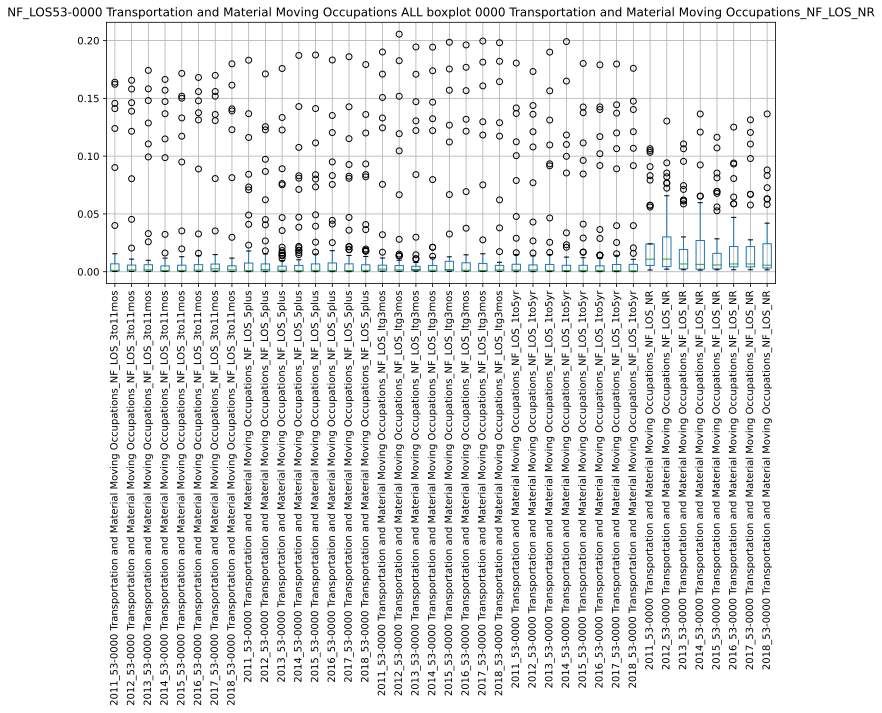

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/235135.944250:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235135.981621:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235136.319256:INFO:headless_shell.cc(660)] Written to file /tmp/tmpg2fgobjp/temp.png.
[1013/235136.537919:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235136.575726:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235137.073621:INFO:headless_shell.cc(660)] Written to file /tmp/tmpvojs7ih7/temp.png.
[1013/235137.389727:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235137.430637:WARNI

,2011_53-0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,2012_53-0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,2013_53-0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,2014_53-0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,2015_53-0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,2016_53-0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,2017_53-0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,2018_53-0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,2011_53-0000 Transportation and Material Moving Occupations_NF_LOS_5plus,2012_53-0000 Transportation and Material Moving Occupations_NF_LOS_5plus,2013_53-0000 Transportation and Material Moving Occupations_NF_LOS_5plus,2014_53-0000 Transportation and Material Moving Occupations_NF_LOS_5plus,2015_53-0000 Transportation and Material Moving Occupations_NF_LOS_5plus,2016_53-0000 Transportation and Material Moving Occupations_NF_LOS_5plus,2017_53-0000 Transportation and Material Moving Occupations_NF_LOS_5plus,2018_53-0000 Transportation and Material Moving Occupations_NF_LOS_5plus,2011_53-0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,2012_53-0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,2013_53-0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,2014_53-0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,2015_53-0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,2016_53-0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,2017_53-0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,2018_53-0000 Transportation and Material Moving Occupations_NF_LOS_ltg3mos,2011_53-0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,2012_53-0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,2013_53-0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,2014_53-0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,2015_53-0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,2016_53-0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,2017_53-0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,2018_53-0000 Transportation and Material Moving Occupations_NF_LOS_1to5yr,2011_53-0000 Transportation and Material Moving Occupations_NF_LOS_NR,2012_53-0000 Transportation and Material Moving Occupations_NF_LOS_NR,2013_53-0000 Transportation and Material Moving Occupations_NF_LOS_NR,2014_53-0000 Transportation and Material Moving Occupations_NF_LOS_NR,2015_53-0000 Transportation and Material Moving Occupations_NF_LOS_NR,2016_53-0000 Transportation and Material Moving Occupations_NF_LOS_NR,2017_53-0000 Transportation and Material Moving Occupations_NF_LOS_NR,2018_53-0000 Transportation and Material Moving Occupations_NF_LOS_NR
2011_53-0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,1.000000,0.003953,0.174682,-0.039338,0.444323,-0.004335,-0.053775,-0.078214,0.035224,0.025580,-0.049266,-0.051094,-0.065948,-0.020662,0.029759,0.028518,-0.111947,0.185371,0.652879,-0.106412,0.665680,-0.160481,0.469702,-0.046063,-0.066408,0.011241,0.209750,0.018356,0.071344,0.019957,0.011889,0.008511,0.253449,0.312142,-0.204060,0.132663,-0.196501,-0.097226,-0.154610,-0.150495
2012_53-0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,0.003953,1.000000,-0.138841,-0.043777,0.186334,0.577598,-0.088460,-0.054734,0.017632,0.018557,0.049630,0.050890,0.049282,-0.014706,-0.001777,0.017912,0.069135,-0.130126,-0.139472,0.048615,-0.040411,0.079540,-0.107737,-0.113497,-0.045953,-0.028884,0.516406,0.018923,0.484197,-0.019580,-0.025716,0.002759,0.023591,0.005440,0.384718,0.402995,0.224419,-0.101364,0.165322,0.297438
2013_53-0000 Transportation and Material Moving Occupations_NF_LOS_3to11mos,0.174682,-0.138841,1.000000,-0.092075,0.015367,-0.121849,-0.048955,-0.039

########################################## NEW OCCUPATION ###############################################

########################################## NEW YEAR ###############################################
SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
55-0000 Military Specific Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
55-0000 Military Specific Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
55-0000 Military Specific Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
55-000

/home/ediaz/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/ediaz/.local/lib/python3.8/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


SOC_all.csv
global_y_soc1 found.
global_soc1_empty found.
NF_LOS_3to11mos_all.csv
NF_LOS_5plus_all.csv
NF_LOS_ltg3mos_all.csv
NF_LOS_1to5yr_all.csv
NF_LOS_NR_all.csv
dict_keys(['NF_LOS_3to11mos', 'NF_LOS_5plus', 'NF_LOS_ltg3mos', 'NF_LOS_1to5yr', 'NF_LOS_NR'])
############ OCCUPATION ############
55-0000 Military Specific Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
55-0000 Military Specific Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
55-0000 Military Specific Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
55-0000 Military Specific Occupations
 
########## NEED TO EVAL ##################
########## NEED TO EVAL ##################
############ OCCUPATION ############
55-0000 Military Specific Occupations
 
##########

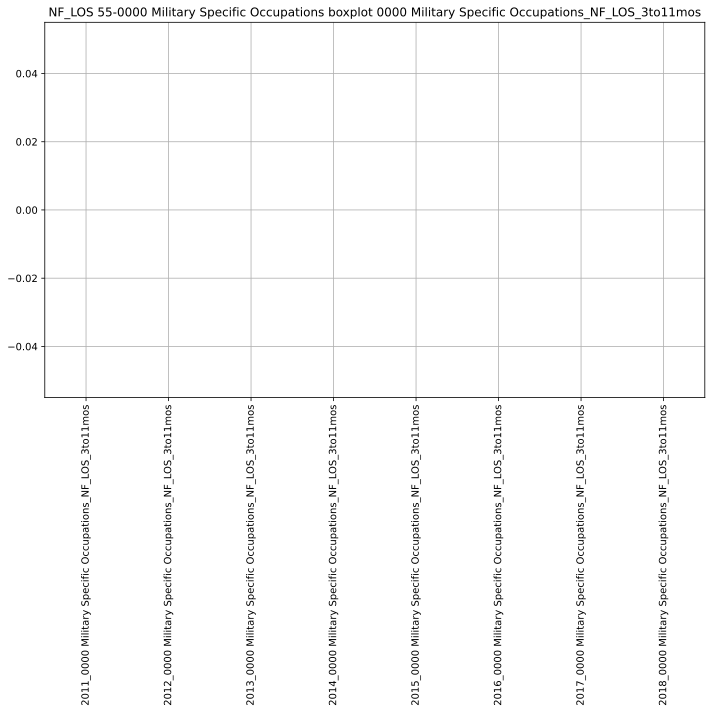

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/235216.952511:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235216.994738:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235217.212654:INFO:headless_shell.cc(660)] Written to file /tmp/tmpta9hp0lg/temp.png.
[1013/235217.466377:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235217.506295:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235217.781347:INFO:headless_shell.cc(660)] Written to file /tmp/tmpyh6iw62d/temp.png.
[1013/235218.043935:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235218.081377:WARNI

,2011_0000 Military Specific Occupations_NF_LOS_3to11mos,2012_0000 Military Specific Occupations_NF_LOS_3to11mos,2013_0000 Military Specific Occupations_NF_LOS_3to11mos,2014_0000 Military Specific Occupations_NF_LOS_3to11mos,2015_0000 Military Specific Occupations_NF_LOS_3to11mos,2016_0000 Military Specific Occupations_NF_LOS_3to11mos,2017_0000 Military Specific Occupations_NF_LOS_3to11mos,2018_0000 Military Specific Occupations_NF_LOS_3to11mos
2011_0000 Military Specific Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan
2012_0000 Military Specific Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan
2013_0000 Military Specific Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan
2014_0000 Military Specific Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan
2015_0000 Military Specific Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan
2016_0000 Military Specific Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan
2017_0000 Military Specific Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan
2018_0000 Military Specific Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan


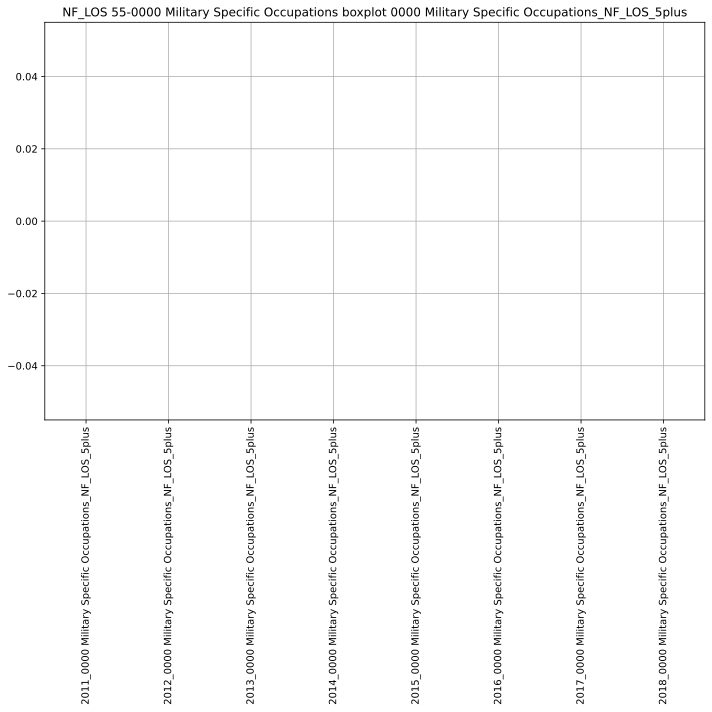

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/235220.658491:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235220.697006:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235220.934483:INFO:headless_shell.cc(660)] Written to file /tmp/tmpyhqqsnkl/temp.png.
[1013/235221.154615:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235221.194047:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235221.474704:INFO:headless_shell.cc(660)] Written to file /tmp/tmpj_0fn5mf/temp.png.
[1013/235221.745626:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235221.785218:WARNI

,2011_0000 Military Specific Occupations_NF_LOS_5plus,2012_0000 Military Specific Occupations_NF_LOS_5plus,2013_0000 Military Specific Occupations_NF_LOS_5plus,2014_0000 Military Specific Occupations_NF_LOS_5plus,2015_0000 Military Specific Occupations_NF_LOS_5plus,2016_0000 Military Specific Occupations_NF_LOS_5plus,2017_0000 Military Specific Occupations_NF_LOS_5plus,2018_0000 Military Specific Occupations_NF_LOS_5plus
2011_0000 Military Specific Occupations_NF_LOS_5plus,nan,nan,nan,nan,nan,nan,nan,nan
2012_0000 Military Specific Occupations_NF_LOS_5plus,nan,nan,nan,nan,nan,nan,nan,nan
2013_0000 Military Specific Occupations_NF_LOS_5plus,nan,nan,nan,nan,nan,nan,nan,nan
2014_0000 Military Specific Occupations_NF_LOS_5plus,nan,nan,nan,nan,nan,nan,nan,nan
2015_0000 Military Specific Occupations_NF_LOS_5plus,nan,nan,nan,nan,nan,nan,nan,nan
2016_0000 Military Specific Occupations_NF_LOS_5plus,nan,nan,nan,nan,nan,nan,nan,nan
2017_0000 Military Specific Occupations_NF_LOS_5plus,nan,nan,nan,nan,nan,nan,nan,nan
2018_0000 Military Specific Occupations_NF_LOS_5plus,nan,nan,nan,nan,nan,nan,nan,nan


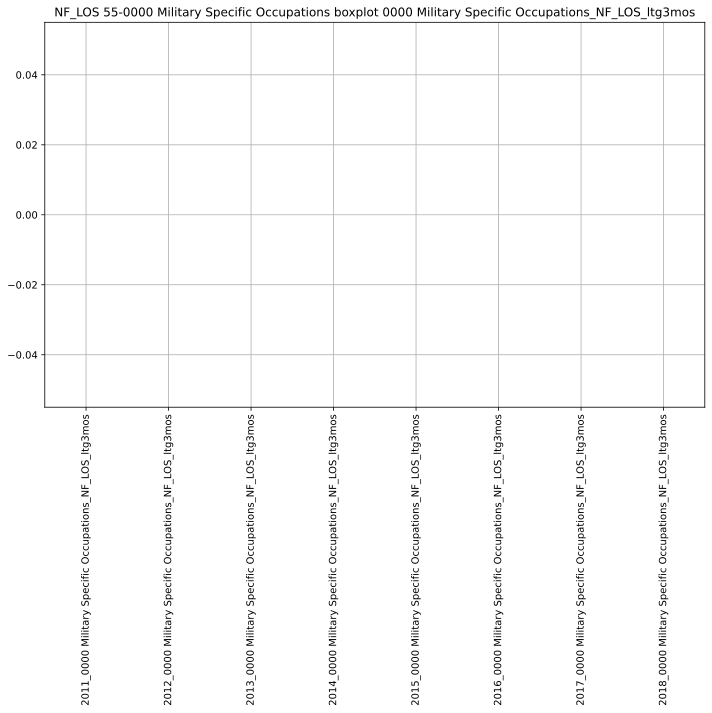

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/235224.401730:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235224.441231:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235224.656823:INFO:headless_shell.cc(660)] Written to file /tmp/tmph3_wpg4r/temp.png.
[1013/235224.870220:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235224.913901:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235225.184830:INFO:headless_shell.cc(660)] Written to file /tmp/tmpd79fw0kb/temp.png.
[1013/235225.444836:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235225.485027:WARNI

,2011_0000 Military Specific Occupations_NF_LOS_ltg3mos,2012_0000 Military Specific Occupations_NF_LOS_ltg3mos,2013_0000 Military Specific Occupations_NF_LOS_ltg3mos,2014_0000 Military Specific Occupations_NF_LOS_ltg3mos,2015_0000 Military Specific Occupations_NF_LOS_ltg3mos,2016_0000 Military Specific Occupations_NF_LOS_ltg3mos,2017_0000 Military Specific Occupations_NF_LOS_ltg3mos,2018_0000 Military Specific Occupations_NF_LOS_ltg3mos
2011_0000 Military Specific Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2012_0000 Military Specific Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2013_0000 Military Specific Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2014_0000 Military Specific Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2015_0000 Military Specific Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2016_0000 Military Specific Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2017_0000 Military Specific Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan
2018_0000 Military Specific Occupations_NF_LOS_ltg3mos,nan,nan,nan,nan,nan,nan,nan,nan


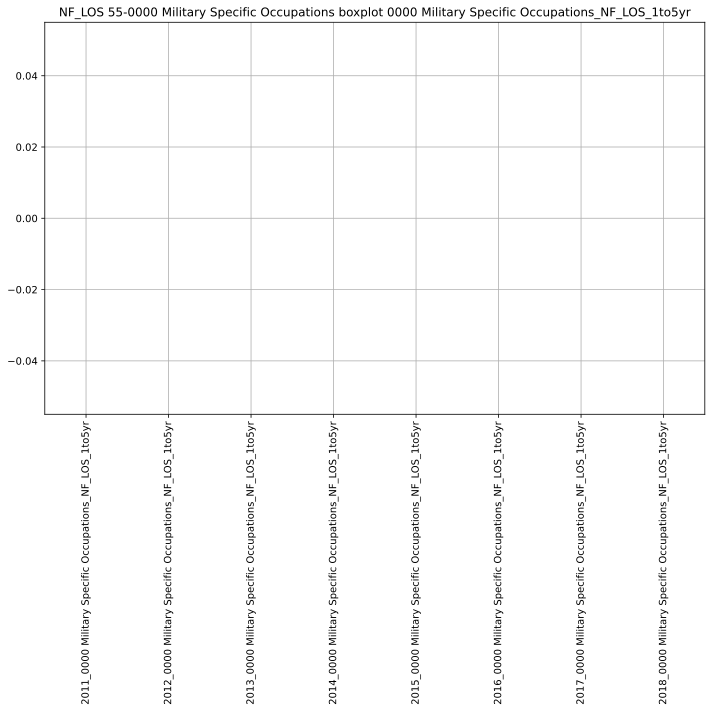

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/235228.176285:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235228.217080:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235228.425236:INFO:headless_shell.cc(660)] Written to file /tmp/tmpzgi5pa7k/temp.png.
[1013/235228.638412:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235228.677119:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235228.969163:INFO:headless_shell.cc(660)] Written to file /tmp/tmp5b4m20zy/temp.png.
[1013/235229.220718:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235229.261772:WARNI

,2011_0000 Military Specific Occupations_NF_LOS_1to5yr,2012_0000 Military Specific Occupations_NF_LOS_1to5yr,2013_0000 Military Specific Occupations_NF_LOS_1to5yr,2014_0000 Military Specific Occupations_NF_LOS_1to5yr,2015_0000 Military Specific Occupations_NF_LOS_1to5yr,2016_0000 Military Specific Occupations_NF_LOS_1to5yr,2017_0000 Military Specific Occupations_NF_LOS_1to5yr,2018_0000 Military Specific Occupations_NF_LOS_1to5yr
2011_0000 Military Specific Occupations_NF_LOS_1to5yr,nan,nan,nan,nan,nan,nan,nan,nan
2012_0000 Military Specific Occupations_NF_LOS_1to5yr,nan,nan,nan,nan,nan,nan,nan,nan
2013_0000 Military Specific Occupations_NF_LOS_1to5yr,nan,nan,nan,nan,nan,nan,nan,nan
2014_0000 Military Specific Occupations_NF_LOS_1to5yr,nan,nan,nan,nan,nan,nan,nan,nan
2015_0000 Military Specific Occupations_NF_LOS_1to5yr,nan,nan,nan,nan,nan,nan,nan,nan
2016_0000 Military Specific Occupations_NF_LOS_1to5yr,nan,nan,nan,nan,nan,nan,nan,nan
2017_0000 Military Specific Occupations_NF_LOS_1to5yr,nan,nan,nan,nan,nan,nan,nan,nan
2018_0000 Military Specific Occupations_NF_LOS_1to5yr,nan,nan,nan,nan,nan,nan,nan,nan


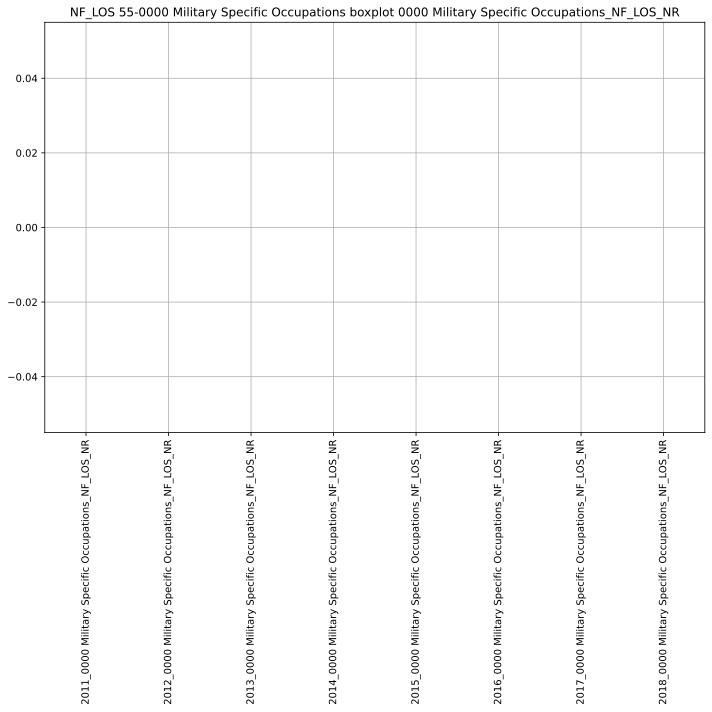

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/235231.872695:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235231.912044:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235232.121761:INFO:headless_shell.cc(660)] Written to file /tmp/tmpxfc3ctmr/temp.png.
[1013/235232.357804:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235232.398891:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235232.677786:INFO:headless_shell.cc(660)] Written to file /tmp/tmpqwh66kuk/temp.png.
[1013/235232.939168:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235232.977420:WARNI

,2011_0000 Military Specific Occupations_NF_LOS_NR,2012_0000 Military Specific Occupations_NF_LOS_NR,2013_0000 Military Specific Occupations_NF_LOS_NR,2014_0000 Military Specific Occupations_NF_LOS_NR,2015_0000 Military Specific Occupations_NF_LOS_NR,2016_0000 Military Specific Occupations_NF_LOS_NR,2017_0000 Military Specific Occupations_NF_LOS_NR,2018_0000 Military Specific Occupations_NF_LOS_NR
2011_0000 Military Specific Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2012_0000 Military Specific Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2013_0000 Military Specific Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2014_0000 Military Specific Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2015_0000 Military Specific Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2016_0000 Military Specific Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2017_0000 Military Specific Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan
2018_0000 Military Specific Occupations_NF_LOS_NR,nan,nan,nan,nan,nan,nan,nan,nan


########################################## CORRELATIONS ###############################################
['55-0000 Military Specific Occupations_NF_LOS_3to11mos', '55-0000 Military Specific Occupations_NF_LOS_5plus', '55-0000 Military Specific Occupations_NF_LOS_ltg3mos', '55-0000 Military Specific Occupations_NF_LOS_1to5yr', '55-0000 Military Specific Occupations_NF_LOS_NR']


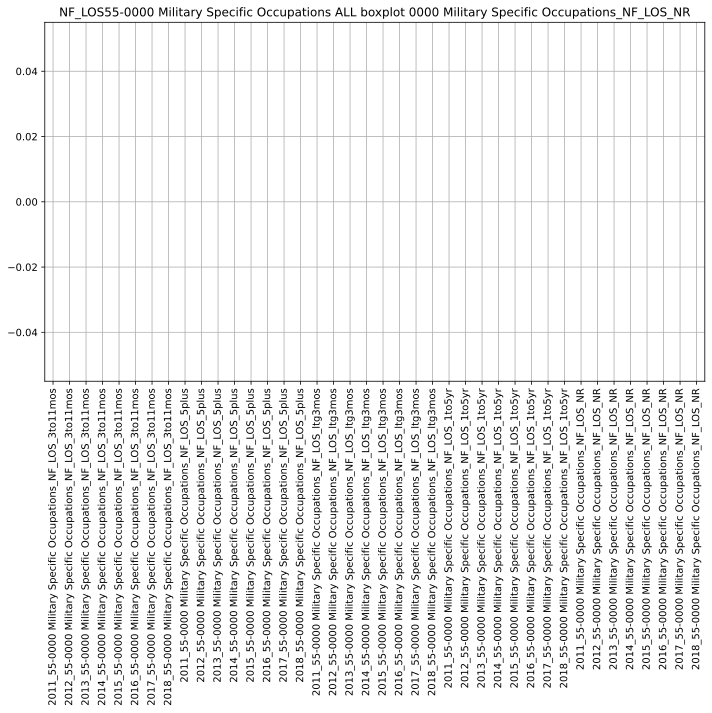

/usr/local/lib/python3.8/dist-packages/dataframe_image/_pandas_accessor.py:69: FutureWarning: this method is deprecated in favour of `Styler.to_html()`
  html = '<div>' + obj.render() + '</div>'
[1013/235237.340913:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235237.390278:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235237.692636:INFO:headless_shell.cc(660)] Written to file /tmp/tmp2adi0b21/temp.png.
[1013/235237.920794:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235237.962298:WARNING:sandbox_linux.cc(376)] InitializeSandbox() called with multiple threads in process gpu-process.
[1013/235238.438447:INFO:headless_shell.cc(660)] Written to file /tmp/tmpf5q24vu5/temp.png.
[1013/235238.737478:WARNING:bluez_dbus_manager.cc(247)] Floss manager not present, cannot set Floss enable/disable.
[1013/235238.779431:WARNI

,2011_55-0000 Military Specific Occupations_NF_LOS_3to11mos,2012_55-0000 Military Specific Occupations_NF_LOS_3to11mos,2013_55-0000 Military Specific Occupations_NF_LOS_3to11mos,2014_55-0000 Military Specific Occupations_NF_LOS_3to11mos,2015_55-0000 Military Specific Occupations_NF_LOS_3to11mos,2016_55-0000 Military Specific Occupations_NF_LOS_3to11mos,2017_55-0000 Military Specific Occupations_NF_LOS_3to11mos,2018_55-0000 Military Specific Occupations_NF_LOS_3to11mos,2011_55-0000 Military Specific Occupations_NF_LOS_5plus,2012_55-0000 Military Specific Occupations_NF_LOS_5plus,2013_55-0000 Military Specific Occupations_NF_LOS_5plus,2014_55-0000 Military Specific Occupations_NF_LOS_5plus,2015_55-0000 Military Specific Occupations_NF_LOS_5plus,2016_55-0000 Military Specific Occupations_NF_LOS_5plus,2017_55-0000 Military Specific Occupations_NF_LOS_5plus,2018_55-0000 Military Specific Occupations_NF_LOS_5plus,2011_55-0000 Military Specific Occupations_NF_LOS_ltg3mos,2012_55-0000 Military Specific Occupations_NF_LOS_ltg3mos,2013_55-0000 Military Specific Occupations_NF_LOS_ltg3mos,2014_55-0000 Military Specific Occupations_NF_LOS_ltg3mos,2015_55-0000 Military Specific Occupations_NF_LOS_ltg3mos,2016_55-0000 Military Specific Occupations_NF_LOS_ltg3mos,2017_55-0000 Military Specific Occupations_NF_LOS_ltg3mos,2018_55-0000 Military Specific Occupations_NF_LOS_ltg3mos,2011_55-0000 Military Specific Occupations_NF_LOS_1to5yr,2012_55-0000 Military Specific Occupations_NF_LOS_1to5yr,2013_55-0000 Military Specific Occupations_NF_LOS_1to5yr,2014_55-0000 Military Specific Occupations_NF_LOS_1to5yr,2015_55-0000 Military Specific Occupations_NF_LOS_1to5yr,2016_55-0000 Military Specific Occupations_NF_LOS_1to5yr,2017_55-0000 Military Specific Occupations_NF_LOS_1to5yr,2018_55-0000 Military Specific Occupations_NF_LOS_1to5yr,2011_55-0000 Military Specific Occupations_NF_LOS_NR,2012_55-0000 Military Specific Occupations_NF_LOS_NR,2013_55-0000 Military Specific Occupations_NF_LOS_NR,2014_55-0000 Military Specific Occupations_NF_LOS_NR,2015_55-0000 Military Specific Occupations_NF_LOS_NR,2016_55-0000 Military Specific Occupations_NF_LOS_NR,2017_55-0000 Military Specific Occupations_NF_LOS_NR,2018_55-0000 Military Specific Occupations_NF_LOS_NR
2011_55-0000 Military Specific Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2012_55-0000 Military Specific Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2013_55-0000 Military Specific Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2014_55-0000 Military Specific Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2015_55-0000 Military Specific Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2016_55-0000 Military Specific Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2017_55-0000 Military Specific Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
2018_55-0000 Military Specific Occupations_NF_LOS_3to11mos,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan

In [6]:

for ocup_sel in range(1,24):
    
    print("########################################## NEW OCCUPATION ###############################################")
    print("")
    global_y_soc1 = []

    for year in range(0,8):  
        print("########################################## NEW YEAR ###############################################")
        desired_file_output = "./NF_SUB_GENDER/NF_GENDER_" + str(2011+year) + "_"    
        %run ./analysis-code-subcat.ipynb
    
    print("########################################## BOX PLOTS ###############################################")
    gen_boxplot()

    print("########################################## CORRELATIONS ###############################################")
    gen_corr()